In [ ]:
from google.colab import drive
drive.mount('/content/drive')
# !pip install torchmetrics
import torch
import torch.nn as nn
import pandas as pd
import matplotlib.pyplot as plt
import re
from torch.utils.data import Dataset, DataLoader
from sklearn.preprocessing import LabelEncoder, StandardScaler, MinMaxScaler
import numpy as np
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split

# pd.set_option('display.max_rows', None)

# Load the Excel file (replace with your filename)
file_path = "/content/drive/My Drive/Colab Notebooks/ResaleflatpricesbasedonregistrationdatefromJan2017onwards.csv"
df = pd.read_csv(file_path)



Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Use GPU if available, else use CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [ ]:
def load_dataset(csv_file_path='/content/drive/My Drive/Colab Notebooks/ResaleflatpricesbasedonregistrationdatefromJan2017onwards.csv'):
    df = pd.read_csv(csv_file_path)
    df['month'] = pd.to_datetime(df['month'], errors='coerce')
    df = df.dropna(subset=['month'])  # remove invalid dates
    return df

In [ ]:
## encoding for categorical columns. this converts the strings to numerical variables.
def encode_categorical_columns(df):
    categorical_cols = ['town', 'flat_type', 'street_name',
                        'storey_range', 'flat_model', 'remaining_lease']

    label_encoders = {}
    for col in categorical_cols:
        le = LabelEncoder()
        df[col] = le.fit_transform(df[col].astype(str))
        label_encoders[col] = le
    return df, label_encoders

In [ ]:
def encode_month_column(df):
    df = df.copy()
    df['month'] = df['month'].dt.year + df['month'].dt.month
    return df

In [ ]:
## the numbers are pretty large so normalize them to 0<x<1 otherwise it'll affect the lstm a lot

def normalize_continuous_columns(df):
    continuous_cols = ['floor_area_sqm', 'lease_commence_date', 'resale_price']
    scaler = MinMaxScaler()
    df[continuous_cols] = scaler.fit_transform(df[continuous_cols])
    return df, scaler

In [ ]:
## split into features and targets
def split_features_targets(df):
    x = df.drop('resale_price', axis=1).values
    y = df['resale_price'].values
    return x, y

In [ ]:
def preprocess_full_dataset(csv_file_path='ResaleflatpricesbasedonregistrationdatefromJan2017onwards.csv'):
    df = load_dataset(csv_file_path)
    df, label_encoders = encode_categorical_columns(df)
    df, scaler = normalize_continuous_columns(df)
    x, y = split_features_targets(df)
    return x, y, df, label_encoders, scaler

view values

FIlter preprocessed data


In [ ]:
def load_and_filter_raw_data(csv_file_path, town, flat_type, storey_range, target_month, min_len=10, max_len=50):
    df = pd.read_csv(csv_file_path)
    df['month'] = pd.to_datetime(df['month'], errors='coerce')
    df = df.dropna(subset=['month'])

    return filter_dataset(df, town, flat_type, storey_range, target_month, min_len, max_len)

In [ ]:
def filter_dataset(df, town, flat_type, storey_range, target_month, min_len=10, max_len=50): #changed max length from 50 to 100
    """
    Filters dataset by town, flat_type, storey_range.
    Prefers rows before and including the target_month.
    Falls back to symmetric closest if not enough.
    """
    if isinstance(target_month, str):
        target_month = pd.to_datetime(target_month)

    print(f"\nFiltering for: {town}, {flat_type}, {storey_range}, around {target_month.date()}")

    # Step 1: Apply strict filter
    filtered_df = df[
        (df['town'] == town) &
        (df['flat_type'] == flat_type) &
        (df['storey_range'] == storey_range)
    ]
    print(f"Initial strict match count: {len(filtered_df)}")

    # Step 2: Relax storey_range if needed
    if len(filtered_df) < min_len:
        print("Relaxing filter: removing storey_range...")
        filtered_df = df[
            (df['town'] == town) &
            (df['flat_type'] == flat_type)
        ]
        print(f"Relaxed match count: {len(filtered_df)}")

    if len(filtered_df) < min_len:
        print("Warning: Still not enough data after fallback.")
        return None

    # Step 3: Keep rows up to and including target_month
    before_or_at_target = filtered_df[filtered_df['month'] <= target_month]
    before_or_at_target = before_or_at_target.sort_values(by='month', ascending=False).head(max_len)

    if len(before_or_at_target) >= min_len:
        print(f"Using before_or_at_target with {len(before_or_at_target)} records.")
        return before_or_at_target.sort_values(by='month').reset_index(drop=True)

    # Step 4: Symmetric fallback if still not enough
    print("Not enough data before target. Using closest to target month (symmetric fallback).")
    filtered_df = filtered_df.copy()
    filtered_df['month_diff'] = (filtered_df['month'] - target_month).abs()
    filtered_df = filtered_df.sort_values(by='month_diff').drop(columns='month_diff').head(max_len)
    print(f"Symmetric fallback count: {len(filtered_df)}")

    return filtered_df.sort_values(by='month').reset_index(drop=True)

In [ ]:
def leave_one_out_split(df):
    """
    Drops one random sample and returns the rest as training set.
    """
    idx = np.random.choice(df.index)
    test_sample = df.loc[idx]
    train_df = df.drop(index=idx)
    return train_df.reset_index(drop=True), test_sample

In [ ]:
#prepare lstm no block column
def prepare_lstm_data(csv_file_path, town, flat_type, storey_range, target_month, min_len=10, max_len=50):
    """
    Loads the dataset, filters it, encodes + normalizes the filtered subset,
    leaves out 1 sample for testing, and returns:
    - x_train, y_train (np.float32)
    - x_test, y_test (single sample, float32)
    - label_encoders, scaler

    Note: The 'block' column is removed from processing.
    """
    import numpy as np

    # 1. Load full dataset
    df_full = load_dataset(csv_file_path)

    # 2. Filter the dataset before encoding
    filtered_df = filter_dataset(df_full, town, flat_type, storey_range, target_month)

    if filtered_df is None:
        print("No valid data found for the given filters.")
        return None, None, None, None, None, None, None

    # 2.3: Remove 'block' column if it exists
    if 'block' in filtered_df.columns:
        print("Removing 'block' column from dataset")
        filtered_df = filtered_df.drop(columns=['block'])

    # 2.5: Convert 'month' to numeric BEFORE label encoding
    filtered_df = encode_month_column(filtered_df)

    # 3. Encode + normalize the ENTIRE filtered_df
    encoded_df, label_encoders = encode_categorical_columns(filtered_df)
    normalized_df, scaler = normalize_continuous_columns(encoded_df)

    # 4. Leave one out after encoding
    train_df, test_sample = leave_one_out_split(normalized_df)

    # 5. Split training data into x, y
    x_train, y_train = split_features_targets(train_df)
    x_train = x_train.astype(np.float32)
    y_train = y_train.astype(np.float32)

    # 6. Prepare test sample
    x_test = test_sample.drop(labels='resale_price').values.astype(np.float32)
    y_test = np.float32(test_sample['resale_price'])

    return x_train, y_train, x_test, y_test, label_encoders, scaler

dataset & data loader


In [ ]:
class CustomDataset(Dataset):
    def __init__(self, x_data, y_data):
        self.x = torch.tensor(x_data, dtype=torch.float32)
        self.y = torch.tensor(y_data, dtype=torch.float32)

    def __len__(self):
        return len(self.x)

    def __getitem__(self, idx):
        return self.x[idx], self.y[idx]

In [ ]:
class LSTM_pt(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size):
        super(LSTM_pt, self).__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.output_size = output_size

        self.lstm = nn.LSTM(input_size, hidden_size, num_layers=self.num_layers, batch_first=True)
        self.dropout = nn.Dropout(p=0.2) #reduced drop out size to from 0.3to 0.2
        self.linear = nn.Linear(hidden_size, output_size)
        self.activation = nn.LeakyReLU(negative_slope=0.01)

    def forward(self, inputs, hidden_state, cell_state):
        lstm_out, (h_n, c_n) = self.lstm(inputs, (hidden_state, cell_state))
        dropped_out = self.dropout(lstm_out)
        output = self.linear(dropped_out)
        output = self.activation(output)
        return h_n, c_n, output

In [ ]:
def train(model, train_loader, val_loader, num_epochs, learning_rate, device):
    import matplotlib.pyplot as plt
    from sklearn.metrics import r2_score
    import numpy as np

    model.to(device)
    criterion = torch.nn.MSELoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

    best_val_loss = float('inf')
    r2 = float('inf')
    train_losses, val_losses = [], []
    train_log_losses, val_log_losses = [], []
    train_r2_scores, val_r2_scores = [], []

    for epoch in range(num_epochs):
        model.train()
        total_train_loss = 0.0
        all_preds, all_targets = [], []

        for inputs, targets in train_loader:
            batch_size = inputs.size(0)
            inputs = inputs.view(batch_size, -1, 1).to(device)
            targets = targets.view(batch_size, -1).to(device)

            h_0 = torch.zeros(model.num_layers, batch_size, model.hidden_size).to(device)
            c_0 = torch.zeros(model.num_layers, batch_size, model.hidden_size).to(device)

            optimizer.zero_grad()
            _, _, output = model(inputs, h_0, c_0)
            final_output = output[:, -1, :]
            loss = criterion(final_output, targets)
            loss.backward()
            optimizer.step()

            total_train_loss += loss.item()
            all_preds.extend(final_output.detach().cpu().numpy())
            all_targets.extend(targets.detach().cpu().numpy())

        avg_train_loss = total_train_loss / len(train_loader)
        train_losses.append(avg_train_loss)
        train_log_losses.append(np.log(avg_train_loss))
        train_r2_scores.append(r2_score(all_targets, all_preds))

        if val_loader is not None:
            # Validation step
            model.eval()
            total_val_loss = 0.0
            val_preds, val_targets = [], []

            with torch.no_grad():
                for inputs, targets in val_loader:
                    batch_size = inputs.size(0)
                    inputs = inputs.view(batch_size, -1, 1).to(device)
                    targets = targets.view(batch_size, -1).to(device)

                    h_0 = torch.zeros(model.num_layers, batch_size, model.hidden_size).to(device)
                    c_0 = torch.zeros(model.num_layers, batch_size, model.hidden_size).to(device)

                    _, _, output = model(inputs, h_0, c_0)
                    final_output = output[:, -1, :]
                    loss = criterion(final_output, targets)
                    total_val_loss += loss.item()

                    val_preds.extend(final_output.detach().cpu().numpy())
                    val_targets.extend(targets.detach().cpu().numpy())

            avg_val_loss = total_val_loss / len(val_loader)
            val_losses.append(avg_val_loss)
            val_log_losses.append(np.log(avg_val_loss))
            val_r2_scores.append(r2_score(val_targets, val_preds))

            print(f"Epoch {epoch+1}/{num_epochs}, Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}, Train R²: {train_r2_scores[-1]:.4f}, Val R²: {val_r2_scores[-1]:.4f}")

            if avg_val_loss < best_val_loss:
                best_val_loss = avg_val_loss
                torch.save(model.state_dict(), "best_model.pt")
                print("Best model saved!")
        else:
            print(f"Epoch {epoch+1}/{num_epochs}, Train Loss: {avg_train_loss:.4f}, Train R²: {train_r2_scores[-1]:.4f}")

    # Plot MSE loss
    plt.figure(figsize=(10, 4))
    plt.plot(train_losses, label="Train Loss")
    if val_losses:
        plt.plot(val_losses, label="Validation Loss")
    plt.xlabel("Epoch")
    plt.ylabel("MSE Loss")
    plt.title("Train vs Validation MSE Loss")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Plot Log Loss
    plt.figure(figsize=(10, 4))
    plt.plot(train_log_losses, label="Train Log Loss")
    if val_log_losses:
        plt.plot(val_log_losses, label="Validation Log Loss")
    plt.xlabel("Epoch")
    plt.ylabel("Log MSE Loss")
    plt.title("Train vs Validation Log Loss")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
    model.load_state_dict(torch.load("best_model.pt"))
    return model, best_val_loss


In [ ]:
def evaluate_on_test(model, test_loader, device):
    model.load_state_dict(torch.load("best_model.pt"))
    model.eval()
    model.to(device)

    criterion = torch.nn.MSELoss()
    total_loss = 0.0
    preds, targets_all = [], []

    with torch.no_grad():
        for inputs, targets in test_loader:
            batch_size = inputs.size(0)
            inputs = inputs.view(batch_size, -1, 1).to(device)
            targets = targets.view(batch_size, -1).to(device)

            h_0 = torch.zeros(model.num_layers, batch_size, model.hidden_size).to(device)
            c_0 = torch.zeros(model.num_layers, batch_size, model.hidden_size).to(device)

            _, _, output = model(inputs, h_0, c_0)
            final_output = output[:, -1, :]
            loss = criterion(final_output, targets)
            total_loss += loss.item()

            preds.extend(final_output.cpu().numpy())
            targets_all.extend(targets.cpu().numpy())

    avg_test_loss = total_loss / len(test_loader)
    test_r2 = r2_score(targets_all, preds)
    print(f"Test Loss: {avg_test_loss:.4f}, Test R² Score: {test_r2:.4f}")

In [ ]:
def predict_house_price(model, row, label_encoders, scaler, device):
    """
    Predicts the house price for a single row of data using a trained LSTM model.
    This version handles the '2025-01' format strings without changing encode_month_column.

    Args:
        model: Trained LSTM model
        row: A pandas Series or DataFrame row containing house data
        label_encoders: Dictionary of label encoders for categorical columns
        scaler: Fitted MinMaxScaler for continuous columns
        device: PyTorch device (cpu or cuda)

    Returns:
        float: The predicted house price (descaled to original value)
    """
    import torch
    import numpy as np
    import pandas as pd
    from sklearn.preprocessing import LabelEncoder
    import re

    # Make a copy of the row to avoid modifying the original
    row_copy = row.copy()

    # Convert row to DataFrame if it's a Series
    if isinstance(row_copy, pd.Series):
        row_copy = pd.DataFrame([row_copy])

    # Handle the 'month' column before other processing if it's in YYYY-MM format
    if 'month' in row_copy.columns:
        # Check if it's a string in format like "2025-01"
        if isinstance(row_copy['month'].iloc[0], str) and re.match(r'^\d{4}-\d{2}$', row_copy['month'].iloc[0]):
            # Convert to datetime format that encode_month_column can handle
            try:
                row_copy['month'] = pd.to_datetime(row_copy['month'])
            except Exception as e:
                print(f"Error converting month value to datetime: {e}")
                # Manually convert YYYY-MM format to a numeric value
                month_str = row_copy['month'].iloc[0]
                parts = month_str.split('-')
                if len(parts) == 2:
                    try:
                        year = int(parts[0])
                        month = int(parts[1])
                        row_copy['month'] = year + month  # Create a numeric representation
                    except:
                        row_copy['month'] = 0  # Default if parsing fails
                else:
                    row_copy['month'] = 0  # Default for invalid format

    # Create a new DataFrame with only the columns we need to avoid issues
    processed_row = pd.DataFrame()

    # Step 1: Process categorical columns
    categorical_cols = ['town', 'flat_type', 'street_name',
                        'storey_range', 'flat_model', 'remaining_lease']

    for col in categorical_cols:
        if col in row_copy.columns and col in label_encoders:
            # Convert to string first to match the encoding process
            string_values = row_copy[col].astype(str)

            # Replace 'nan' strings with a default value
            string_values = string_values.replace('nan', 'Unknown')

            encoder = label_encoders[col]

            try:
                # Try to transform using the provided encoder
                processed_row[col] = encoder.transform(string_values)
            except ValueError as e:
                print(f"Found new category in {col}. Adding to encoder.")

                # Get the current classes
                current_classes = list(encoder.classes_)

                # Find the new classes that aren't in the current classes
                unique_values = list(string_values.unique())
                new_classes = [val for val in unique_values if val not in current_classes]
                print(f"New categories in {col}: {new_classes}")

                # Create a new encoder with all classes
                new_encoder = LabelEncoder()
                all_classes = np.append(current_classes, new_classes)
                new_encoder.fit(all_classes)

                # Update the encoder in place (modifying the original)
                label_encoders[col] = new_encoder

                # Transform using the updated encoder
                processed_row[col] = new_encoder.transform(string_values)
        else:
            # If column is missing, add a default value
            processed_row[col] = 0

    # # Step 2: Handle 'month' column after categorical processing
    # if 'month' in row_copy.columns:
    #     if pd.api.types.is_datetime64_any_dtype(row_copy['month']):
    #         # If it's already datetime, use your original encoding method
    #         month_datetime = row_copy['month']
    #         processed_row['month'] = month_datetime.dt.year + month_datetime.dt.month
    #     elif isinstance(row_copy['month'].iloc[0], (int, float)):
    #         # It's already a numeric value, use as is
    #         processed_row['month'] = row_copy['month']
    #     else:
    #         # For any other case, use a default value
    #         processed_row['month'] = 0
    # else:
    #     # If month is missing, add a default value
    #     processed_row['month'] = 0

    # Step 3: Process continuous columns
    continuous_cols = ['floor_area_sqm', 'lease_commence_date', 'resale_price']

    for col in continuous_cols:
        if col != 'resale_price' or col in row_copy.columns:  # Skip resale_price if not in input
            if col in row_copy.columns:
                # Handle potential NaN values
                if row_copy[col].isna().any():
                    row_copy[col] = row_copy[col].fillna(0)
                processed_row[col] = row_copy[col].astype(float)
            else:
                # If column is missing, add a default value
                processed_row[col] = 0.0

    # Fill any remaining NaN values
    processed_row = processed_row.fillna(0)

    # Step 4: Normalize the continuous columns
    # Get indices of continuous columns that are in the processed DataFrame
    cols_to_scale = [col for col in continuous_cols if col in processed_row.columns]
    if cols_to_scale:
        try:
            processed_row[cols_to_scale] = scaler.transform(processed_row[cols_to_scale])
        except Exception as e:
            print(f"Error during scaling: {e}")
            # Handle scaling error by manually scaling each column
            for col in cols_to_scale:
                try:
                    col_idx = list(scaler.feature_names_in_).index(col)
                    min_val = scaler.data_min_[col_idx]
                    max_val = scaler.data_max_[col_idx]
                    if max_val > min_val:
                        processed_row[col] = (processed_row[col] - min_val) / (max_val - min_val)
                    else:
                        processed_row[col] = 0
                except Exception as e2:
                    print(f"Manual scaling failed for {col}: {e2}")
                    processed_row[col] = 0

    # Step 5: Prepare the input for the model
    # Remove the target variable if it exists
    if 'resale_price' in processed_row.columns:
        x = processed_row.drop('resale_price', axis=1)
    else:
        x = processed_row

    # Convert to numpy array
    x = x.values.astype(np.float32)

    # Reshape for LSTM: [batch_size, sequence_length, num_features]
    x_tensor = torch.tensor(x, dtype=torch.float32).view(1, -1, 1).to(device)

    # Step 6: Make prediction
    model.eval()
    with torch.no_grad():
        h_0 = torch.zeros(model.num_layers, 1, model.hidden_size).to(device)
        c_0 = torch.zeros(model.num_layers, 1, model.hidden_size).to(device)

        try:
            _, _, output = model(x_tensor, h_0, c_0)
            final_output = output[:, -1, :].cpu().numpy()[0][0]
        except Exception as e:
            print(f"Error during model prediction: {e}")
            return float('nan')

    # Step 7: Descale the prediction
    try:
        price_idx = list(scaler.feature_names_in_).index('resale_price')

        # Get the min and max values for resale_price
        min_val = scaler.data_min_[price_idx]
        max_val = scaler.data_max_[price_idx]

        # Reverse the min-max scaling
        predicted_price = final_output * (max_val - min_val) + min_val
        return predicted_price
    except (ValueError, AttributeError) as e:
        print(f"Warning: Could not properly descale the prediction. Error: {e}")
        # Try finding it in continuous_cols
        if 'resale_price' in continuous_cols:
            price_idx = continuous_cols.index('resale_price')
            # Make a guess at the min/max values
            try:
                min_val = scaler.data_min_[price_idx]
                max_val = scaler.data_max_[price_idx]
                predicted_price = final_output * (max_val - min_val) + min_val
                return predicted_price
            except:
                print("Warning: Returning raw prediction value.")
                return final_output
        else:
            print("Warning: Returning raw prediction value.")
            return final_output

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

def simplify_storey_range(storey):
    if storey == "01 TO 03":
        return "01 TO 03"
    elif isinstance(storey, str):
        try:
            # Extract the starting level (e.g., "19 TO 21" → 19)
            start_level = int(storey.split(" TO ")[0])
            if start_level >= 19:
                return "19+"
            else:
                return storey
        except:
            return "Other"
    else:
        return "Other"


In [ ]:
def run_model_on_2025(df):
    results = []

    # Add detailed debugging
    print("Initial dataframe shape:", df.shape)

    df['year'] = pd.to_datetime(df['month'], errors='coerce').dt.year
    print("After adding year, NaN count:", df['year'].isna().sum())

    # Filter for 2025 only
    df_2025 = df[df['year'] == 2025].copy()
    print("2025 data shape:", df_2025.shape)

    # Apply storey range simplification
    df_2025['storey_group'] = df_2025['storey_range'].apply(simplify_storey_range)

    # Group by simplified storey range, town, and flat_type
    grouped = df_2025.groupby(['storey_group', 'town', 'flat_type',])

    # Optional: Collect groups into a dictionary for easy access
    group_dict = {name: group for name, group in grouped}

    # Debugging: Print group sizes
    print("\nGroup Sizes:")
    for key, group in group_dict.items():
        print(f"Group {key}: {len(group)} rows")

    print("Grouped Keys:", list(group_dict.keys()))

    # Add more comprehensive error handling
    for key, group in group_dict.items():
        storey_group, town, flat_type = key
        print(f"\n=== Processing group: {key} ===")
        print(f"Group size: {len(group)} rows")

        try:
            #data preprocessor
            print(f"Calling prepare_lstm_data for {key}")
            x_train, y_train, x_test, y_test, label_encoders, scaler = prepare_lstm_data(file_path, town, flat_type, storey_group, target_month = "2025-01")

            print(f"Data shapes - x_train: {x_train.shape}, y_train: {y_train.shape}")

            #train model
            model = LSTM_pt(input_size=1, hidden_size=64, num_layers=3, output_size=1).to(device)

            # Get your training data
            x = x_train
            y = y_train.flatten()

            print(f"Flattened y shape: {y.shape}, Unique values: {len(set(y))}")

            # Simple train-validation split (no test set)
            print("Using simple train-validation split (80/20).")
            x_train, x_val = train_test_split(x, test_size=0.2, random_state=42)
            y_train, y_val = train_test_split(y, test_size=0.2, random_state=42)

            print(f"Split sizes - Train: {len(x_train)}, Val: {len(x_val)}")

            # Create PyTorch Datasets
            print("Creating PyTorch datasets...")
            train_dataset = CustomDataset(x_train, y_train)
            val_dataset = CustomDataset(x_val, y_val)
            print(f"Dataset sizes - Train: {len(train_dataset)}, Val: {len(val_dataset)}")

            # Create DataLoaders with appropriate batch sizes
            batch_size_train = min(128, len(train_dataset))
            batch_size_val = min(128, len(val_dataset))

            print(f"Using batch sizes - Train: {batch_size_train}, Val: {batch_size_val}")

            train_loader = DataLoader(train_dataset, batch_size=batch_size_train, shuffle=True)
            val_loader = DataLoader(val_dataset, batch_size=batch_size_val, shuffle=False)

            # Train with validation
            print("Starting model training...")
            train(model, train_loader, val_loader=val_loader, num_epochs=50, learning_rate=0.01, device=device)
            print("Training completed")

            # Make predictions
            print(f"Making predictions for {len(group)} rows...")
            for idx, row in group.iterrows():
                try:
                    predicted_price = predict_house_price(model, row, label_encoders, scaler, device)
                    print(predicted_price)
                    actual_price = row['resale_price']
                    error = predicted_price - actual_price
                    percent_error = (error / actual_price) * 100

                    results.append({
                        'index': idx,
                        'town': town,
                        'flat_type': flat_type,
                        'storey_range': storey_group,
                        'actual_price': actual_price,
                        'predicted_price': predicted_price,
                        'error': error,
                        'percent_error': percent_error
                    })

                except Exception as e:
                    print(f"Error predicting for row {idx}: {e}")
                    # Add error information to results
                    results.append({
                        'index': idx,
                        'town': town,
                        'flat_type': flat_type,
                        'storey_range': storey_group,
                        'actual_price': row.get('resale_price', 'N/A'),
                        'predicted_price': 'Error',
                        'error': str(e),
                        'percent_error': 'N/A'
                    })

        except Exception as e:
            print(f"Error processing group {key}: {str(e)}")
            # Continue with next group instead of failing completely
            continue

    print(f"Completed processing with {len(results)} prediction results")
    return results

In [ ]:
import pickle
import os
def run_model_on_2025(df):
    results = []
    model_save_dir = "/content/saved_models"  # Or change to preferred path
    os.makedirs(model_save_dir, exist_ok=True)

    model_records = []  # To keep track of (val_loss, model, identifiers)


    # Add detailed debugging
    print("Initial dataframe shape:", df.shape)

    df['year'] = pd.to_datetime(df['month'], errors='coerce').dt.year
    print("After adding year, NaN count:", df['year'].isna().sum())

    # Filter for 2025 only
    df_2025 = df[df['year'] == 2025].copy()
    print("2025 data shape:", df_2025.shape)

    # Apply storey range simplification
    df_2025['storey_group'] = df_2025['storey_range'].apply(simplify_storey_range)

    # Group by simplified storey range, town, and flat_type
    grouped = df_2025.groupby(['storey_group', 'town', 'flat_type',])

    # Optional: Collect groups into a dictionary for easy access
    group_dict = {name: group for name, group in grouped}

    # Debugging: Print group sizes
    print("\nGroup Sizes:")
    for key, group in group_dict.items():
        print(f"Group {key}: {len(group)} rows")

    print("Grouped Keys:", list(group_dict.keys()))

    # Add more comprehensive error handling
    for key, group in group_dict.items():
        storey_group, town, flat_type = key
        print(f"\n=== Processing group: {key} ===")
        print(f"Group size: {len(group)} rows")

        try:
            #data preprocessor
            print(f"Calling prepare_lstm_data for {key}")
            x_train, y_train, x_test, y_test, label_encoders, scaler = prepare_lstm_data(file_path, town, flat_type, storey_group, target_month = "2025-01")

            print(f"Data shapes - x_train: {x_train.shape}, y_train: {y_train.shape}")

            #train model
            model = LSTM_pt(input_size=1, hidden_size=64, num_layers=3, output_size=1).to(device)

            # Get your training data
            x = x_train
            y = y_train.flatten()

            print(f"Flattened y shape: {y.shape}, Unique values: {len(set(y))}")

            # Simple train-validation split (no test set)
            print("Using simple train-validation split (80/20).")
            x_train, x_val = train_test_split(x, test_size=0.2, random_state=42)
            y_train, y_val = train_test_split(y, test_size=0.2, random_state=42)

            print(f"Split sizes - Train: {len(x_train)}, Val: {len(x_val)}")

            # Create PyTorch Datasets
            print("Creating PyTorch datasets...")
            train_dataset = CustomDataset(x_train, y_train)
            val_dataset = CustomDataset(x_val, y_val)
            print(f"Dataset sizes - Train: {len(train_dataset)}, Val: {len(val_dataset)}")

            # Create DataLoaders with appropriate batch sizes
            batch_size_train = min(128, len(train_dataset))
            batch_size_val = min(128, len(val_dataset))

            print(f"Using batch sizes - Train: {batch_size_train}, Val: {batch_size_val}")

            train_loader = DataLoader(train_dataset, batch_size=batch_size_train, shuffle=True)
            val_loader = DataLoader(val_dataset, batch_size=batch_size_val, shuffle=False)

            # Train with validation
            print("Starting model training...")
            model, best_val_loss =train(model, train_loader, val_loader=val_loader, num_epochs=50, learning_rate=0.01, device=device)
            filename_base = f"{storey_group}_{town}_{flat_type}".replace(" ", "_")
            pickle_path = os.path.join(model_save_dir, f"{filename_base}_bundle.pkl")
            model_bundle = {
                'model_state_dict': model.state_dict(),
                'model_class': LSTM_pt,  # so you can reinstantiate it later
                'val_loss': best_val_loss,
                'label_encoders': label_encoders,
                'scaler': scaler,
                'key': key
            }
            # Save the bundle to a single pickle file
            with open(pickle_path, 'wb') as f:
                pickle.dump(model_bundle, f)

            # Also track the path if you want to print it in top 3
            model_records.append({
                'val_loss': best_val_loss,
                'pickle_path': pickle_path,
                'key': key
            })
            print("Training completed")

        except Exception as e:
            print(f"Error processing group {key}: {str(e)}")
            # Continue with next group instead of failing completely
            continue

    print("\n=== Top 3 Saved Models ===")
    top_3_models = sorted(model_records, key=lambda x: x['val_loss'])[:3]
    for record in top_3_models:
        storey_group, town, flat_type = record['key']
        filename_base = f"{storey_group}_{town}_{flat_type}".replace(" ", "_")

        model_path = os.path.join(model_save_dir, f"{filename_base}_model.pt")
        aux_path = os.path.join(model_save_dir, f"{filename_base}_aux.pth")

        print(f"\nModel for: {record['key']}")
        print(f"Validation Loss: {record['val_loss']:.4f}")
        print(f"Model Path: {model_path}")
        print(f"Auxiliary Data Path: {aux_path}")

    print(f"Completed processing with {len(results)} prediction results")
    return results

Initial dataframe shape: (202399, 11)
After adding year, NaN count: 0
2025 data shape: (5414, 12)

Group Sizes:
Group ('01 TO 03', 'ANG MO KIO', '3 ROOM'): 27 rows
Group ('01 TO 03', 'ANG MO KIO', '4 ROOM'): 10 rows
Group ('01 TO 03', 'ANG MO KIO', '5 ROOM'): 3 rows
Group ('01 TO 03', 'ANG MO KIO', 'EXECUTIVE'): 2 rows
Group ('01 TO 03', 'BEDOK', '2 ROOM'): 1 rows
Group ('01 TO 03', 'BEDOK', '3 ROOM'): 18 rows
Group ('01 TO 03', 'BEDOK', '4 ROOM'): 18 rows
Group ('01 TO 03', 'BEDOK', '5 ROOM'): 5 rows
Group ('01 TO 03', 'BEDOK', 'EXECUTIVE'): 3 rows
Group ('01 TO 03', 'BISHAN', '4 ROOM'): 7 rows
Group ('01 TO 03', 'BISHAN', '5 ROOM'): 1 rows
Group ('01 TO 03', 'BISHAN', 'EXECUTIVE'): 2 rows
Group ('01 TO 03', 'BUKIT BATOK', '2 ROOM'): 5 rows
Group ('01 TO 03', 'BUKIT BATOK', '3 ROOM'): 21 rows
Group ('01 TO 03', 'BUKIT BATOK', '4 ROOM'): 28 rows
Group ('01 TO 03', 'BUKIT BATOK', '5 ROOM'): 9 rows
Group ('01 TO 03', 'BUKIT BATOK', 'EXECUTIVE'): 4 rows
Group ('01 TO 03', 'BUKIT MERAH', '

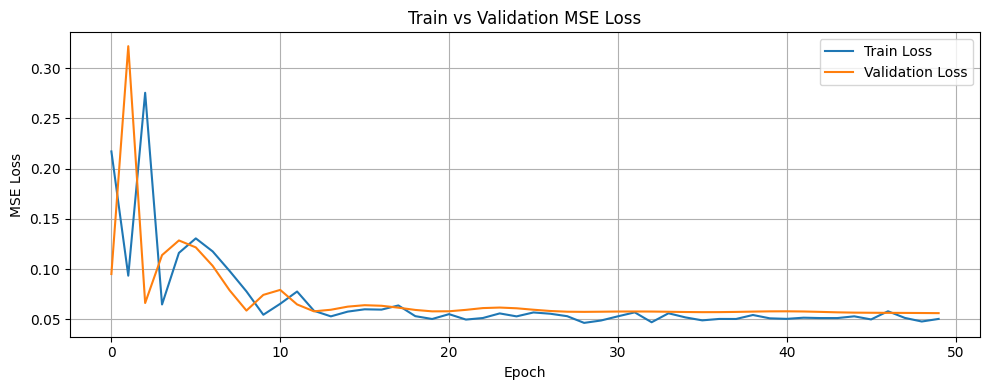

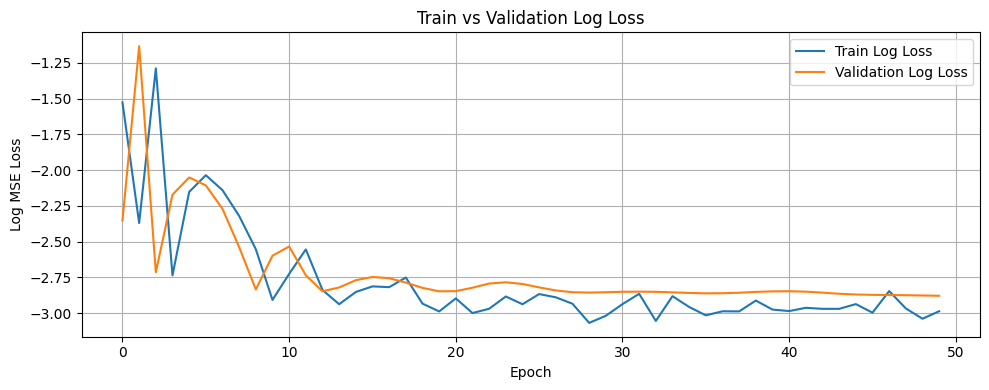

Training completed

=== Processing group: ('01 TO 03', 'ANG MO KIO', '4 ROOM') ===
Group size: 10 rows
Calling prepare_lstm_data for ('01 TO 03', 'ANG MO KIO', '4 ROOM')

Filtering for: ANG MO KIO, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 382
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 45
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1793, Val Loss: 0.0316, Train R²: -0.8788, Val R²: 0.0159
Best model saved!
Epoch 2/50, Train Loss: 0.0941, Val Loss: 0.4734, Train R²: 0.0144, Val R²: -13.7588
Epoch 3/50, Train Loss: 0.4207, Val Loss: 0.0294, Train R²: -3.4080, Val R²: 0.0844
Best model saved!
Epoch 4/50, Train Loss: 0.0884, Val Loss: 0.0485, Train R²: 0.0742

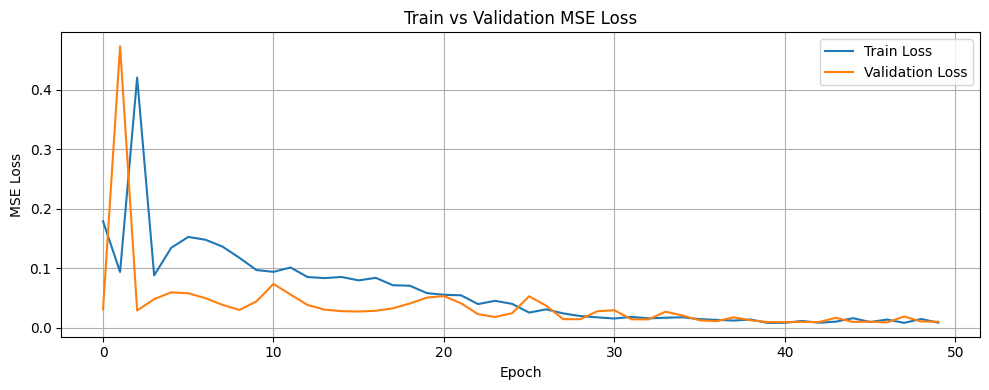

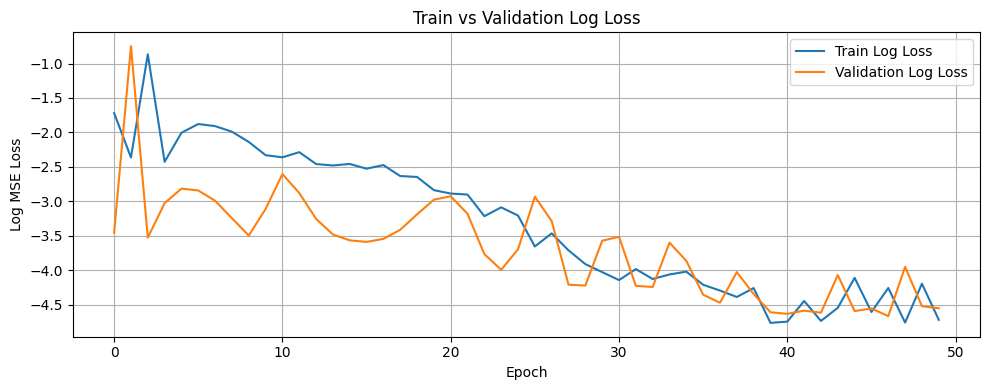

Training completed

=== Processing group: ('01 TO 03', 'ANG MO KIO', '5 ROOM') ===
Group size: 3 rows
Calling prepare_lstm_data for ('01 TO 03', 'ANG MO KIO', '5 ROOM')

Filtering for: ANG MO KIO, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 128
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1428, Val Loss: 0.1837, Train R²: -2.7599, Val R²: -1.6037
Best model saved!
Epoch 2/50, Train Loss: 0.0552, Val Loss: 0.3195, Train R²: -0.4530, Val R²: -3.5278
Epoch 3/50, Train Loss: 0.4913, Val Loss: 0.1318, Train R²: -11.9394, Val R²: -0.8678
Best model saved!
Epoch 4/50, Train Loss: 0.0366, Val Loss: 0.2556, Train R²: 0.03

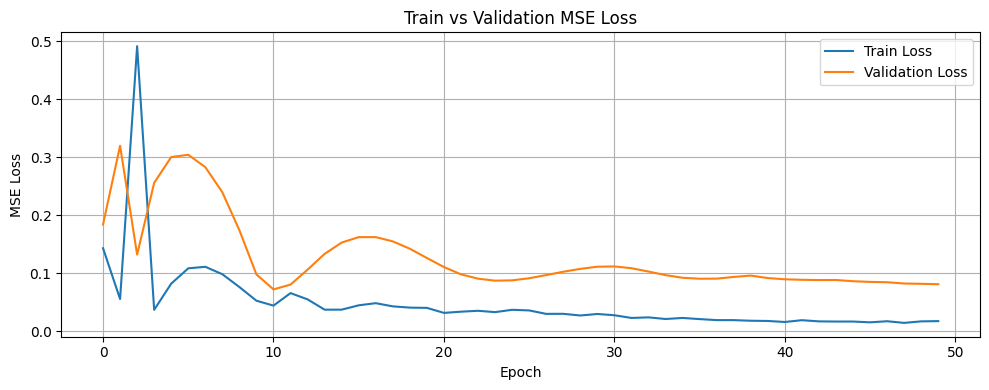

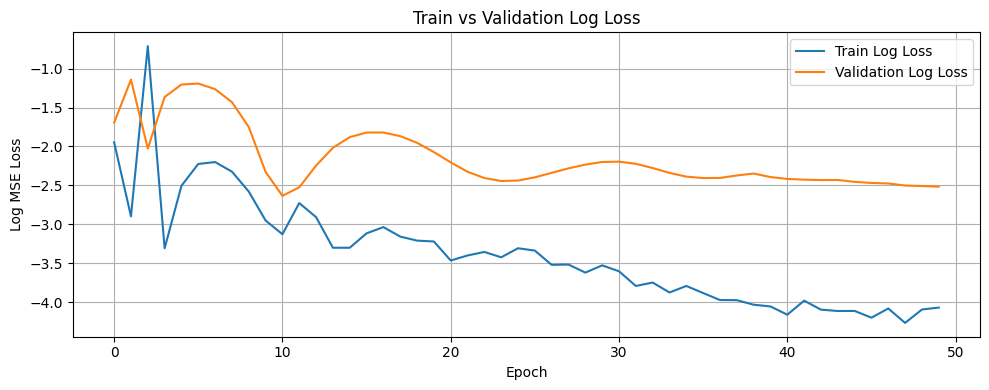

Training completed

=== Processing group: ('01 TO 03', 'ANG MO KIO', 'EXECUTIVE') ===
Group size: 2 rows
Calling prepare_lstm_data for ('01 TO 03', 'ANG MO KIO', 'EXECUTIVE')

Filtering for: ANG MO KIO, EXECUTIVE, 01 TO 03, around 2025-01-01
Initial strict match count: 29
Using before_or_at_target with 28 records.
Removing 'block' column from dataset
Data shapes - x_train: (27, 9), y_train: (27,)
Flattened y shape: (27,), Unique values: 23
Using simple train-validation split (80/20).
Split sizes - Train: 21, Val: 6
Creating PyTorch datasets...
Dataset sizes - Train: 21, Val: 6
Using batch sizes - Train: 21, Val: 6
Starting model training...
Epoch 1/50, Train Loss: 0.1255, Val Loss: 0.0306, Train R²: -2.2511, Val R²: 0.0192
Best model saved!
Epoch 2/50, Train Loss: 0.0495, Val Loss: 0.2539, Train R²: -0.2811, Val R²: -7.1425
Epoch 3/50, Train Loss: 0.1743, Val Loss: 0.0342, Train R²: -3.5145, Val R²: -0.0971
Epoch 4/50, Train Loss: 0.0389, Val Loss: 0.0333, Train R²: -0.0085, Val R²: -0

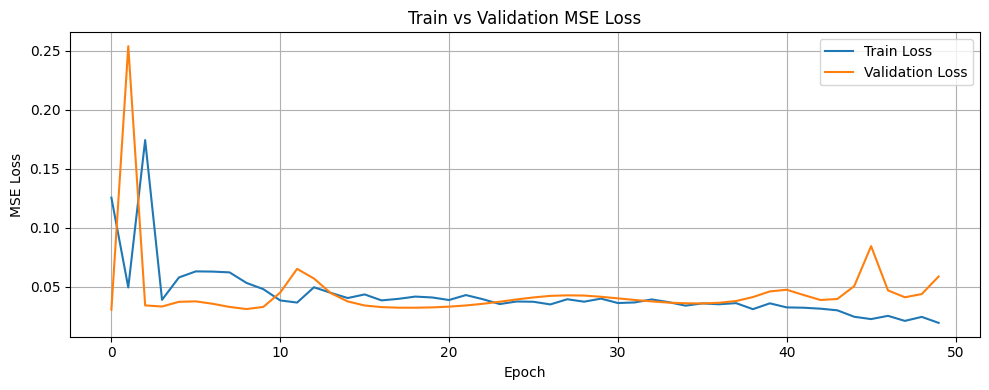

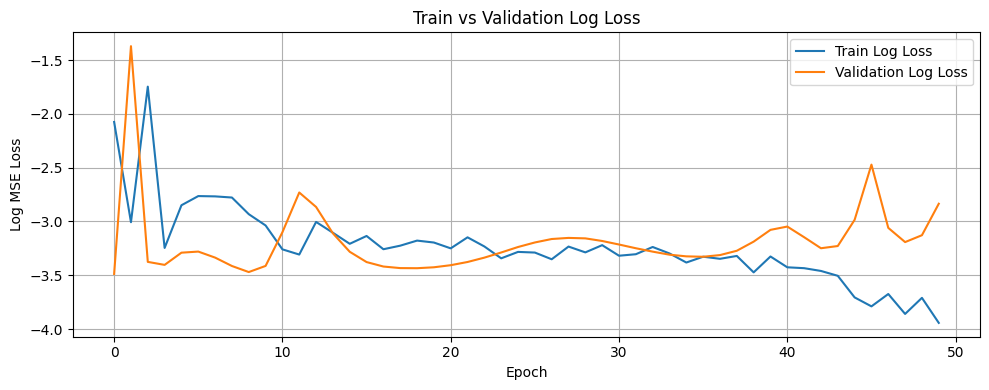

Training completed

=== Processing group: ('01 TO 03', 'BEDOK', '2 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('01 TO 03', 'BEDOK', '2 ROOM')

Filtering for: BEDOK, 2 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 35
Using before_or_at_target with 34 records.
Removing 'block' column from dataset
Data shapes - x_train: (33, 9), y_train: (33,)
Flattened y shape: (33,), Unique values: 22
Using simple train-validation split (80/20).
Split sizes - Train: 26, Val: 7
Creating PyTorch datasets...
Dataset sizes - Train: 26, Val: 7
Using batch sizes - Train: 26, Val: 7
Starting model training...
Epoch 1/50, Train Loss: 0.2698, Val Loss: 0.0502, Train R²: -3.8205, Val R²: -0.0768
Best model saved!
Epoch 2/50, Train Loss: 0.0917, Val Loss: 0.7424, Train R²: -0.6390, Val R²: -14.9151
Epoch 3/50, Train Loss: 0.6575, Val Loss: 0.0454, Train R²: -10.7484, Val R²: 0.0267
Best model saved!
Epoch 4/50, Train Loss: 0.0554, Val Loss: 0.0692, Train R²: 0.0098, Val R²: -0.4839

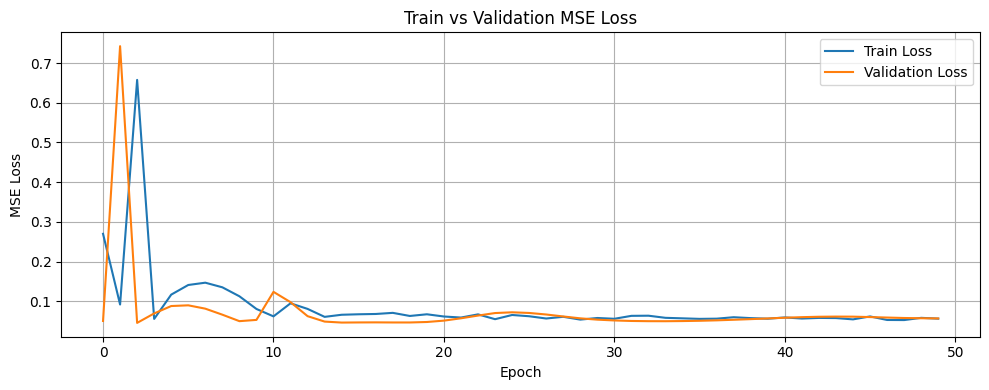

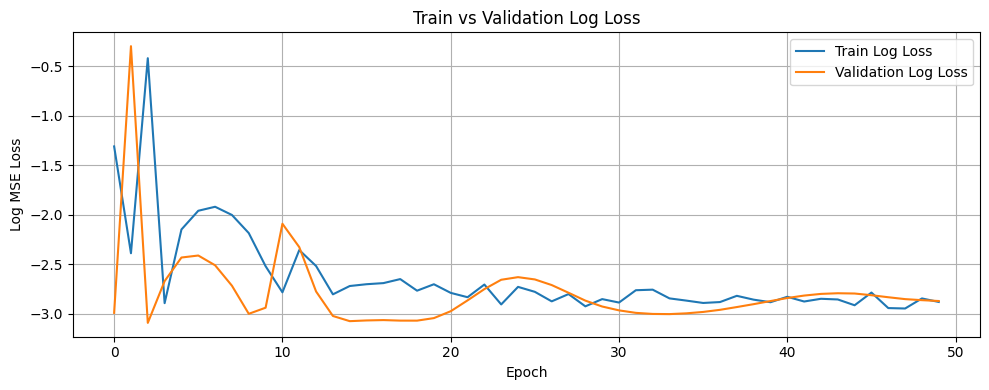

Training completed

=== Processing group: ('01 TO 03', 'BEDOK', '3 ROOM') ===
Group size: 18 rows
Calling prepare_lstm_data for ('01 TO 03', 'BEDOK', '3 ROOM')

Filtering for: BEDOK, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 962
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 35
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1971, Val Loss: 0.0483, Train R²: -2.9875, Val R²: -1.0052
Best model saved!
Epoch 2/50, Train Loss: 0.0761, Val Loss: 0.3847, Train R²: -0.5399, Val R²: -14.9573
Epoch 3/50, Train Loss: 0.4011, Val Loss: 0.0270, Train R²: -7.1168, Val R²: -0.1217
Best model saved!
Epoch 4/50, Train Loss: 0.0560, Val Loss: 0.0753, Train R²: -0.1337, Val R²: -

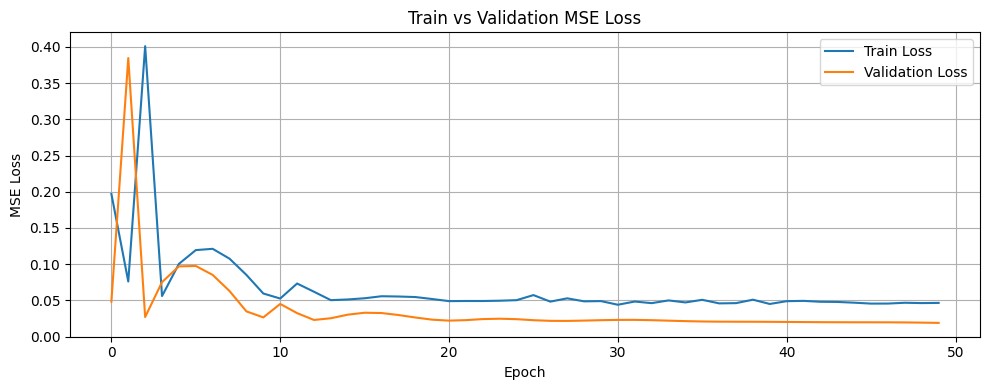

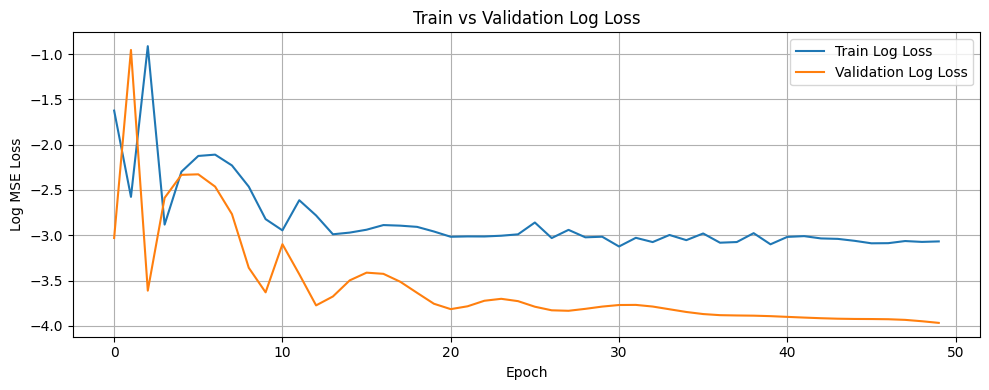

Training completed

=== Processing group: ('01 TO 03', 'BEDOK', '4 ROOM') ===
Group size: 18 rows
Calling prepare_lstm_data for ('01 TO 03', 'BEDOK', '4 ROOM')

Filtering for: BEDOK, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 667
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2238, Val Loss: 0.0556, Train R²: -2.3813, Val R²: -0.1228
Best model saved!
Epoch 2/50, Train Loss: 0.0823, Val Loss: 1.1766, Train R²: -0.2439, Val R²: -22.7494
Epoch 3/50, Train Loss: 1.0777, Val Loss: 0.0462, Train R²: -15.2838, Val R²: 0.0678
Best model saved!
Epoch 4/50, Train Loss: 0.0639, Val Loss: 0.1086, Train R²: 0.0345, Val R²: -1

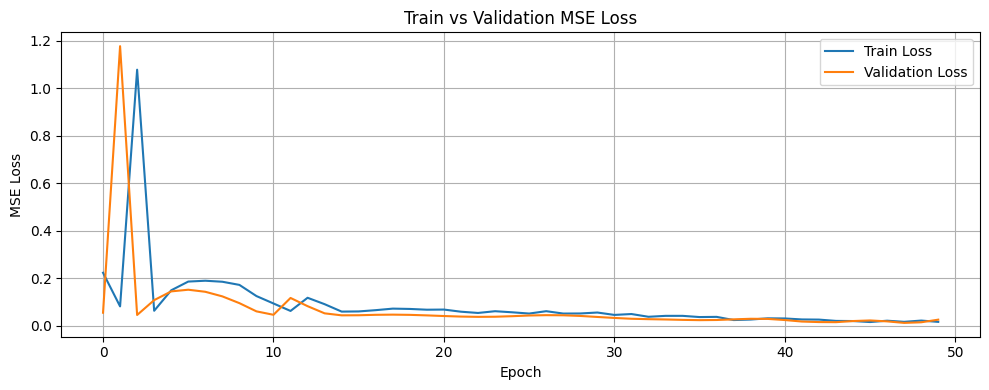

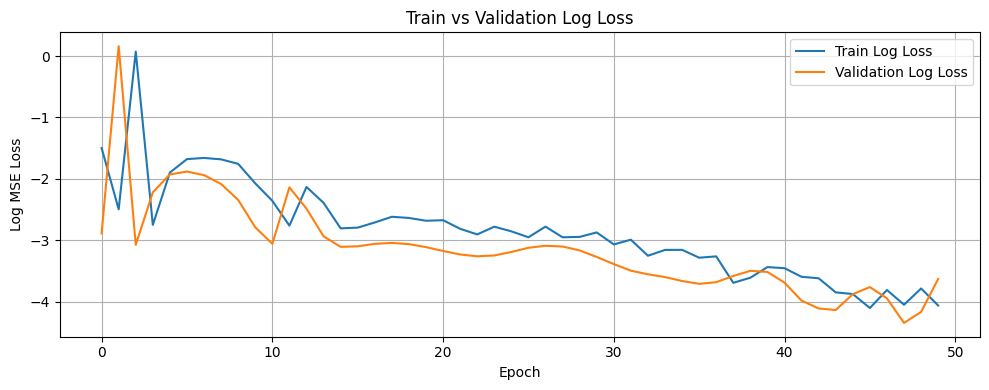

Training completed

=== Processing group: ('01 TO 03', 'BEDOK', '5 ROOM') ===
Group size: 5 rows
Calling prepare_lstm_data for ('01 TO 03', 'BEDOK', '5 ROOM')

Filtering for: BEDOK, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 337
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1467, Val Loss: 0.0809, Train R²: -1.2309, Val R²: -0.2468
Best model saved!
Epoch 2/50, Train Loss: 0.0673, Val Loss: 0.0782, Train R²: -0.0233, Val R²: -0.2056
Best model saved!
Epoch 3/50, Train Loss: 0.1325, Val Loss: 0.1066, Train R²: -1.0141, Val R²: -0.6435
Epoch 4/50, Train Loss: 0.0686, Val Loss: 0.1459, Train R²: -0.0430, Val R²: -1.

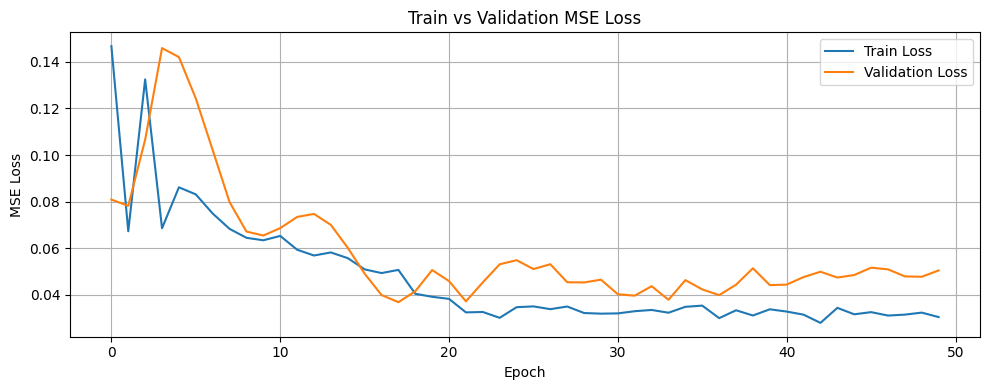

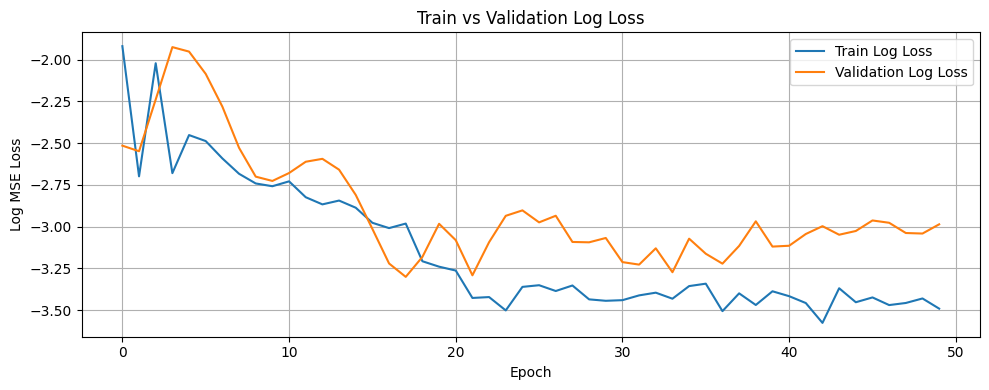

Training completed

=== Processing group: ('01 TO 03', 'BEDOK', 'EXECUTIVE') ===
Group size: 3 rows
Calling prepare_lstm_data for ('01 TO 03', 'BEDOK', 'EXECUTIVE')

Filtering for: BEDOK, EXECUTIVE, 01 TO 03, around 2025-01-01
Initial strict match count: 105
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 32
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1532, Val Loss: 0.0314, Train R²: -1.7762, Val R²: -0.2132
Best model saved!
Epoch 2/50, Train Loss: 0.0554, Val Loss: 0.0333, Train R²: -0.0039, Val R²: -0.2875
Epoch 3/50, Train Loss: 0.0539, Val Loss: 0.0544, Train R²: 0.0225, Val R²: -1.1063
Epoch 4/50, Train Loss: 0.0601, Val Loss: 0.0276, Train R²: -0.0884, Val R²: -0.0688
Best 

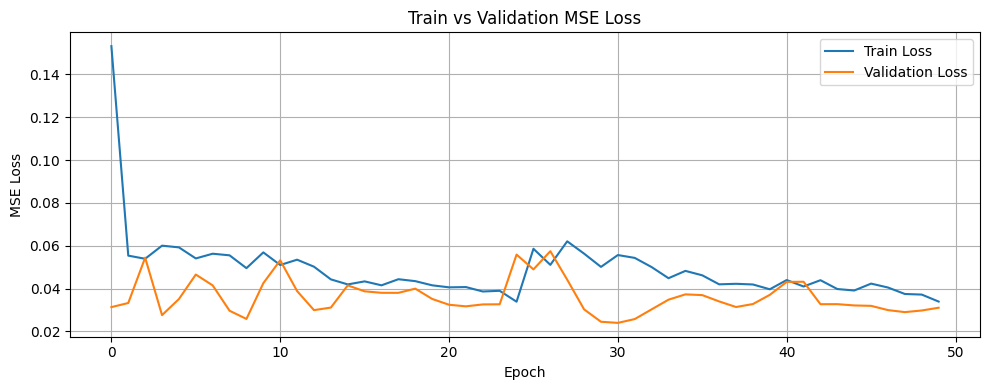

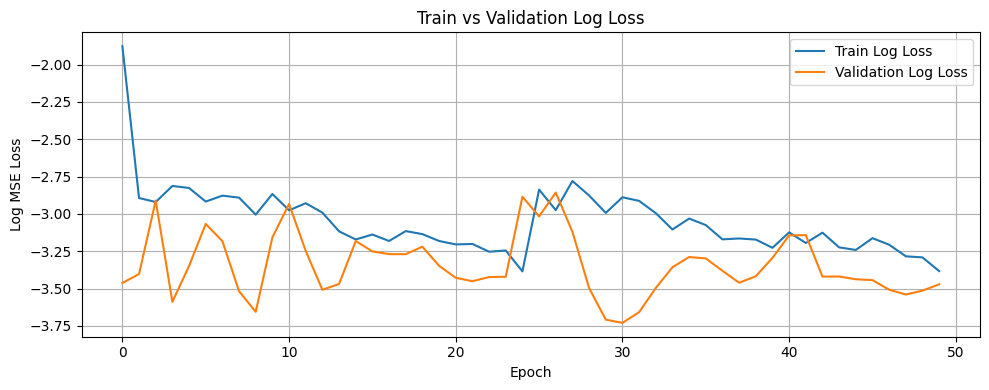

Training completed

=== Processing group: ('01 TO 03', 'BISHAN', '4 ROOM') ===
Group size: 7 rows
Calling prepare_lstm_data for ('01 TO 03', 'BISHAN', '4 ROOM')

Filtering for: BISHAN, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 369
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 40
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1793, Val Loss: 0.0076, Train R²: -2.4855, Val R²: -0.1966
Best model saved!
Epoch 2/50, Train Loss: 0.0511, Val Loss: 0.1497, Train R²: 0.0061, Val R²: -22.4607
Epoch 3/50, Train Loss: 0.2242, Val Loss: 0.0191, Train R²: -3.3579, Val R²: -1.9942
Epoch 4/50, Train Loss: 0.0559, Val Loss: 0.0626, Train R²: -0.0873, Val R²: -8.8077
Epoch 5/50

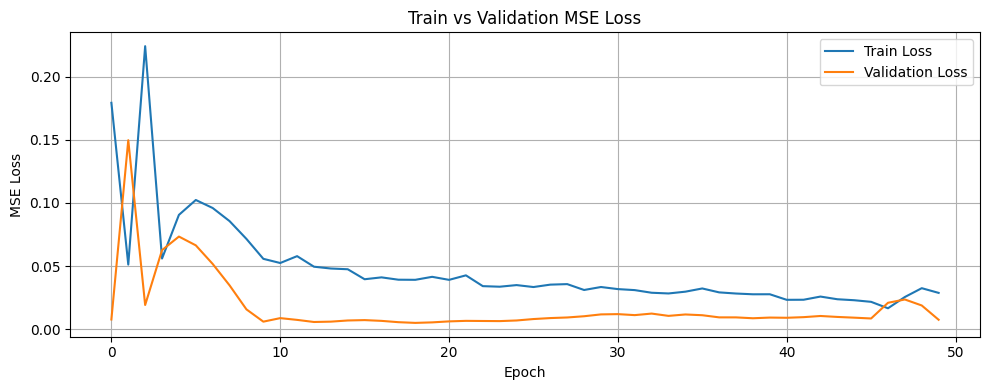

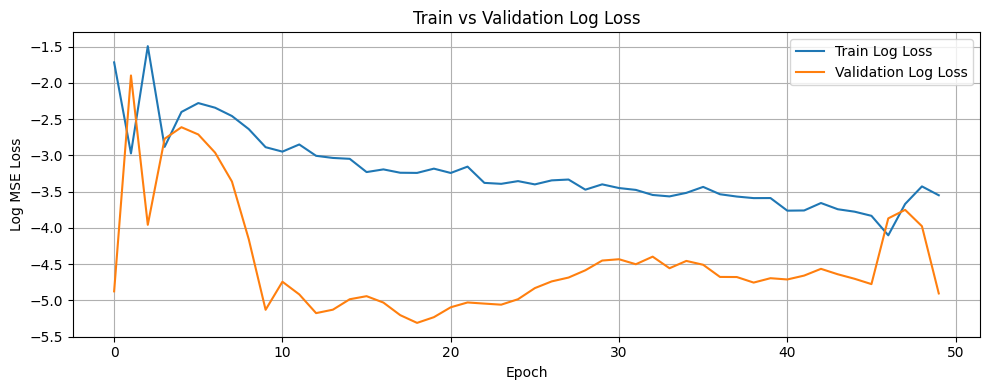

Training completed

=== Processing group: ('01 TO 03', 'BISHAN', '5 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('01 TO 03', 'BISHAN', '5 ROOM')

Filtering for: BISHAN, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 154
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.0629, Val Loss: 0.0868, Train R²: -3.9920, Val R²: -0.6817
Best model saved!
Epoch 2/50, Train Loss: 0.0129, Val Loss: 0.0491, Train R²: -0.0237, Val R²: 0.0491
Best model saved!
Epoch 3/50, Train Loss: 0.0405, Val Loss: 0.1482, Train R²: -2.2124, Val R²: -1.8700
Epoch 4/50, Train Loss: 0.0269, Val Loss: 0.1591, Train R²: -1.1334, Val R²: -

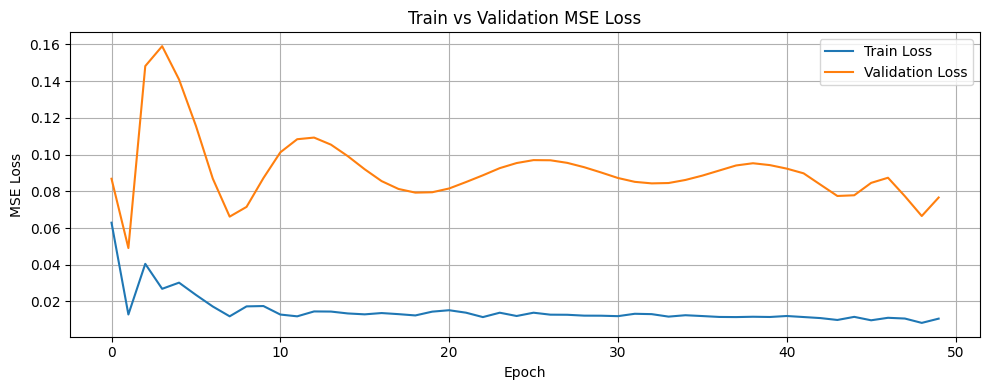

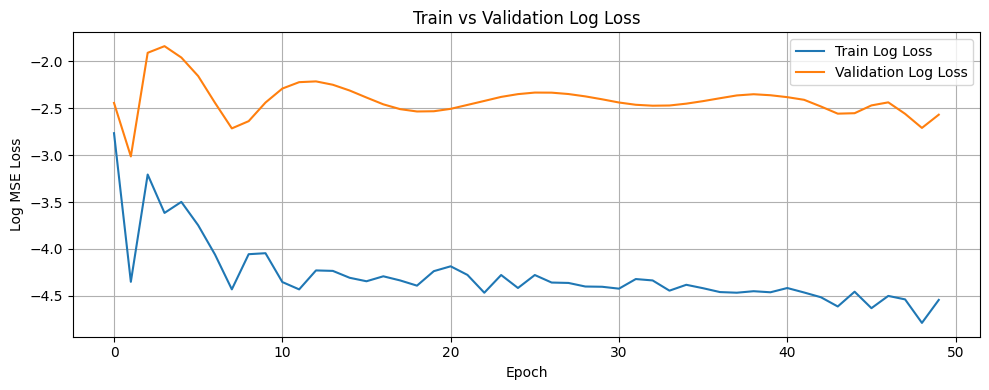

Training completed

=== Processing group: ('01 TO 03', 'BISHAN', 'EXECUTIVE') ===
Group size: 2 rows
Calling prepare_lstm_data for ('01 TO 03', 'BISHAN', 'EXECUTIVE')

Filtering for: BISHAN, EXECUTIVE, 01 TO 03, around 2025-01-01
Initial strict match count: 115
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 38
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1611, Val Loss: 0.1481, Train R²: -2.6829, Val R²: -1.7730
Best model saved!
Epoch 2/50, Train Loss: 0.0566, Val Loss: 0.3982, Train R²: -0.2934, Val R²: -6.4568
Epoch 3/50, Train Loss: 0.6650, Val Loss: 0.1050, Train R²: -14.2071, Val R²: -0.9665
Best model saved!
Epoch 4/50, Train Loss: 0.0466, Val Loss: 0.2284, Train R²: -0.0661

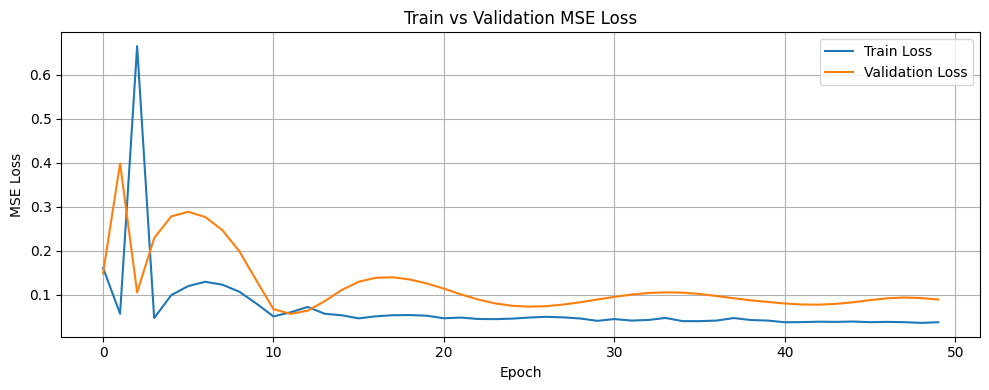

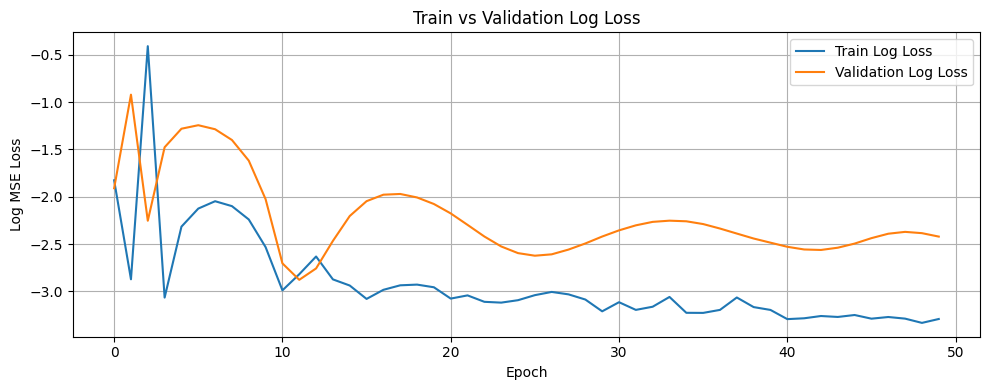

Training completed

=== Processing group: ('01 TO 03', 'BUKIT BATOK', '2 ROOM') ===
Group size: 5 rows
Calling prepare_lstm_data for ('01 TO 03', 'BUKIT BATOK', '2 ROOM')

Filtering for: BUKIT BATOK, 2 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 31
Using before_or_at_target with 30 records.
Removing 'block' column from dataset
Data shapes - x_train: (29, 9), y_train: (29,)
Flattened y shape: (29,), Unique values: 17
Using simple train-validation split (80/20).
Split sizes - Train: 23, Val: 6
Creating PyTorch datasets...
Dataset sizes - Train: 23, Val: 6
Using batch sizes - Train: 23, Val: 6
Starting model training...
Epoch 1/50, Train Loss: 0.3228, Val Loss: 0.0943, Train R²: -4.0801, Val R²: -0.5957
Best model saved!
Epoch 2/50, Train Loss: 0.1156, Val Loss: 0.5562, Train R²: -0.8199, Val R²: -8.4076
Epoch 3/50, Train Loss: 0.5351, Val Loss: 0.0606, Train R²: -7.4222, Val R²: -0.0252
Best model saved!
Epoch 4/50, Train Loss: 0.0735, Val Loss: 0.1030, Train R²: -0.156

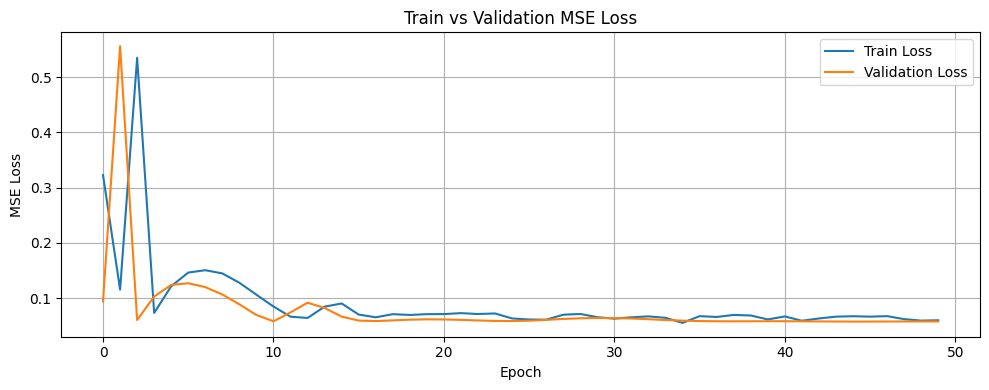

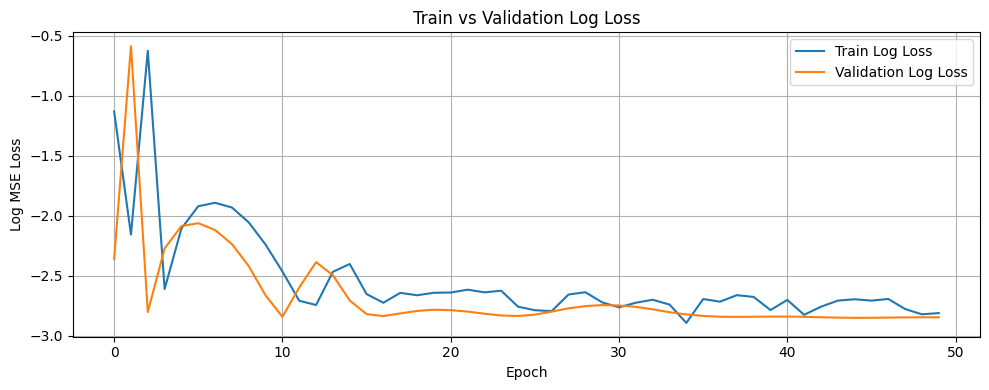

Training completed

=== Processing group: ('01 TO 03', 'BUKIT BATOK', '3 ROOM') ===
Group size: 21 rows
Calling prepare_lstm_data for ('01 TO 03', 'BUKIT BATOK', '3 ROOM')

Filtering for: BUKIT BATOK, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 586
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 29
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1399, Val Loss: 0.0553, Train R²: -1.5890, Val R²: 0.0075
Best model saved!
Epoch 2/50, Train Loss: 0.0552, Val Loss: 0.1954, Train R²: -0.0215, Val R²: -2.5093
Epoch 3/50, Train Loss: 0.1678, Val Loss: 0.0562, Train R²: -2.1059, Val R²: -0.0083
Epoch 4/50, Train Loss: 0.0536, Val Loss: 0.0605, Train R²: 0.0078, Val R²: -0.0

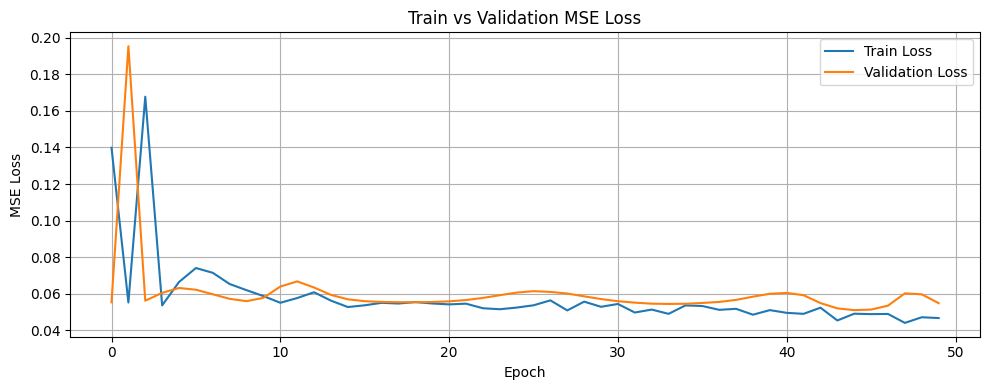

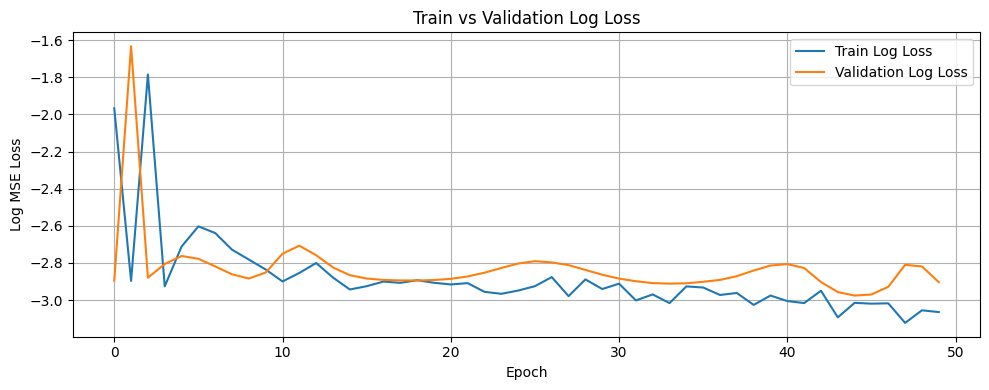

Training completed

=== Processing group: ('01 TO 03', 'BUKIT BATOK', '4 ROOM') ===
Group size: 28 rows
Calling prepare_lstm_data for ('01 TO 03', 'BUKIT BATOK', '4 ROOM')

Filtering for: BUKIT BATOK, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 642
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 38
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3853, Val Loss: 0.0895, Train R²: -5.6250, Val R²: -0.2671
Best model saved!
Epoch 2/50, Train Loss: 0.1324, Val Loss: 0.6660, Train R²: -1.2767, Val R²: -8.4262
Epoch 3/50, Train Loss: 0.4755, Val Loss: 0.0694, Train R²: -7.1772, Val R²: 0.0171
Best model saved!
Epoch 4/50, Train Loss: 0.0727, Val Loss: 0.1074, Train R²: -0

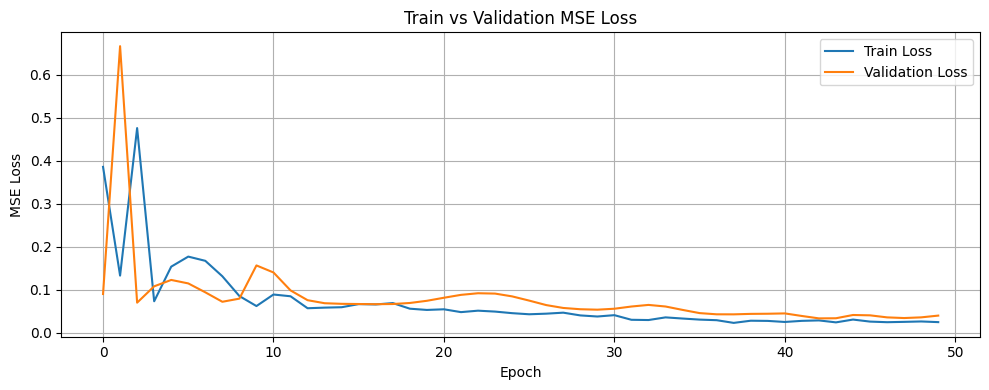

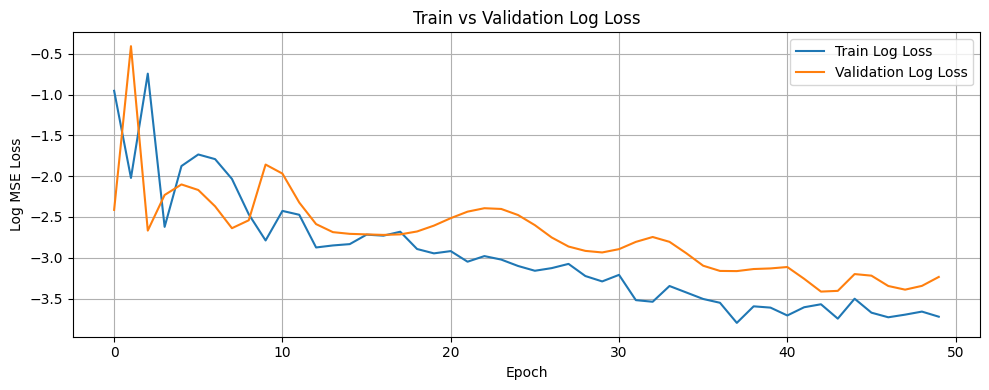

Training completed

=== Processing group: ('01 TO 03', 'BUKIT BATOK', '5 ROOM') ===
Group size: 9 rows
Calling prepare_lstm_data for ('01 TO 03', 'BUKIT BATOK', '5 ROOM')

Filtering for: BUKIT BATOK, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 174
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.4800, Val Loss: 0.1351, Train R²: -14.8605, Val R²: -5.2153
Best model saved!
Epoch 2/50, Train Loss: 0.1504, Val Loss: 0.4239, Train R²: -3.9699, Val R²: -18.5083
Epoch 3/50, Train Loss: 0.4448, Val Loss: 0.0384, Train R²: -13.6962, Val R²: -0.7652
Best model saved!
Epoch 4/50, Train Loss: 0.0498, Val Loss: 0.1155, Train R²:

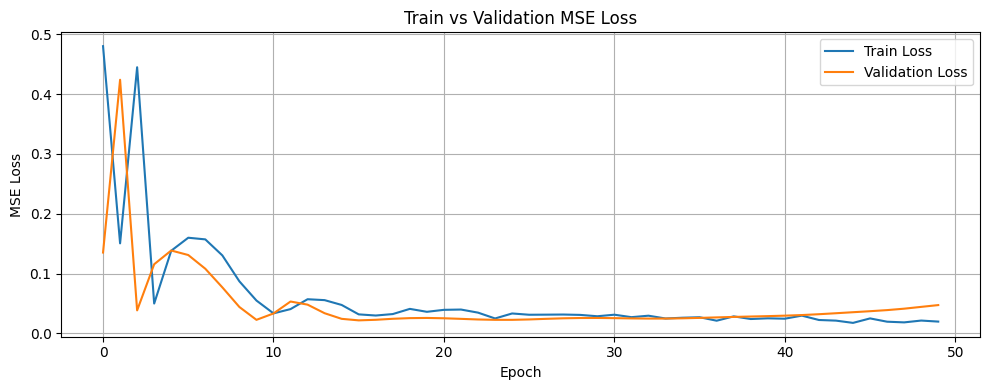

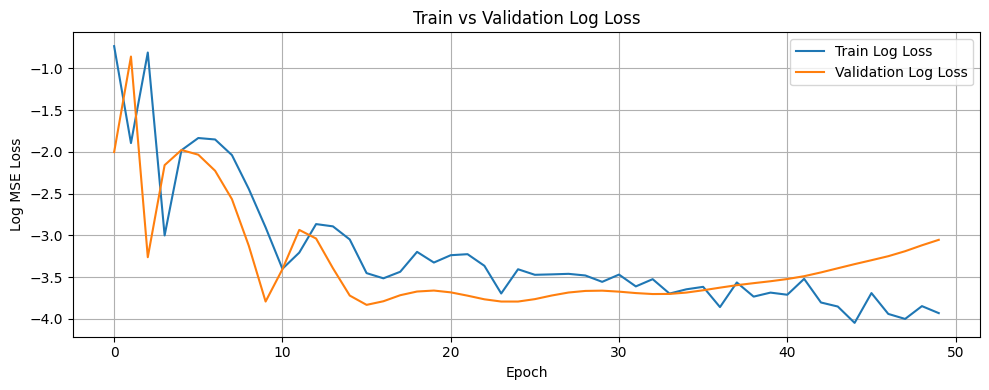

Training completed

=== Processing group: ('01 TO 03', 'BUKIT BATOK', 'EXECUTIVE') ===
Group size: 4 rows
Calling prepare_lstm_data for ('01 TO 03', 'BUKIT BATOK', 'EXECUTIVE')

Filtering for: BUKIT BATOK, EXECUTIVE, 01 TO 03, around 2025-01-01
Initial strict match count: 146
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 35
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1184, Val Loss: 0.0401, Train R²: -2.1549, Val R²: -0.2212
Best model saved!
Epoch 2/50, Train Loss: 0.0462, Val Loss: 0.0489, Train R²: -0.2310, Val R²: -0.4884
Epoch 3/50, Train Loss: 0.0393, Val Loss: 0.0455, Train R²: -0.0474, Val R²: -0.3854
Epoch 4/50, Train Loss: 0.0402, Val Loss: 0.0374, Train R²: -0.0720, Va

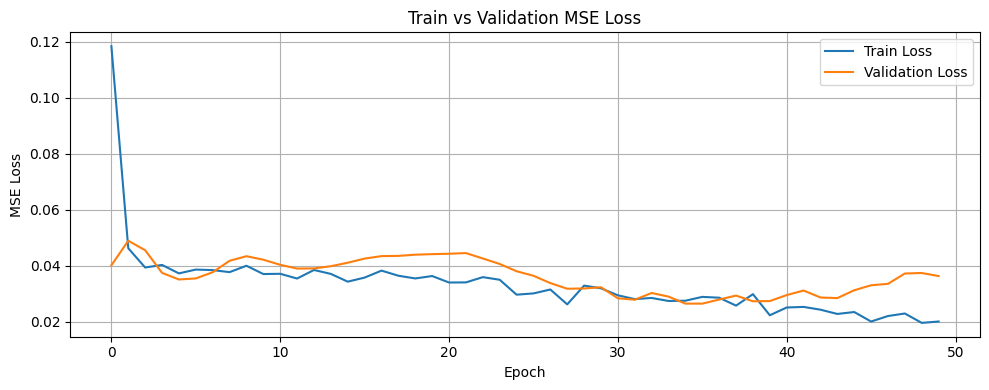

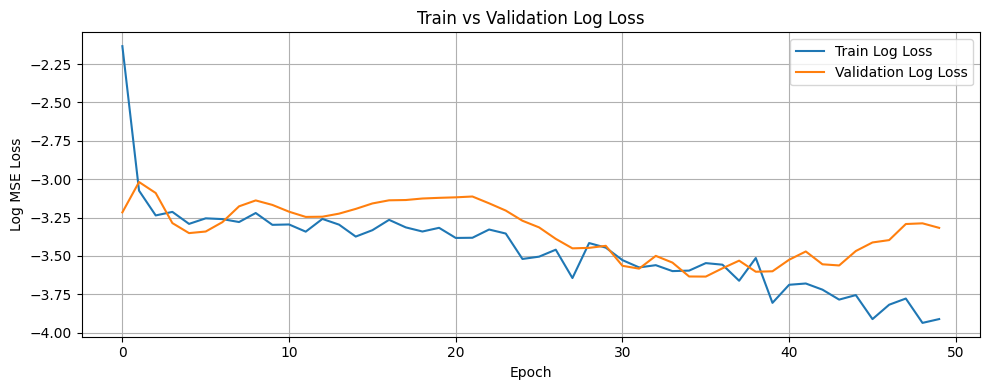

Training completed

=== Processing group: ('01 TO 03', 'BUKIT MERAH', '2 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('01 TO 03', 'BUKIT MERAH', '2 ROOM')

Filtering for: BUKIT MERAH, 2 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 52
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 35
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1052, Val Loss: 0.0598, Train R²: -0.4263, Val R²: -1.8254
Best model saved!
Epoch 2/50, Train Loss: 0.0966, Val Loss: 0.0223, Train R²: -0.3103, Val R²: -0.0546
Best model saved!
Epoch 3/50, Train Loss: 0.0757, Val Loss: 0.0213, Train R²: -0.0269, Val R²: -0.0079
Best model saved!
Epoch 4/50, Train Loss: 0.0781, Val Loss: 0.0

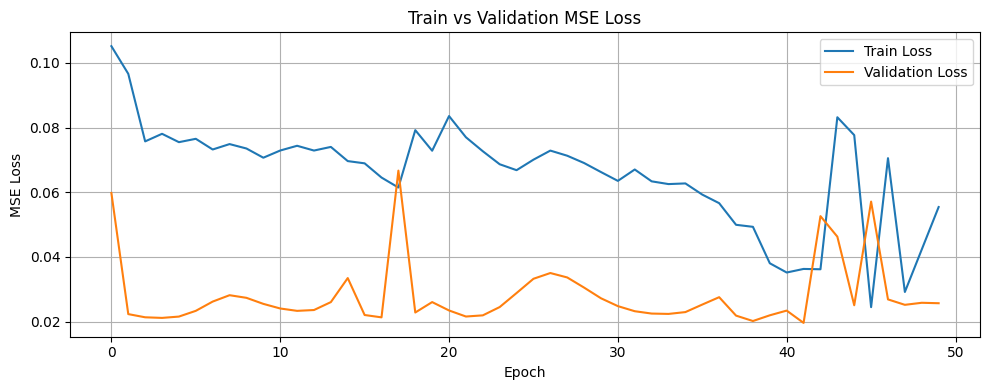

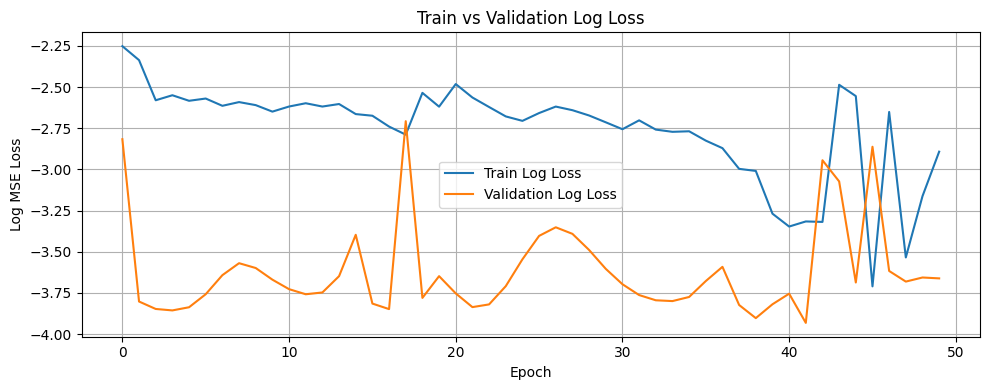

Training completed

=== Processing group: ('01 TO 03', 'BUKIT MERAH', '3 ROOM') ===
Group size: 13 rows
Calling prepare_lstm_data for ('01 TO 03', 'BUKIT MERAH', '3 ROOM')

Filtering for: BUKIT MERAH, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 505
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 38
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1916, Val Loss: 0.0932, Train R²: -0.9228, Val R²: -0.0286
Best model saved!
Epoch 2/50, Train Loss: 0.1059, Val Loss: 0.1938, Train R²: -0.0632, Val R²: -1.1399
Epoch 3/50, Train Loss: 0.1680, Val Loss: 0.1642, Train R²: -0.6862, Val R²: -0.8128
Epoch 4/50, Train Loss: 0.1439, Val Loss: 0.1202, Train R²: -0.4440, Val R²: -0

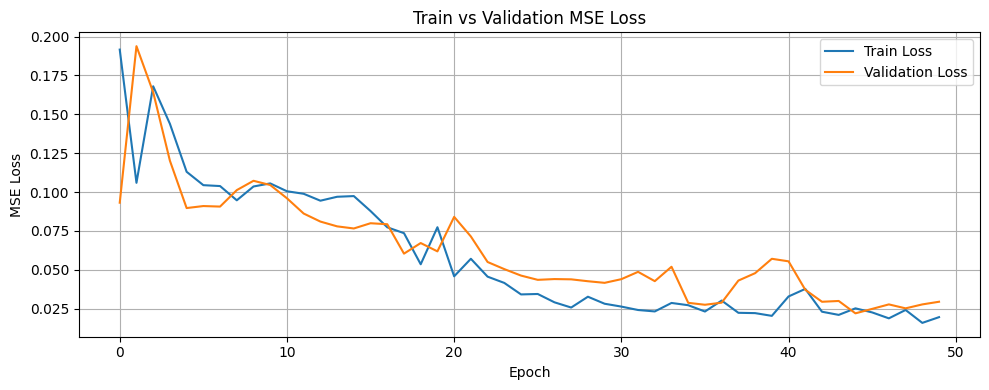

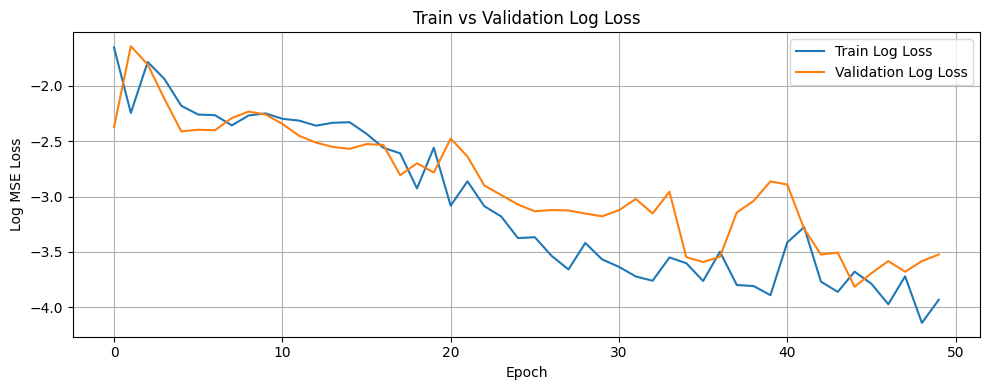

Training completed

=== Processing group: ('01 TO 03', 'BUKIT MERAH', '4 ROOM') ===
Group size: 14 rows
Calling prepare_lstm_data for ('01 TO 03', 'BUKIT MERAH', '4 ROOM')

Filtering for: BUKIT MERAH, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 363
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 42
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2237, Val Loss: 0.0499, Train R²: -2.2490, Val R²: -0.4588
Best model saved!
Epoch 2/50, Train Loss: 0.0768, Val Loss: 0.8021, Train R²: -0.1147, Val R²: -22.4274
Epoch 3/50, Train Loss: 0.9688, Val Loss: 0.0383, Train R²: -13.0704, Val R²: -0.1177
Best model saved!
Epoch 4/50, Train Loss: 0.0622, Val Loss: 0.1207, Train R²:

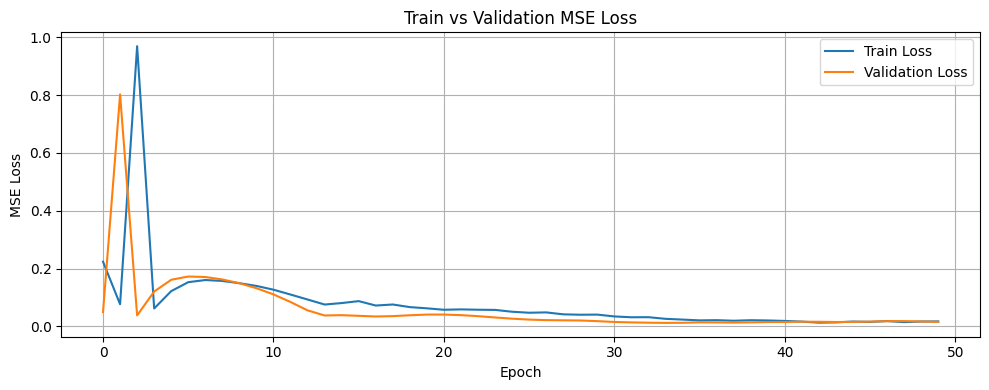

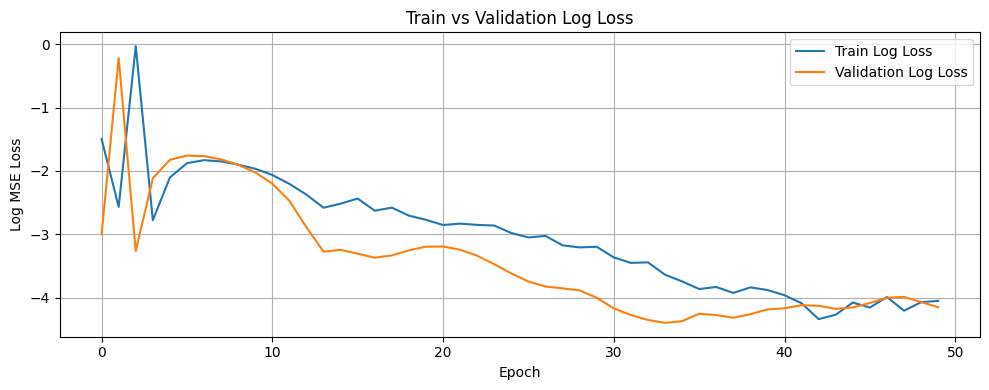

Training completed

=== Processing group: ('01 TO 03', 'BUKIT MERAH', '5 ROOM') ===
Group size: 5 rows
Calling prepare_lstm_data for ('01 TO 03', 'BUKIT MERAH', '5 ROOM')

Filtering for: BUKIT MERAH, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 183
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 44
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2034, Val Loss: 0.0149, Train R²: -3.4210, Val R²: -0.8914
Best model saved!
Epoch 2/50, Train Loss: 0.0521, Val Loss: 0.3547, Train R²: -0.1316, Val R²: -43.9581
Epoch 3/50, Train Loss: 0.3623, Val Loss: 0.0076, Train R²: -6.8745, Val R²: 0.0424
Best model saved!
Epoch 4/50, Train Loss: 0.0511, Val Loss: 0.0304, Train R²: -0

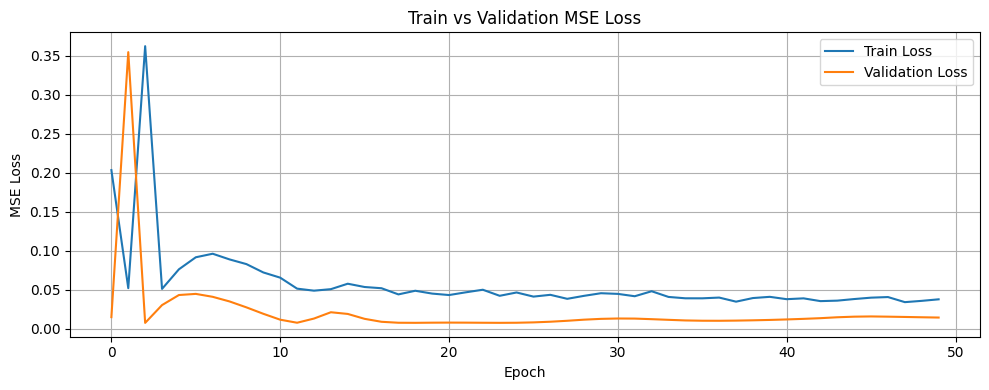

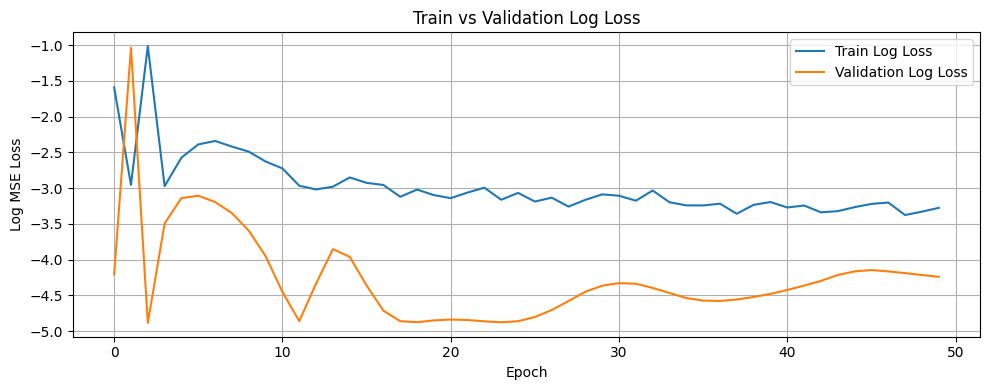

Training completed

=== Processing group: ('01 TO 03', 'BUKIT PANJANG', '2 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('01 TO 03', 'BUKIT PANJANG', '2 ROOM')

Filtering for: BUKIT PANJANG, 2 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 13
Using before_or_at_target with 12 records.
Removing 'block' column from dataset
Data shapes - x_train: (11, 9), y_train: (11,)
Flattened y shape: (11,), Unique values: 10
Using simple train-validation split (80/20).
Split sizes - Train: 8, Val: 3
Creating PyTorch datasets...
Dataset sizes - Train: 8, Val: 3
Using batch sizes - Train: 8, Val: 3
Starting model training...
Epoch 1/50, Train Loss: 0.1918, Val Loss: 0.1446, Train R²: -0.7891, Val R²: -0.0120
Best model saved!
Epoch 2/50, Train Loss: 0.1017, Val Loss: 0.1437, Train R²: 0.0517, Val R²: -0.0056
Best model saved!
Epoch 3/50, Train Loss: 0.1101, Val Loss: 0.1546, Train R²: -0.0272, Val R²: -0.0822
Epoch 4/50, Train Loss: 0.1146, Val Loss: 0.1638, Train R²: -0.0

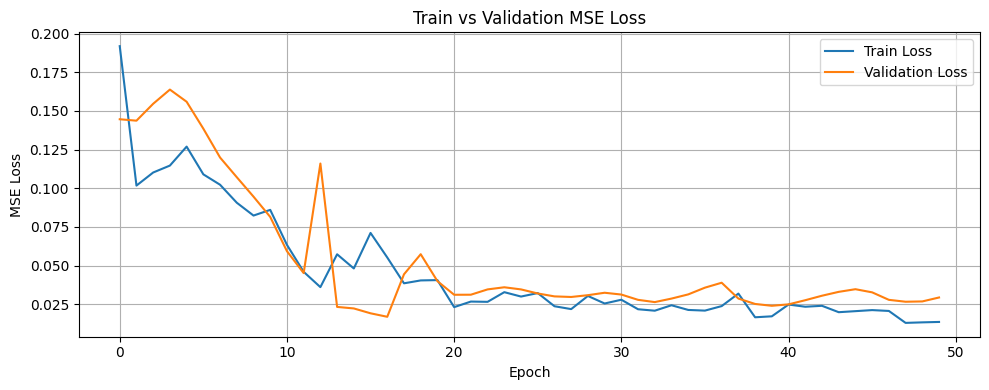

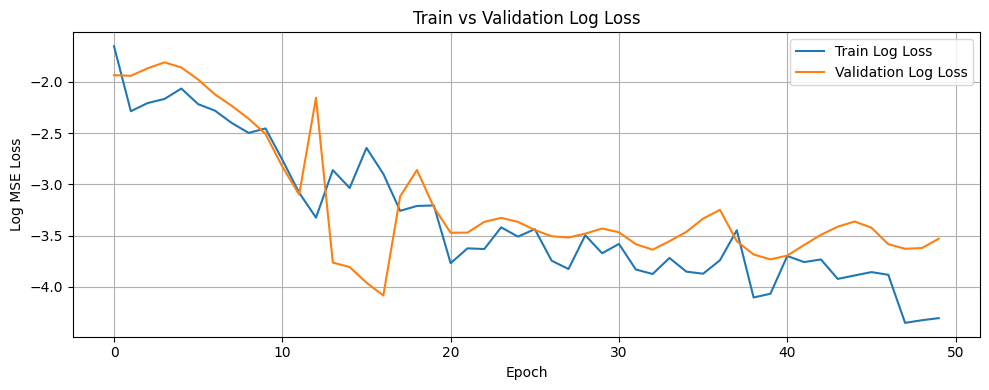

Training completed

=== Processing group: ('01 TO 03', 'BUKIT PANJANG', '3 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('01 TO 03', 'BUKIT PANJANG', '3 ROOM')

Filtering for: BUKIT PANJANG, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 179
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 29
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2499, Val Loss: 0.0349, Train R²: -2.6767, Val R²: -0.4728
Best model saved!
Epoch 2/50, Train Loss: 0.0758, Val Loss: 0.9254, Train R²: -0.1148, Val R²: -38.0124
Epoch 3/50, Train Loss: 1.0189, Val Loss: 0.0247, Train R²: -13.9910, Val R²: -0.0434
Best model saved!
Epoch 4/50, Train Loss: 0.0654, Val Loss: 0.0749, Trai

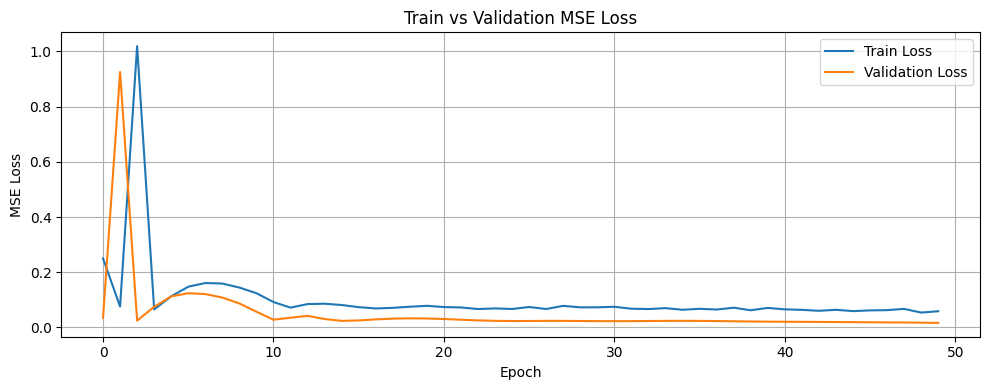

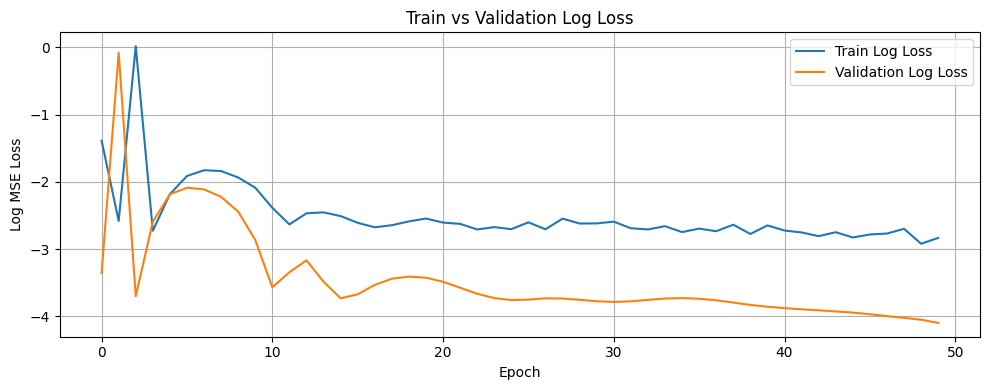

Training completed

=== Processing group: ('01 TO 03', 'BUKIT PANJANG', '4 ROOM') ===
Group size: 11 rows
Calling prepare_lstm_data for ('01 TO 03', 'BUKIT PANJANG', '4 ROOM')

Filtering for: BUKIT PANJANG, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 508
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 33
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1162, Val Loss: 0.0403, Train R²: -1.7067, Val R²: -0.0202
Best model saved!
Epoch 2/50, Train Loss: 0.0477, Val Loss: 0.0380, Train R²: -0.1105, Val R²: 0.0368
Best model saved!
Epoch 3/50, Train Loss: 0.0429, Val Loss: 0.0382, Train R²: 0.0014, Val R²: 0.0315
Epoch 4/50, Train Loss: 0.0440, Val Loss: 0.0371, Train R²

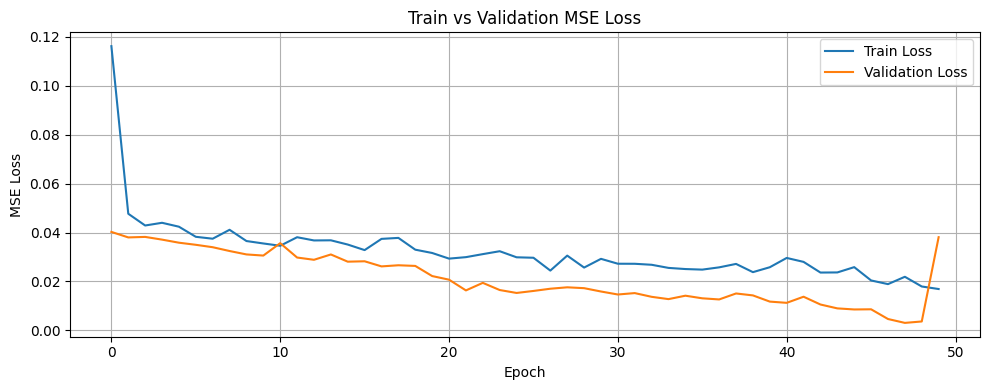

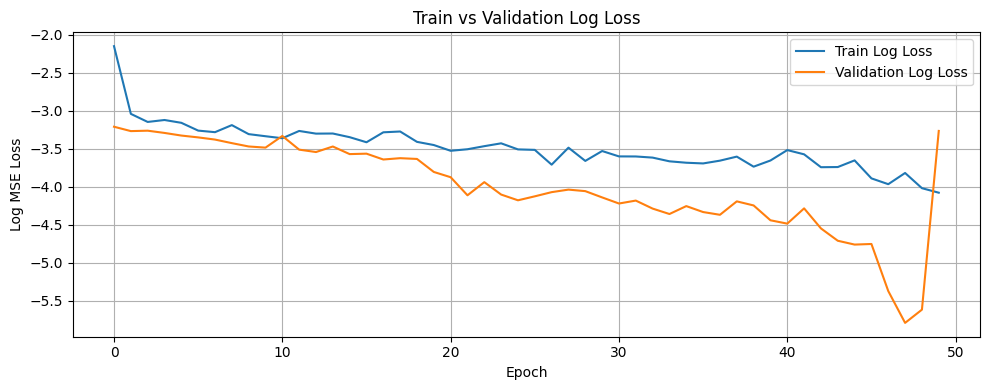

Training completed

=== Processing group: ('01 TO 03', 'BUKIT PANJANG', '5 ROOM') ===
Group size: 9 rows
Calling prepare_lstm_data for ('01 TO 03', 'BUKIT PANJANG', '5 ROOM')

Filtering for: BUKIT PANJANG, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 291
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 33
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1599, Val Loss: 0.1338, Train R²: -3.4986, Val R²: -1.2019
Best model saved!
Epoch 2/50, Train Loss: 0.0434, Val Loss: 0.2474, Train R²: -0.2205, Val R²: -3.0690
Epoch 3/50, Train Loss: 0.3741, Val Loss: 0.0991, Train R²: -9.5256, Val R²: -0.6304
Best model saved!
Epoch 4/50, Train Loss: 0.0367, Val Loss: 0.1858, Train 

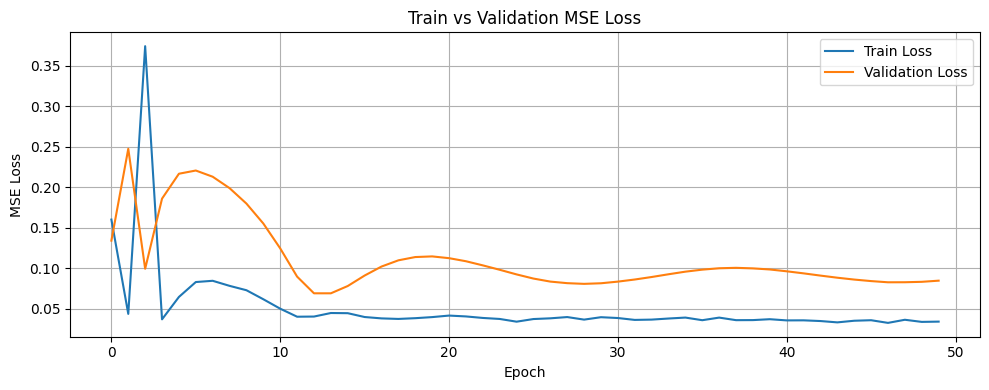

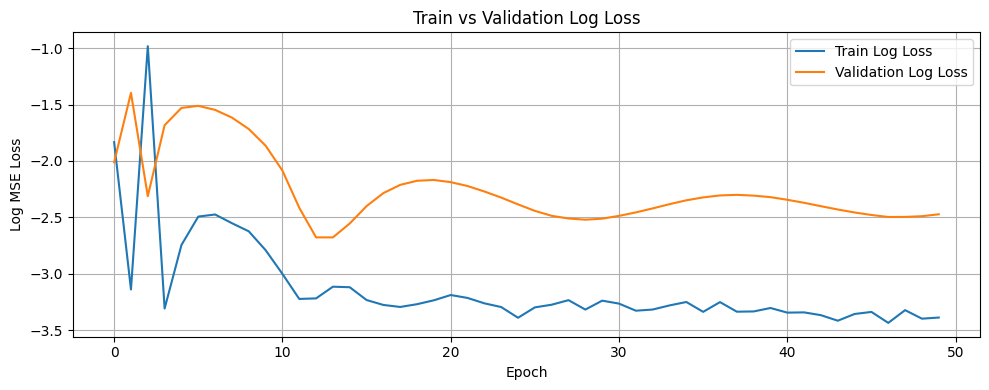

Training completed

=== Processing group: ('01 TO 03', 'BUKIT PANJANG', 'EXECUTIVE') ===
Group size: 10 rows
Calling prepare_lstm_data for ('01 TO 03', 'BUKIT PANJANG', 'EXECUTIVE')

Filtering for: BUKIT PANJANG, EXECUTIVE, 01 TO 03, around 2025-01-01
Initial strict match count: 154
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 38
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.4298, Val Loss: 0.2218, Train R²: -7.5605, Val R²: -5.3017
Best model saved!
Epoch 2/50, Train Loss: 0.2085, Val Loss: 0.4240, Train R²: -3.1519, Val R²: -11.0489
Epoch 3/50, Train Loss: 0.5320, Val Loss: 0.1026, Train R²: -9.5952, Val R²: -1.9162
Best model saved!
Epoch 4/50, Train Loss: 0.1079, Val Loss: 0.2

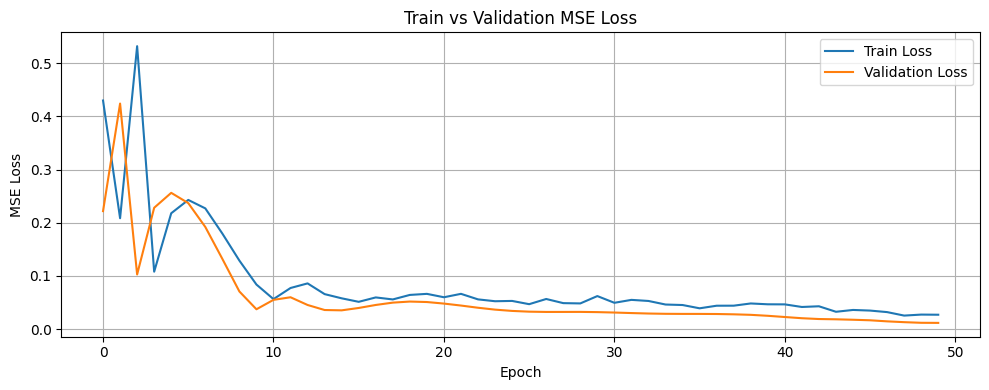

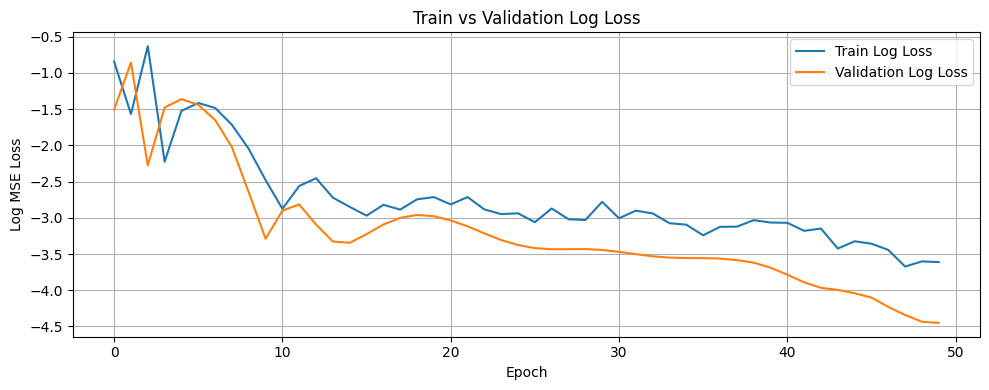

Training completed

=== Processing group: ('01 TO 03', 'BUKIT TIMAH', '4 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('01 TO 03', 'BUKIT TIMAH', '4 ROOM')

Filtering for: BUKIT TIMAH, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 30
Using before_or_at_target with 30 records.
Removing 'block' column from dataset
Data shapes - x_train: (29, 9), y_train: (29,)
Flattened y shape: (29,), Unique values: 28
Using simple train-validation split (80/20).
Split sizes - Train: 23, Val: 6
Creating PyTorch datasets...
Dataset sizes - Train: 23, Val: 6
Using batch sizes - Train: 23, Val: 6
Starting model training...
Epoch 1/50, Train Loss: 0.1712, Val Loss: 0.1125, Train R²: -1.1815, Val R²: -0.9069
Best model saved!
Epoch 2/50, Train Loss: 0.0802, Val Loss: 0.1088, Train R²: -0.0227, Val R²: -0.8447
Best model saved!
Epoch 3/50, Train Loss: 0.2520, Val Loss: 0.1002, Train R²: -2.2125, Val R²: -0.6981
Best model saved!
Epoch 4/50, Train Loss: 0.0787, Val Loss: 0.1590

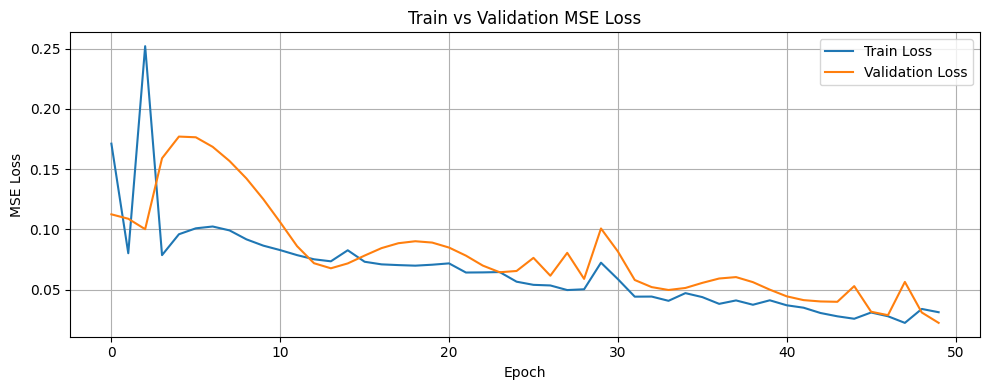

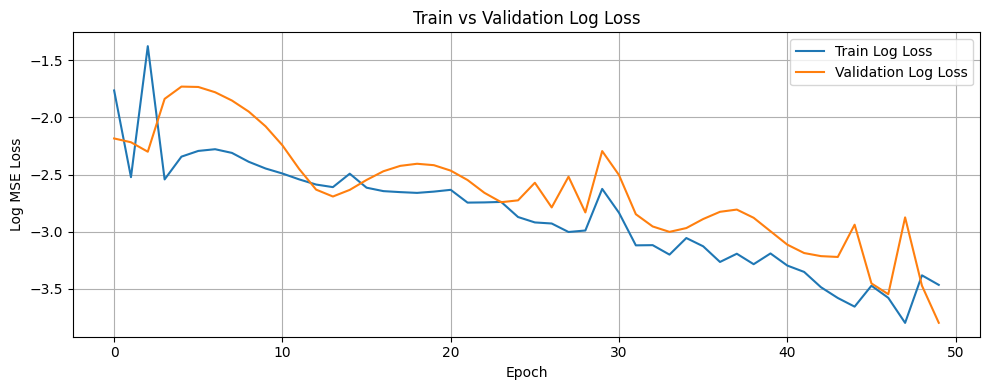

Training completed

=== Processing group: ('01 TO 03', 'CENTRAL AREA', '4 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('01 TO 03', 'CENTRAL AREA', '4 ROOM')

Filtering for: CENTRAL AREA, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 30
Using before_or_at_target with 30 records.
Removing 'block' column from dataset
Data shapes - x_train: (29, 9), y_train: (29,)
Flattened y shape: (29,), Unique values: 24
Using simple train-validation split (80/20).
Split sizes - Train: 23, Val: 6
Creating PyTorch datasets...
Dataset sizes - Train: 23, Val: 6
Using batch sizes - Train: 23, Val: 6
Starting model training...
Epoch 1/50, Train Loss: 0.0707, Val Loss: 0.0332, Train R²: -1.1420, Val R²: -0.4046
Best model saved!
Epoch 2/50, Train Loss: 0.0546, Val Loss: 0.0294, Train R²: -0.6553, Val R²: -0.2458
Best model saved!
Epoch 3/50, Train Loss: 0.0344, Val Loss: 0.0384, Train R²: -0.0410, Val R²: -0.6257
Epoch 4/50, Train Loss: 0.0399, Val Loss: 0.0380, Train R²: -0.

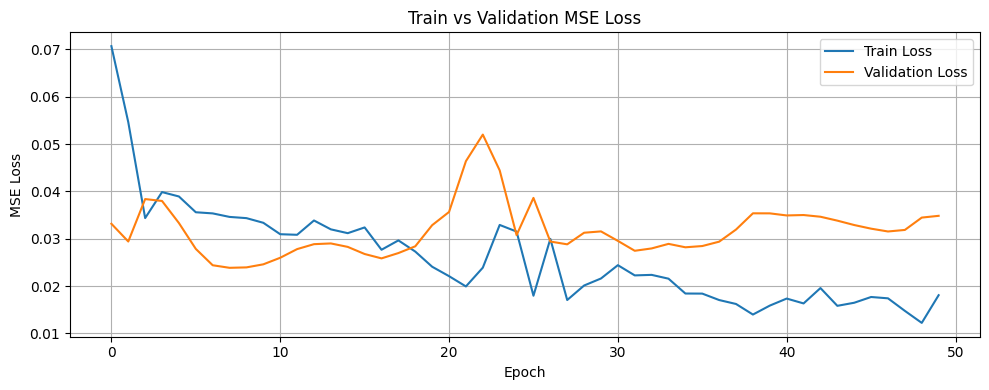

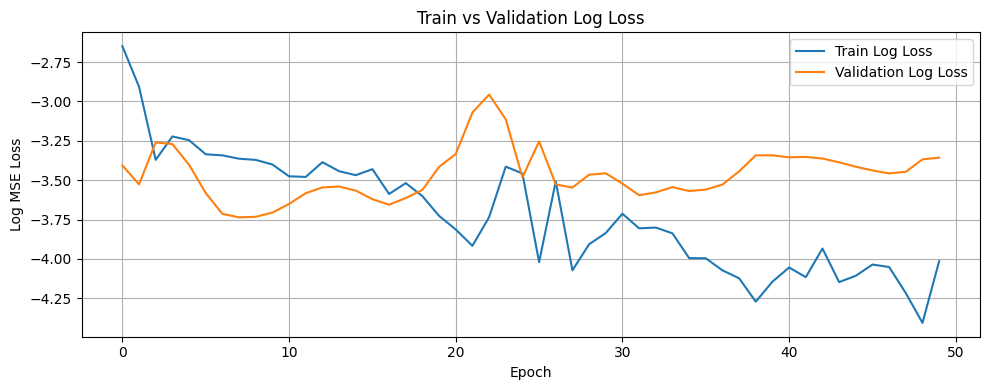

Training completed

=== Processing group: ('01 TO 03', 'CHOA CHU KANG', '3 ROOM') ===
Group size: 2 rows
Calling prepare_lstm_data for ('01 TO 03', 'CHOA CHU KANG', '3 ROOM')

Filtering for: CHOA CHU KANG, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 93
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 33
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1878, Val Loss: 0.0979, Train R²: -2.4249, Val R²: -0.7843
Best model saved!
Epoch 2/50, Train Loss: 0.0589, Val Loss: 0.4643, Train R²: -0.0748, Val R²: -7.4654
Epoch 3/50, Train Loss: 0.6329, Val Loss: 0.0743, Train R²: -10.5401, Val R²: -0.3551
Best model saved!
Epoch 4/50, Train Loss: 0.0539, Val Loss: 0.1658, Train 

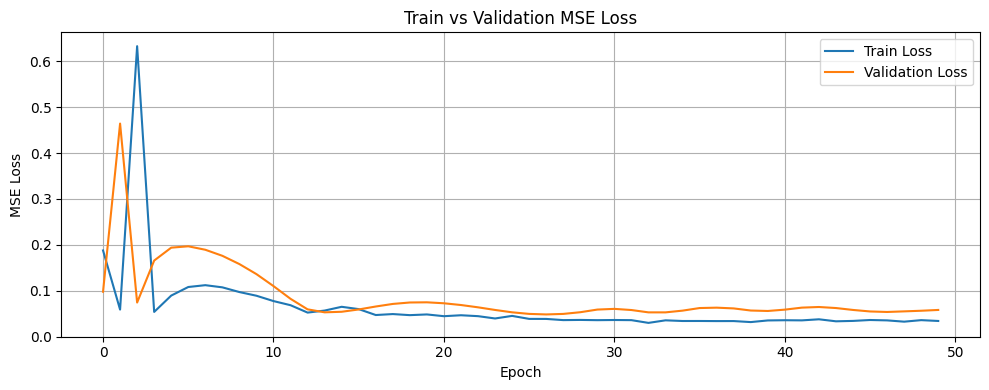

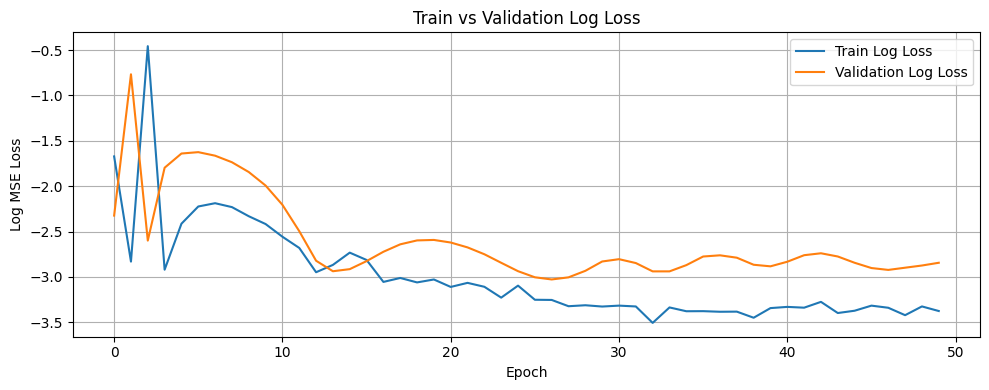

Training completed

=== Processing group: ('01 TO 03', 'CHOA CHU KANG', '4 ROOM') ===
Group size: 23 rows
Calling prepare_lstm_data for ('01 TO 03', 'CHOA CHU KANG', '4 ROOM')

Filtering for: CHOA CHU KANG, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 829
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 33
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2914, Val Loss: 0.1342, Train R²: -4.2821, Val R²: -0.8173
Best model saved!
Epoch 2/50, Train Loss: 0.1002, Val Loss: 0.3635, Train R²: -0.8169, Val R²: -3.9226
Epoch 3/50, Train Loss: 0.3697, Val Loss: 0.0805, Train R²: -5.7014, Val R²: -0.0901
Best model saved!
Epoch 4/50, Train Loss: 0.0611, Val Loss: 0.1398, Train

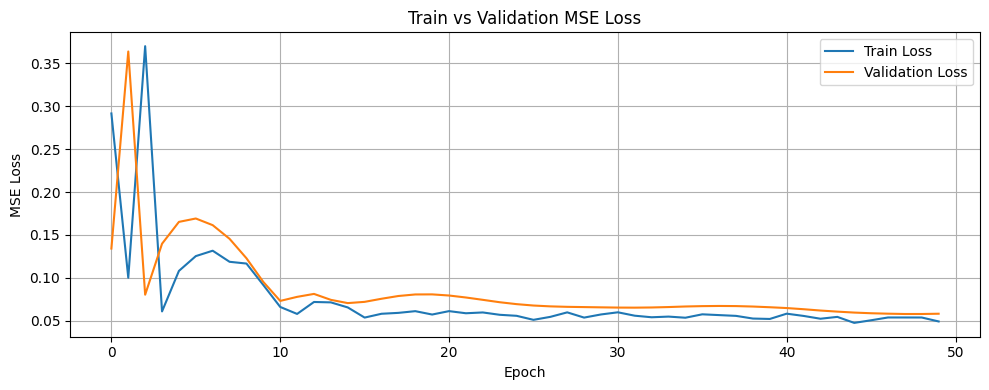

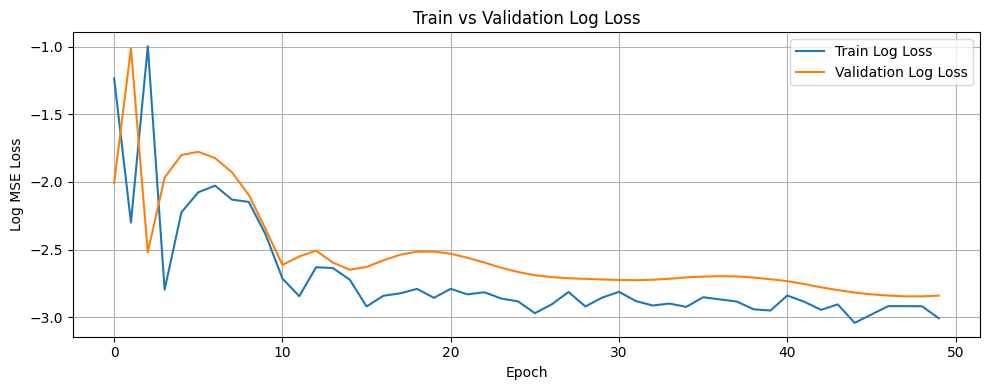

Training completed

=== Processing group: ('01 TO 03', 'CHOA CHU KANG', '5 ROOM') ===
Group size: 7 rows
Calling prepare_lstm_data for ('01 TO 03', 'CHOA CHU KANG', '5 ROOM')

Filtering for: CHOA CHU KANG, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 474
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 35
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3422, Val Loss: 0.1492, Train R²: -4.6547, Val R²: -3.1372
Best model saved!
Epoch 2/50, Train Loss: 0.1122, Val Loss: 0.1316, Train R²: -0.8544, Val R²: -2.6490
Best model saved!
Epoch 3/50, Train Loss: 0.2439, Val Loss: 0.0678, Train R²: -3.0307, Val R²: -0.8792
Best model saved!
Epoch 4/50, Train Loss: 0.0675, Val Lo

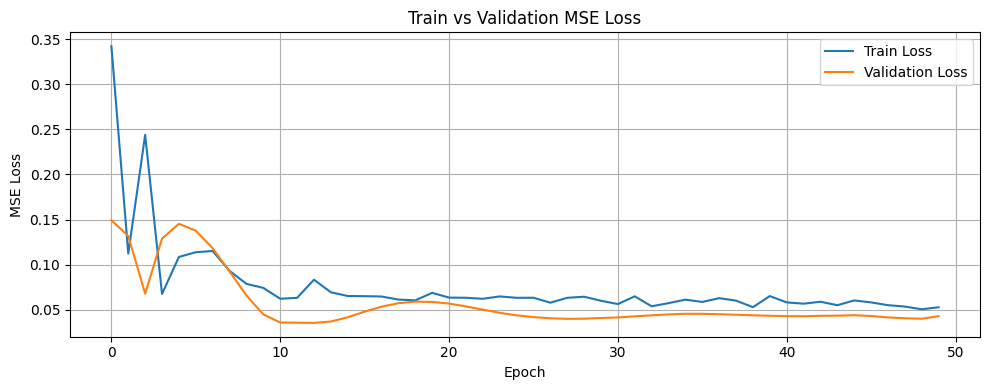

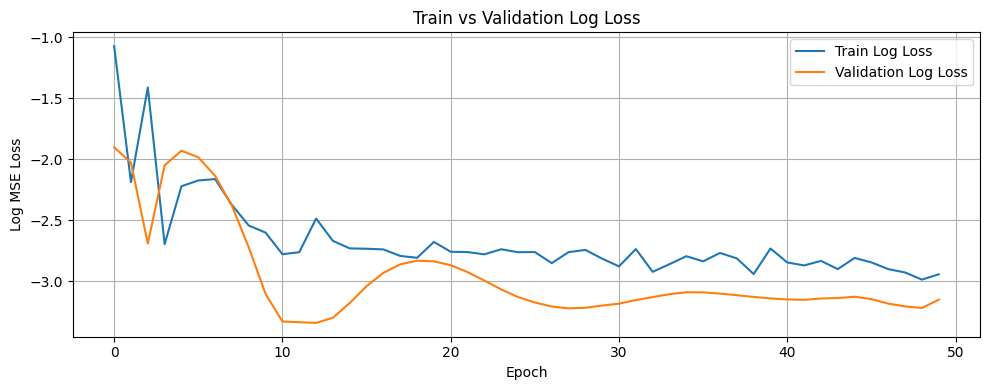

Training completed

=== Processing group: ('01 TO 03', 'CHOA CHU KANG', 'EXECUTIVE') ===
Group size: 6 rows
Calling prepare_lstm_data for ('01 TO 03', 'CHOA CHU KANG', 'EXECUTIVE')

Filtering for: CHOA CHU KANG, EXECUTIVE, 01 TO 03, around 2025-01-01
Initial strict match count: 173
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 32
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2670, Val Loss: 0.1144, Train R²: -3.9257, Val R²: -0.4200
Best model saved!
Epoch 2/50, Train Loss: 0.0789, Val Loss: 1.1741, Train R²: -0.4560, Val R²: -13.5787
Epoch 3/50, Train Loss: 1.2141, Val Loss: 0.0890, Train R²: -21.3958, Val R²: -0.1053
Best model saved!
Epoch 4/50, Train Loss: 0.0614, Val Loss: 0.1

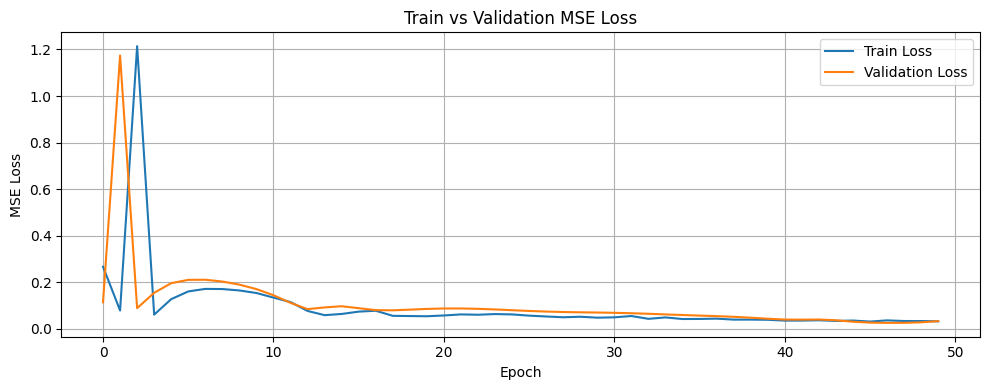

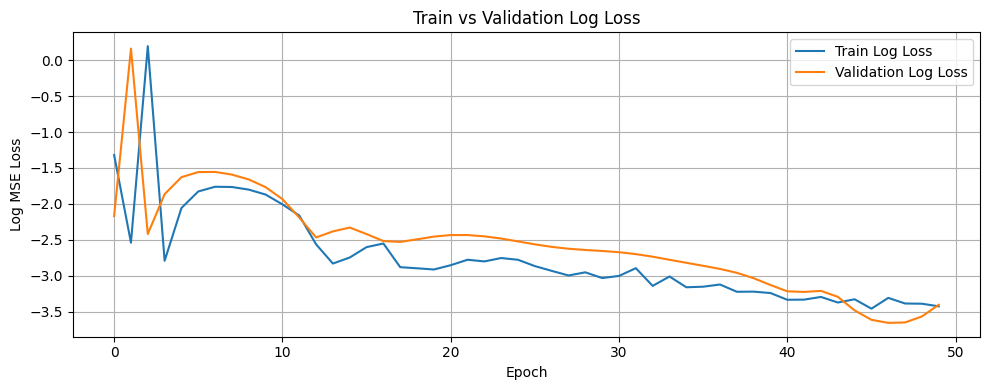

Training completed

=== Processing group: ('01 TO 03', 'CLEMENTI', '3 ROOM') ===
Group size: 12 rows
Calling prepare_lstm_data for ('01 TO 03', 'CLEMENTI', '3 ROOM')

Filtering for: CLEMENTI, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 426
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 28
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.0612, Val Loss: 0.0150, Train R²: -1.6368, Val R²: -0.3945
Best model saved!
Epoch 2/50, Train Loss: 0.0311, Val Loss: 0.0125, Train R²: -0.3381, Val R²: -0.1686
Best model saved!
Epoch 3/50, Train Loss: 0.0248, Val Loss: 0.0159, Train R²: -0.0671, Val R²: -0.4807
Epoch 4/50, Train Loss: 0.0275, Val Loss: 0.0129, Train R²: -0.1854, V

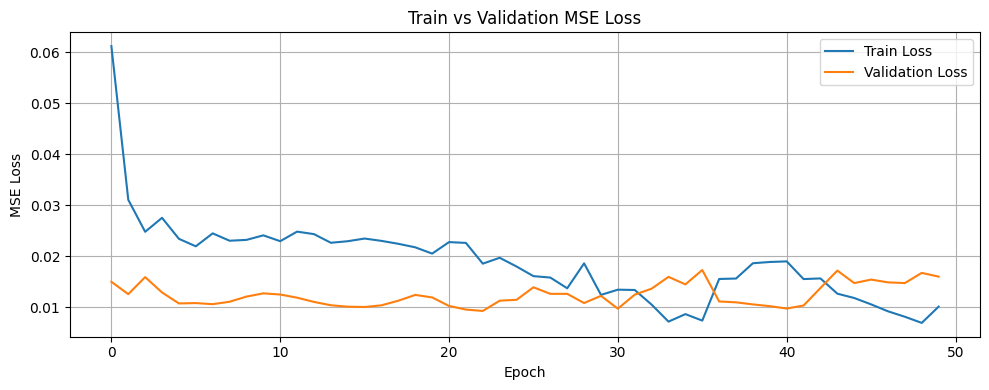

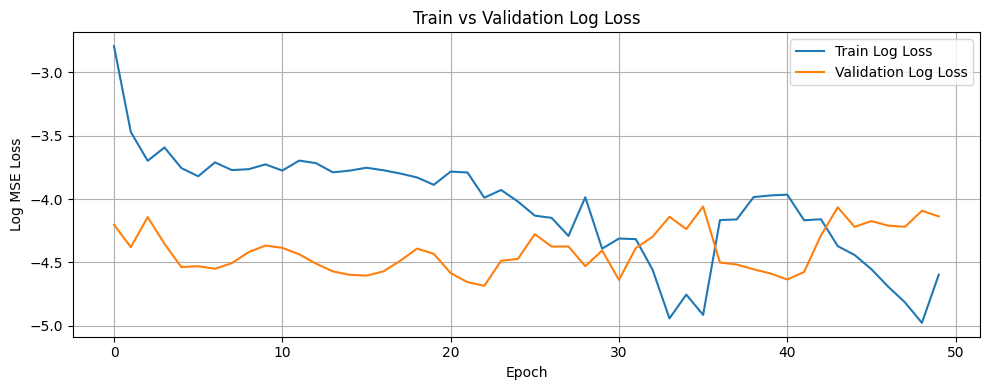

Training completed

=== Processing group: ('01 TO 03', 'CLEMENTI', '4 ROOM') ===
Group size: 4 rows
Calling prepare_lstm_data for ('01 TO 03', 'CLEMENTI', '4 ROOM')

Filtering for: CLEMENTI, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 207
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 32
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.0739, Val Loss: 0.0866, Train R²: -1.6475, Val R²: -0.2286
Best model saved!
Epoch 2/50, Train Loss: 0.0559, Val Loss: 0.0830, Train R²: -1.0016, Val R²: -0.1776
Best model saved!
Epoch 3/50, Train Loss: 0.0339, Val Loss: 0.0916, Train R²: -0.2146, Val R²: -0.2994
Epoch 4/50, Train Loss: 0.0413, Val Loss: 0.0862, Train R²: -0.4783, Va

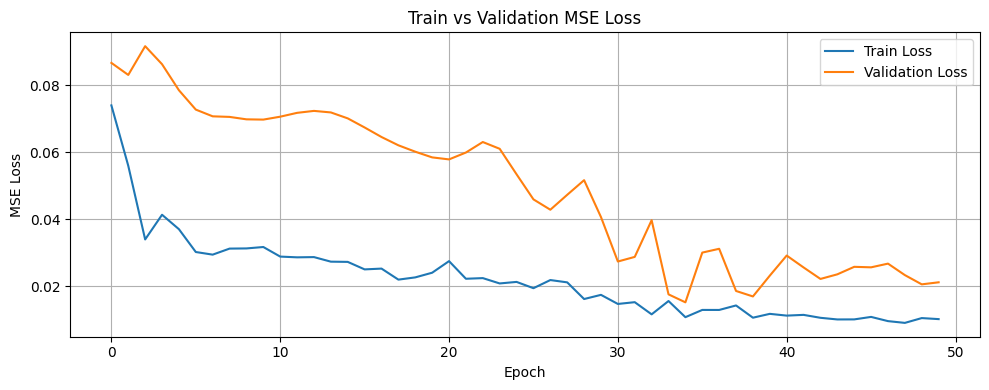

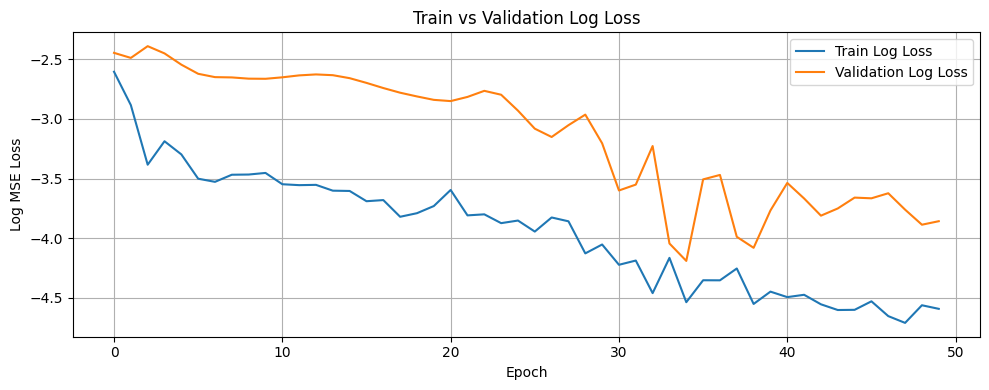

Training completed

=== Processing group: ('01 TO 03', 'GEYLANG', '3 ROOM') ===
Group size: 15 rows
Calling prepare_lstm_data for ('01 TO 03', 'GEYLANG', '3 ROOM')

Filtering for: GEYLANG, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 493
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 33
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.0870, Val Loss: 0.0513, Train R²: -0.7475, Val R²: -0.0749
Best model saved!
Epoch 2/50, Train Loss: 0.0518, Val Loss: 0.0729, Train R²: -0.0411, Val R²: -0.5252
Epoch 3/50, Train Loss: 0.0828, Val Loss: 0.0564, Train R²: -0.6621, Val R²: -0.1812
Epoch 4/50, Train Loss: 0.0647, Val Loss: 0.0417, Train R²: -0.2994, Val R²: 0.1267
Best mo

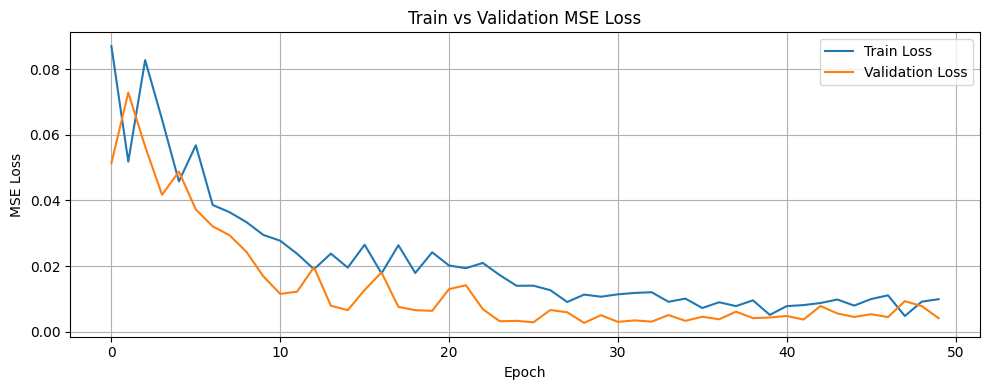

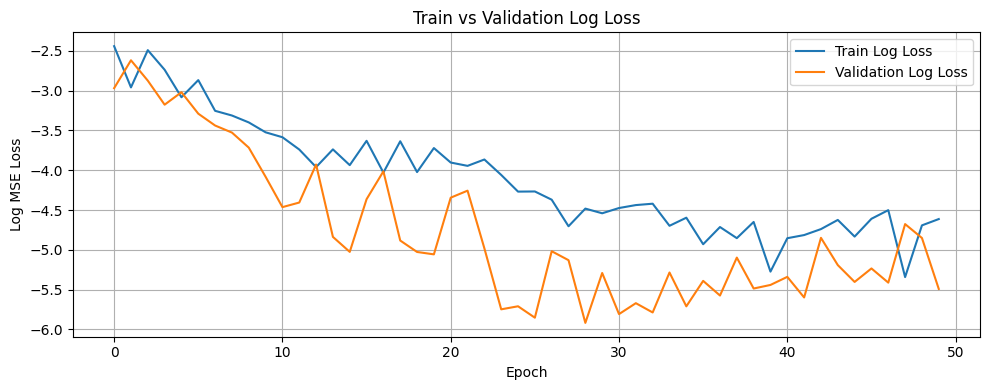

Training completed

=== Processing group: ('01 TO 03', 'GEYLANG', '4 ROOM') ===
Group size: 6 rows
Calling prepare_lstm_data for ('01 TO 03', 'GEYLANG', '4 ROOM')

Filtering for: GEYLANG, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 305
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 44
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1632, Val Loss: 0.1155, Train R²: -0.4430, Val R²: -0.0211
Best model saved!
Epoch 2/50, Train Loss: 0.1481, Val Loss: 0.1761, Train R²: -0.3095, Val R²: -0.5573
Epoch 3/50, Train Loss: 0.1127, Val Loss: 0.1940, Train R²: 0.0037, Val R²: -0.7156
Epoch 4/50, Train Loss: 0.1234, Val Loss: 0.1785, Train R²: -0.0914, Val R²: -0.5787
Epoch 5/

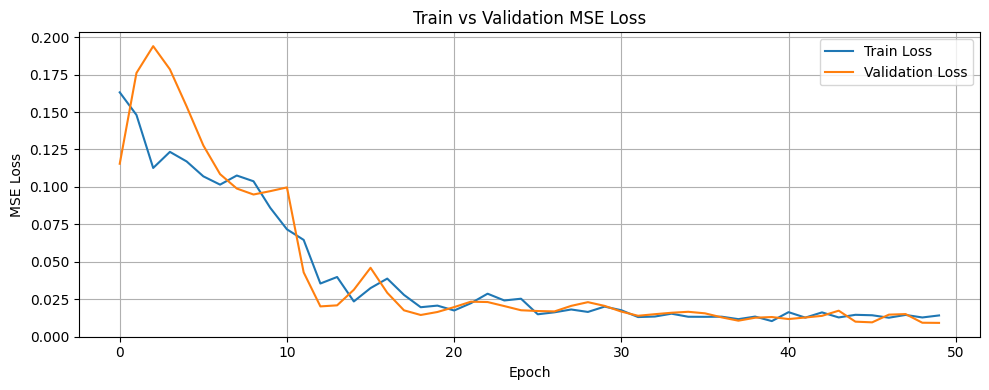

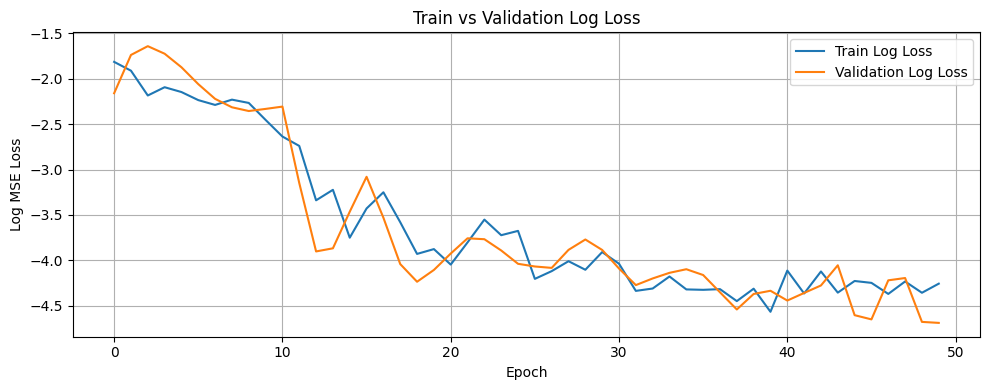

Training completed

=== Processing group: ('01 TO 03', 'GEYLANG', '5 ROOM') ===
Group size: 7 rows
Calling prepare_lstm_data for ('01 TO 03', 'GEYLANG', '5 ROOM')

Filtering for: GEYLANG, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 103
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 46
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2641, Val Loss: 0.1186, Train R²: -2.9567, Val R²: -2.7288
Best model saved!
Epoch 2/50, Train Loss: 0.1037, Val Loss: 0.1690, Train R²: -0.5530, Val R²: -4.3146
Epoch 3/50, Train Loss: 0.2804, Val Loss: 0.0582, Train R²: -3.2012, Val R²: -0.8295
Best model saved!
Epoch 4/50, Train Loss: 0.0684, Val Loss: 0.1197, Train R²: -0.0255, Val R

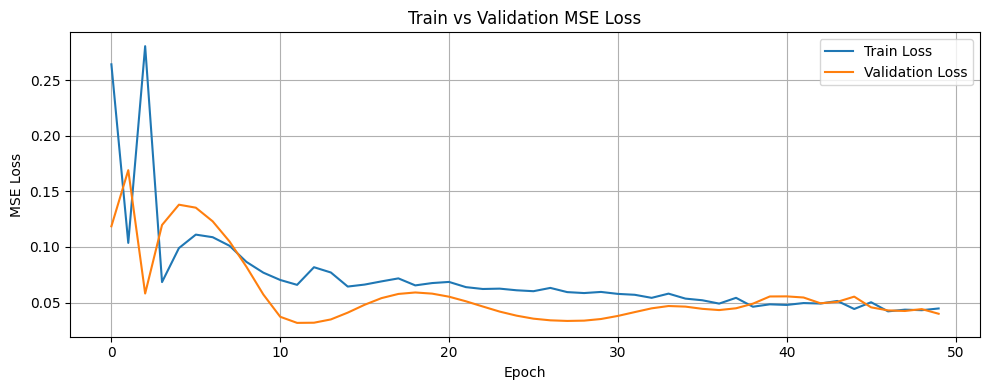

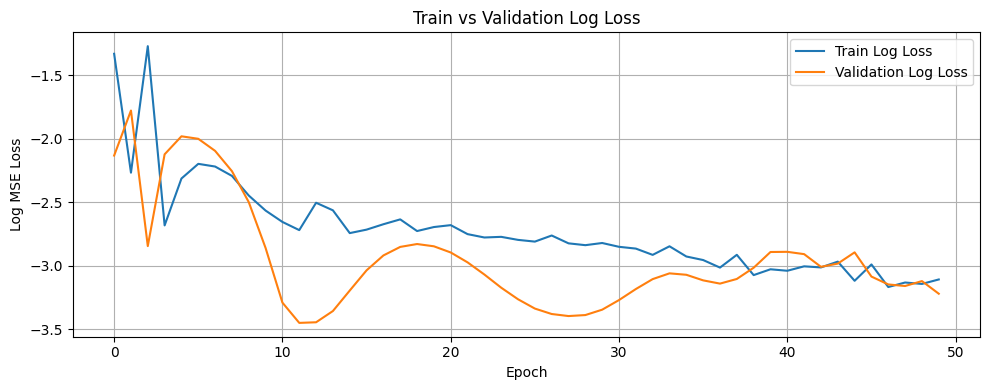

Training completed

=== Processing group: ('01 TO 03', 'HOUGANG', '2 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('01 TO 03', 'HOUGANG', '2 ROOM')

Filtering for: HOUGANG, 2 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 19
Using before_or_at_target with 19 records.
Removing 'block' column from dataset
Data shapes - x_train: (18, 9), y_train: (18,)
Flattened y shape: (18,), Unique values: 14
Using simple train-validation split (80/20).
Split sizes - Train: 14, Val: 4
Creating PyTorch datasets...
Dataset sizes - Train: 14, Val: 4
Using batch sizes - Train: 14, Val: 4
Starting model training...
Epoch 1/50, Train Loss: 0.3694, Val Loss: 0.0956, Train R²: -1.7696, Val R²: -0.2348
Best model saved!
Epoch 2/50, Train Loss: 0.1702, Val Loss: 0.8847, Train R²: -0.2763, Val R²: -10.4283
Epoch 3/50, Train Loss: 0.5323, Val Loss: 0.1449, Train R²: -2.9906, Val R²: -0.8724
Epoch 4/50, Train Loss: 0.1350, Val Loss: 0.0875, Train R²: -0.0124, Val R²: -0.1302
Best model

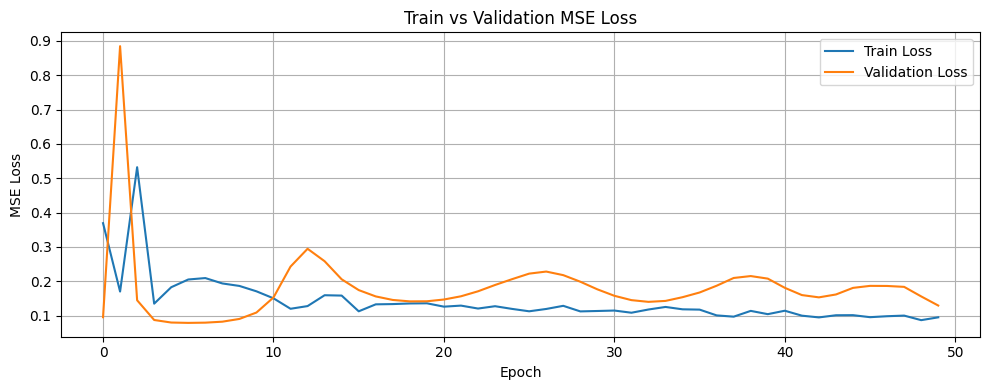

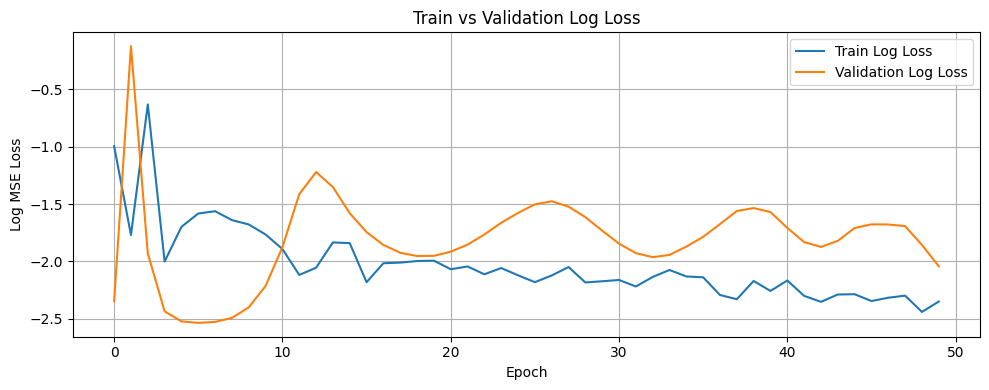

Training completed

=== Processing group: ('01 TO 03', 'HOUGANG', '3 ROOM') ===
Group size: 18 rows
Calling prepare_lstm_data for ('01 TO 03', 'HOUGANG', '3 ROOM')

Filtering for: HOUGANG, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 505
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 32
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2822, Val Loss: 0.0963, Train R²: -6.5182, Val R²: -3.8173
Best model saved!
Epoch 2/50, Train Loss: 0.0784, Val Loss: 0.3708, Train R²: -1.0877, Val R²: -17.5515
Epoch 3/50, Train Loss: 0.4360, Val Loss: 0.0303, Train R²: -10.6161, Val R²: -0.5174
Best model saved!
Epoch 4/50, Train Loss: 0.0353, Val Loss: 0.1005, Train R²: 0.0598, Val

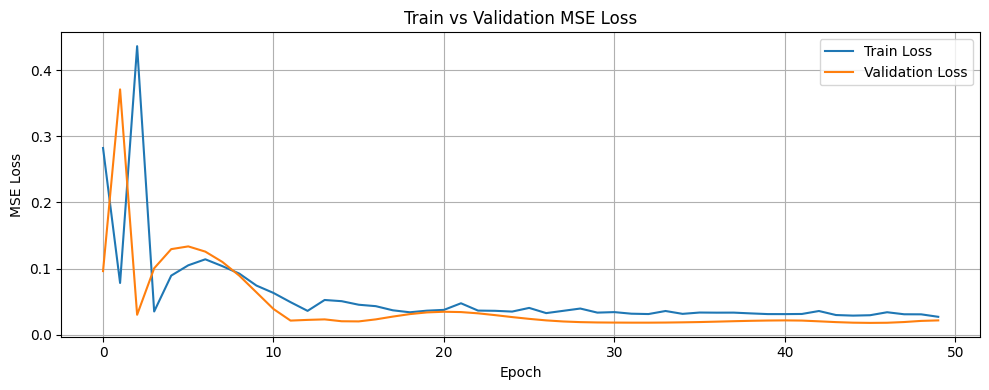

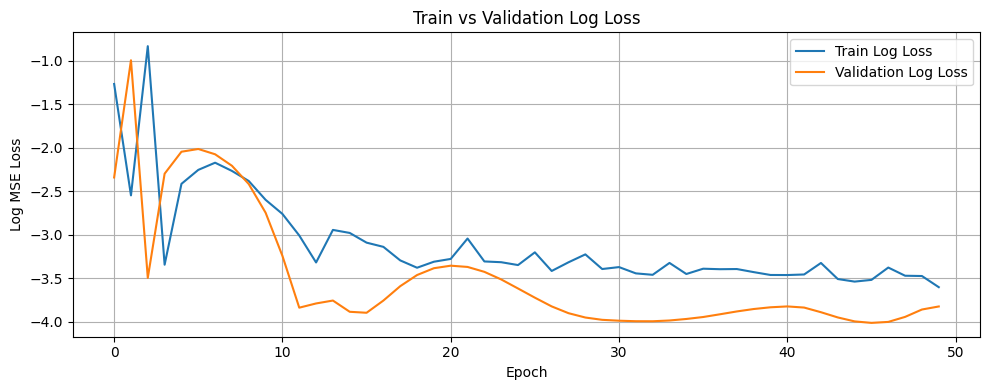

Training completed

=== Processing group: ('01 TO 03', 'HOUGANG', '4 ROOM') ===
Group size: 13 rows
Calling prepare_lstm_data for ('01 TO 03', 'HOUGANG', '4 ROOM')

Filtering for: HOUGANG, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 851
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1326, Val Loss: 0.0786, Train R²: -2.5869, Val R²: -0.1756
Best model saved!
Epoch 2/50, Train Loss: 0.0353, Val Loss: 0.2172, Train R²: 0.0448, Val R²: -2.2466
Epoch 3/50, Train Loss: 0.2823, Val Loss: 0.0753, Train R²: -6.6332, Val R²: -0.1256
Best model saved!
Epoch 4/50, Train Loss: 0.0378, Val Loss: 0.1191, Train R²: -0.0229, Val R

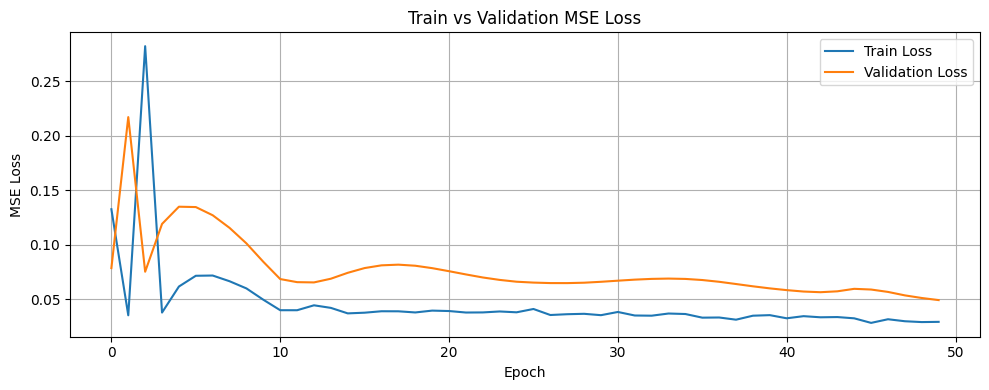

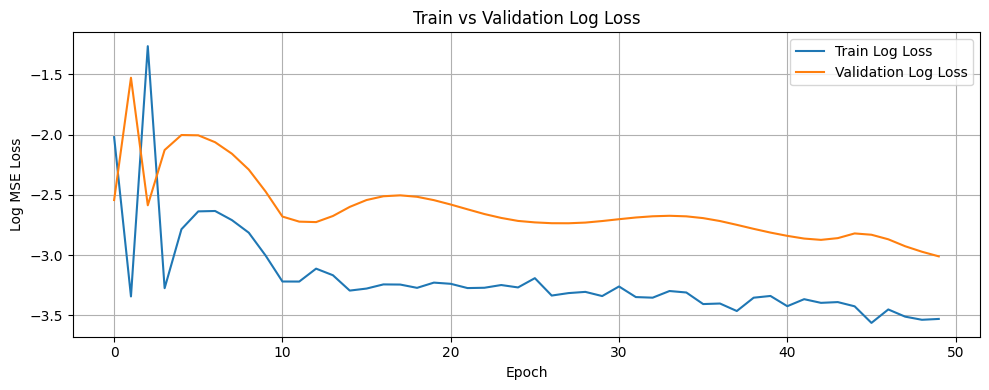

Training completed

=== Processing group: ('01 TO 03', 'HOUGANG', '5 ROOM') ===
Group size: 10 rows
Calling prepare_lstm_data for ('01 TO 03', 'HOUGANG', '5 ROOM')

Filtering for: HOUGANG, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 403
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 39
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1944, Val Loss: 0.0821, Train R²: -2.4312, Val R²: -0.0889
Best model saved!
Epoch 2/50, Train Loss: 0.0610, Val Loss: 0.9885, Train R²: -0.0767, Val R²: -12.1105
Epoch 3/50, Train Loss: 1.0370, Val Loss: 0.0784, Train R²: -17.3040, Val R²: -0.0398
Best model saved!
Epoch 4/50, Train Loss: 0.0550, Val Loss: 0.1218, Train R²: 0.0294, Val

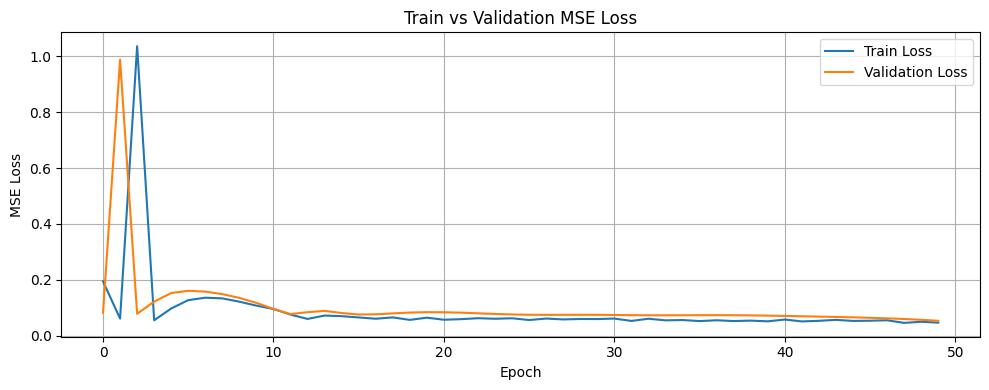

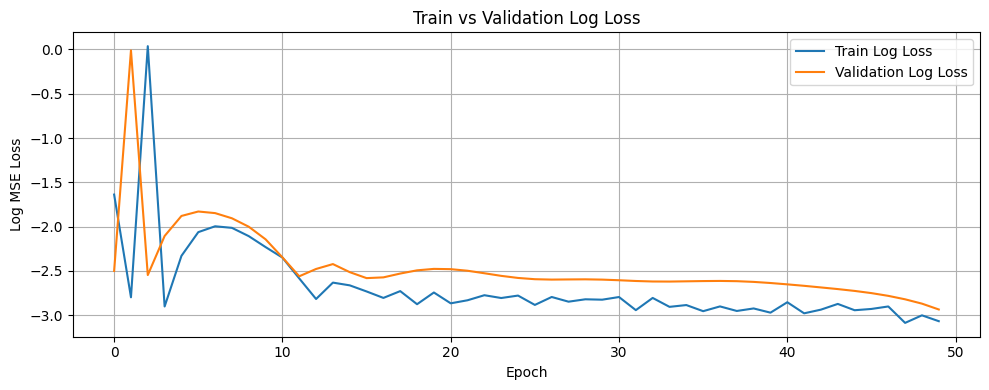

Training completed

=== Processing group: ('01 TO 03', 'HOUGANG', 'EXECUTIVE') ===
Group size: 5 rows
Calling prepare_lstm_data for ('01 TO 03', 'HOUGANG', 'EXECUTIVE')

Filtering for: HOUGANG, EXECUTIVE, 01 TO 03, around 2025-01-01
Initial strict match count: 290
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.0800, Val Loss: 0.0719, Train R²: -0.9390, Val R²: 0.0137
Best model saved!
Epoch 2/50, Train Loss: 0.0638, Val Loss: 0.0981, Train R²: -0.5459, Val R²: -0.3460
Epoch 3/50, Train Loss: 0.0441, Val Loss: 0.1077, Train R²: -0.0695, Val R²: -0.4777
Epoch 4/50, Train Loss: 0.0497, Val Loss: 0.1018, Train R²: -0.2045, Val R²: -0.3968

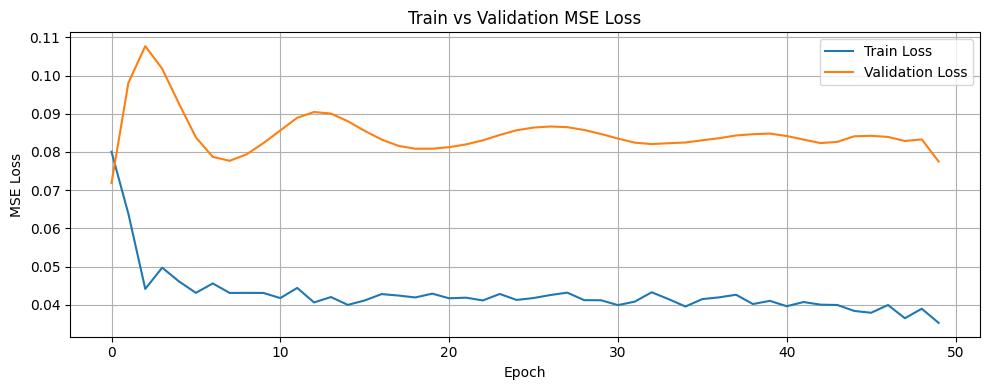

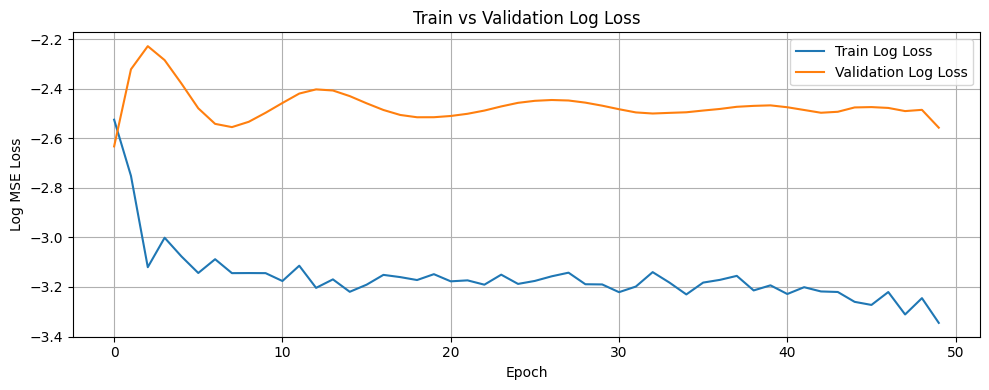

Training completed

=== Processing group: ('01 TO 03', 'JURONG EAST', '3 ROOM') ===
Group size: 9 rows
Calling prepare_lstm_data for ('01 TO 03', 'JURONG EAST', '3 ROOM')

Filtering for: JURONG EAST, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 327
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2614, Val Loss: 0.1128, Train R²: -5.3831, Val R²: -1.9635
Best model saved!
Epoch 2/50, Train Loss: 0.0802, Val Loss: 0.4392, Train R²: -0.9592, Val R²: -10.5363
Epoch 3/50, Train Loss: 0.5138, Val Loss: 0.0603, Train R²: -11.5481, Val R²: -0.5849
Best model saved!
Epoch 4/50, Train Loss: 0.0515, Val Loss: 0.1587, Train R²: 

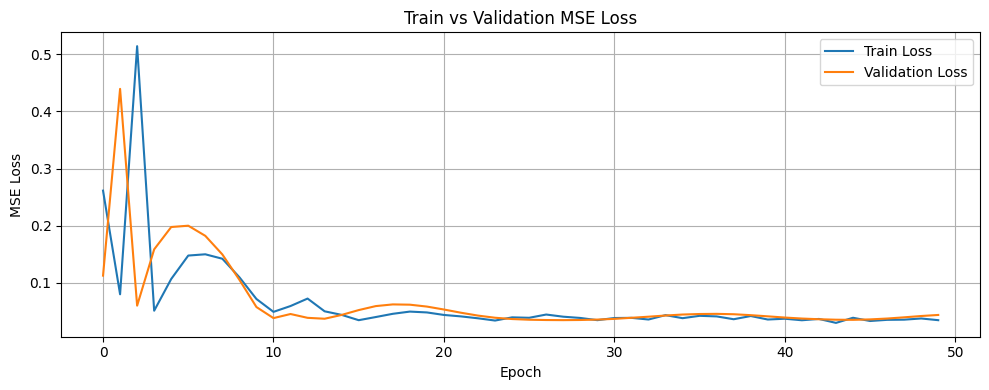

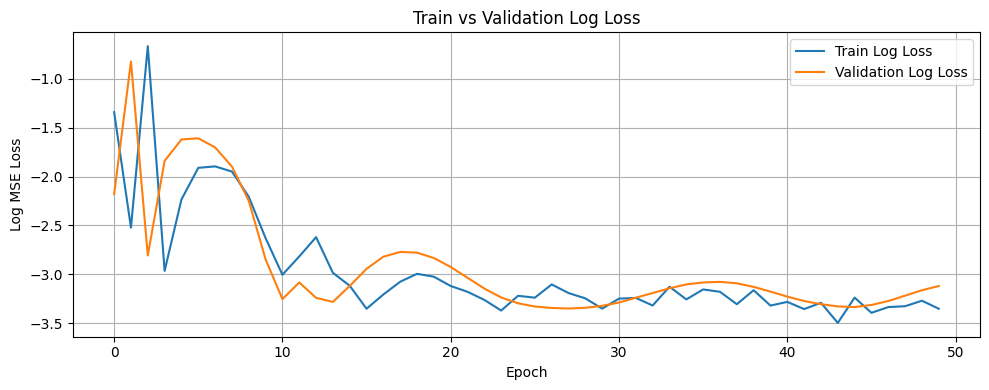

Training completed

=== Processing group: ('01 TO 03', 'JURONG EAST', '4 ROOM') ===
Group size: 6 rows
Calling prepare_lstm_data for ('01 TO 03', 'JURONG EAST', '4 ROOM')

Filtering for: JURONG EAST, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 221
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 33
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1218, Val Loss: 0.0351, Train R²: -1.0835, Val R²: -0.0084
Best model saved!
Epoch 2/50, Train Loss: 0.0822, Val Loss: 0.0737, Train R²: -0.4059, Val R²: -1.1165
Epoch 3/50, Train Loss: 0.0648, Val Loss: 0.0908, Train R²: -0.1094, Val R²: -1.6071
Epoch 4/50, Train Loss: 0.0706, Val Loss: 0.0812, Train R²: -0.2080, Val R²: -1.

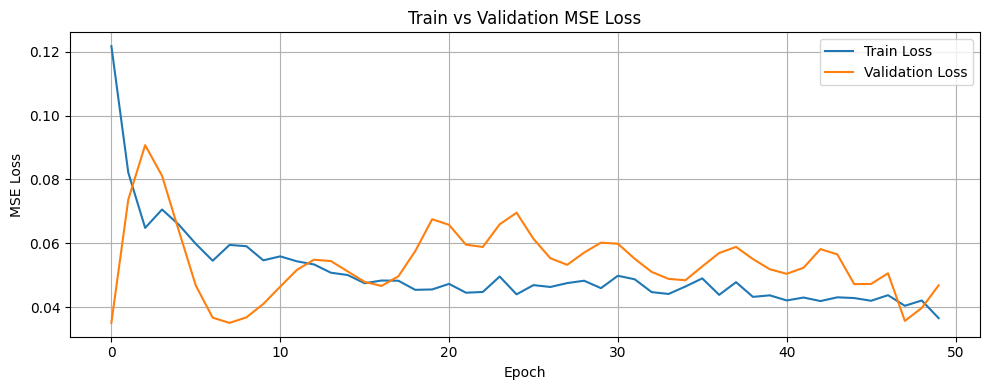

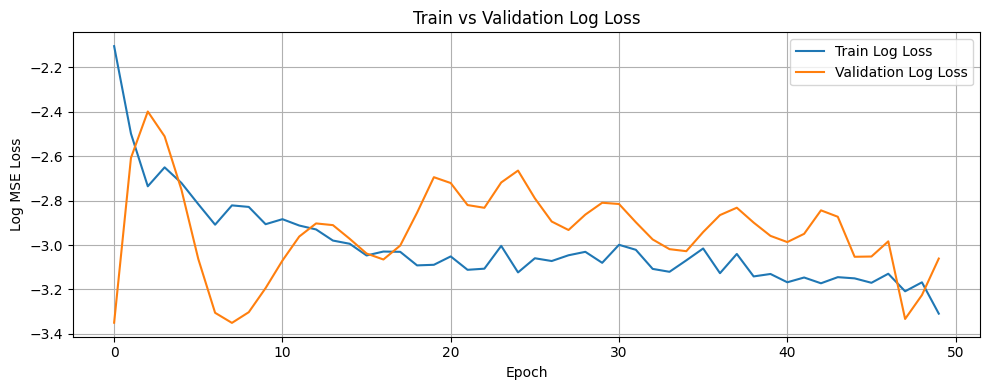

Training completed

=== Processing group: ('01 TO 03', 'JURONG EAST', '5 ROOM') ===
Group size: 2 rows
Calling prepare_lstm_data for ('01 TO 03', 'JURONG EAST', '5 ROOM')

Filtering for: JURONG EAST, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 133
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3236, Val Loss: 0.2262, Train R²: -4.5809, Val R²: -5.4781
Best model saved!
Epoch 2/50, Train Loss: 0.1363, Val Loss: 0.0434, Train R²: -1.3515, Val R²: -0.2442
Best model saved!
Epoch 3/50, Train Loss: 0.1262, Val Loss: 0.0986, Train R²: -1.1765, Val R²: -1.8225
Epoch 4/50, Train Loss: 0.0657, Val Loss: 0.1453, Train R²: -0

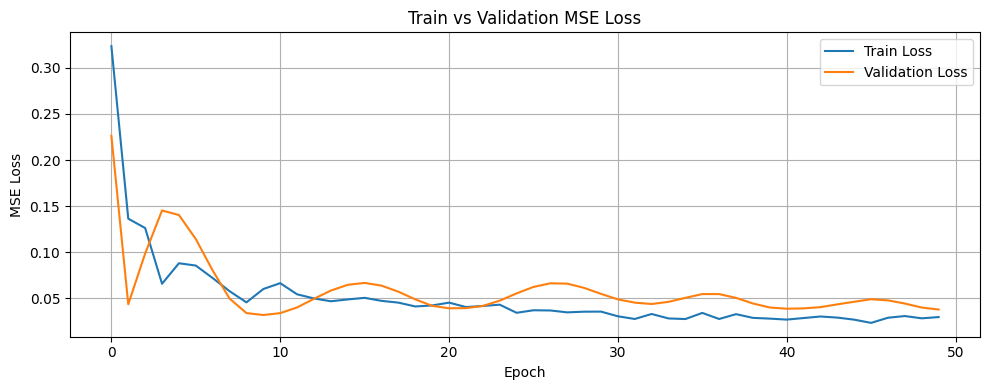

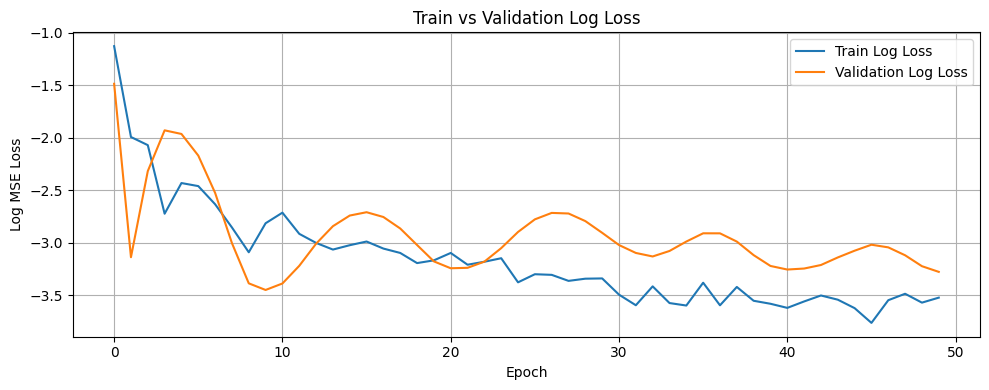

Training completed

=== Processing group: ('01 TO 03', 'JURONG WEST', '3 ROOM') ===
Group size: 15 rows
Calling prepare_lstm_data for ('01 TO 03', 'JURONG WEST', '3 ROOM')

Filtering for: JURONG WEST, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 526
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1479, Val Loss: 0.0270, Train R²: -2.5502, Val R²: -0.0645
Best model saved!
Epoch 2/50, Train Loss: 0.0430, Val Loss: 0.0383, Train R²: -0.0314, Val R²: -0.5119
Epoch 3/50, Train Loss: 0.0412, Val Loss: 0.0329, Train R²: 0.0113, Val R²: -0.2989
Epoch 4/50, Train Loss: 0.0616, Val Loss: 0.0230, Train R²: -0.4771, Val R²: 0.0

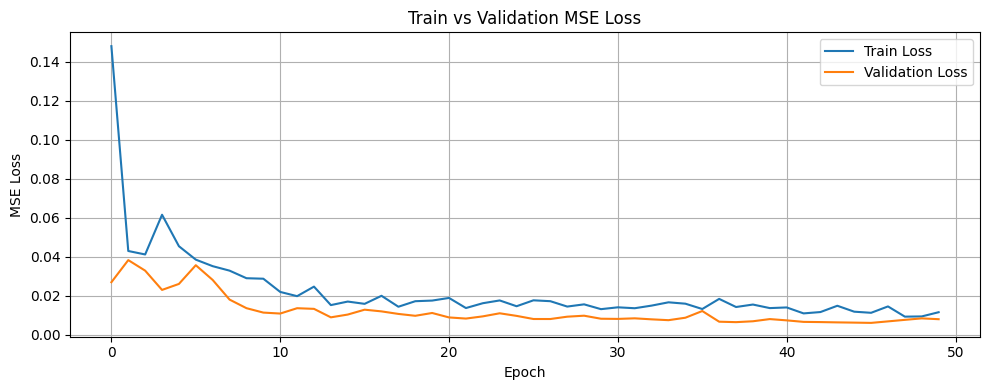

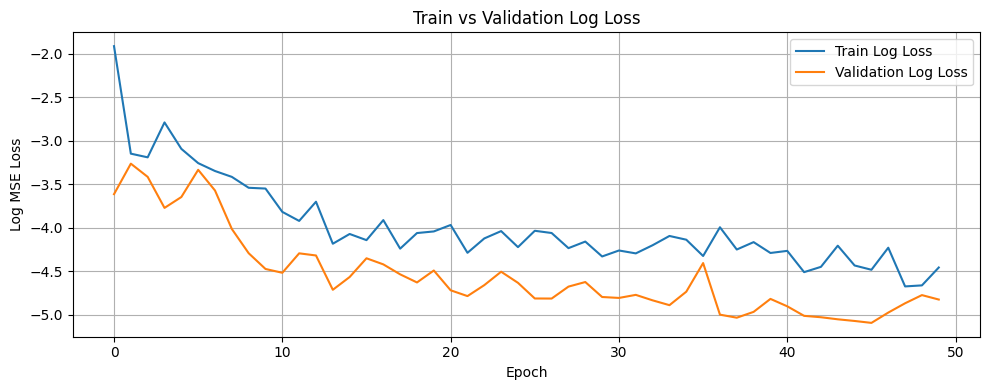

Training completed

=== Processing group: ('01 TO 03', 'JURONG WEST', '4 ROOM') ===
Group size: 28 rows
Calling prepare_lstm_data for ('01 TO 03', 'JURONG WEST', '4 ROOM')

Filtering for: JURONG WEST, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 1006
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 31
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2204, Val Loss: 0.0426, Train R²: -2.8470, Val R²: -0.0931
Best model saved!
Epoch 2/50, Train Loss: 0.0683, Val Loss: 0.6487, Train R²: -0.1917, Val R²: -15.6488
Epoch 3/50, Train Loss: 0.6301, Val Loss: 0.0385, Train R²: -9.9985, Val R²: 0.0128
Best model saved!
Epoch 4/50, Train Loss: 0.0557, Val Loss: 0.0723, Train R²: 

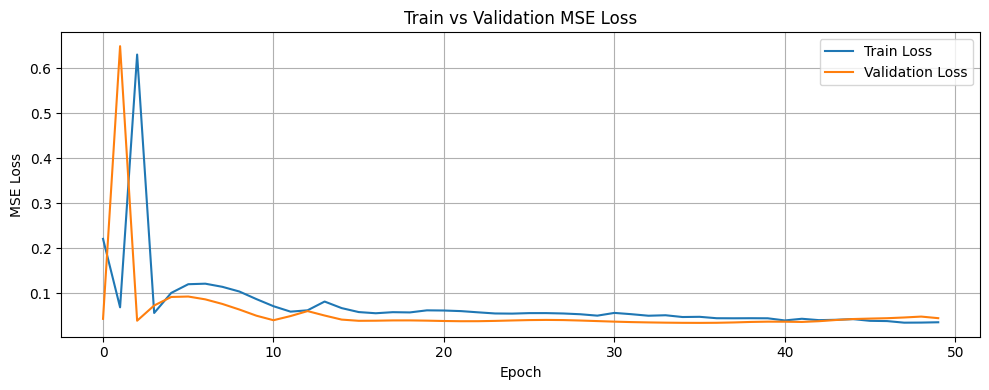

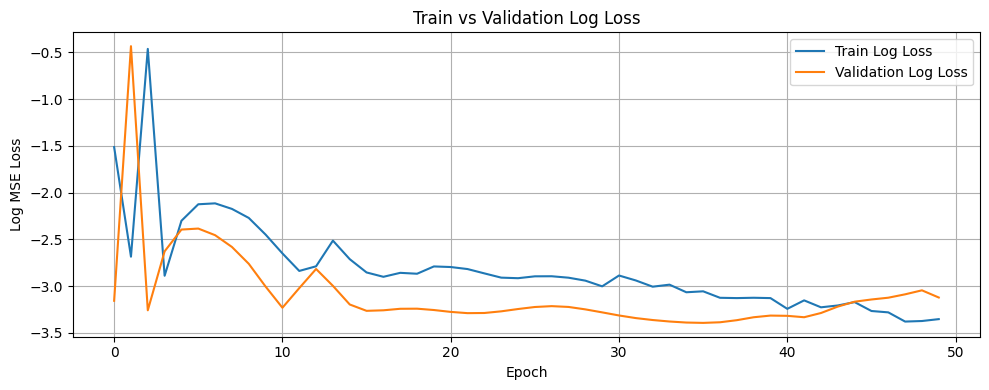

Training completed

=== Processing group: ('01 TO 03', 'JURONG WEST', '5 ROOM') ===
Group size: 26 rows
Calling prepare_lstm_data for ('01 TO 03', 'JURONG WEST', '5 ROOM')

Filtering for: JURONG WEST, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 713
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 33
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1105, Val Loss: 0.0767, Train R²: -2.9736, Val R²: -0.0354
Best model saved!
Epoch 2/50, Train Loss: 0.0355, Val Loss: 0.1867, Train R²: -0.2761, Val R²: -1.5203
Epoch 3/50, Train Loss: 0.0894, Val Loss: 0.1278, Train R²: -2.2147, Val R²: -0.7252
Epoch 4/50, Train Loss: 0.0488, Val Loss: 0.0821, Train R²: -0.7544, Val R²: -0

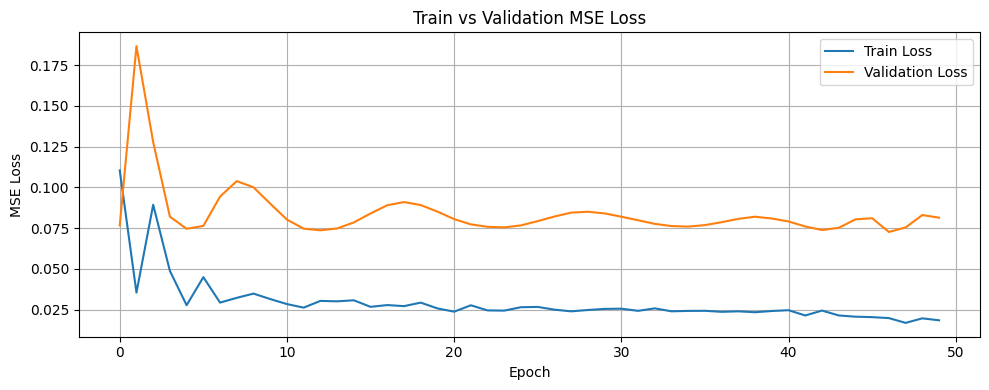

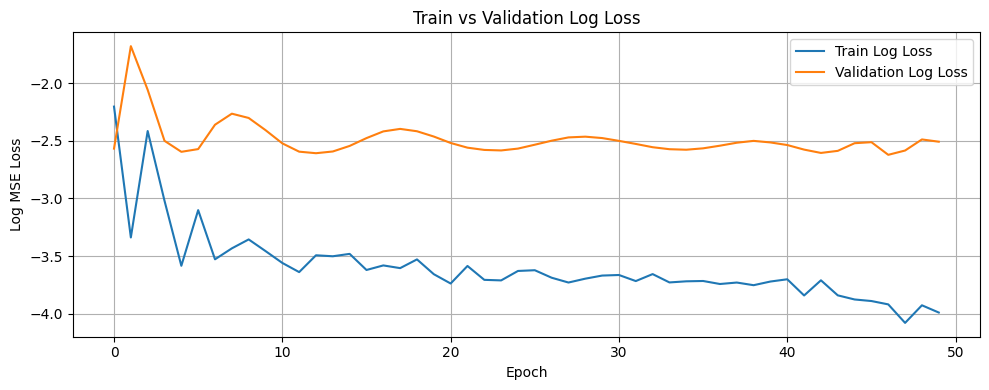

Training completed

=== Processing group: ('01 TO 03', 'JURONG WEST', 'EXECUTIVE') ===
Group size: 5 rows
Calling prepare_lstm_data for ('01 TO 03', 'JURONG WEST', 'EXECUTIVE')

Filtering for: JURONG WEST, EXECUTIVE, 01 TO 03, around 2025-01-01
Initial strict match count: 269
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2197, Val Loss: 0.0812, Train R²: -4.1021, Val R²: -0.8040
Best model saved!
Epoch 2/50, Train Loss: 0.0602, Val Loss: 0.5153, Train R²: -0.3993, Val R²: -10.4499
Epoch 3/50, Train Loss: 0.5875, Val Loss: 0.0561, Train R²: -12.6454, Val R²: -0.2462
Best model saved!
Epoch 4/50, Train Loss: 0.0470, Val Loss: 0.1237, T

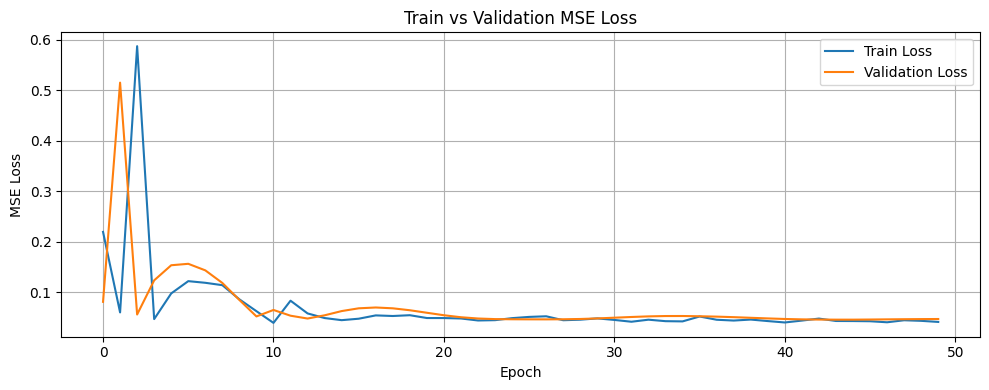

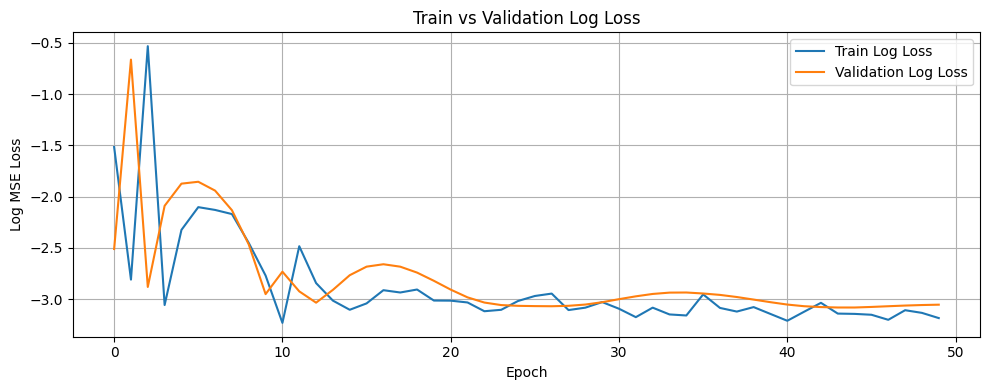

Training completed

=== Processing group: ('01 TO 03', 'KALLANG/WHAMPOA', '2 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('01 TO 03', 'KALLANG/WHAMPOA', '2 ROOM')

Filtering for: KALLANG/WHAMPOA, 2 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 13
Using before_or_at_target with 13 records.
Removing 'block' column from dataset
Data shapes - x_train: (12, 9), y_train: (12,)
Flattened y shape: (12,), Unique values: 12
Using simple train-validation split (80/20).
Split sizes - Train: 9, Val: 3
Creating PyTorch datasets...
Dataset sizes - Train: 9, Val: 3
Using batch sizes - Train: 9, Val: 3
Starting model training...
Epoch 1/50, Train Loss: 0.1911, Val Loss: 0.1560, Train R²: -2.9685, Val R²: -2.0371
Best model saved!
Epoch 2/50, Train Loss: 0.0574, Val Loss: 0.2142, Train R²: -0.1922, Val R²: -3.1715
Epoch 3/50, Train Loss: 0.3536, Val Loss: 0.1105, Train R²: -6.3415, Val R²: -1.1518
Best model saved!
Epoch 4/50, Train Loss: 0.0593, Val Loss: 0.2192, Train R

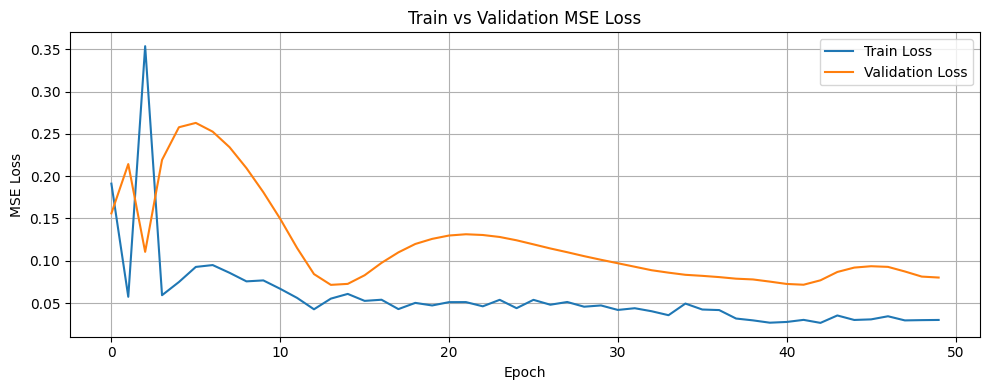

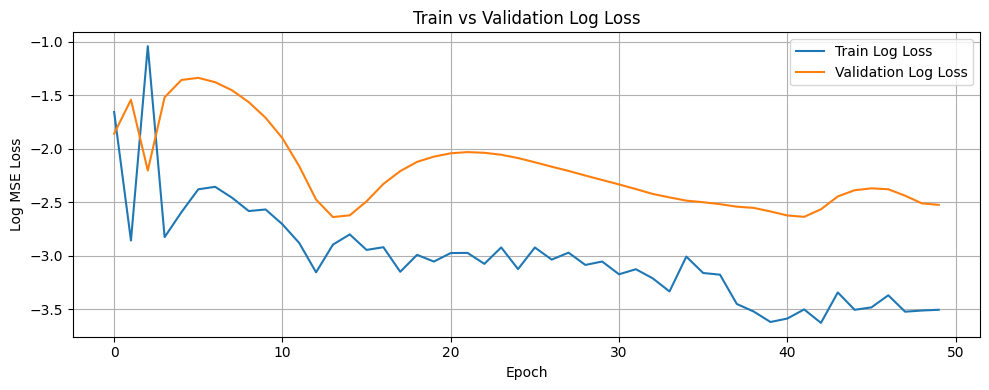

Error processing group ('01 TO 03', 'KALLANG/WHAMPOA', '2 ROOM'): [Errno 2] No such file or directory: '/content/saved_models/01_TO_03_KALLANG/WHAMPOA_2_ROOM_bundle.pkl'

=== Processing group: ('01 TO 03', 'KALLANG/WHAMPOA', '3 ROOM') ===
Group size: 9 rows
Calling prepare_lstm_data for ('01 TO 03', 'KALLANG/WHAMPOA', '3 ROOM')

Filtering for: KALLANG/WHAMPOA, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 492
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 38
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.0871, Val Loss: 0.0290, Train R²: -0.6659, Val R²: -0.8143
Best model saved!
Epoch 2/50, Train Loss: 0.0567, Val Loss: 0.0411, Train R²: -0.0833, Val R²: -1.5675
Ep

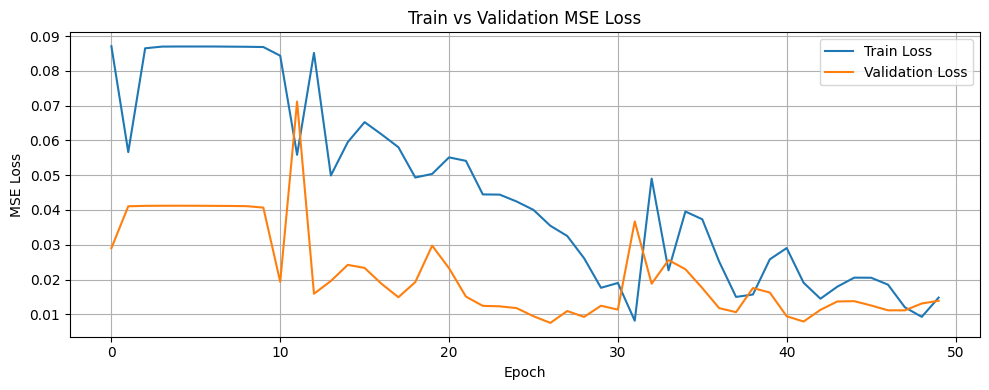

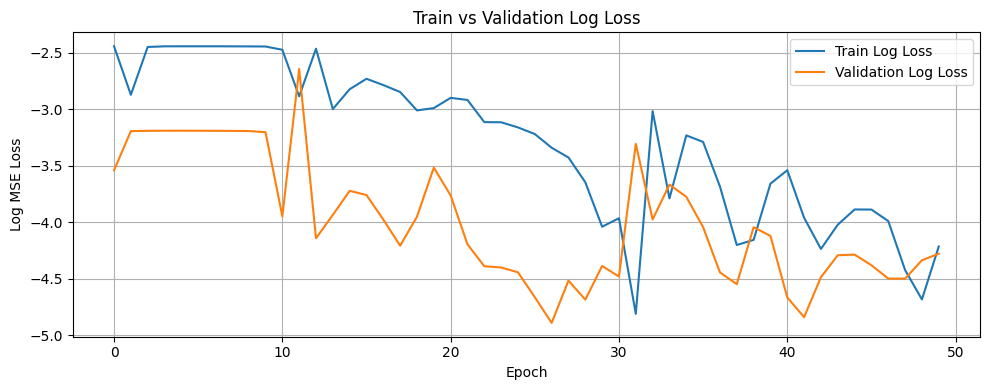

Error processing group ('01 TO 03', 'KALLANG/WHAMPOA', '3 ROOM'): [Errno 2] No such file or directory: '/content/saved_models/01_TO_03_KALLANG/WHAMPOA_3_ROOM_bundle.pkl'

=== Processing group: ('01 TO 03', 'KALLANG/WHAMPOA', '4 ROOM') ===
Group size: 8 rows
Calling prepare_lstm_data for ('01 TO 03', 'KALLANG/WHAMPOA', '4 ROOM')

Filtering for: KALLANG/WHAMPOA, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 318
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 45
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2930, Val Loss: 0.1491, Train R²: -3.4367, Val R²: -0.2489
Best model saved!
Epoch 2/50, Train Loss: 0.0970, Val Loss: 0.8462, Train R²: -0.4689, Val R²: -6.0879
Ep

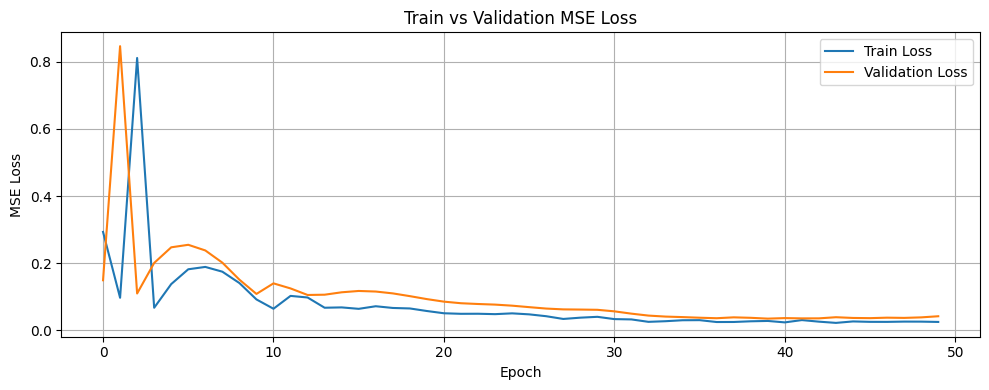

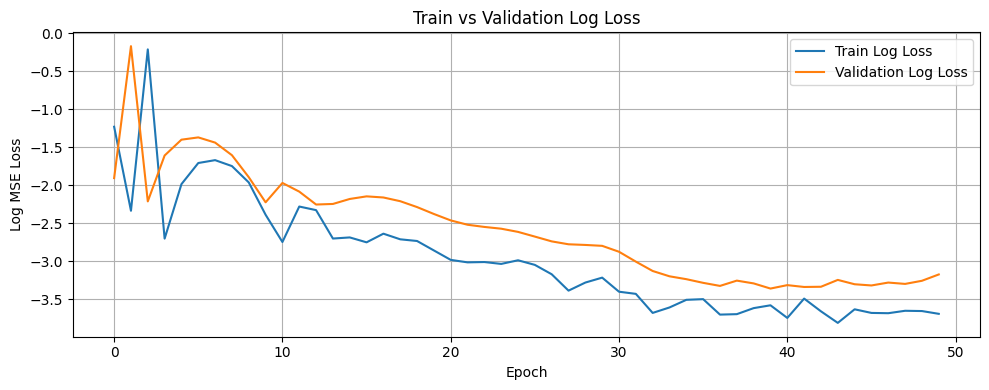

Error processing group ('01 TO 03', 'KALLANG/WHAMPOA', '4 ROOM'): [Errno 2] No such file or directory: '/content/saved_models/01_TO_03_KALLANG/WHAMPOA_4_ROOM_bundle.pkl'

=== Processing group: ('01 TO 03', 'KALLANG/WHAMPOA', '5 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('01 TO 03', 'KALLANG/WHAMPOA', '5 ROOM')

Filtering for: KALLANG/WHAMPOA, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 107
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 43
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1872, Val Loss: 0.0450, Train R²: -2.4821, Val R²: -0.0621
Best model saved!
Epoch 2/50, Train Loss: 0.0507, Val Loss: 0.0411, Train R²: 0.0560, Val R²: 0.0314
Best

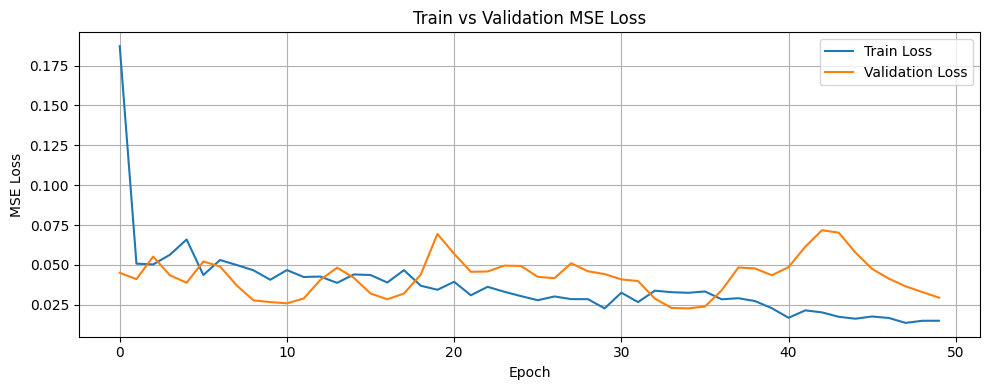

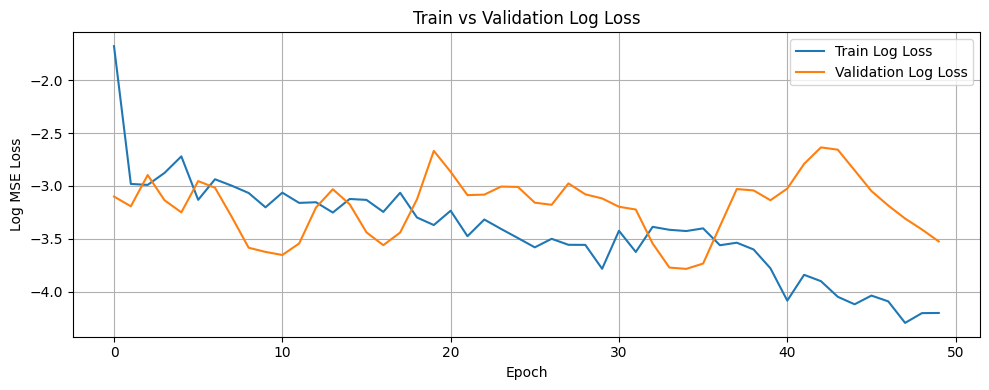

Error processing group ('01 TO 03', 'KALLANG/WHAMPOA', '5 ROOM'): [Errno 2] No such file or directory: '/content/saved_models/01_TO_03_KALLANG/WHAMPOA_5_ROOM_bundle.pkl'

=== Processing group: ('01 TO 03', 'MARINE PARADE', '3 ROOM') ===
Group size: 3 rows
Calling prepare_lstm_data for ('01 TO 03', 'MARINE PARADE', '3 ROOM')

Filtering for: MARINE PARADE, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 92
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1402, Val Loss: 0.0725, Train R²: -1.5001, Val R²: -0.0524
Best model saved!
Epoch 2/50, Train Loss: 0.0600, Val Loss: 0.0686, Train R²: -0.0704, Val R²: 0.0046
Best model

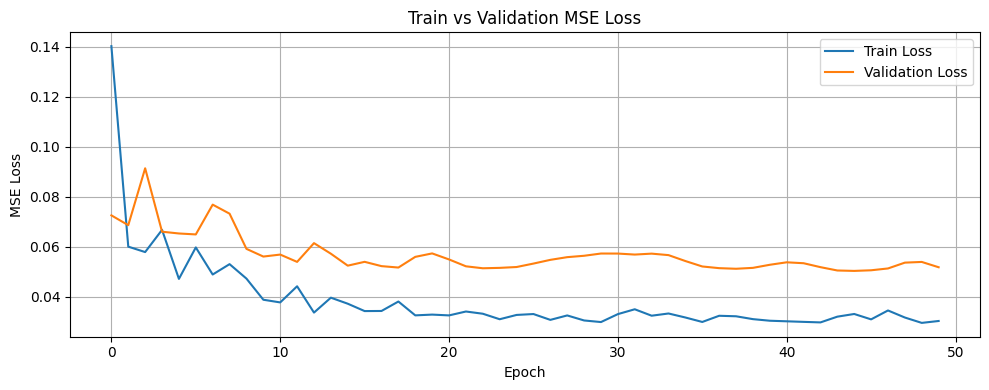

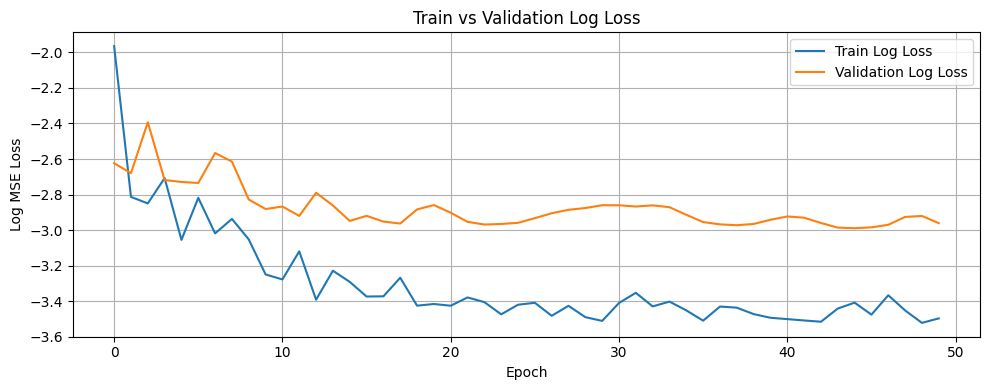

Training completed

=== Processing group: ('01 TO 03', 'MARINE PARADE', '4 ROOM') ===
Group size: 2 rows
Calling prepare_lstm_data for ('01 TO 03', 'MARINE PARADE', '4 ROOM')

Filtering for: MARINE PARADE, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 49
Using before_or_at_target with 48 records.
Removing 'block' column from dataset
Data shapes - x_train: (47, 9), y_train: (47,)
Flattened y shape: (47,), Unique values: 28
Using simple train-validation split (80/20).
Split sizes - Train: 37, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 37, Val: 10
Using batch sizes - Train: 37, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3215, Val Loss: 0.1418, Train R²: -4.9228, Val R²: -0.7844
Best model saved!
Epoch 2/50, Train Loss: 0.1481, Val Loss: 0.1198, Train R²: -1.7285, Val R²: -0.5066
Best model saved!
Epoch 3/50, Train Loss: 0.0789, Val Loss: 0.0819, Train R²: -0.4538, Val R²: -0.0309
Best model saved!
Epoch 4/50, Train Loss: 0.0589, Val Los

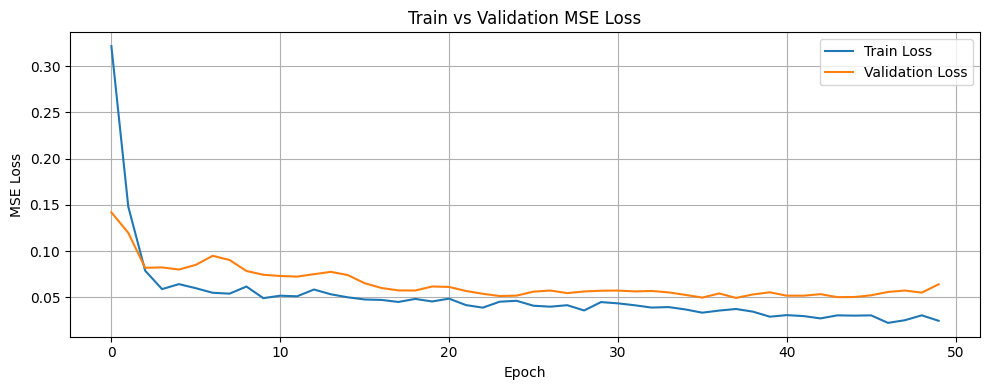

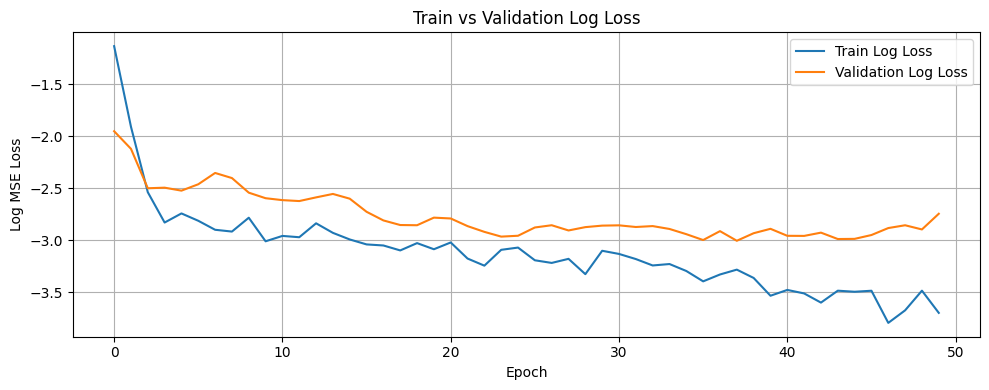

Training completed

=== Processing group: ('01 TO 03', 'MARINE PARADE', '5 ROOM') ===
Group size: 2 rows
Calling prepare_lstm_data for ('01 TO 03', 'MARINE PARADE', '5 ROOM')

Filtering for: MARINE PARADE, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 24
Using before_or_at_target with 23 records.
Removing 'block' column from dataset
Data shapes - x_train: (22, 9), y_train: (22,)
Flattened y shape: (22,), Unique values: 19
Using simple train-validation split (80/20).
Split sizes - Train: 17, Val: 5
Creating PyTorch datasets...
Dataset sizes - Train: 17, Val: 5
Using batch sizes - Train: 17, Val: 5
Starting model training...
Epoch 1/50, Train Loss: 0.2484, Val Loss: 0.0991, Train R²: -3.9934, Val R²: -0.6301
Best model saved!
Epoch 2/50, Train Loss: 0.0699, Val Loss: 0.9279, Train R²: -0.4052, Val R²: -14.2613
Epoch 3/50, Train Loss: 1.0636, Val Loss: 0.0699, Train R²: -20.3823, Val R²: -0.1494
Best model saved!
Epoch 4/50, Train Loss: 0.0640, Val Loss: 0.2014, Train R²

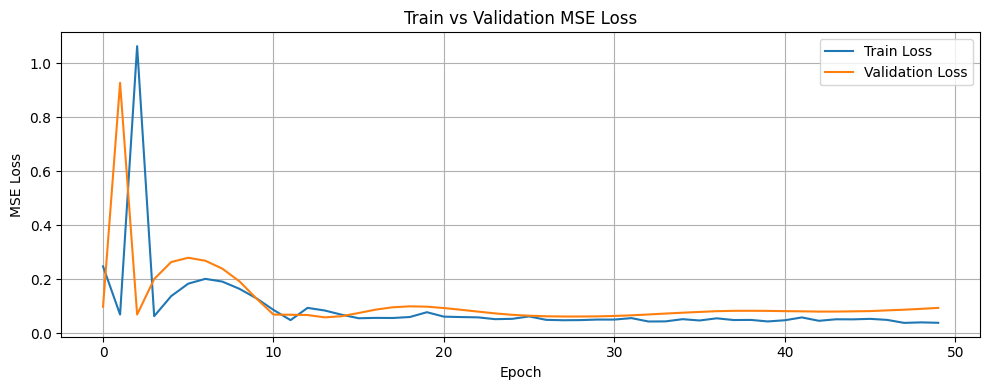

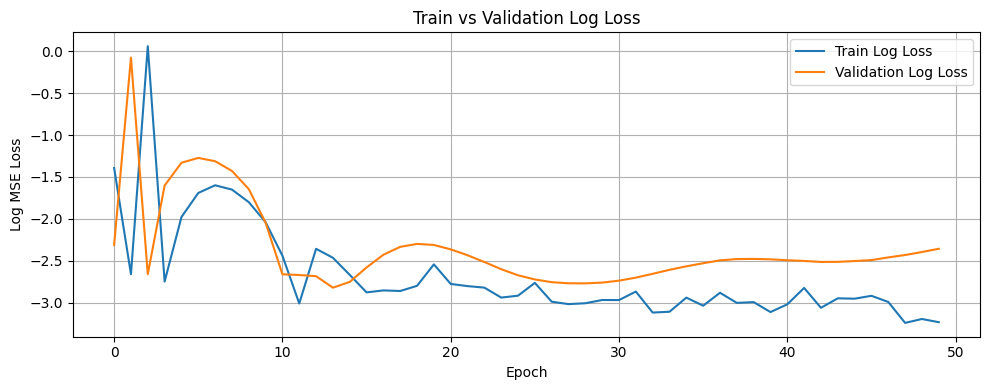

Training completed

=== Processing group: ('01 TO 03', 'PASIR RIS', '2 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('01 TO 03', 'PASIR RIS', '2 ROOM')

Filtering for: PASIR RIS, 2 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 5
Relaxing filter: removing storey_range...
Relaxed match count: 48
Using before_or_at_target with 46 records.
Removing 'block' column from dataset
Data shapes - x_train: (45, 9), y_train: (45,)
Flattened y shape: (45,), Unique values: 33
Using simple train-validation split (80/20).
Split sizes - Train: 36, Val: 9
Creating PyTorch datasets...
Dataset sizes - Train: 36, Val: 9
Using batch sizes - Train: 36, Val: 9
Starting model training...
Epoch 1/50, Train Loss: 0.0981, Val Loss: 0.1228, Train R²: -0.4625, Val R²: -0.0570
Best model saved!
Epoch 2/50, Train Loss: 0.1235, Val Loss: 0.1506, Train R²: -0.8415, Val R²: -0.2971
Epoch 3/50, Train Loss: 0.0681, Val Loss: 0.1811, Train R²: -0.0158, Val R²: -0.5596
Epoch 4/50, Train Loss: 0

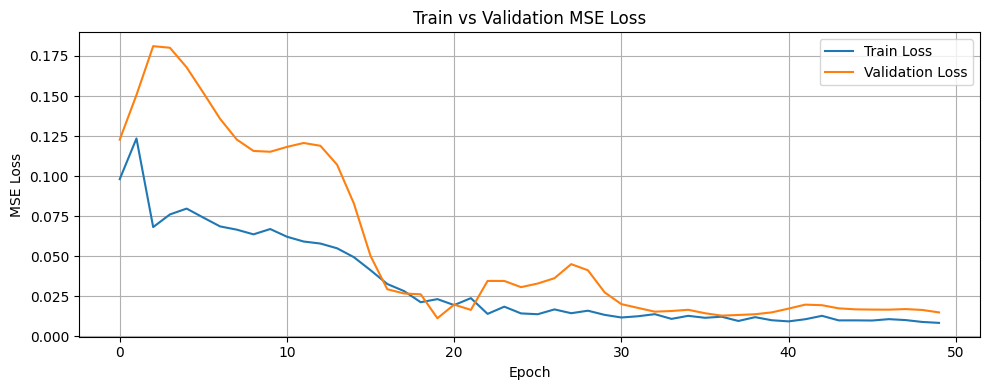

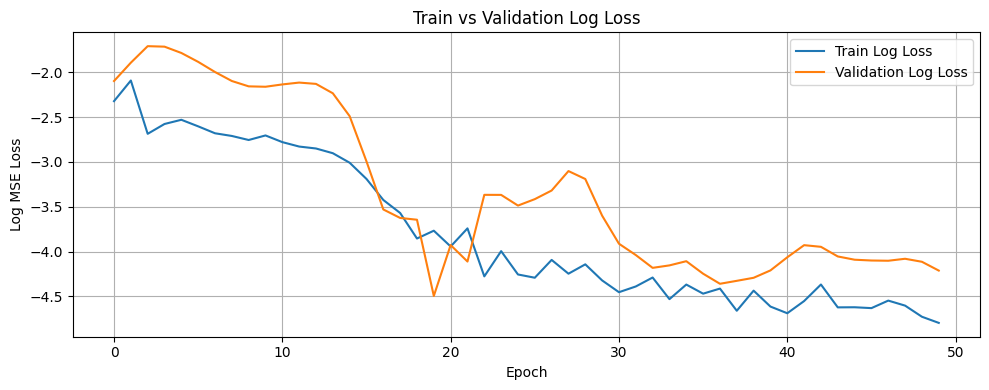

Training completed

=== Processing group: ('01 TO 03', 'PASIR RIS', '3 ROOM') ===
Group size: 3 rows
Calling prepare_lstm_data for ('01 TO 03', 'PASIR RIS', '3 ROOM')

Filtering for: PASIR RIS, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 34
Using before_or_at_target with 31 records.
Removing 'block' column from dataset
Data shapes - x_train: (30, 9), y_train: (30,)
Flattened y shape: (30,), Unique values: 27
Using simple train-validation split (80/20).
Split sizes - Train: 24, Val: 6
Creating PyTorch datasets...
Dataset sizes - Train: 24, Val: 6
Using batch sizes - Train: 24, Val: 6
Starting model training...
Epoch 1/50, Train Loss: 0.2511, Val Loss: 0.0679, Train R²: -2.7160, Val R²: -0.9883
Best model saved!
Epoch 2/50, Train Loss: 0.0797, Val Loss: 1.0684, Train R²: -0.1792, Val R²: -30.2920
Epoch 3/50, Train Loss: 1.1206, Val Loss: 0.0371, Train R²: -15.5846, Val R²: -0.0871
Best model saved!
Epoch 4/50, Train Loss: 0.0688, Val Loss: 0.1523, Train R²: -0.0175, V

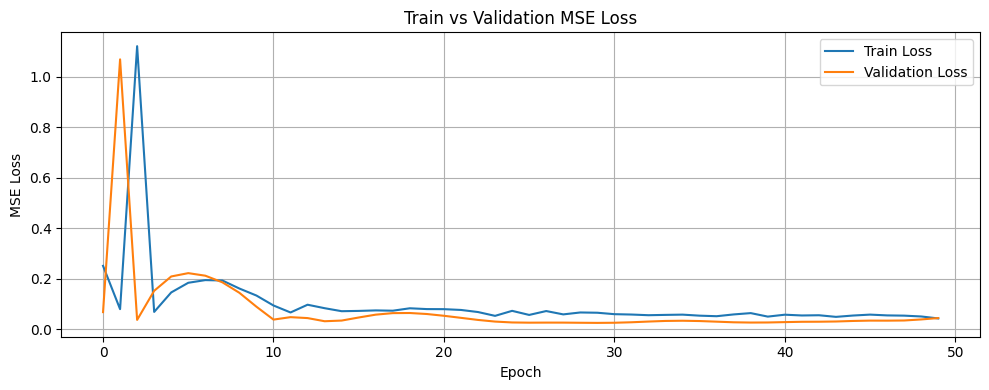

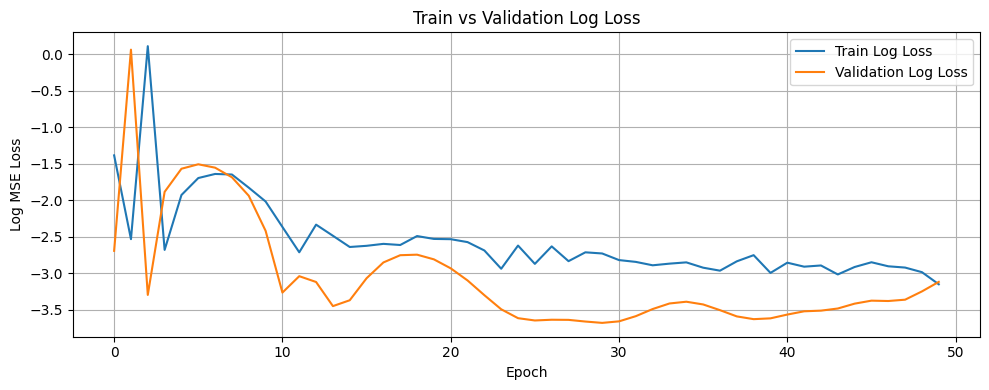

Training completed

=== Processing group: ('01 TO 03', 'PASIR RIS', '4 ROOM') ===
Group size: 9 rows
Calling prepare_lstm_data for ('01 TO 03', 'PASIR RIS', '4 ROOM')

Filtering for: PASIR RIS, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 495
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 33
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1752, Val Loss: 0.0579, Train R²: -3.2249, Val R²: -2.2144
Best model saved!
Epoch 2/50, Train Loss: 0.0982, Val Loss: 0.3167, Train R²: -1.3687, Val R²: -16.5831
Epoch 3/50, Train Loss: 0.3314, Val Loss: 0.0266, Train R²: -6.9911, Val R²: -0.4784
Best model saved!
Epoch 4/50, Train Loss: 0.0551, Val Loss: 0.0759, Train R²: -0.3283

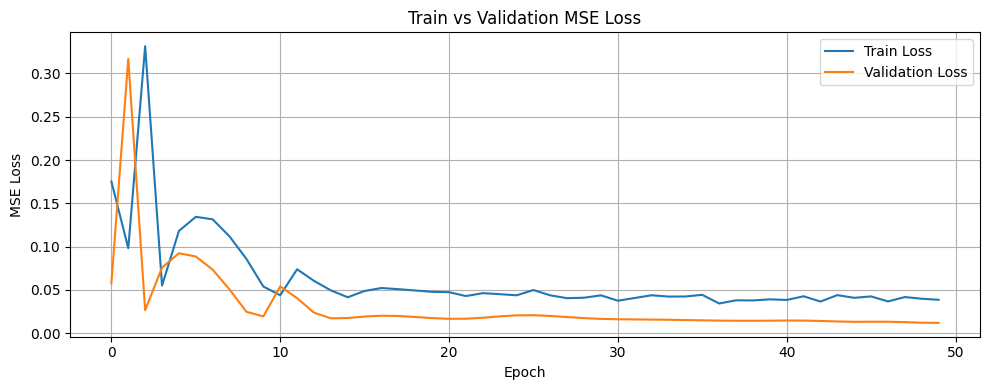

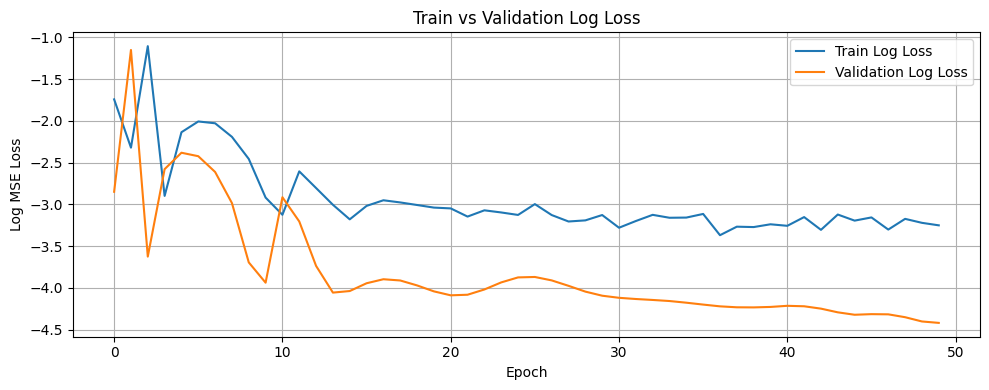

Training completed

=== Processing group: ('01 TO 03', 'PASIR RIS', '5 ROOM') ===
Group size: 11 rows
Calling prepare_lstm_data for ('01 TO 03', 'PASIR RIS', '5 ROOM')

Filtering for: PASIR RIS, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 355
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 31
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1157, Val Loss: 0.0182, Train R²: -2.4947, Val R²: -0.3262
Best model saved!
Epoch 2/50, Train Loss: 0.0341, Val Loss: 0.0417, Train R²: -0.0301, Val R²: -2.0378
Epoch 3/50, Train Loss: 0.0426, Val Loss: 0.0250, Train R²: -0.2866, Val R²: -0.8175
Epoch 4/50, Train Loss: 0.0614, Val Loss: 0.0219, Train R²: -0.8547, Val R²: -0.5941


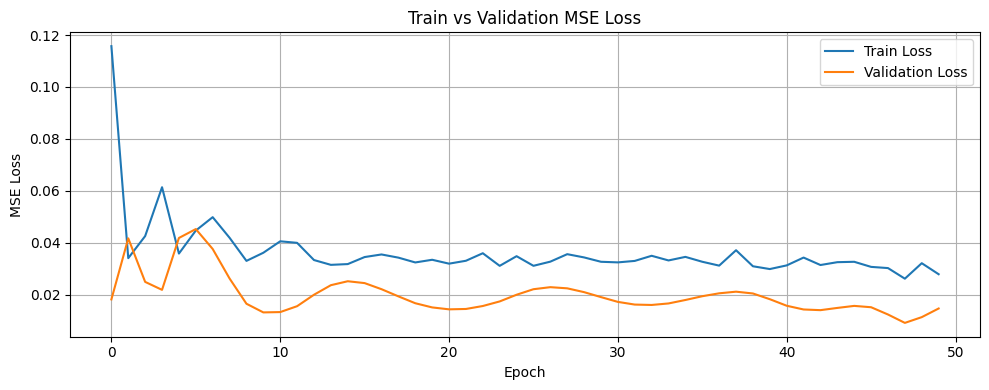

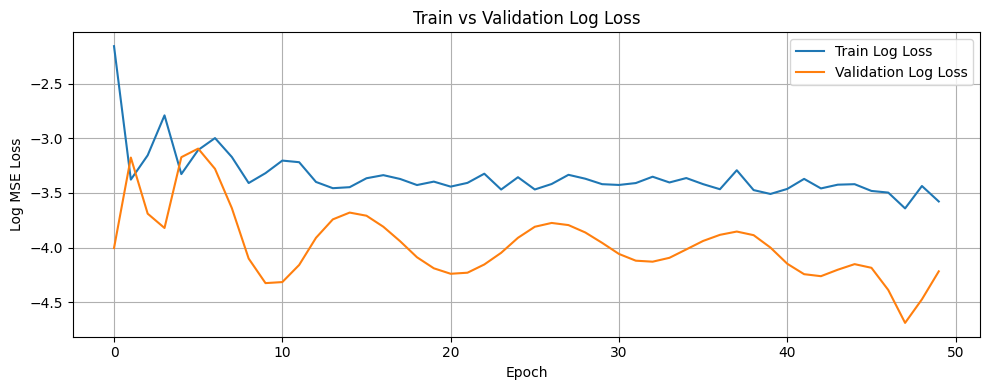

Training completed

=== Processing group: ('01 TO 03', 'PASIR RIS', 'EXECUTIVE') ===
Group size: 8 rows
Calling prepare_lstm_data for ('01 TO 03', 'PASIR RIS', 'EXECUTIVE')

Filtering for: PASIR RIS, EXECUTIVE, 01 TO 03, around 2025-01-01
Initial strict match count: 394
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 35
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2151, Val Loss: 0.0494, Train R²: -2.0581, Val R²: -0.0730
Best model saved!
Epoch 2/50, Train Loss: 0.0847, Val Loss: 0.4512, Train R²: -0.2044, Val R²: -8.7985
Epoch 3/50, Train Loss: 0.4113, Val Loss: 0.0502, Train R²: -4.8465, Val R²: -0.0905
Epoch 4/50, Train Loss: 0.0714, Val Loss: 0.0581, Train R²: -0.0156, Val R²: 

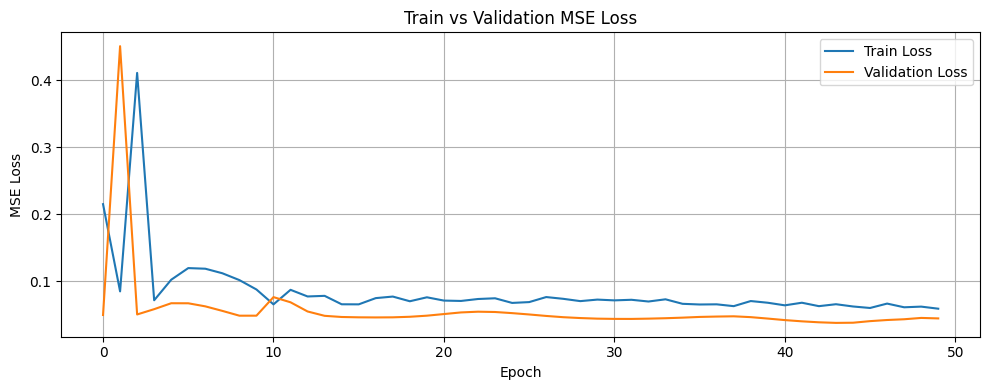

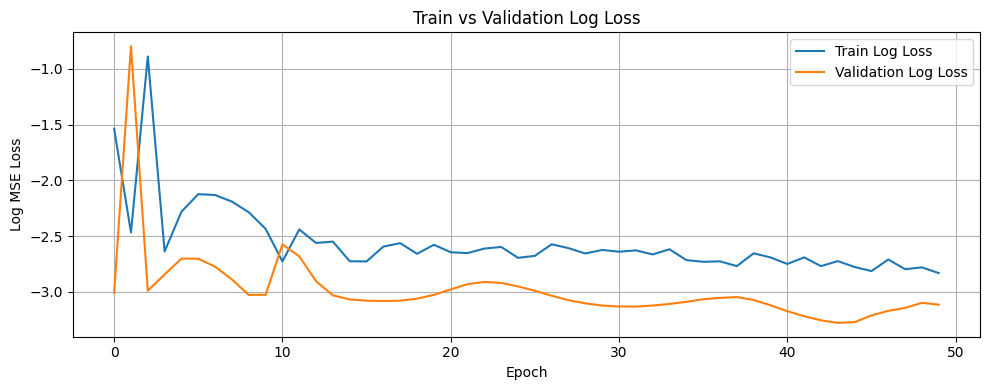

Training completed

=== Processing group: ('01 TO 03', 'PUNGGOL', '2 ROOM') ===
Group size: 3 rows
Calling prepare_lstm_data for ('01 TO 03', 'PUNGGOL', '2 ROOM')

Filtering for: PUNGGOL, 2 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 53
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 29
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2642, Val Loss: 0.1655, Train R²: -1.7541, Val R²: -0.9600
Best model saved!
Epoch 2/50, Train Loss: 0.1269, Val Loss: 0.2803, Train R²: -0.3231, Val R²: -2.3203
Epoch 3/50, Train Loss: 0.4370, Val Loss: 0.1253, Train R²: -3.5548, Val R²: -0.4840
Best model saved!
Epoch 4/50, Train Loss: 0.1046, Val Loss: 0.2016, Train R²: -0.0903, Val R²

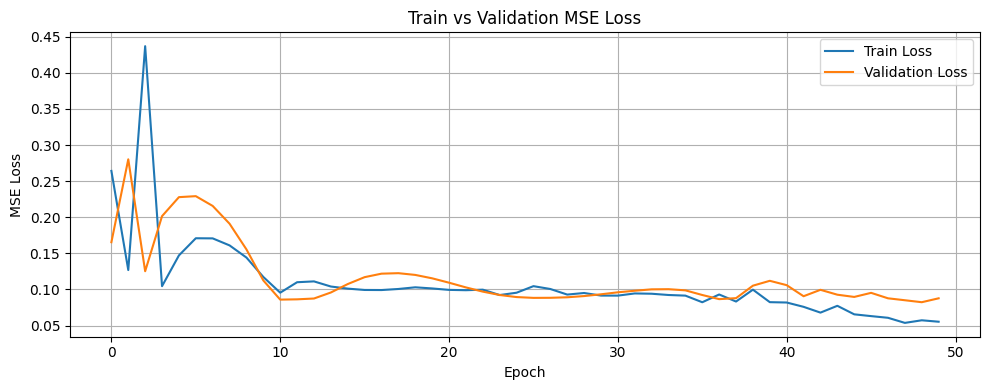

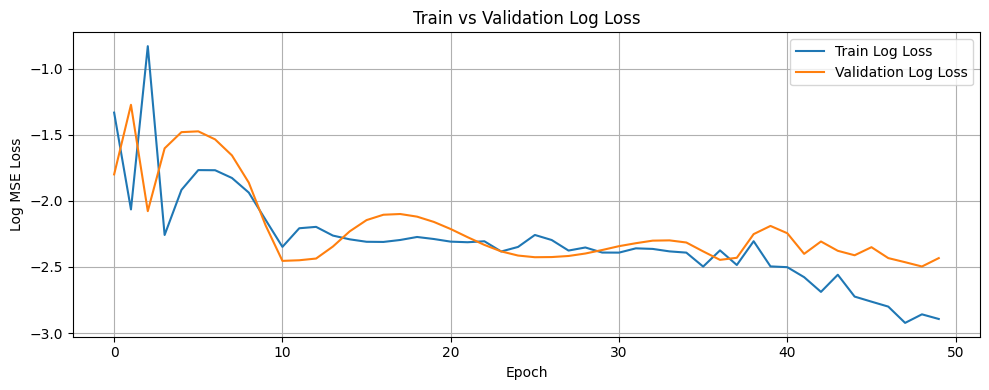

Training completed

=== Processing group: ('01 TO 03', 'PUNGGOL', '3 ROOM') ===
Group size: 5 rows
Calling prepare_lstm_data for ('01 TO 03', 'PUNGGOL', '3 ROOM')

Filtering for: PUNGGOL, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 170
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 28
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1360, Val Loss: 0.1585, Train R²: -2.7028, Val R²: -1.2455
Best model saved!
Epoch 2/50, Train Loss: 0.0597, Val Loss: 0.3905, Train R²: -0.6244, Val R²: -4.5331
Epoch 3/50, Train Loss: 0.5236, Val Loss: 0.1169, Train R²: -13.2577, Val R²: -0.6570
Best model saved!
Epoch 4/50, Train Loss: 0.0418, Val Loss: 0.2175, Train R²: -0.1369, Val 

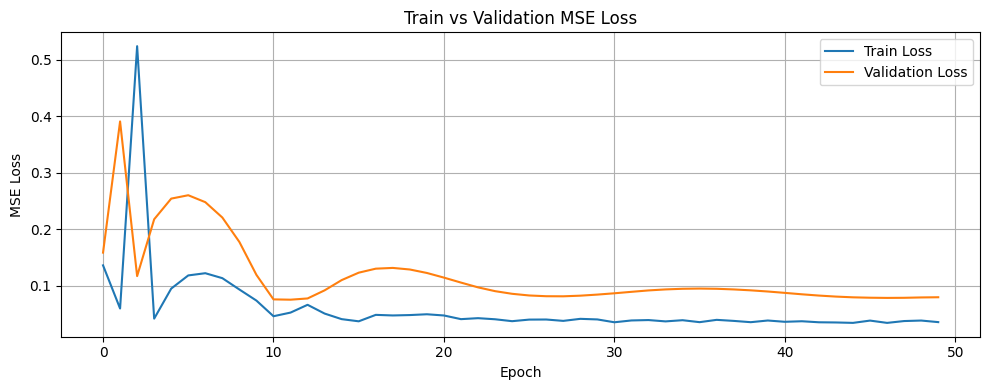

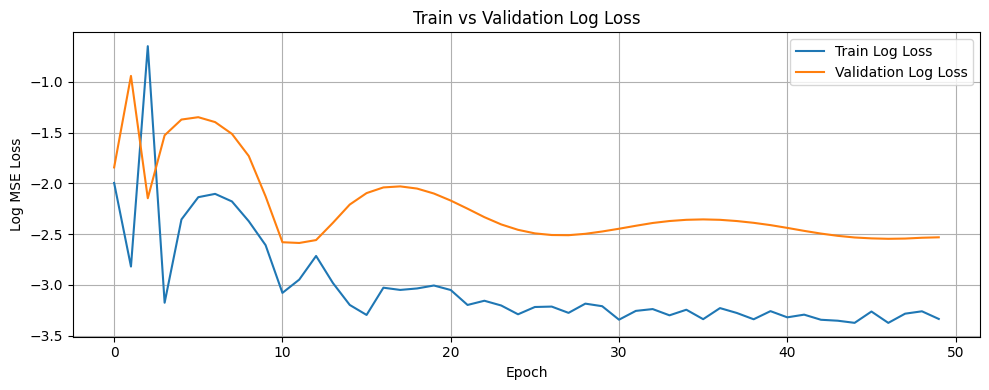

Training completed

=== Processing group: ('01 TO 03', 'PUNGGOL', '4 ROOM') ===
Group size: 18 rows
Calling prepare_lstm_data for ('01 TO 03', 'PUNGGOL', '4 ROOM')

Filtering for: PUNGGOL, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 898
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 31
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3007, Val Loss: 0.1226, Train R²: -6.4539, Val R²: -9.0037
Best model saved!
Epoch 2/50, Train Loss: 0.1141, Val Loss: 0.3384, Train R²: -1.8291, Val R²: -26.6134
Epoch 3/50, Train Loss: 0.4104, Val Loss: 0.0629, Train R²: -9.1735, Val R²: -4.1338
Best model saved!
Epoch 4/50, Train Loss: 0.0702, Val Loss: 0.1619, Train R²: -0.7391, Val

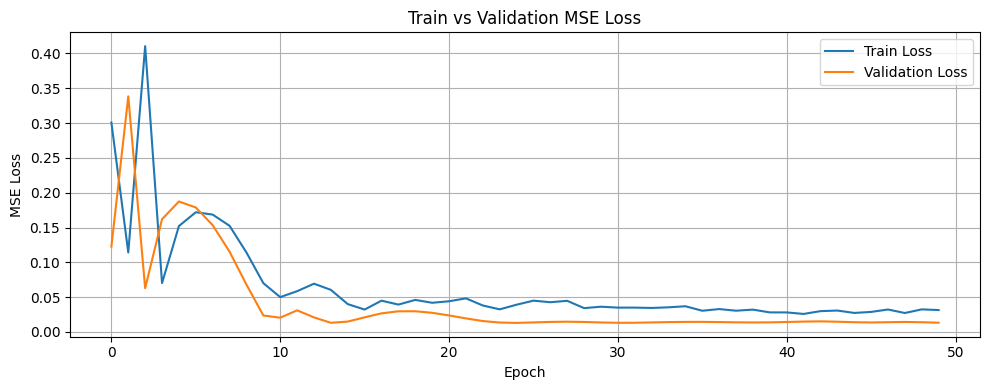

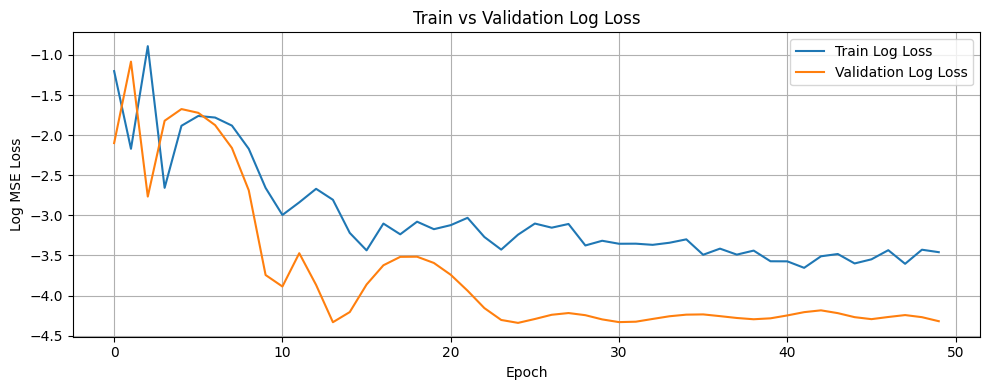

Training completed

=== Processing group: ('01 TO 03', 'PUNGGOL', '5 ROOM') ===
Group size: 9 rows
Calling prepare_lstm_data for ('01 TO 03', 'PUNGGOL', '5 ROOM')

Filtering for: PUNGGOL, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 552
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 42
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1910, Val Loss: 0.0274, Train R²: -2.1985, Val R²: 0.1501
Best model saved!
Epoch 2/50, Train Loss: 0.0572, Val Loss: 0.5060, Train R²: 0.0413, Val R²: -14.6824
Epoch 3/50, Train Loss: 0.5078, Val Loss: 0.0294, Train R²: -7.5063, Val R²: 0.0882
Epoch 4/50, Train Loss: 0.0576, Val Loss: 0.0794, Train R²: 0.0355, Val R²: -1.4621
Epoch 5/50

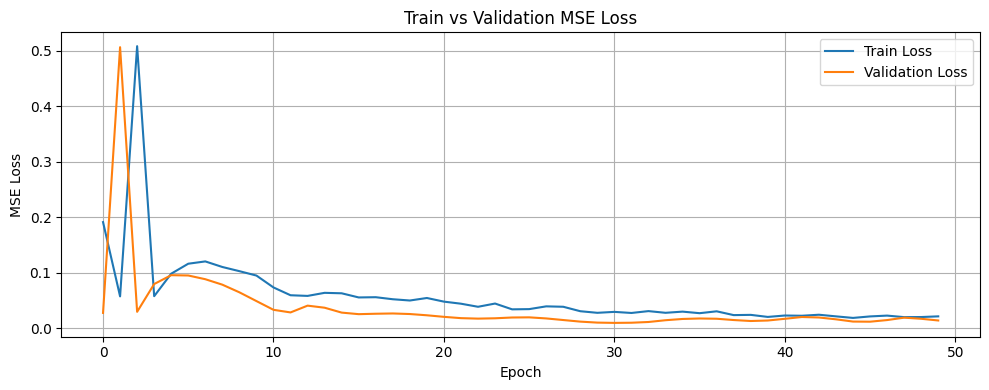

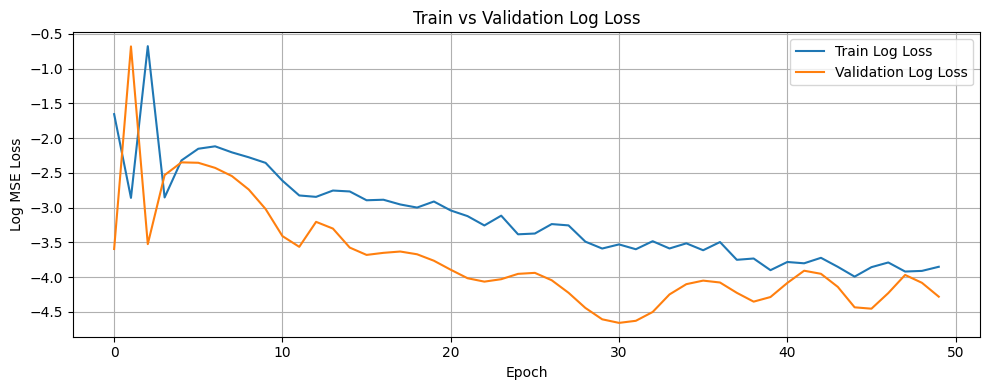

Training completed

=== Processing group: ('01 TO 03', 'PUNGGOL', 'EXECUTIVE') ===
Group size: 2 rows
Calling prepare_lstm_data for ('01 TO 03', 'PUNGGOL', 'EXECUTIVE')

Filtering for: PUNGGOL, EXECUTIVE, 01 TO 03, around 2025-01-01
Initial strict match count: 38
Using before_or_at_target with 36 records.
Removing 'block' column from dataset
Data shapes - x_train: (35, 9), y_train: (35,)
Flattened y shape: (35,), Unique values: 25
Using simple train-validation split (80/20).
Split sizes - Train: 28, Val: 7
Creating PyTorch datasets...
Dataset sizes - Train: 28, Val: 7
Using batch sizes - Train: 28, Val: 7
Starting model training...
Epoch 1/50, Train Loss: 0.1578, Val Loss: 0.0699, Train R²: -1.1216, Val R²: -0.6729
Best model saved!
Epoch 2/50, Train Loss: 0.0959, Val Loss: 0.2279, Train R²: -0.2890, Val R²: -4.4559
Epoch 3/50, Train Loss: 0.2552, Val Loss: 0.0508, Train R²: -2.4305, Val R²: -0.2149
Best model saved!
Epoch 4/50, Train Loss: 0.0838, Val Loss: 0.0886, Train R²: -0.1258, 

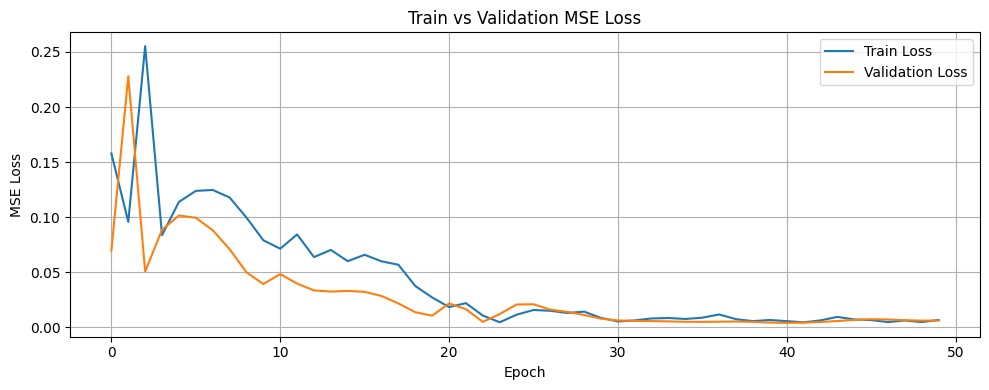

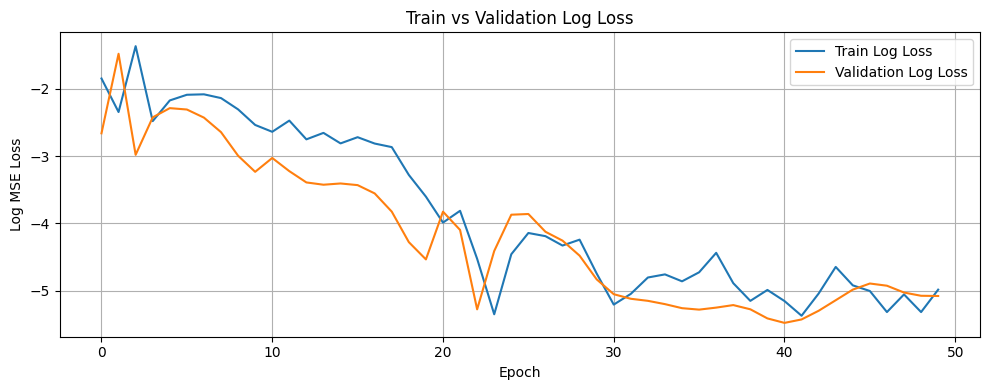

Training completed

=== Processing group: ('01 TO 03', 'QUEENSTOWN', '2 ROOM') ===
Group size: 3 rows
Calling prepare_lstm_data for ('01 TO 03', 'QUEENSTOWN', '2 ROOM')

Filtering for: QUEENSTOWN, 2 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 35
Using before_or_at_target with 32 records.
Removing 'block' column from dataset
Data shapes - x_train: (31, 9), y_train: (31,)
Flattened y shape: (31,), Unique values: 25
Using simple train-validation split (80/20).
Split sizes - Train: 24, Val: 7
Creating PyTorch datasets...
Dataset sizes - Train: 24, Val: 7
Using batch sizes - Train: 24, Val: 7
Starting model training...
Epoch 1/50, Train Loss: 0.1403, Val Loss: 0.1335, Train R²: -1.1537, Val R²: -0.1636
Best model saved!
Epoch 2/50, Train Loss: 0.0690, Val Loss: 0.4303, Train R²: -0.0596, Val R²: -2.7519
Epoch 3/50, Train Loss: 0.5348, Val Loss: 0.1208, Train R²: -7.2122, Val R²: -0.0533
Best model saved!
Epoch 4/50, Train Loss: 0.0591, Val Loss: 0.1901, Train R²: 0.0928, V

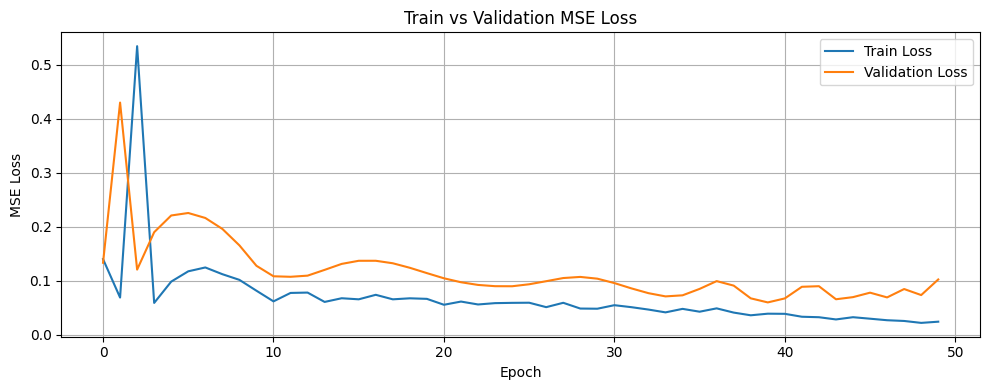

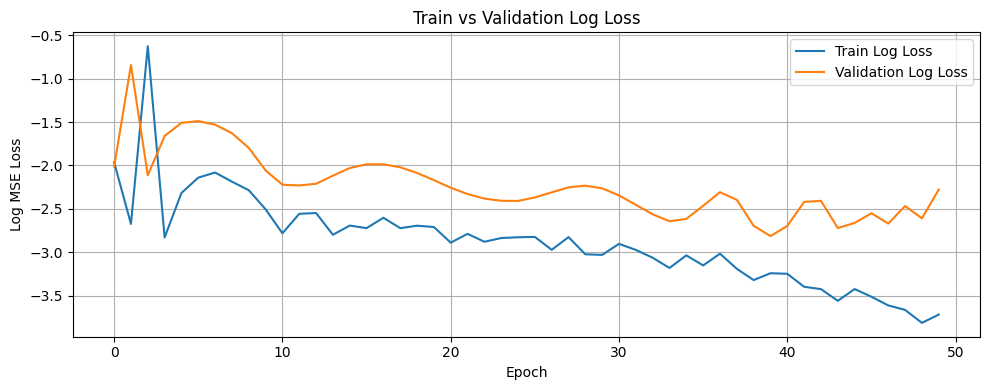

Training completed

=== Processing group: ('01 TO 03', 'QUEENSTOWN', '3 ROOM') ===
Group size: 10 rows
Calling prepare_lstm_data for ('01 TO 03', 'QUEENSTOWN', '3 ROOM')

Filtering for: QUEENSTOWN, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 385
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.0943, Val Loss: 0.0226, Train R²: -0.5700, Val R²: -1.1564
Best model saved!
Epoch 2/50, Train Loss: 0.0624, Val Loss: 0.0275, Train R²: -0.0400, Val R²: -1.6228
Epoch 3/50, Train Loss: 0.0934, Val Loss: 0.0275, Train R²: -0.5564, Val R²: -1.6257
Epoch 4/50, Train Loss: 0.0940, Val Loss: 0.0275, Train R²: -0.5655, Val R²: -1.62

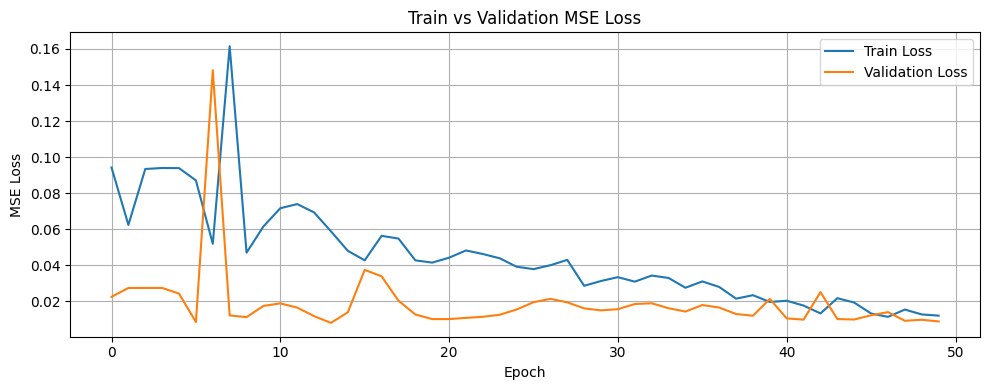

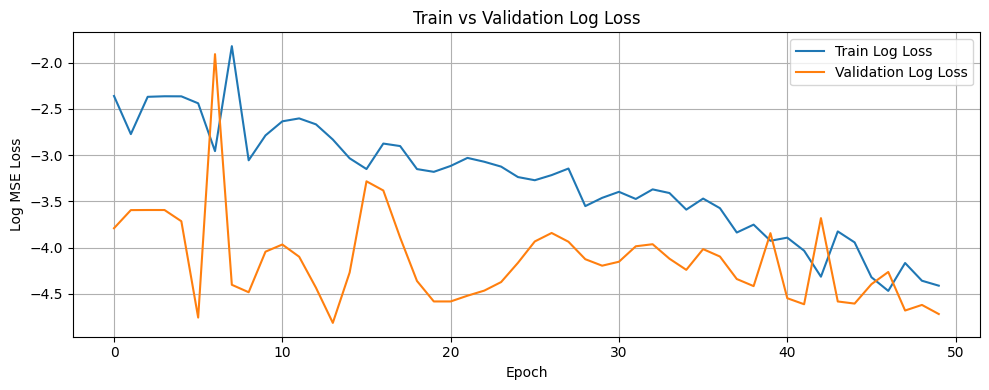

Training completed

=== Processing group: ('01 TO 03', 'QUEENSTOWN', '4 ROOM') ===
Group size: 8 rows
Calling prepare_lstm_data for ('01 TO 03', 'QUEENSTOWN', '4 ROOM')

Filtering for: QUEENSTOWN, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 189
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 45
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.4376, Val Loss: 0.1591, Train R²: -5.7103, Val R²: -3.9253
Best model saved!
Epoch 2/50, Train Loss: 0.1299, Val Loss: 0.5368, Train R²: -0.9913, Val R²: -15.6217
Epoch 3/50, Train Loss: 0.7207, Val Loss: 0.0587, Train R²: -10.0524, Val R²: -0.8170
Best model saved!
Epoch 4/50, Train Loss: 0.0698, Val Loss: 0.1916, Train R²: -0.

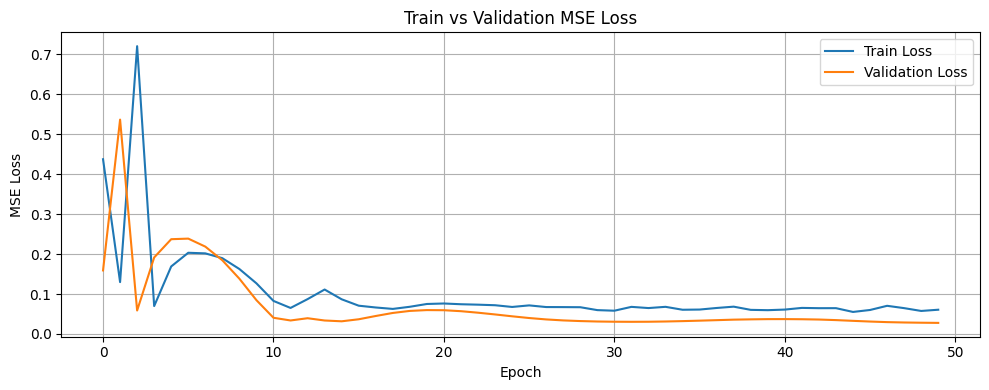

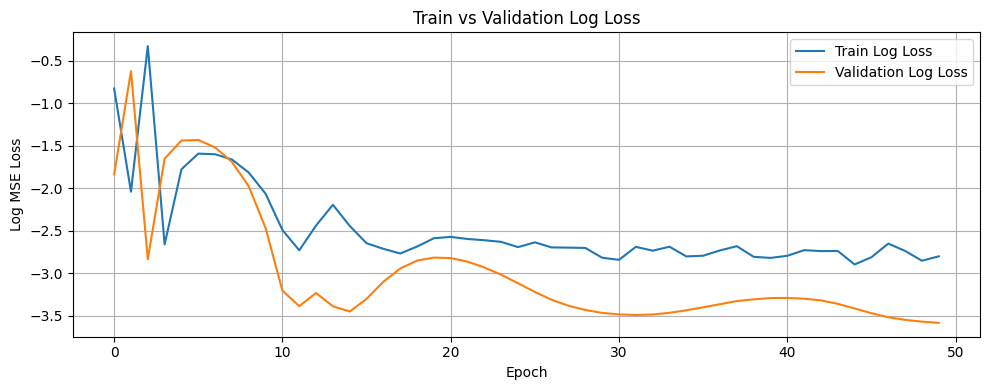

Training completed

=== Processing group: ('01 TO 03', 'QUEENSTOWN', '5 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('01 TO 03', 'QUEENSTOWN', '5 ROOM')

Filtering for: QUEENSTOWN, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 47
Using before_or_at_target with 46 records.
Removing 'block' column from dataset
Data shapes - x_train: (45, 9), y_train: (45,)
Flattened y shape: (45,), Unique values: 39
Using simple train-validation split (80/20).
Split sizes - Train: 36, Val: 9
Creating PyTorch datasets...
Dataset sizes - Train: 36, Val: 9
Using batch sizes - Train: 36, Val: 9
Starting model training...
Epoch 1/50, Train Loss: 0.2608, Val Loss: 0.0869, Train R²: -2.8221, Val R²: -0.3192
Best model saved!
Epoch 2/50, Train Loss: 0.1229, Val Loss: 0.3056, Train R²: -0.8016, Val R²: -3.6416
Epoch 3/50, Train Loss: 0.2538, Val Loss: 0.0679, Train R²: -2.7197, Val R²: -0.0317
Best model saved!
Epoch 4/50, Train Loss: 0.0896, Val Loss: 0.0973, Train R²: -0.3133, 

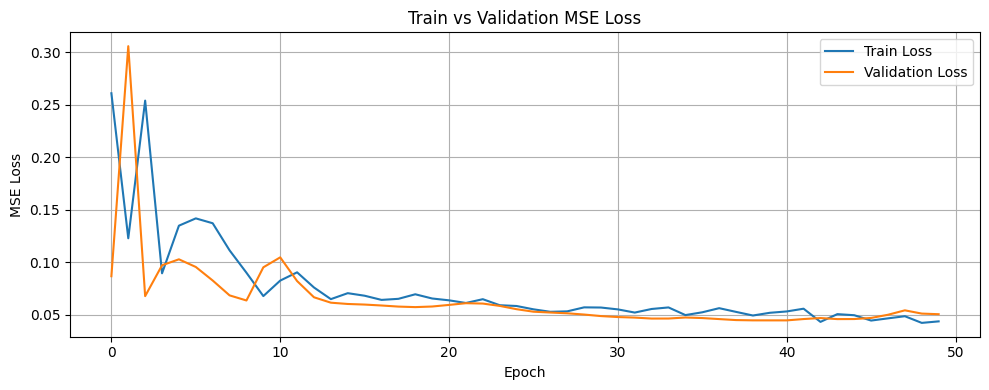

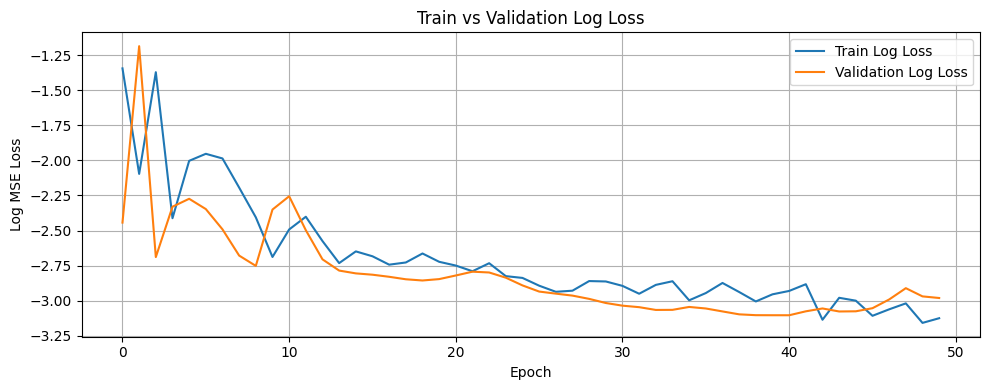

Training completed

=== Processing group: ('01 TO 03', 'QUEENSTOWN', 'EXECUTIVE') ===
Group size: 1 rows
Calling prepare_lstm_data for ('01 TO 03', 'QUEENSTOWN', 'EXECUTIVE')

Filtering for: QUEENSTOWN, EXECUTIVE, 01 TO 03, around 2025-01-01
Initial strict match count: 13
Using before_or_at_target with 12 records.
Removing 'block' column from dataset
Data shapes - x_train: (11, 9), y_train: (11,)
Flattened y shape: (11,), Unique values: 11
Using simple train-validation split (80/20).
Split sizes - Train: 8, Val: 3
Creating PyTorch datasets...
Dataset sizes - Train: 8, Val: 3
Using batch sizes - Train: 8, Val: 3
Starting model training...
Epoch 1/50, Train Loss: 0.3678, Val Loss: 0.1394, Train R²: -2.8849, Val R²: -1.3951
Best model saved!
Epoch 2/50, Train Loss: 0.1643, Val Loss: 0.2903, Train R²: -0.7352, Val R²: -3.9886
Epoch 3/50, Train Loss: 0.3437, Val Loss: 0.0787, Train R²: -2.6299, Val R²: -0.3524
Best model saved!
Epoch 4/50, Train Loss: 0.1111, Val Loss: 0.1310, Train R²: -0.

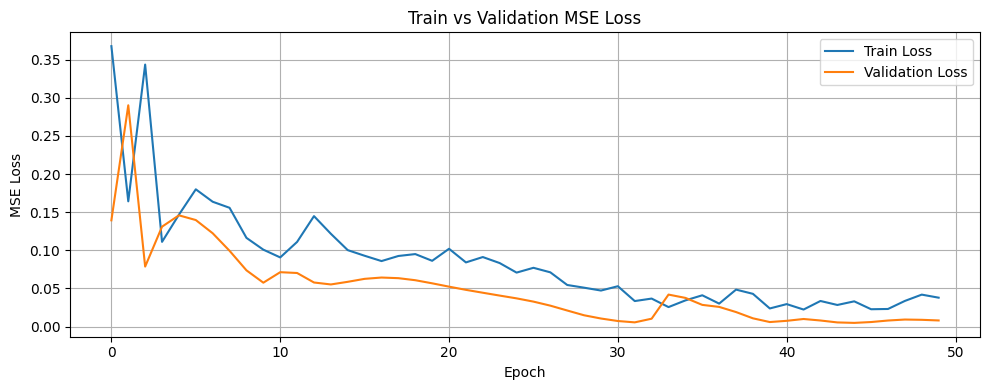

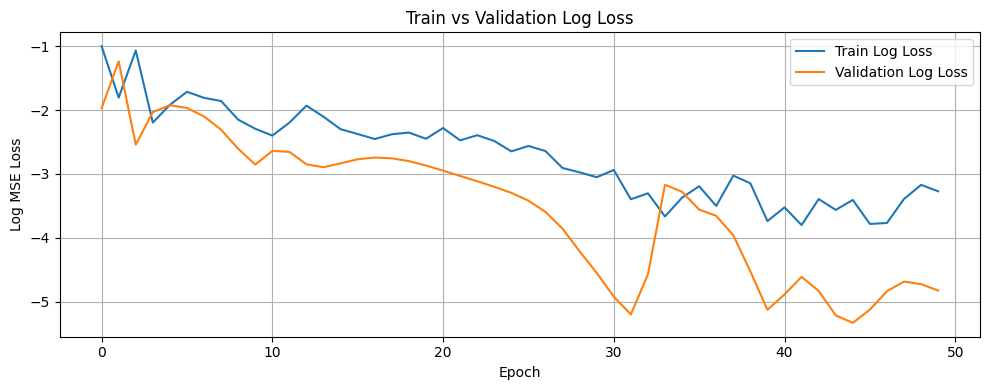

Training completed

=== Processing group: ('01 TO 03', 'SEMBAWANG', '2 ROOM') ===
Group size: 10 rows
Calling prepare_lstm_data for ('01 TO 03', 'SEMBAWANG', '2 ROOM')

Filtering for: SEMBAWANG, 2 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 44
Using before_or_at_target with 37 records.
Removing 'block' column from dataset
Data shapes - x_train: (36, 9), y_train: (36,)
Flattened y shape: (36,), Unique values: 30
Using simple train-validation split (80/20).
Split sizes - Train: 28, Val: 8
Creating PyTorch datasets...
Dataset sizes - Train: 28, Val: 8
Using batch sizes - Train: 28, Val: 8
Starting model training...
Epoch 1/50, Train Loss: 0.4188, Val Loss: 0.3189, Train R²: -7.5146, Val R²: -14.8696
Best model saved!
Epoch 2/50, Train Loss: 0.2259, Val Loss: 0.1262, Train R²: -3.5931, Val R²: -5.2781
Best model saved!
Epoch 3/50, Train Loss: 0.3060, Val Loss: 0.1804, Train R²: -5.2209, Val R²: -7.9770
Epoch 4/50, Train Loss: 0.1185, Val Loss: 0.2935, Train R²: -1.4099, V

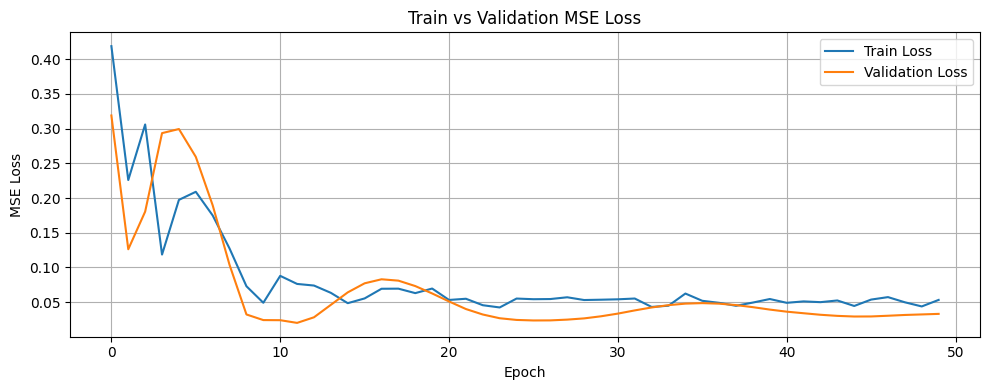

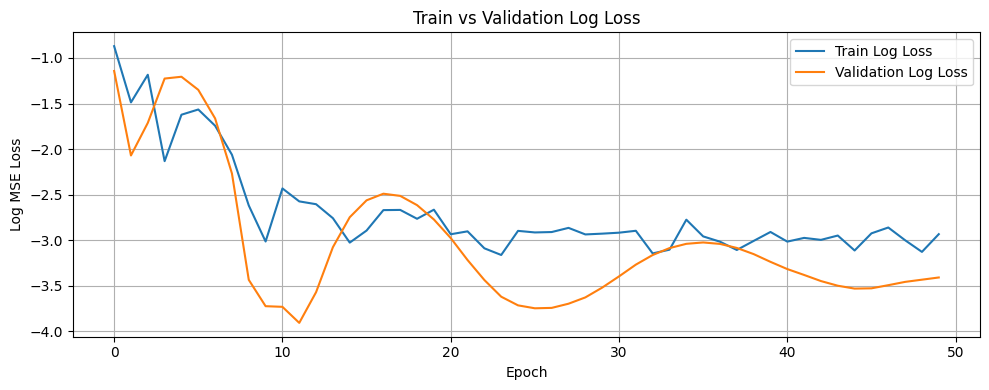

Training completed

=== Processing group: ('01 TO 03', 'SEMBAWANG', '3 ROOM') ===
Group size: 4 rows
Calling prepare_lstm_data for ('01 TO 03', 'SEMBAWANG', '3 ROOM')

Filtering for: SEMBAWANG, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 57
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3171, Val Loss: 0.2218, Train R²: -5.2586, Val R²: -9.8949
Best model saved!
Epoch 2/50, Train Loss: 0.1838, Val Loss: 0.0544, Train R²: -2.6284, Val R²: -1.6709
Best model saved!
Epoch 3/50, Train Loss: 0.1425, Val Loss: 0.0925, Train R²: -1.8125, Val R²: -3.5425
Epoch 4/50, Train Loss: 0.0871, Val Loss: 0.1291, Train R²: -0.7192, 

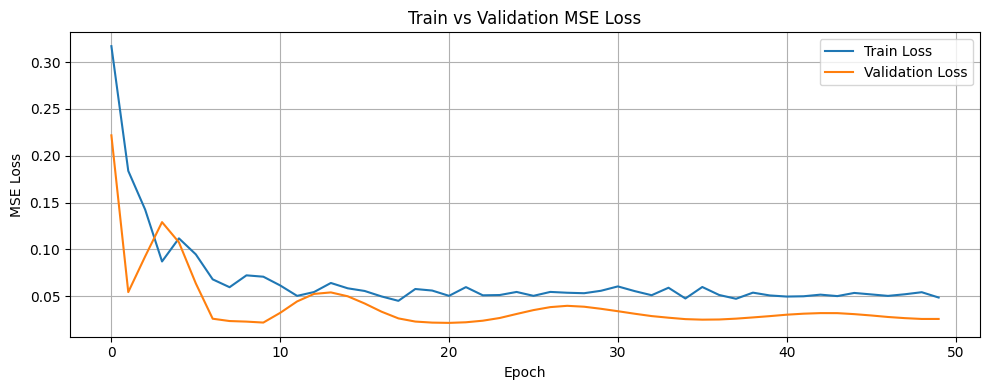

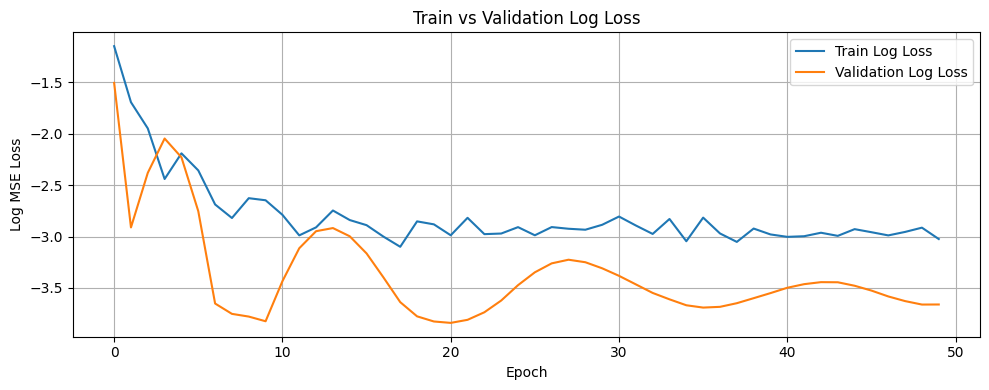

Training completed

=== Processing group: ('01 TO 03', 'SEMBAWANG', '4 ROOM') ===
Group size: 21 rows
Calling prepare_lstm_data for ('01 TO 03', 'SEMBAWANG', '4 ROOM')

Filtering for: SEMBAWANG, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 438
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2133, Val Loss: 0.0390, Train R²: -1.8913, Val R²: -0.0413
Best model saved!
Epoch 2/50, Train Loss: 0.0800, Val Loss: 0.7138, Train R²: -0.0836, Val R²: -18.0716
Epoch 3/50, Train Loss: 0.6105, Val Loss: 0.0404, Train R²: -7.2741, Val R²: -0.0805
Epoch 4/50, Train Loss: 0.0759, Val Loss: 0.0470, Train R²: -0.0287, Val R²: -0.2545

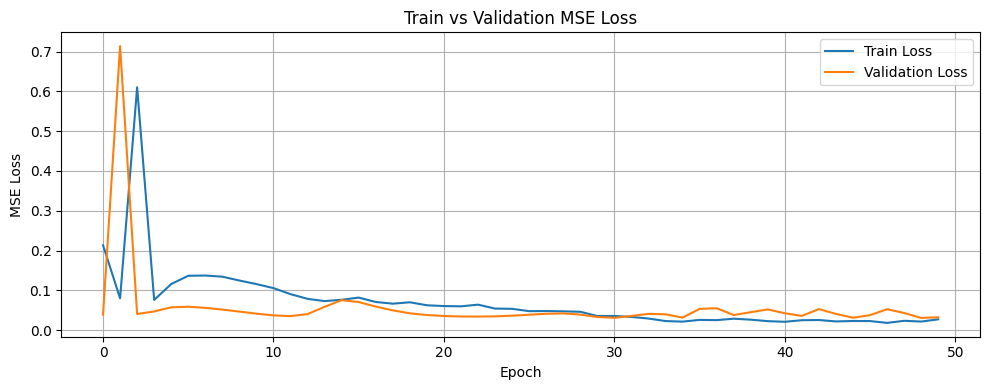

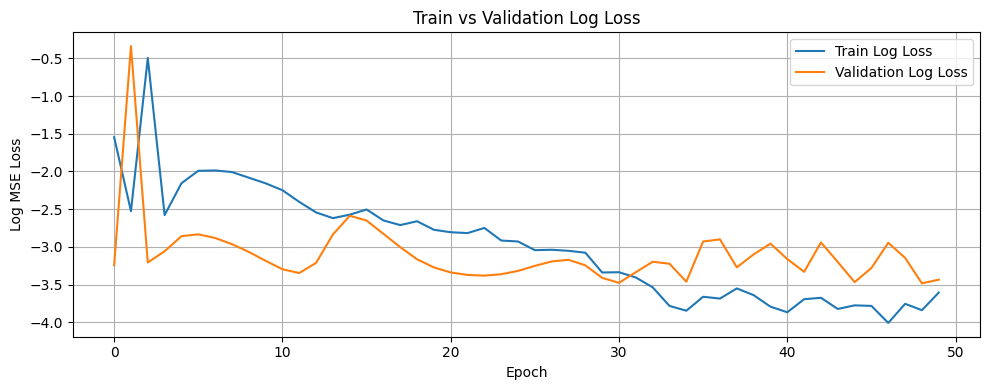

Training completed

=== Processing group: ('01 TO 03', 'SEMBAWANG', '5 ROOM') ===
Group size: 4 rows
Calling prepare_lstm_data for ('01 TO 03', 'SEMBAWANG', '5 ROOM')

Filtering for: SEMBAWANG, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 289
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 36
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1315, Val Loss: 0.0579, Train R²: -0.9621, Val R²: 0.0166
Best model saved!
Epoch 2/50, Train Loss: 0.0654, Val Loss: 0.0608, Train R²: 0.0237, Val R²: -0.0317
Epoch 3/50, Train Loss: 0.0691, Val Loss: 0.0687, Train R²: -0.0316, Val R²: -0.1666
Epoch 4/50, Train Loss: 0.0661, Val Loss: 0.0573, Train R²: 0.0141, Val R²: 0.0273
Best 

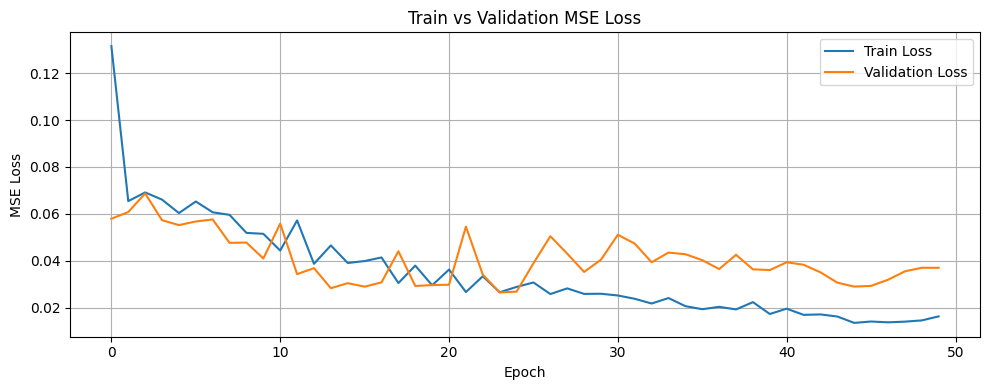

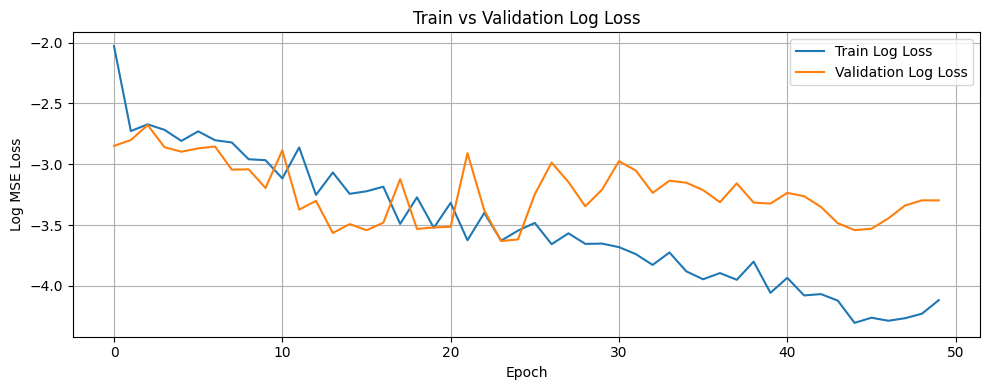

Training completed

=== Processing group: ('01 TO 03', 'SEMBAWANG', 'EXECUTIVE') ===
Group size: 5 rows
Calling prepare_lstm_data for ('01 TO 03', 'SEMBAWANG', 'EXECUTIVE')

Filtering for: SEMBAWANG, EXECUTIVE, 01 TO 03, around 2025-01-01
Initial strict match count: 102
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 36
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3311, Val Loss: 0.2006, Train R²: -2.9810, Val R²: -4.3113
Best model saved!
Epoch 2/50, Train Loss: 0.1536, Val Loss: 0.1549, Train R²: -0.8467, Val R²: -3.1016
Best model saved!
Epoch 3/50, Train Loss: 0.3353, Val Loss: 0.1281, Train R²: -3.0315, Val R²: -2.3920
Best model saved!
Epoch 4/50, Train Loss: 0.1123, Val Loss:

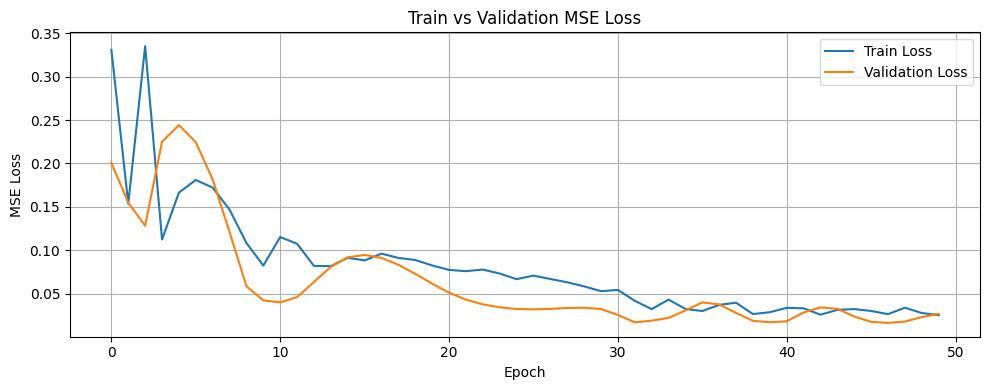

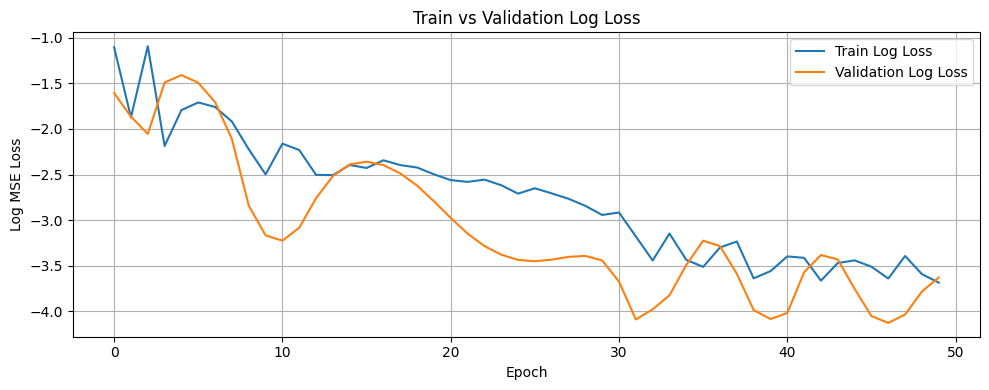

Training completed

=== Processing group: ('01 TO 03', 'SENGKANG', '2 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('01 TO 03', 'SENGKANG', '2 ROOM')

Filtering for: SENGKANG, 2 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 32
Using before_or_at_target with 32 records.
Removing 'block' column from dataset
Data shapes - x_train: (31, 9), y_train: (31,)
Flattened y shape: (31,), Unique values: 22
Using simple train-validation split (80/20).
Split sizes - Train: 24, Val: 7
Creating PyTorch datasets...
Dataset sizes - Train: 24, Val: 7
Using batch sizes - Train: 24, Val: 7
Starting model training...
Epoch 1/50, Train Loss: 0.2912, Val Loss: 0.2638, Train R²: -2.1596, Val R²: -1.8042
Best model saved!
Epoch 2/50, Train Loss: 0.1719, Val Loss: 0.2077, Train R²: -0.8646, Val R²: -1.2078
Best model saved!
Epoch 3/50, Train Loss: 0.2945, Val Loss: 0.1785, Train R²: -2.1944, Val R²: -0.8968
Best model saved!
Epoch 4/50, Train Loss: 0.1259, Val Loss: 0.2717, Train R

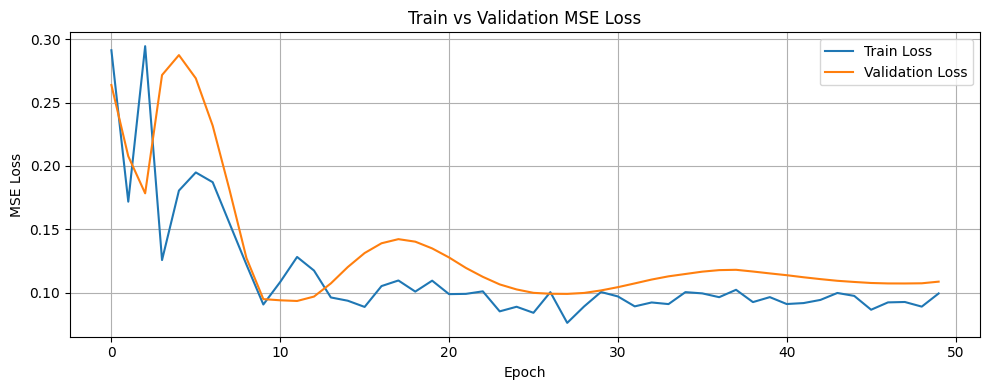

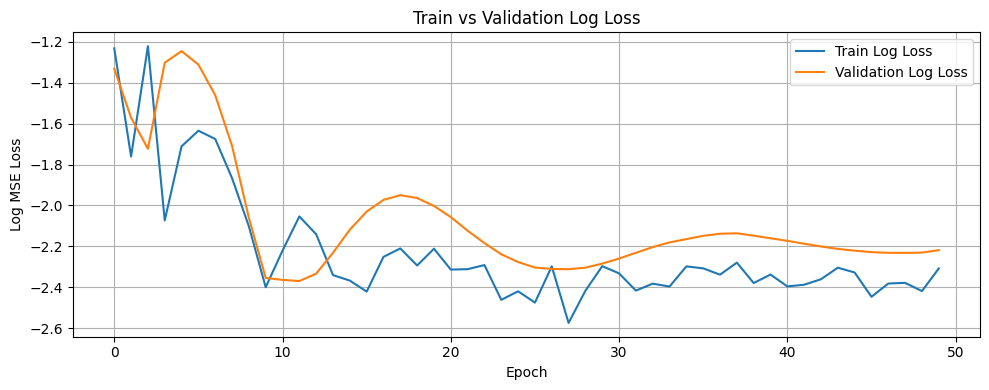

Training completed

=== Processing group: ('01 TO 03', 'SENGKANG', '3 ROOM') ===
Group size: 3 rows
Calling prepare_lstm_data for ('01 TO 03', 'SENGKANG', '3 ROOM')

Filtering for: SENGKANG, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 115
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 31
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1963, Val Loss: 0.0753, Train R²: -3.1609, Val R²: -1.0789
Best model saved!
Epoch 2/50, Train Loss: 0.0680, Val Loss: 0.4423, Train R²: -0.4421, Val R²: -11.2058
Epoch 3/50, Train Loss: 0.5793, Val Loss: 0.0543, Train R²: -11.2805, Val R²: -0.4989
Best model saved!
Epoch 4/50, Train Loss: 0.0524, Val Loss: 0.1270, Train R²: -0.1117, 

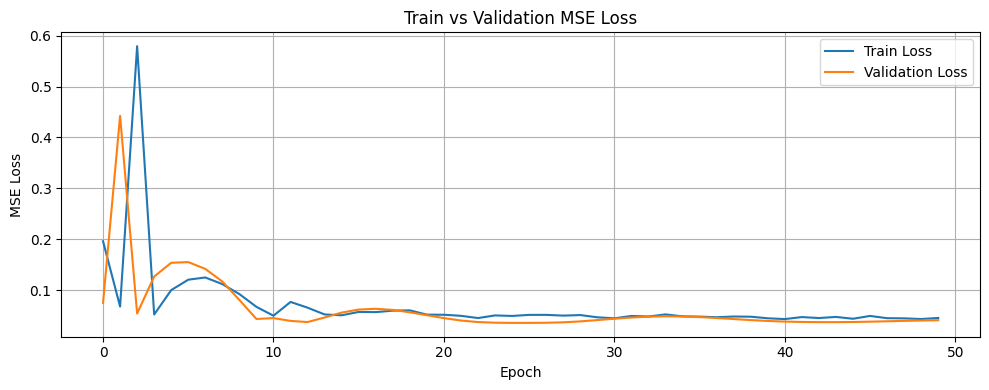

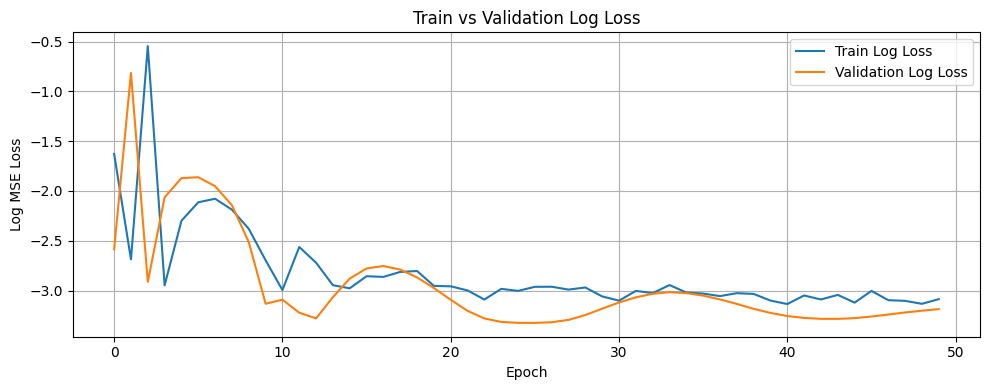

Training completed

=== Processing group: ('01 TO 03', 'SENGKANG', '4 ROOM') ===
Group size: 28 rows
Calling prepare_lstm_data for ('01 TO 03', 'SENGKANG', '4 ROOM')

Filtering for: SENGKANG, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 1065
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 32
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.0937, Val Loss: 0.0163, Train R²: -1.4595, Val R²: -0.1169
Best model saved!
Epoch 2/50, Train Loss: 0.0357, Val Loss: 0.4283, Train R²: 0.0644, Val R²: -28.3470
Epoch 3/50, Train Loss: 0.4227, Val Loss: 0.0123, Train R²: -10.0917, Val R²: 0.1580
Best model saved!
Epoch 4/50, Train Loss: 0.0368, Val Loss: 0.0370, Train R²: 0.0356, V

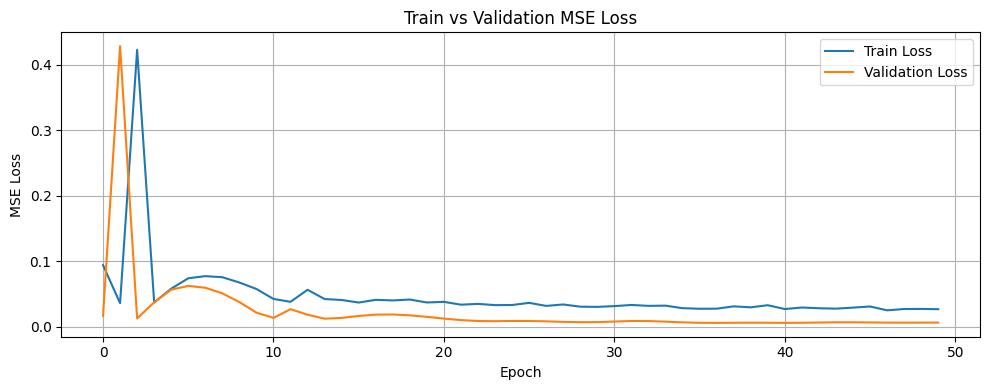

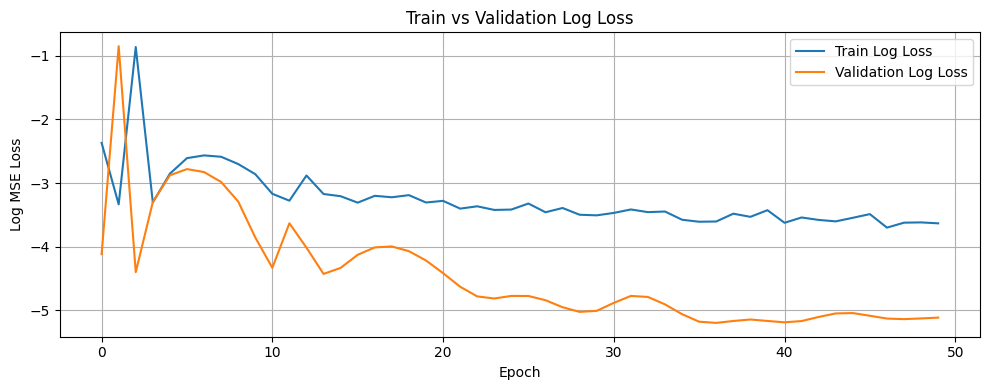

Training completed

=== Processing group: ('01 TO 03', 'SENGKANG', '5 ROOM') ===
Group size: 24 rows
Calling prepare_lstm_data for ('01 TO 03', 'SENGKANG', '5 ROOM')

Filtering for: SENGKANG, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 786
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1546, Val Loss: 0.0489, Train R²: -1.9605, Val R²: -1.1902
Best model saved!
Epoch 2/50, Train Loss: 0.0864, Val Loss: 0.2010, Train R²: -0.6549, Val R²: -8.0057
Epoch 3/50, Train Loss: 0.2325, Val Loss: 0.0305, Train R²: -3.4523, Val R²: -0.3681
Best model saved!
Epoch 4/50, Train Loss: 0.0595, Val Loss: 0.0654, Train R²: -0.1398, V

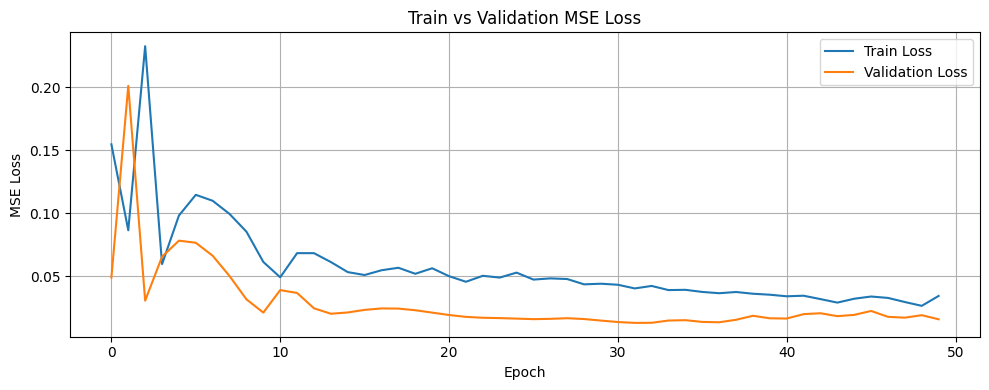

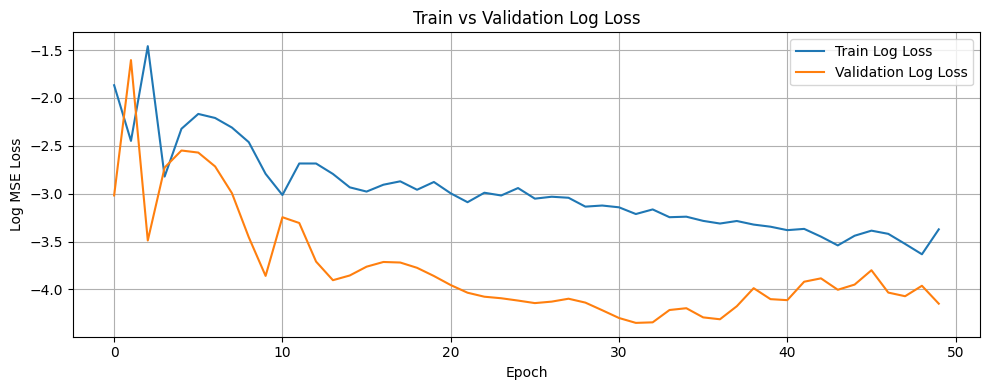

Training completed

=== Processing group: ('01 TO 03', 'SENGKANG', 'EXECUTIVE') ===
Group size: 2 rows
Calling prepare_lstm_data for ('01 TO 03', 'SENGKANG', 'EXECUTIVE')

Filtering for: SENGKANG, EXECUTIVE, 01 TO 03, around 2025-01-01
Initial strict match count: 160
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1877, Val Loss: 0.0926, Train R²: -3.1190, Val R²: -0.3440
Best model saved!
Epoch 2/50, Train Loss: 0.0573, Val Loss: 0.7907, Train R²: -0.2574, Val R²: -10.4734
Epoch 3/50, Train Loss: 0.9700, Val Loss: 0.0732, Train R²: -20.2913, Val R²: -0.0616
Best model saved!
Epoch 4/50, Train Loss: 0.0498, Val Loss: 0.1423, Train R²: 

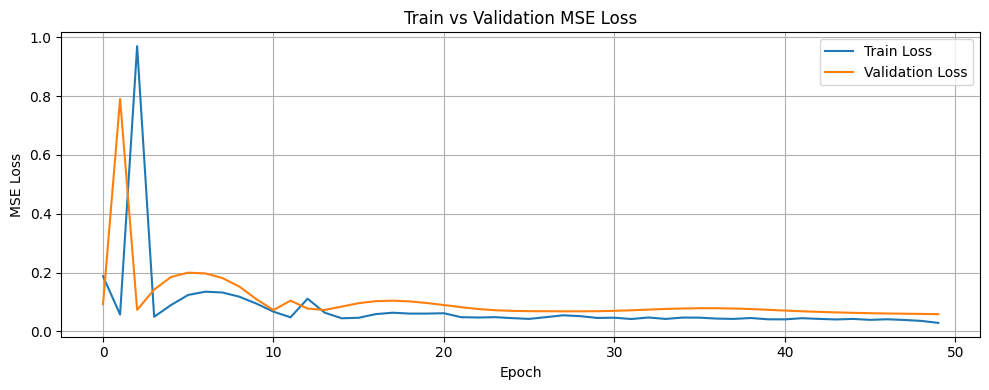

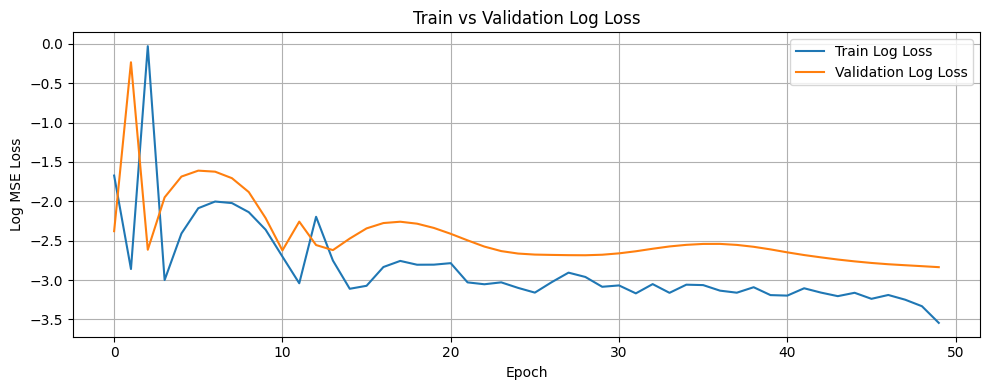

Training completed

=== Processing group: ('01 TO 03', 'SERANGOON', '3 ROOM') ===
Group size: 4 rows
Calling prepare_lstm_data for ('01 TO 03', 'SERANGOON', '3 ROOM')

Filtering for: SERANGOON, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 224
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 31
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1853, Val Loss: 0.0560, Train R²: -2.1304, Val R²: -1.4295
Best model saved!
Epoch 2/50, Train Loss: 0.1012, Val Loss: 0.2231, Train R²: -0.7102, Val R²: -8.6786
Epoch 3/50, Train Loss: 0.2894, Val Loss: 0.0314, Train R²: -3.8893, Val R²: -0.3635
Best model saved!
Epoch 4/50, Train Loss: 0.0781, Val Loss: 0.0739, Train R²: -0.3201,

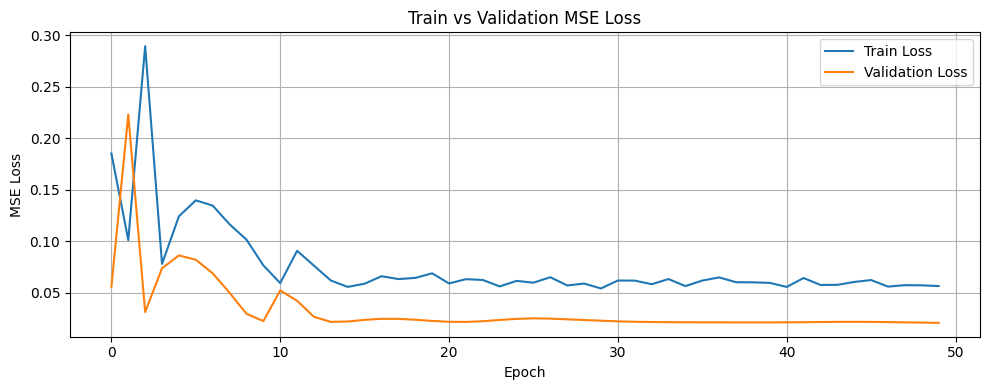

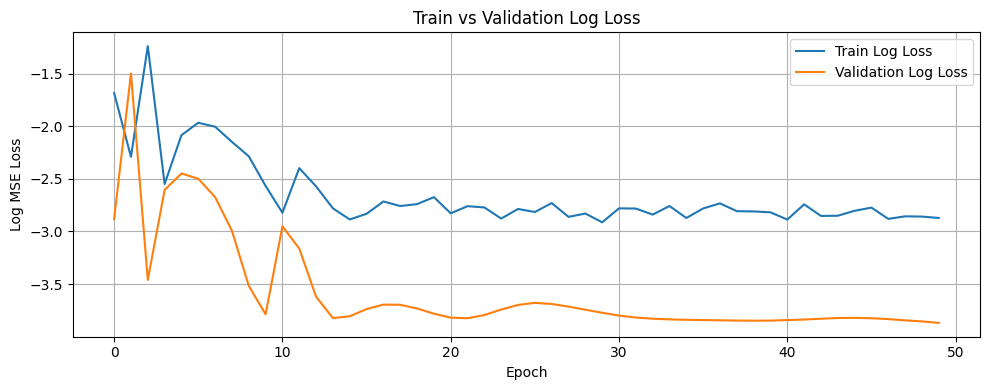

Training completed

=== Processing group: ('01 TO 03', 'SERANGOON', '4 ROOM') ===
Group size: 12 rows
Calling prepare_lstm_data for ('01 TO 03', 'SERANGOON', '4 ROOM')

Filtering for: SERANGOON, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 351
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 36
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1944, Val Loss: 0.0423, Train R²: -2.1223, Val R²: -0.2241
Best model saved!
Epoch 2/50, Train Loss: 0.0637, Val Loss: 0.1203, Train R²: -0.0227, Val R²: -2.4813
Epoch 3/50, Train Loss: 0.2106, Val Loss: 0.0794, Train R²: -2.3835, Val R²: -1.2981
Epoch 4/50, Train Loss: 0.0795, Val Loss: 0.1273, Train R²: -0.2773, Val R²: -2.6837


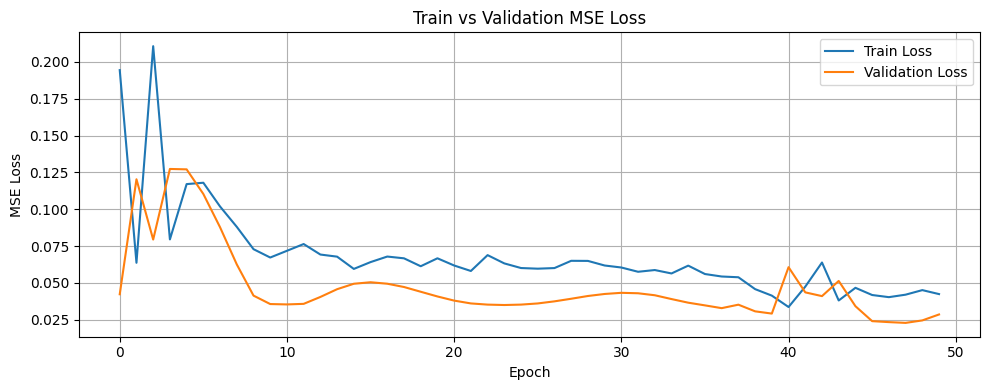

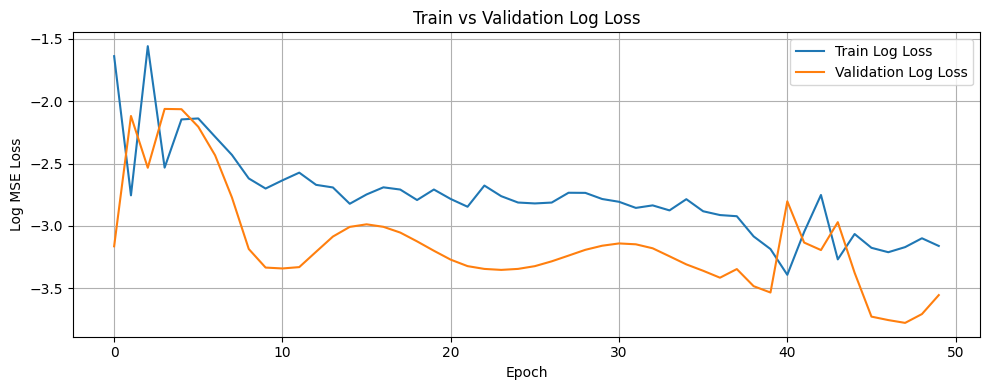

Training completed

=== Processing group: ('01 TO 03', 'SERANGOON', '5 ROOM') ===
Group size: 6 rows
Calling prepare_lstm_data for ('01 TO 03', 'SERANGOON', '5 ROOM')

Filtering for: SERANGOON, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 153
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 39
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3309, Val Loss: 0.0728, Train R²: -2.6261, Val R²: -0.8609
Best model saved!
Epoch 2/50, Train Loss: 0.1963, Val Loss: 0.3263, Train R²: -1.1505, Val R²: -7.3472
Epoch 3/50, Train Loss: 0.2589, Val Loss: 0.0424, Train R²: -1.8373, Val R²: -0.0854
Best model saved!
Epoch 4/50, Train Loss: 0.1304, Val Loss: 0.0639, Train R²: -0.4293,

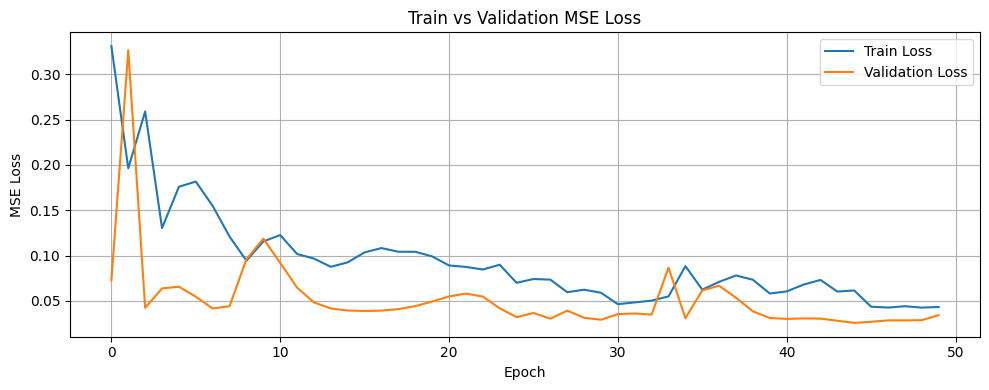

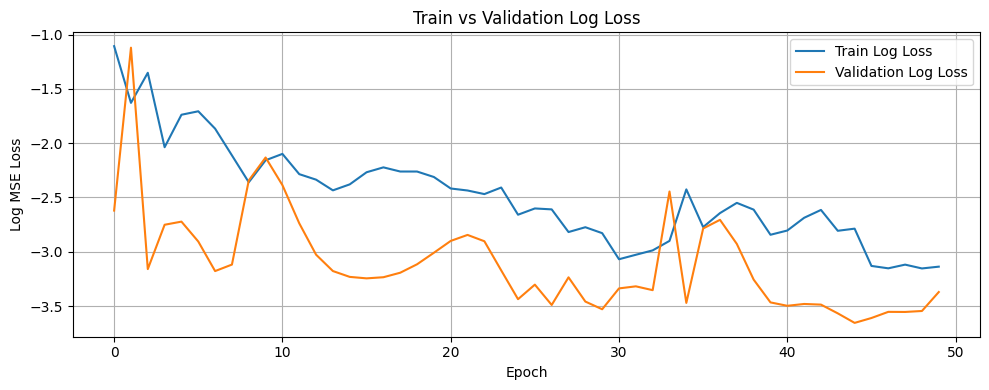

Training completed

=== Processing group: ('01 TO 03', 'SERANGOON', 'EXECUTIVE') ===
Group size: 2 rows
Calling prepare_lstm_data for ('01 TO 03', 'SERANGOON', 'EXECUTIVE')

Filtering for: SERANGOON, EXECUTIVE, 01 TO 03, around 2025-01-01
Initial strict match count: 139
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 38
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1897, Val Loss: 0.3019, Train R²: -2.5785, Val R²: -8.3700
Best model saved!
Epoch 2/50, Train Loss: 0.0831, Val Loss: 0.0650, Train R²: -0.5671, Val R²: -1.0181
Best model saved!
Epoch 3/50, Train Loss: 0.4043, Val Loss: 0.2258, Train R²: -6.6276, Val R²: -6.0061
Epoch 4/50, Train Loss: 0.0600, Val Loss: 0.3584, Train R²:

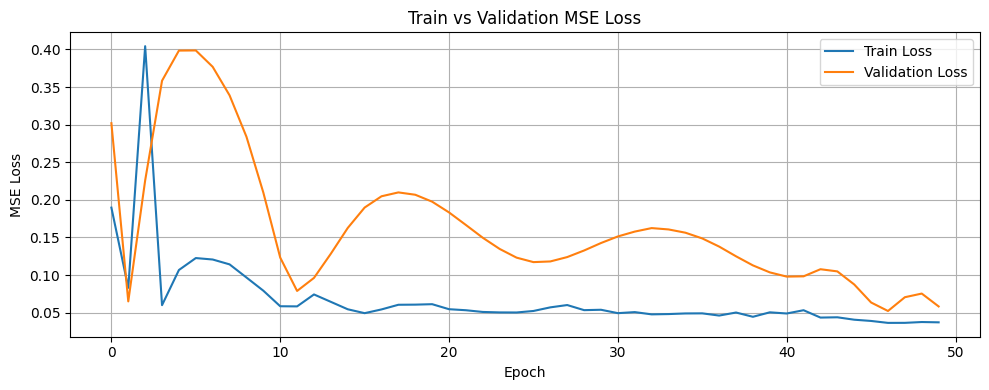

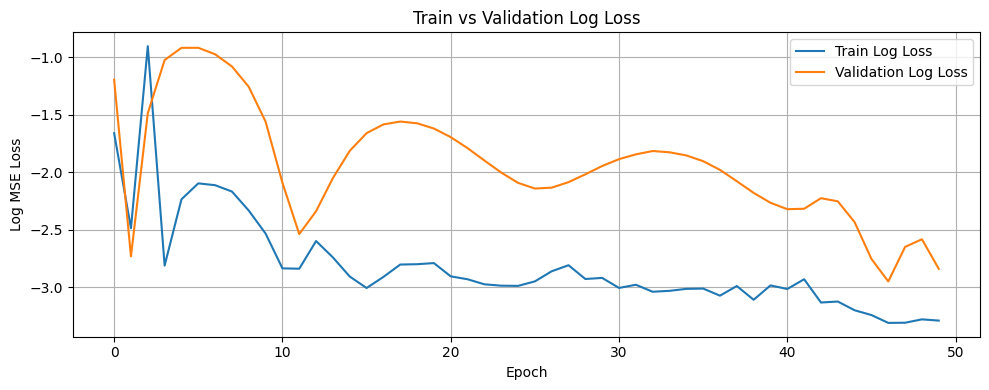

Training completed

=== Processing group: ('01 TO 03', 'TAMPINES', '3 ROOM') ===
Group size: 9 rows
Calling prepare_lstm_data for ('01 TO 03', 'TAMPINES', '3 ROOM')

Filtering for: TAMPINES, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 694
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 31
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1454, Val Loss: 0.0147, Train R²: -1.6302, Val R²: -0.1712
Best model saved!
Epoch 2/50, Train Loss: 0.0559, Val Loss: 0.0211, Train R²: -0.0102, Val R²: -0.6844
Epoch 3/50, Train Loss: 0.0620, Val Loss: 0.0329, Train R²: -0.1212, Val R²: -1.6288
Epoch 4/50, Train Loss: 0.0585, Val Loss: 0.0135, Train R²: -0.0575, Val R²: -0.0820
Best

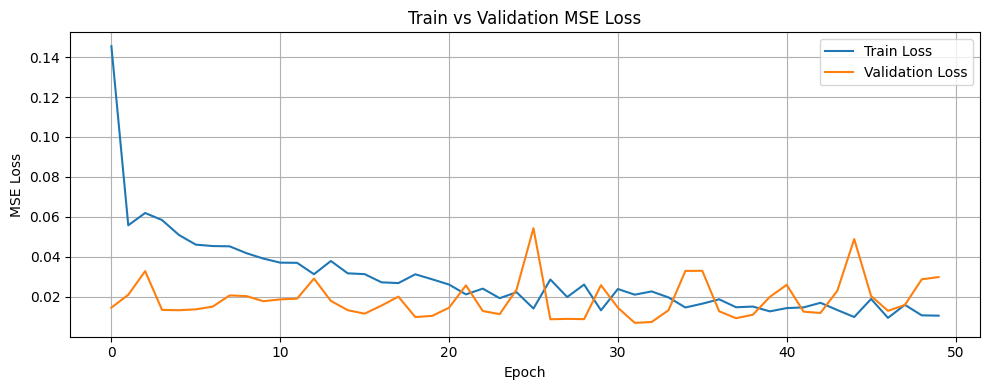

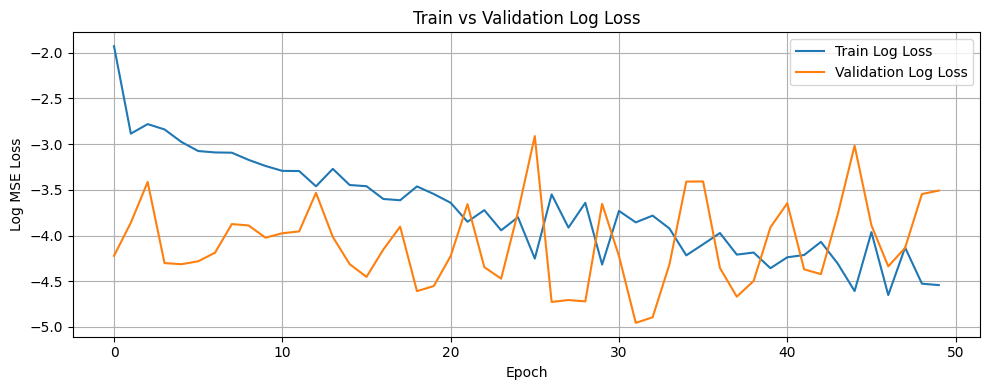

Training completed

=== Processing group: ('01 TO 03', 'TAMPINES', '4 ROOM') ===
Group size: 31 rows
Calling prepare_lstm_data for ('01 TO 03', 'TAMPINES', '4 ROOM')

Filtering for: TAMPINES, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 1201
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 31
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1552, Val Loss: 0.0348, Train R²: -1.8078, Val R²: -3.4358
Best model saved!
Epoch 2/50, Train Loss: 0.0533, Val Loss: 0.0582, Train R²: 0.0359, Val R²: -6.4099
Epoch 3/50, Train Loss: 0.0577, Val Loss: 0.0078, Train R²: -0.0440, Val R²: 0.0050
Best model saved!
Epoch 4/50, Train Loss: 0.0613, Val Loss: 0.0126, Train R²: -0.1086, Va

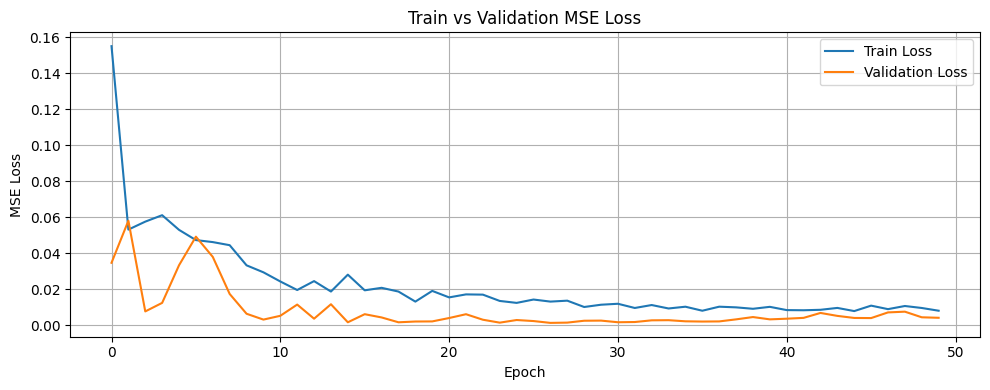

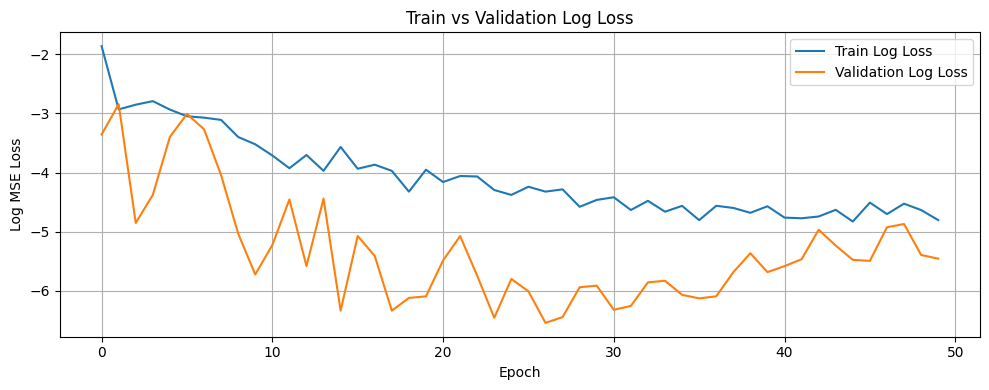

Training completed

=== Processing group: ('01 TO 03', 'TAMPINES', '5 ROOM') ===
Group size: 25 rows
Calling prepare_lstm_data for ('01 TO 03', 'TAMPINES', '5 ROOM')

Filtering for: TAMPINES, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 813
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 32
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2551, Val Loss: 0.0831, Train R²: -2.5940, Val R²: -0.0516
Best model saved!
Epoch 2/50, Train Loss: 0.0807, Val Loss: 0.8974, Train R²: -0.1375, Val R²: -10.3560
Epoch 3/50, Train Loss: 0.8646, Val Loss: 0.0777, Train R²: -11.1802, Val R²: 0.0173
Best model saved!
Epoch 4/50, Train Loss: 0.0660, Val Loss: 0.1158, Train R²: 0.0700, V

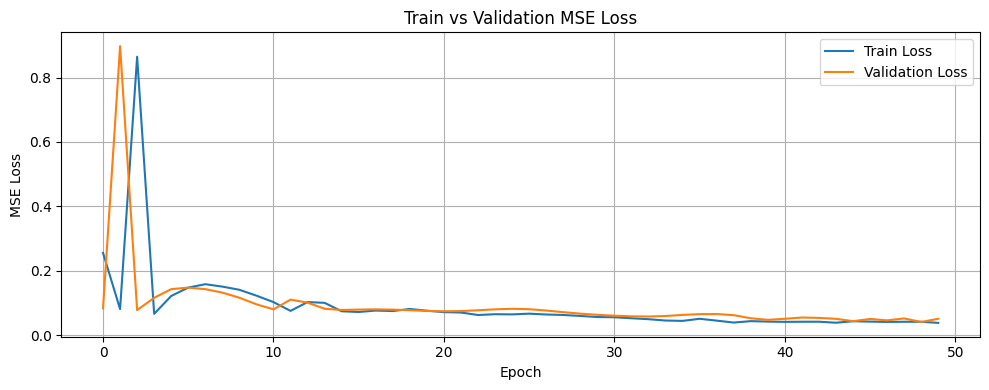

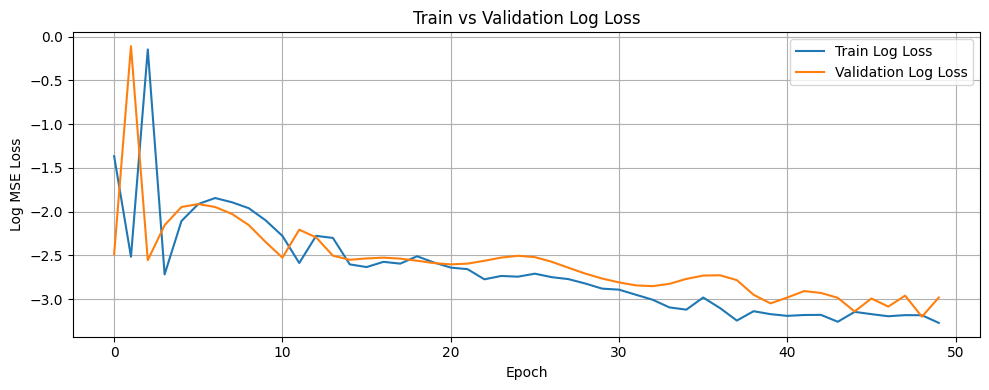

Training completed

=== Processing group: ('01 TO 03', 'TAMPINES', 'EXECUTIVE') ===
Group size: 7 rows
Calling prepare_lstm_data for ('01 TO 03', 'TAMPINES', 'EXECUTIVE')

Filtering for: TAMPINES, EXECUTIVE, 01 TO 03, around 2025-01-01
Initial strict match count: 356
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 35
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3160, Val Loss: 0.3541, Train R²: -8.4649, Val R²: -11.1906
Best model saved!
Epoch 2/50, Train Loss: 0.1998, Val Loss: 0.0357, Train R²: -4.9833, Val R²: -0.2284
Best model saved!
Epoch 3/50, Train Loss: 0.0789, Val Loss: 0.1613, Train R²: -1.3630, Val R²: -4.5539
Epoch 4/50, Train Loss: 0.0764, Val Loss: 0.1569, Train R²: -

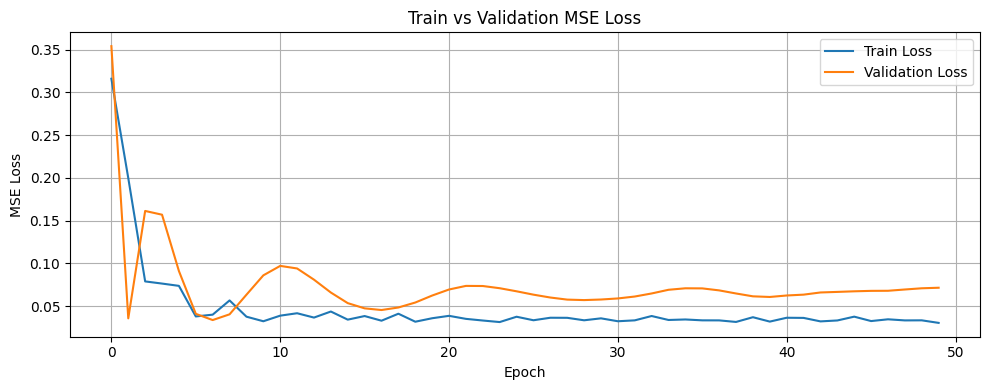

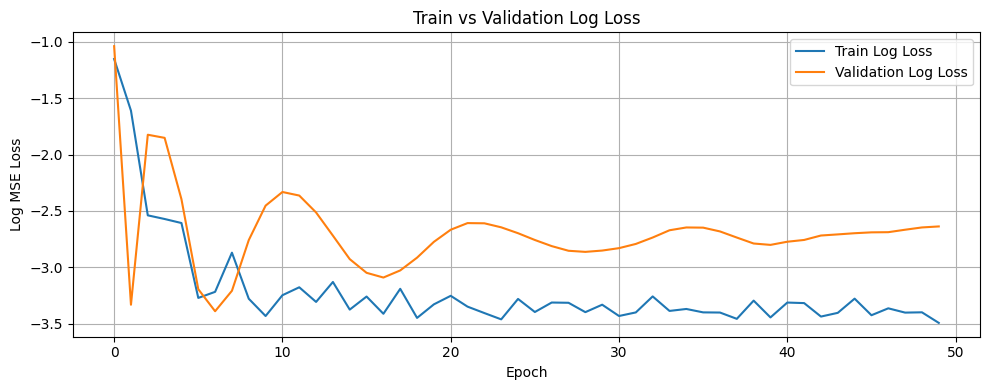

Training completed

=== Processing group: ('01 TO 03', 'TOA PAYOH', '2 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('01 TO 03', 'TOA PAYOH', '2 ROOM')

Filtering for: TOA PAYOH, 2 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 51
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 36
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3159, Val Loss: 0.2108, Train R²: -4.6028, Val R²: -2.9904
Best model saved!
Epoch 2/50, Train Loss: 0.1431, Val Loss: 0.2702, Train R²: -1.5389, Val R²: -4.1156
Epoch 3/50, Train Loss: 0.4275, Val Loss: 0.1345, Train R²: -6.5831, Val R²: -1.5461
Best model saved!
Epoch 4/50, Train Loss: 0.0912, Val Loss: 0.2466, Train R²: -0.6175, 

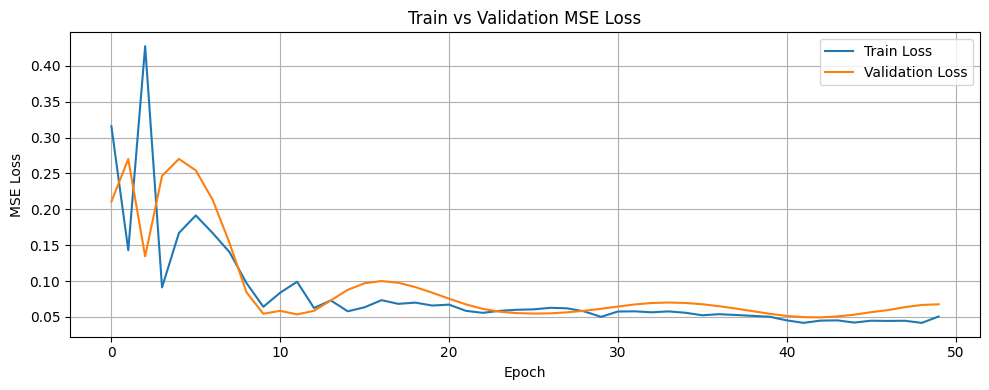

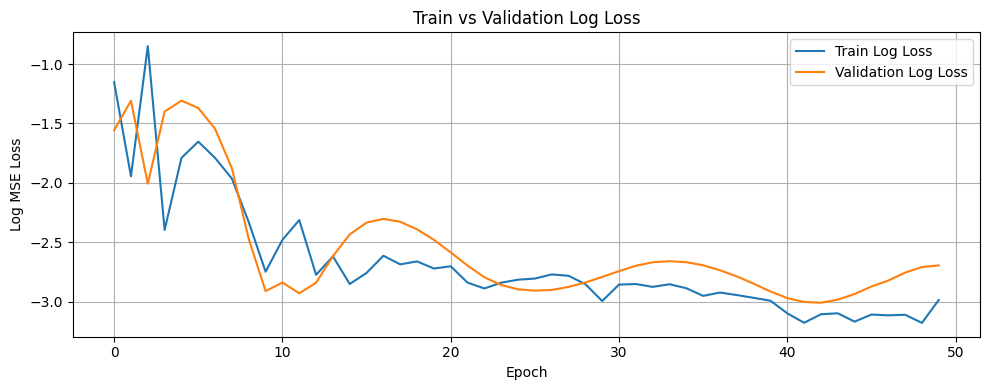

Training completed

=== Processing group: ('01 TO 03', 'TOA PAYOH', '3 ROOM') ===
Group size: 19 rows
Calling prepare_lstm_data for ('01 TO 03', 'TOA PAYOH', '3 ROOM')

Filtering for: TOA PAYOH, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 555
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 31
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.0434, Val Loss: 0.0397, Train R²: -0.5046, Val R²: -0.1176
Best model saved!
Epoch 2/50, Train Loss: 0.0541, Val Loss: 0.0481, Train R²: -0.8742, Val R²: -0.3521
Epoch 3/50, Train Loss: 0.0296, Val Loss: 0.0571, Train R²: -0.0243, Val R²: -0.6044
Epoch 4/50, Train Loss: 0.0339, Val Loss: 0.0545, Train R²: -0.1761, Val R²: -0.5317


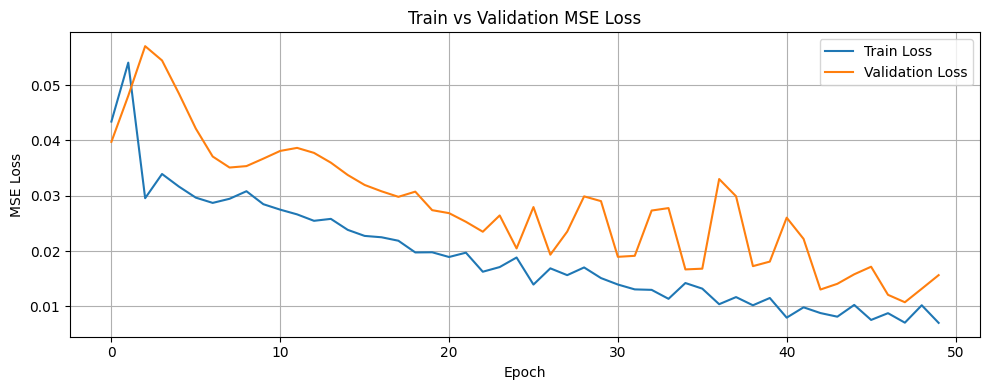

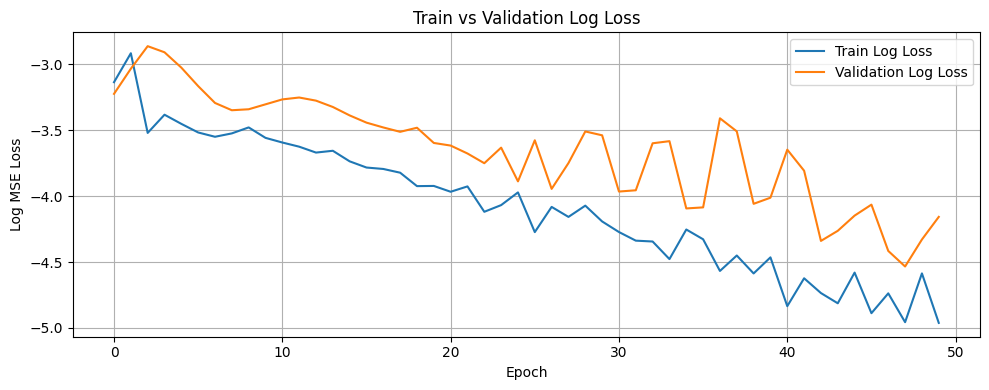

Training completed

=== Processing group: ('01 TO 03', 'TOA PAYOH', '4 ROOM') ===
Group size: 9 rows
Calling prepare_lstm_data for ('01 TO 03', 'TOA PAYOH', '4 ROOM')

Filtering for: TOA PAYOH, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 259
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 43
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2197, Val Loss: 0.0878, Train R²: -1.9788, Val R²: 0.0281
Best model saved!
Epoch 2/50, Train Loss: 0.0720, Val Loss: 0.8251, Train R²: 0.0235, Val R²: -8.1340
Epoch 3/50, Train Loss: 0.7197, Val Loss: 0.0875, Train R²: -8.7580, Val R²: 0.0313
Best model saved!
Epoch 4/50, Train Loss: 0.0706, Val Loss: 0.1023, Train R²: 0.0425, Val

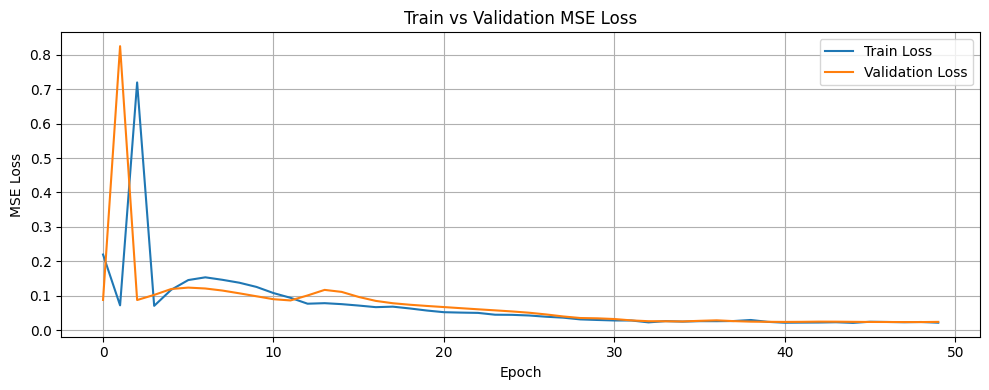

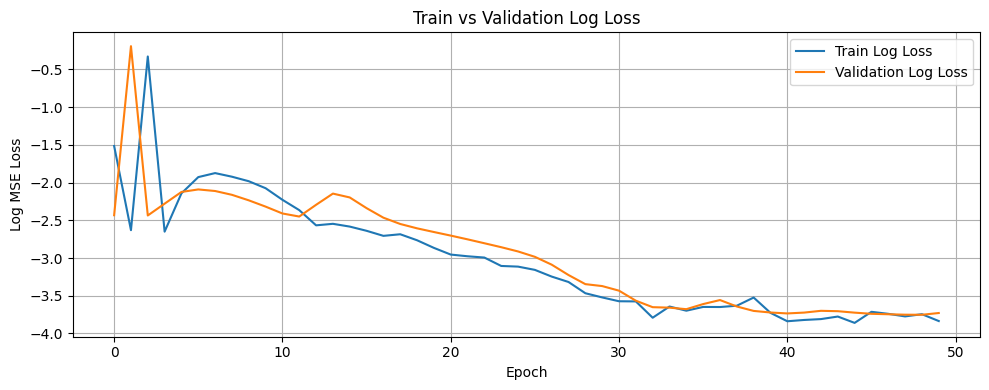

Training completed

=== Processing group: ('01 TO 03', 'TOA PAYOH', '5 ROOM') ===
Group size: 6 rows
Calling prepare_lstm_data for ('01 TO 03', 'TOA PAYOH', '5 ROOM')

Filtering for: TOA PAYOH, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 121
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 44
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2403, Val Loss: 0.0610, Train R²: -3.8170, Val R²: -1.5809
Best model saved!
Epoch 2/50, Train Loss: 0.0568, Val Loss: 0.7050, Train R²: -0.1387, Val R²: -28.8311
Epoch 3/50, Train Loss: 0.9346, Val Loss: 0.0220, Train R²: -17.7380, Val R²: 0.0691
Best model saved!
Epoch 4/50, Train Loss: 0.0506, Val Loss: 0.1281, Train R²: -0.0145

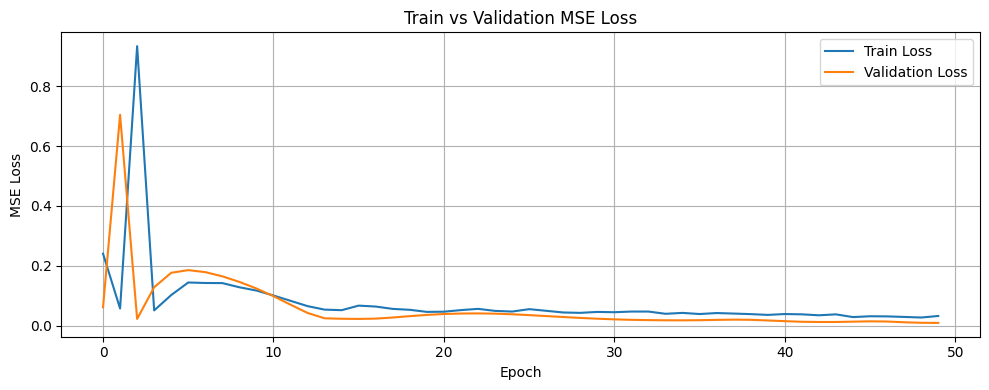

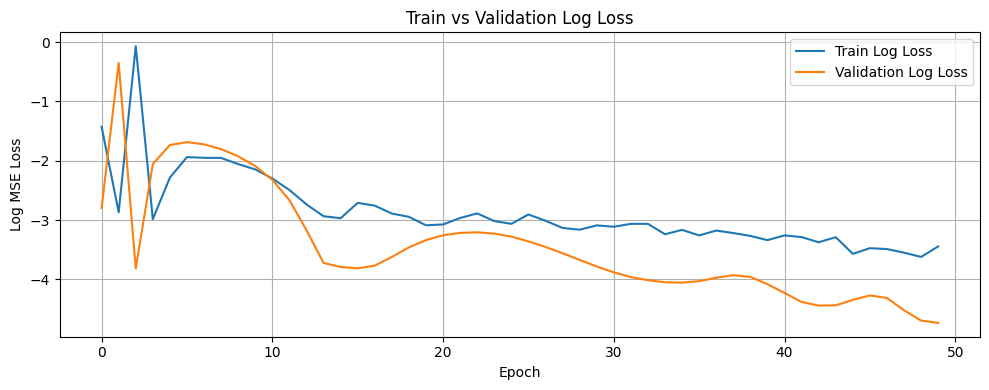

Training completed

=== Processing group: ('01 TO 03', 'TOA PAYOH', 'EXECUTIVE') ===
Group size: 2 rows
Calling prepare_lstm_data for ('01 TO 03', 'TOA PAYOH', 'EXECUTIVE')

Filtering for: TOA PAYOH, EXECUTIVE, 01 TO 03, around 2025-01-01
Initial strict match count: 66
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 40
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2492, Val Loss: 0.1141, Train R²: -3.4447, Val R²: -9.7390
Best model saved!
Epoch 2/50, Train Loss: 0.1083, Val Loss: 0.1708, Train R²: -0.9318, Val R²: -15.0686
Epoch 3/50, Train Loss: 0.2994, Val Loss: 0.0640, Train R²: -4.3399, Val R²: -5.0272
Best model saved!
Epoch 4/50, Train Loss: 0.0762, Val Loss: 0.1448, Train R²:

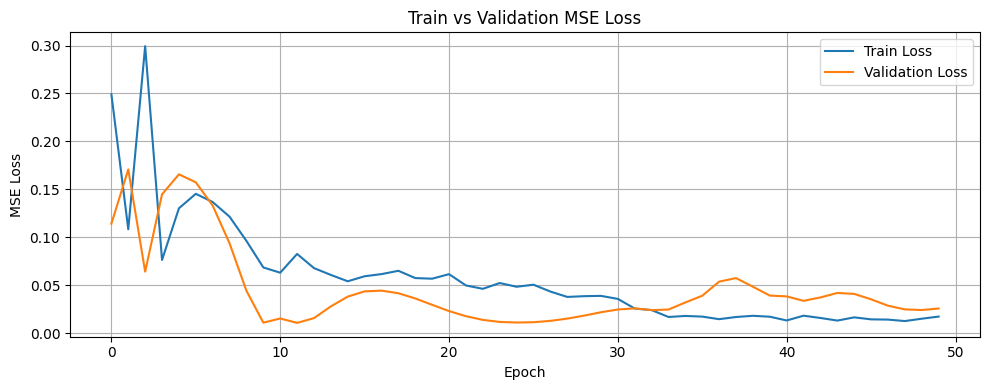

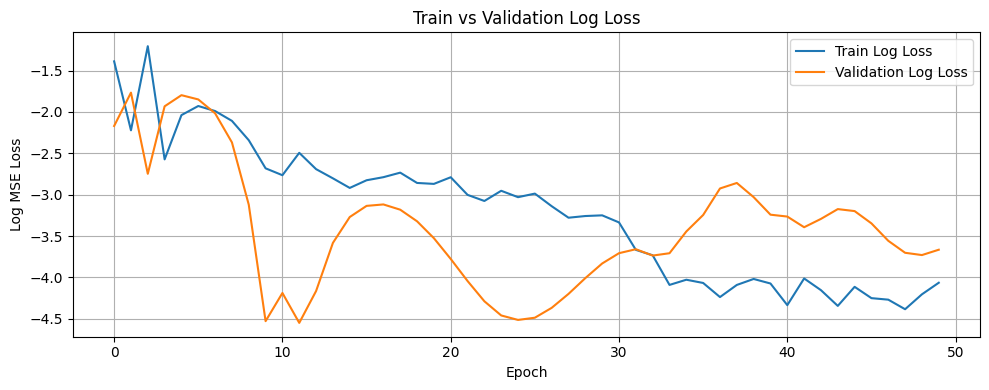

Training completed

=== Processing group: ('01 TO 03', 'WOODLANDS', '2 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('01 TO 03', 'WOODLANDS', '2 ROOM')

Filtering for: WOODLANDS, 2 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 27
Using before_or_at_target with 27 records.
Removing 'block' column from dataset
Data shapes - x_train: (26, 9), y_train: (26,)
Flattened y shape: (26,), Unique values: 22
Using simple train-validation split (80/20).
Split sizes - Train: 20, Val: 6
Creating PyTorch datasets...
Dataset sizes - Train: 20, Val: 6
Using batch sizes - Train: 20, Val: 6
Starting model training...
Epoch 1/50, Train Loss: 0.2762, Val Loss: 0.0687, Train R²: -2.8783, Val R²: -0.0289
Best model saved!
Epoch 2/50, Train Loss: 0.0921, Val Loss: 1.6480, Train R²: -0.2940, Val R²: -23.6665
Epoch 3/50, Train Loss: 1.3898, Val Loss: 0.0956, Train R²: -18.5171, Val R²: -0.4306
Epoch 4/50, Train Loss: 0.0713, Val Loss: 0.0730, Train R²: -0.0006, Val R²: -0.0930
Epo

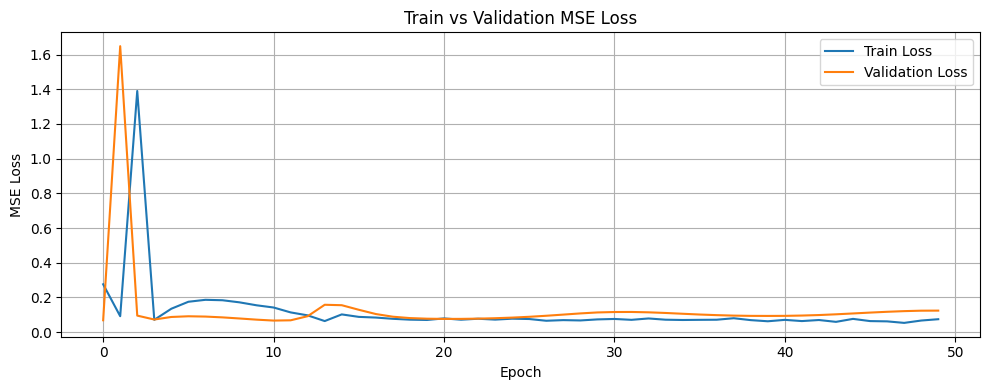

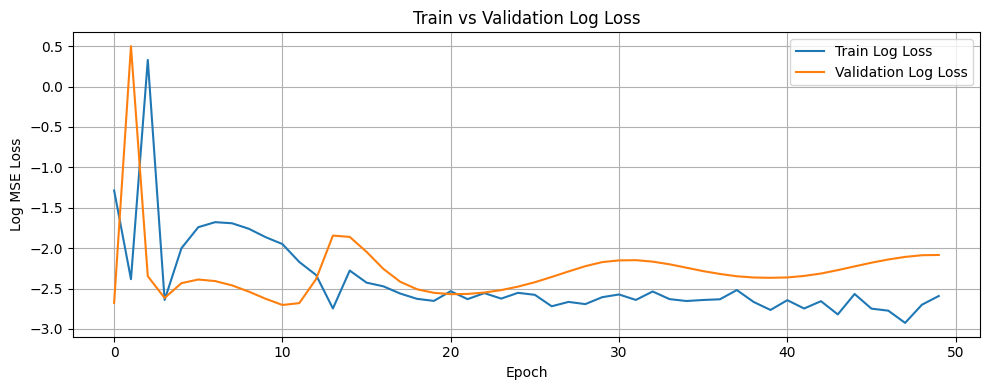

Training completed

=== Processing group: ('01 TO 03', 'WOODLANDS', '3 ROOM') ===
Group size: 7 rows
Calling prepare_lstm_data for ('01 TO 03', 'WOODLANDS', '3 ROOM')

Filtering for: WOODLANDS, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 346
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 33
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2892, Val Loss: 0.1051, Train R²: -3.9104, Val R²: -0.7398
Best model saved!
Epoch 2/50, Train Loss: 0.0988, Val Loss: 0.8663, Train R²: -0.6785, Val R²: -13.3341
Epoch 3/50, Train Loss: 0.7801, Val Loss: 0.0598, Train R²: -12.2470, Val R²: 0.0108
Best model saved!
Epoch 4/50, Train Loss: 0.0525, Val Loss: 0.1740, Train R²: 0.1090,

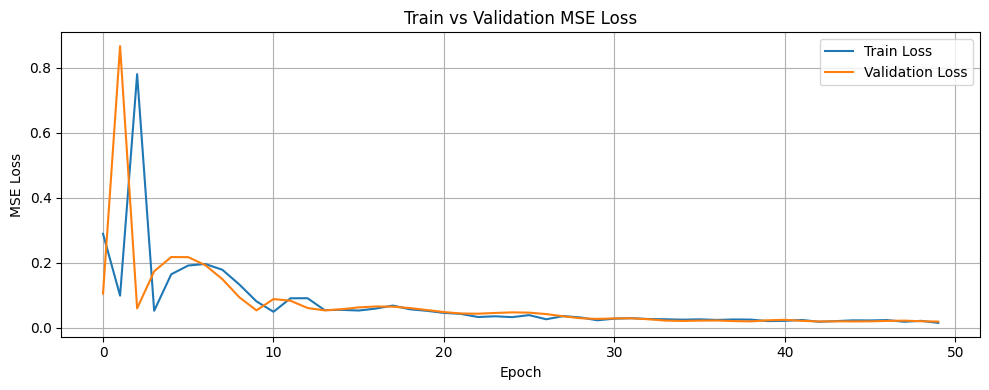

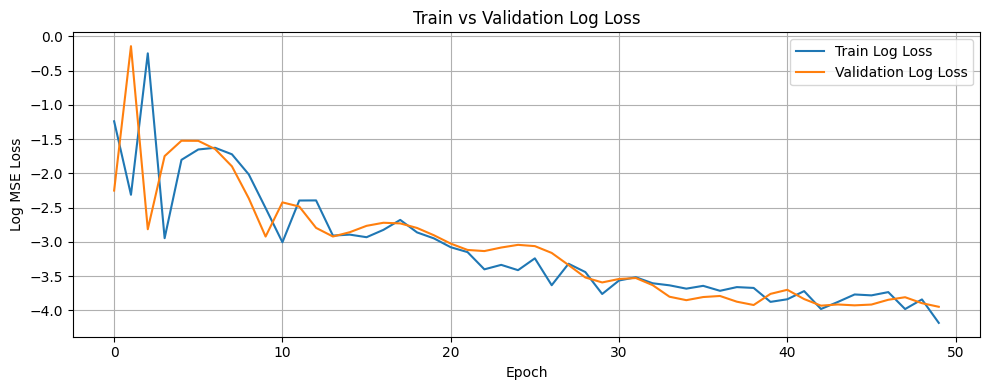

Training completed

=== Processing group: ('01 TO 03', 'WOODLANDS', '4 ROOM') ===
Group size: 33 rows
Calling prepare_lstm_data for ('01 TO 03', 'WOODLANDS', '4 ROOM')

Filtering for: WOODLANDS, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 1345
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 33
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3441, Val Loss: 0.2063, Train R²: -5.9183, Val R²: -11.5041
Best model saved!
Epoch 2/50, Train Loss: 0.1836, Val Loss: 0.0198, Train R²: -2.6920, Val R²: -0.1996
Best model saved!
Epoch 3/50, Train Loss: 0.0585, Val Loss: 0.0354, Train R²: -0.1767, Val R²: -1.1431
Epoch 4/50, Train Loss: 0.0527, Val Loss: 0.0282, Train R²: -0.05

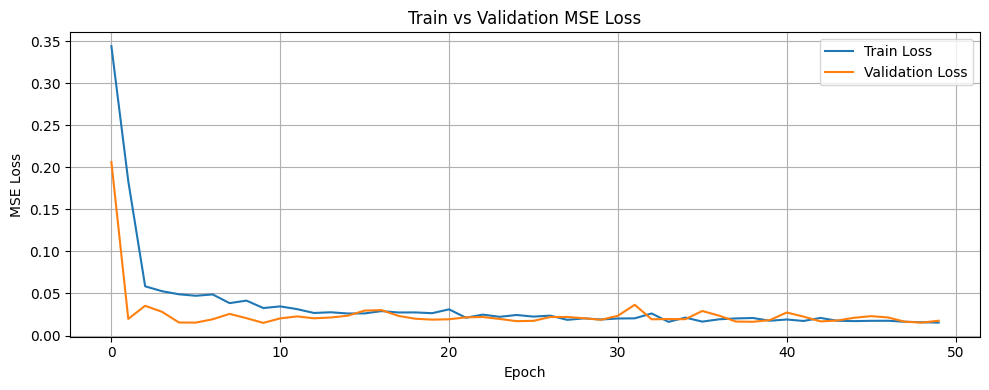

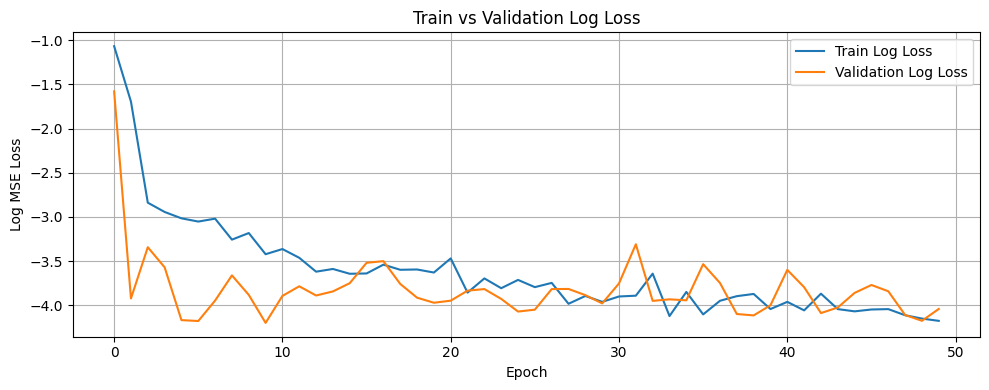

Training completed

=== Processing group: ('01 TO 03', 'WOODLANDS', '5 ROOM') ===
Group size: 24 rows
Calling prepare_lstm_data for ('01 TO 03', 'WOODLANDS', '5 ROOM')

Filtering for: WOODLANDS, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 863
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 29
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.4200, Val Loss: 0.1920, Train R²: -12.1075, Val R²: -58.1948
Best model saved!
Epoch 2/50, Train Loss: 0.2287, Val Loss: 0.0315, Train R²: -6.1366, Val R²: -8.7257
Best model saved!
Epoch 3/50, Train Loss: 0.0607, Val Loss: 0.0410, Train R²: -0.8944, Val R²: -11.6544
Epoch 4/50, Train Loss: 0.0741, Val Loss: 0.0205, Train R²: -1.3

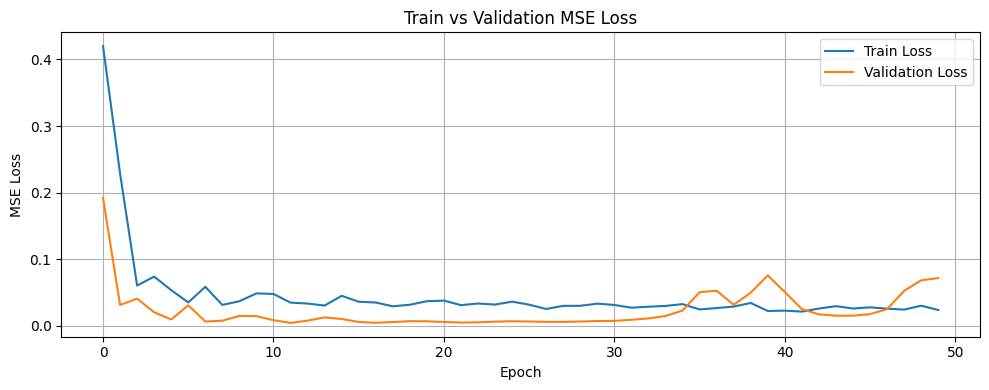

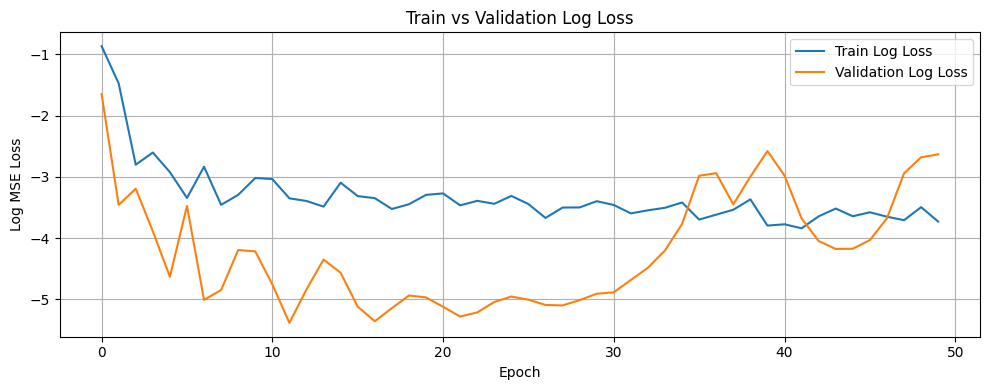

Training completed

=== Processing group: ('01 TO 03', 'WOODLANDS', 'EXECUTIVE') ===
Group size: 8 rows
Calling prepare_lstm_data for ('01 TO 03', 'WOODLANDS', 'EXECUTIVE')

Filtering for: WOODLANDS, EXECUTIVE, 01 TO 03, around 2025-01-01
Initial strict match count: 379
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 33
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3035, Val Loss: 0.0436, Train R²: -3.9712, Val R²: -1.1147
Best model saved!
Epoch 2/50, Train Loss: 0.1170, Val Loss: 0.4092, Train R²: -0.9168, Val R²: -18.8327
Epoch 3/50, Train Loss: 0.3484, Val Loss: 0.0237, Train R²: -4.7066, Val R²: -0.1466
Best model saved!
Epoch 4/50, Train Loss: 0.0836, Val Loss: 0.0598, Train R²

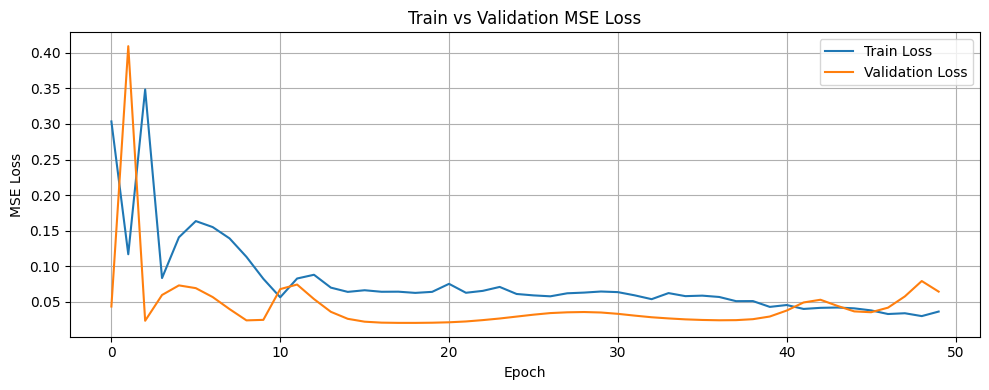

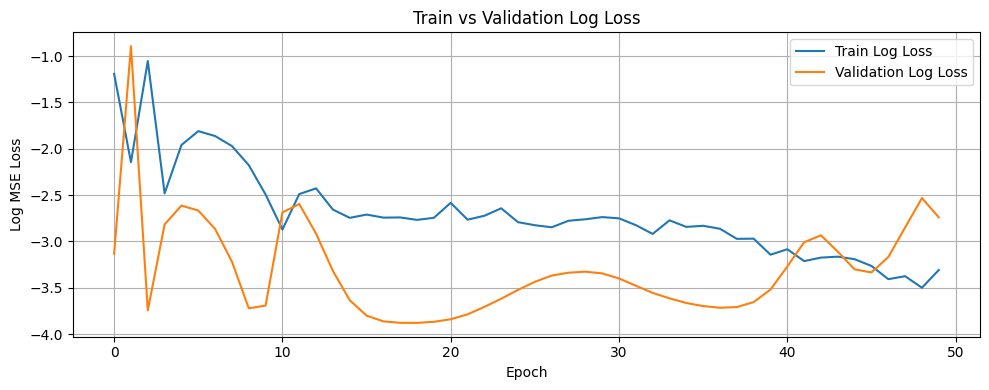

Training completed

=== Processing group: ('01 TO 03', 'YISHUN', '2 ROOM') ===
Group size: 2 rows
Calling prepare_lstm_data for ('01 TO 03', 'YISHUN', '2 ROOM')

Filtering for: YISHUN, 2 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 53
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 30
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.4151, Val Loss: 0.2979, Train R²: -3.7595, Val R²: -6.4594
Best model saved!
Epoch 2/50, Train Loss: 0.2150, Val Loss: 0.1859, Train R²: -1.4645, Val R²: -3.6553
Best model saved!
Epoch 3/50, Train Loss: 0.3969, Val Loss: 0.1393, Train R²: -3.5506, Val R²: -2.4889
Best model saved!
Epoch 4/50, Train Loss: 0.1131, Val Loss: 0.2621, Train R²: 

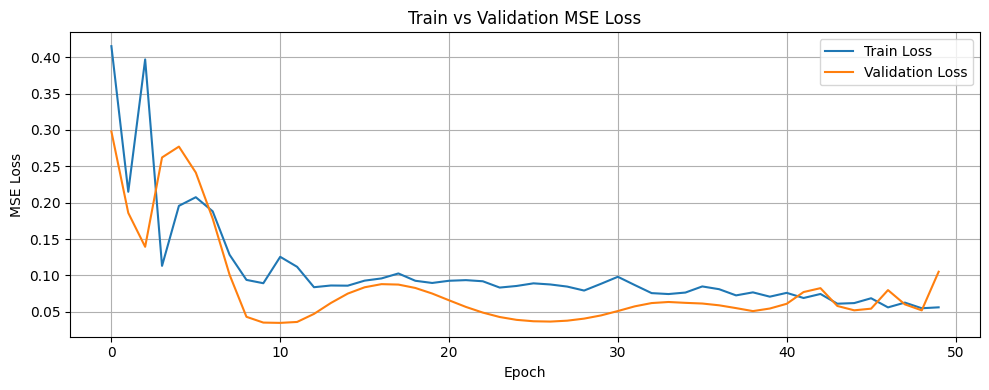

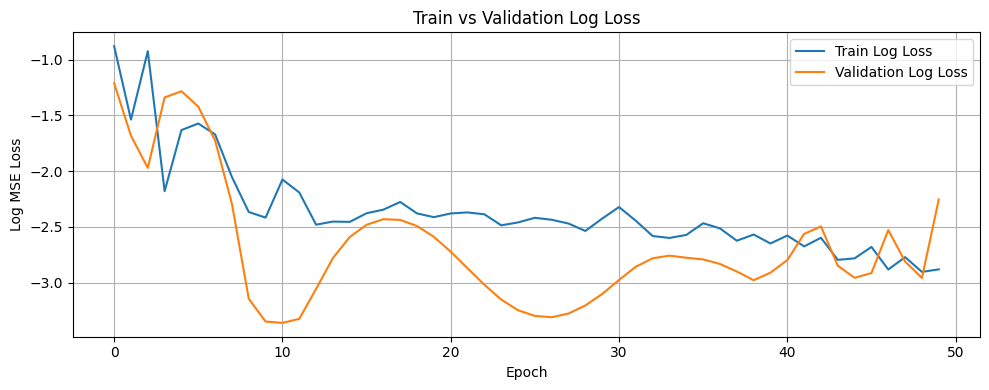

Training completed

=== Processing group: ('01 TO 03', 'YISHUN', '3 ROOM') ===
Group size: 32 rows
Calling prepare_lstm_data for ('01 TO 03', 'YISHUN', '3 ROOM')

Filtering for: YISHUN, 3 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 871
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 27
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1164, Val Loss: 0.0323, Train R²: -2.1498, Val R²: -0.0914
Best model saved!
Epoch 2/50, Train Loss: 0.0398, Val Loss: 0.0279, Train R²: -0.0786, Val R²: 0.0572
Best model saved!
Epoch 3/50, Train Loss: 0.0372, Val Loss: 0.0272, Train R²: -0.0078, Val R²: 0.0817
Best model saved!
Epoch 4/50, Train Loss: 0.0343, Val Loss: 0.0304, Train R²: 

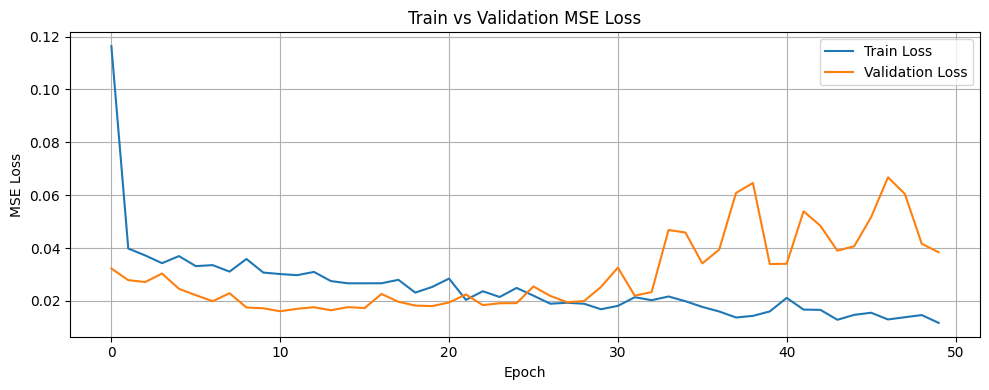

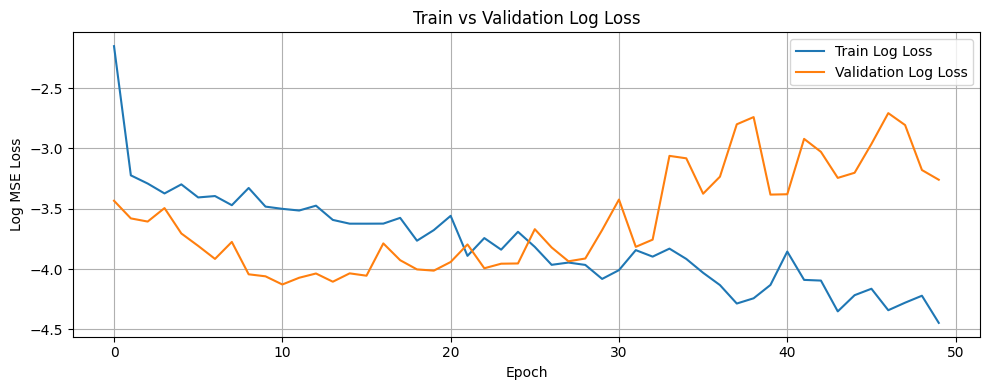

Training completed

=== Processing group: ('01 TO 03', 'YISHUN', '4 ROOM') ===
Group size: 39 rows
Calling prepare_lstm_data for ('01 TO 03', 'YISHUN', '4 ROOM')

Filtering for: YISHUN, 4 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 1344
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1509, Val Loss: 0.0320, Train R²: -2.7207, Val R²: -0.2246
Best model saved!
Epoch 2/50, Train Loss: 0.0465, Val Loss: 0.5414, Train R²: -0.1463, Val R²: -19.7299
Epoch 3/50, Train Loss: 0.6168, Val Loss: 0.0295, Train R²: -14.2121, Val R²: -0.1297
Best model saved!
Epoch 4/50, Train Loss: 0.0451, Val Loss: 0.0844, Train R²: -0.1132, Val 

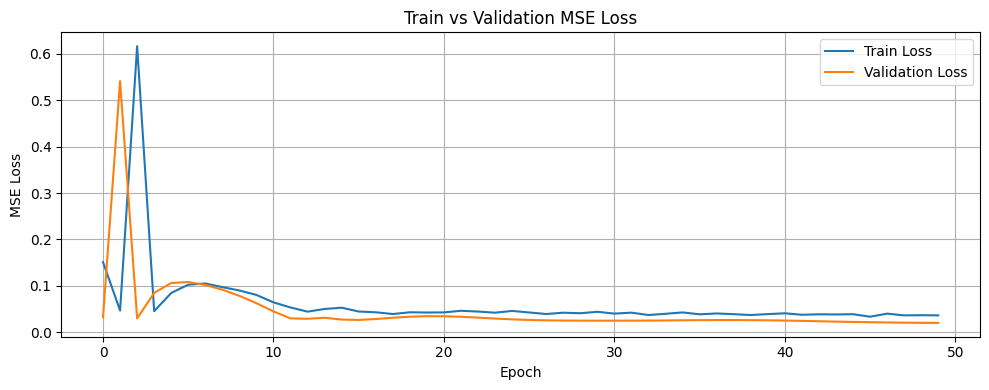

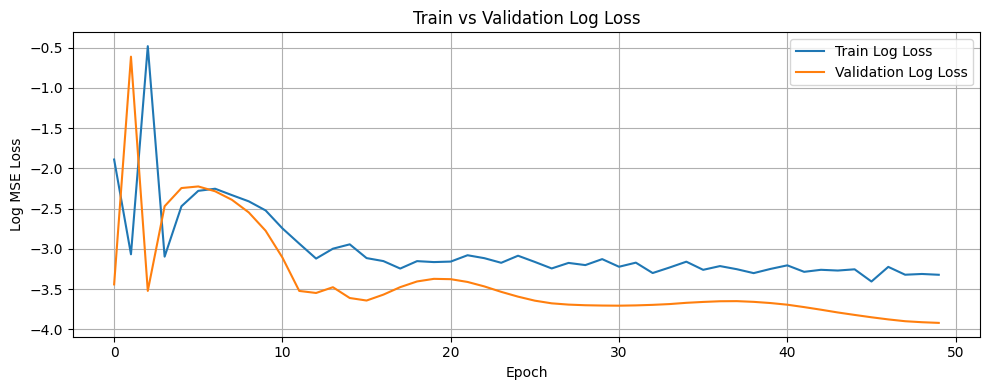

Training completed

=== Processing group: ('01 TO 03', 'YISHUN', '5 ROOM') ===
Group size: 16 rows
Calling prepare_lstm_data for ('01 TO 03', 'YISHUN', '5 ROOM')

Filtering for: YISHUN, 5 ROOM, 01 TO 03, around 2025-01-01
Initial strict match count: 445
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 30
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1131, Val Loss: 0.0436, Train R²: -2.4806, Val R²: -0.0507
Best model saved!
Epoch 2/50, Train Loss: 0.0294, Val Loss: 0.0630, Train R²: 0.0936, Val R²: -0.5168
Epoch 3/50, Train Loss: 0.0802, Val Loss: 0.0668, Train R²: -1.4685, Val R²: -0.6082
Epoch 4/50, Train Loss: 0.0447, Val Loss: 0.0826, Train R²: -0.3754, Val R²: -0.9887
Epoch 5/50

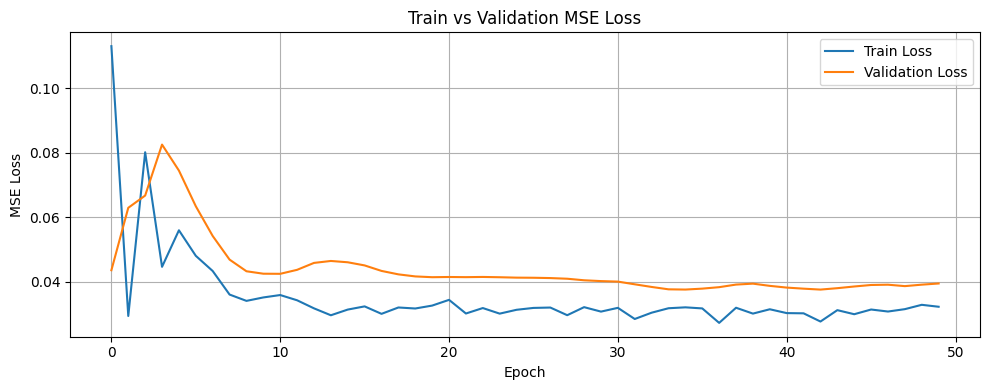

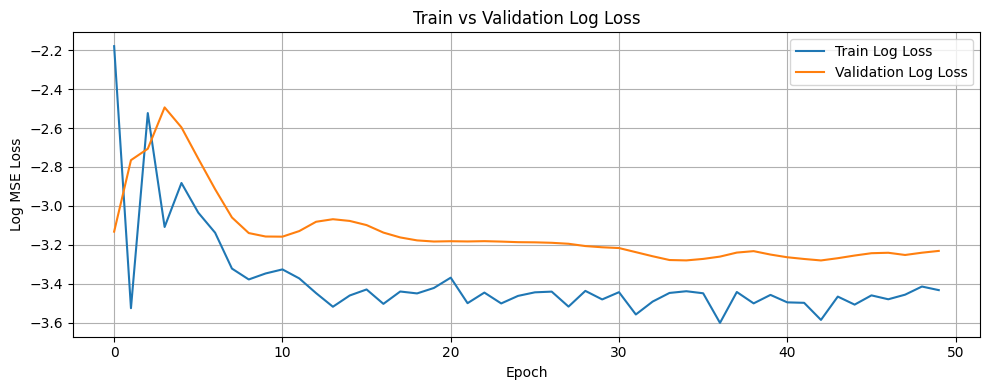

Training completed

=== Processing group: ('01 TO 03', 'YISHUN', 'EXECUTIVE') ===
Group size: 8 rows
Calling prepare_lstm_data for ('01 TO 03', 'YISHUN', 'EXECUTIVE')

Filtering for: YISHUN, EXECUTIVE, 01 TO 03, around 2025-01-01
Initial strict match count: 196
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 36
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1773, Val Loss: 0.1033, Train R²: -2.9874, Val R²: -0.8003
Best model saved!
Epoch 2/50, Train Loss: 0.0636, Val Loss: 0.3605, Train R²: -0.4299, Val R²: -5.2862
Epoch 3/50, Train Loss: 0.4622, Val Loss: 0.0781, Train R²: -9.3944, Val R²: -0.3609
Best model saved!
Epoch 4/50, Train Loss: 0.0491, Val Loss: 0.1548, Train R²: -0.1041,

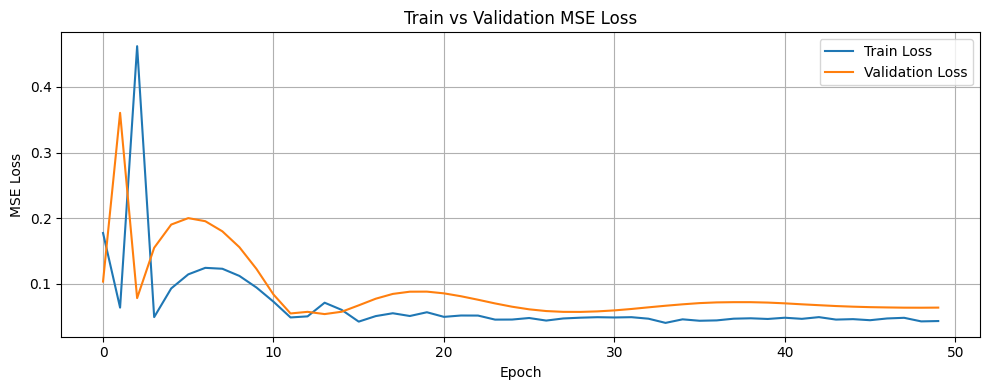

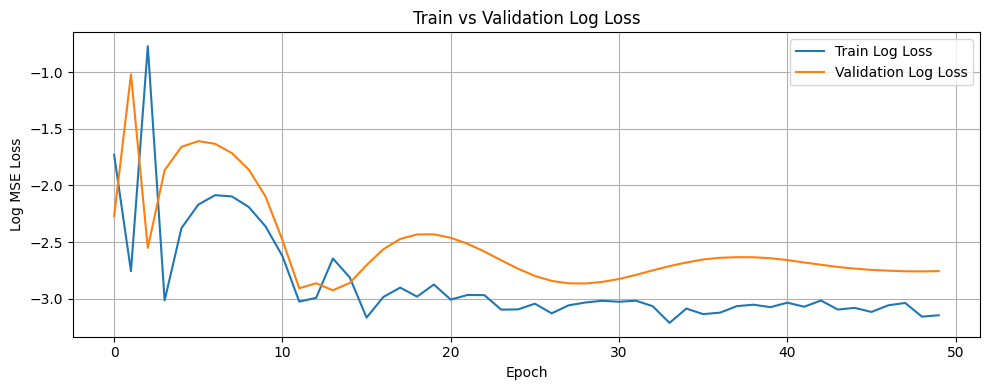

Training completed

=== Processing group: ('04 TO 06', 'ANG MO KIO', '2 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('04 TO 06', 'ANG MO KIO', '2 ROOM')

Filtering for: ANG MO KIO, 2 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 49
Using before_or_at_target with 48 records.
Removing 'block' column from dataset
Data shapes - x_train: (47, 9), y_train: (47,)
Flattened y shape: (47,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 37, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 37, Val: 10
Using batch sizes - Train: 37, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2665, Val Loss: 0.0875, Train R²: -2.0010, Val R²: -0.4340
Best model saved!
Epoch 2/50, Train Loss: 0.1087, Val Loss: 0.7052, Train R²: -0.2237, Val R²: -10.5582
Epoch 3/50, Train Loss: 0.8456, Val Loss: 0.0632, Train R²: -8.5210, Val R²: -0.0357
Best model saved!
Epoch 4/50, Train Loss: 0.0958, Val Loss: 0.1370, Train R²: -0.07

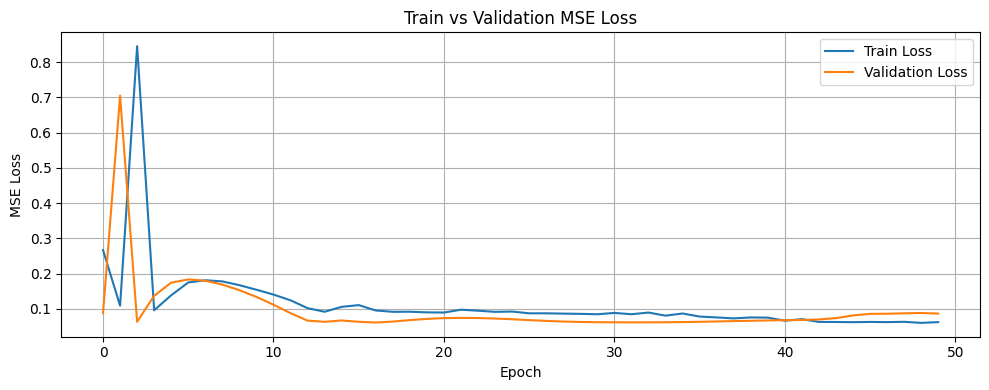

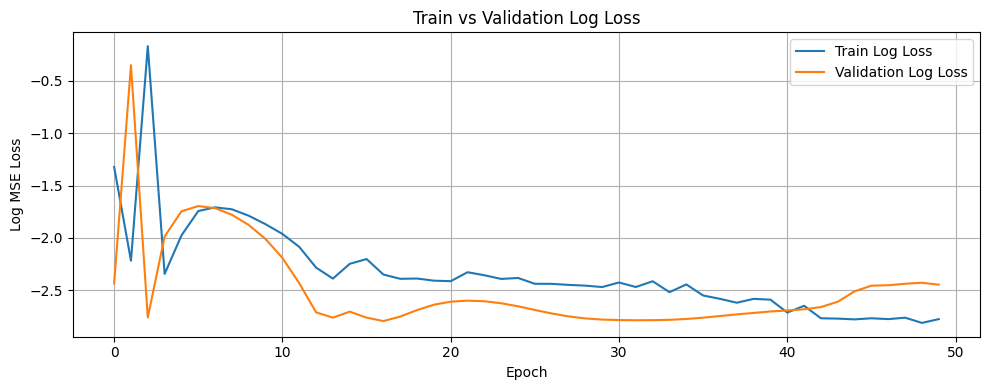

Training completed

=== Processing group: ('04 TO 06', 'ANG MO KIO', '3 ROOM') ===
Group size: 31 rows
Calling prepare_lstm_data for ('04 TO 06', 'ANG MO KIO', '3 ROOM')

Filtering for: ANG MO KIO, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 1224
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.0941, Val Loss: 0.0271, Train R²: -0.9266, Val R²: -0.0581
Best model saved!
Epoch 2/50, Train Loss: 0.0664, Val Loss: 0.0470, Train R²: -0.3601, Val R²: -0.8359
Epoch 3/50, Train Loss: 0.0520, Val Loss: 0.0550, Train R²: -0.0642, Val R²: -1.1480
Epoch 4/50, Train Loss: 0.0567, Val Loss: 0.0482, Train R²: -0.1616, Val R²: -0.8

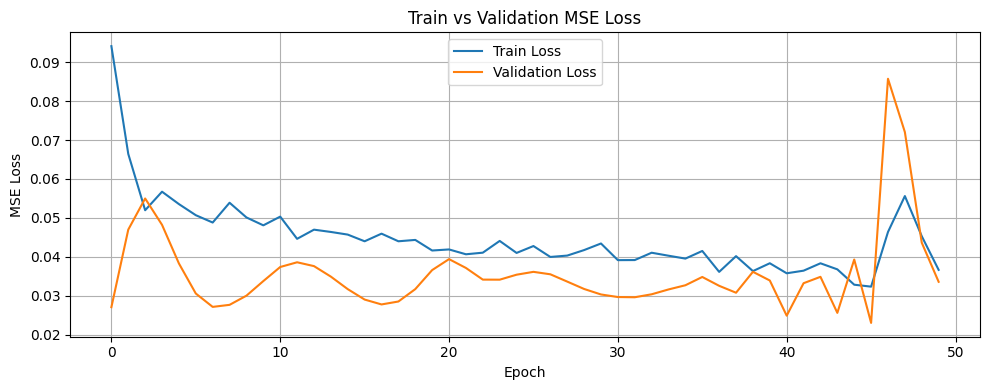

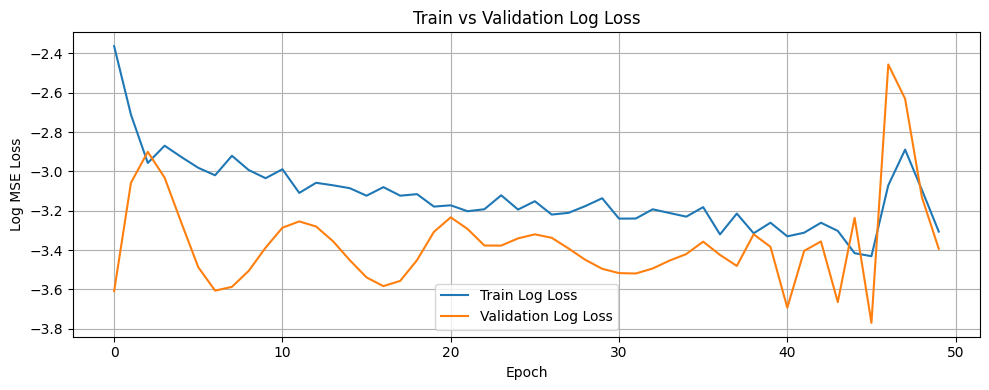

Training completed

=== Processing group: ('04 TO 06', 'ANG MO KIO', '4 ROOM') ===
Group size: 15 rows
Calling prepare_lstm_data for ('04 TO 06', 'ANG MO KIO', '4 ROOM')

Filtering for: ANG MO KIO, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 511
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 42
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2171, Val Loss: 0.0303, Train R²: -1.2609, Val R²: -1.7651
Best model saved!
Epoch 2/50, Train Loss: 0.0981, Val Loss: 1.0794, Train R²: -0.0215, Val R²: -97.5073
Epoch 3/50, Train Loss: 0.8370, Val Loss: 0.0684, Train R²: -7.7161, Val R²: -5.2450
Epoch 4/50, Train Loss: 0.0951, Val Loss: 0.0116, Train R²: 0.0098, Val R²: -0.05

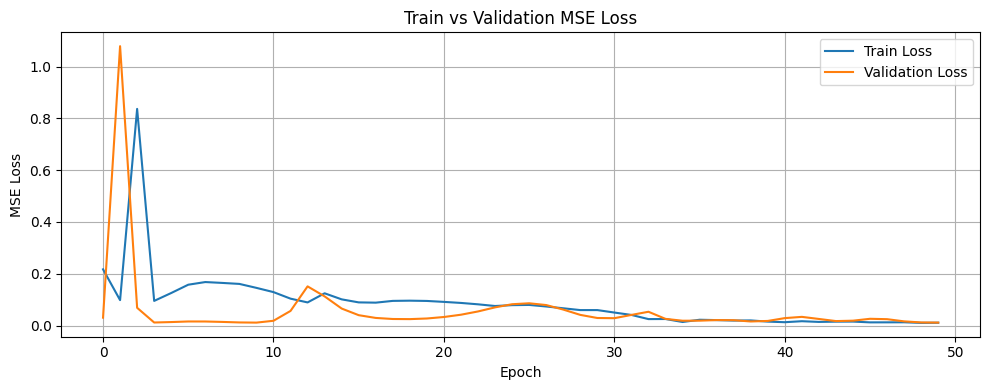

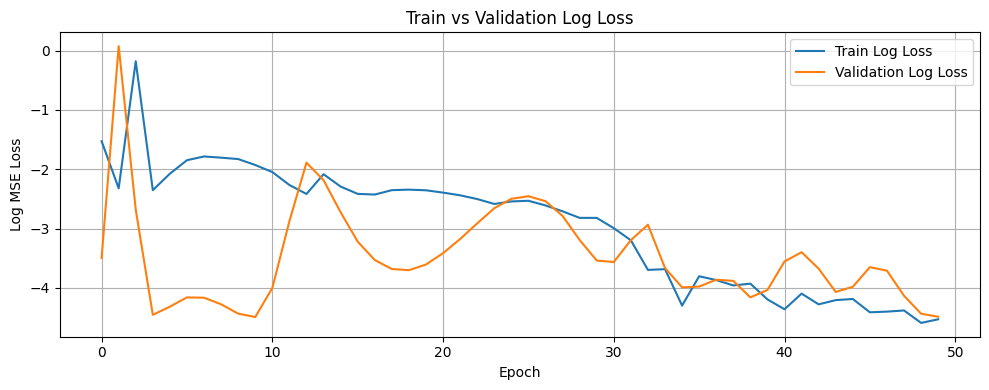

Training completed

=== Processing group: ('04 TO 06', 'ANG MO KIO', '5 ROOM') ===
Group size: 3 rows
Calling prepare_lstm_data for ('04 TO 06', 'ANG MO KIO', '5 ROOM')

Filtering for: ANG MO KIO, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 182
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 44
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1427, Val Loss: 0.0320, Train R²: -1.1938, Val R²: -0.0265
Best model saved!
Epoch 2/50, Train Loss: 0.0636, Val Loss: 0.0359, Train R²: 0.0226, Val R²: -0.1530
Epoch 3/50, Train Loss: 0.0676, Val Loss: 0.0307, Train R²: -0.0395, Val R²: 0.0158
Best model saved!
Epoch 4/50, Train Loss: 0.0644, Val Loss: 0.0277, Train R²: 0.0109,

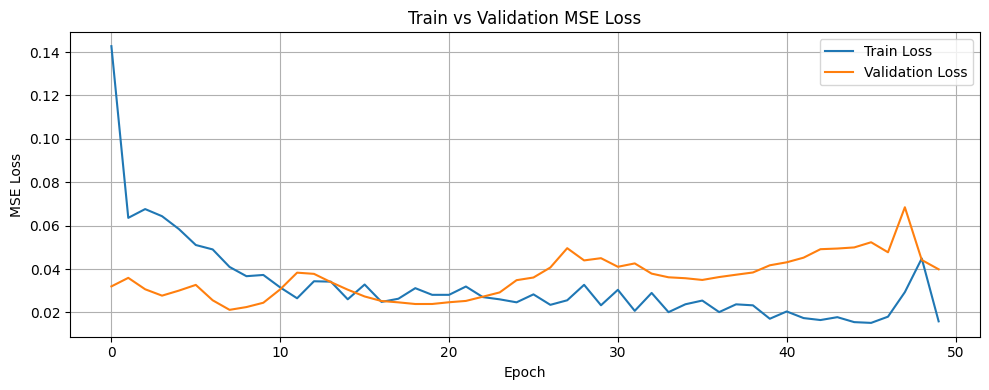

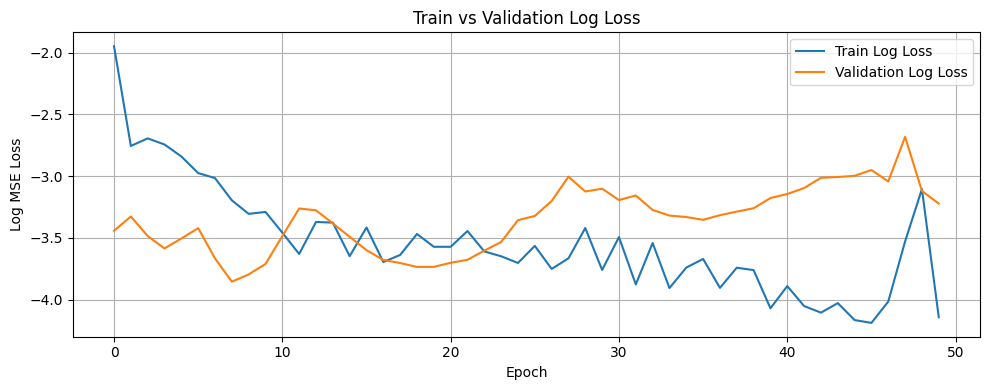

Training completed

=== Processing group: ('04 TO 06', 'BEDOK', '2 ROOM') ===
Group size: 2 rows
Calling prepare_lstm_data for ('04 TO 06', 'BEDOK', '2 ROOM')

Filtering for: BEDOK, 2 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 35
Using before_or_at_target with 33 records.
Removing 'block' column from dataset
Data shapes - x_train: (32, 9), y_train: (32,)
Flattened y shape: (32,), Unique values: 26
Using simple train-validation split (80/20).
Split sizes - Train: 25, Val: 7
Creating PyTorch datasets...
Dataset sizes - Train: 25, Val: 7
Using batch sizes - Train: 25, Val: 7
Starting model training...
Epoch 1/50, Train Loss: 0.1350, Val Loss: 0.1249, Train R²: -1.5537, Val R²: -0.0717
Best model saved!
Epoch 2/50, Train Loss: 0.0540, Val Loss: 0.4439, Train R²: -0.0207, Val R²: -2.8097
Epoch 3/50, Train Loss: 0.4743, Val Loss: 0.1339, Train R²: -7.9722, Val R²: -0.1493
Epoch 4/50, Train Loss: 0.0630, Val Loss: 0.2095, Train R²: -0.1924, Val R²: -0.7977
Epoch 5/50, Train

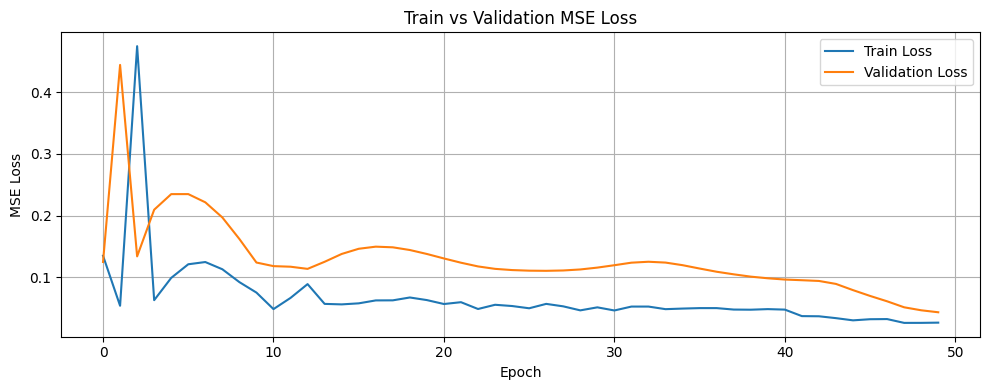

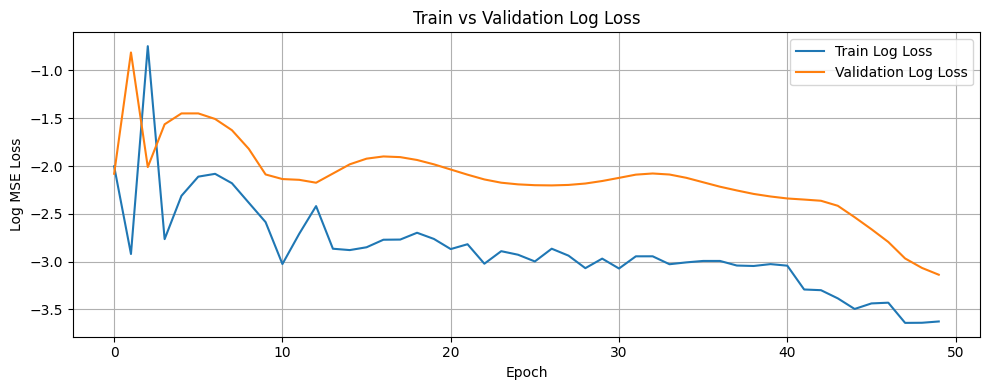

Training completed

=== Processing group: ('04 TO 06', 'BEDOK', '3 ROOM') ===
Group size: 28 rows
Calling prepare_lstm_data for ('04 TO 06', 'BEDOK', '3 ROOM')

Filtering for: BEDOK, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 1170
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 33
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1249, Val Loss: 0.0408, Train R²: -2.7684, Val R²: -0.4794
Best model saved!
Epoch 2/50, Train Loss: 0.0586, Val Loss: 0.3211, Train R²: -0.7689, Val R²: -10.6310
Epoch 3/50, Train Loss: 0.2668, Val Loss: 0.0259, Train R²: -7.0527, Val R²: 0.0618
Best model saved!
Epoch 4/50, Train Loss: 0.0375, Val Loss: 0.0570, Train R²: -0.1314, Val R²: -

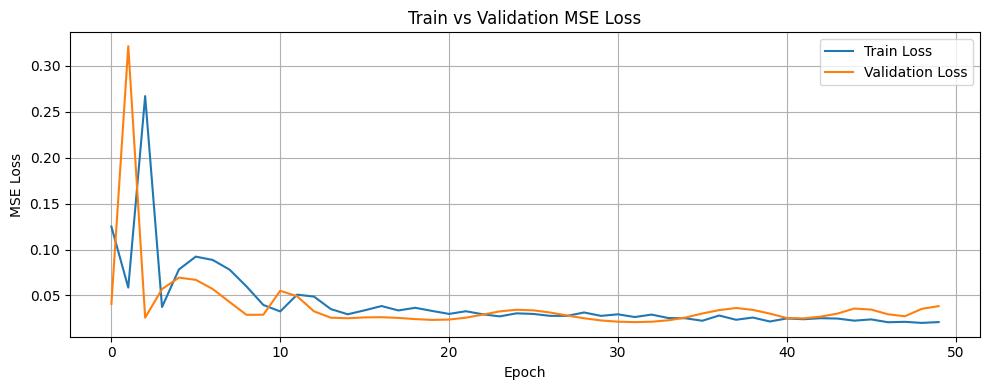

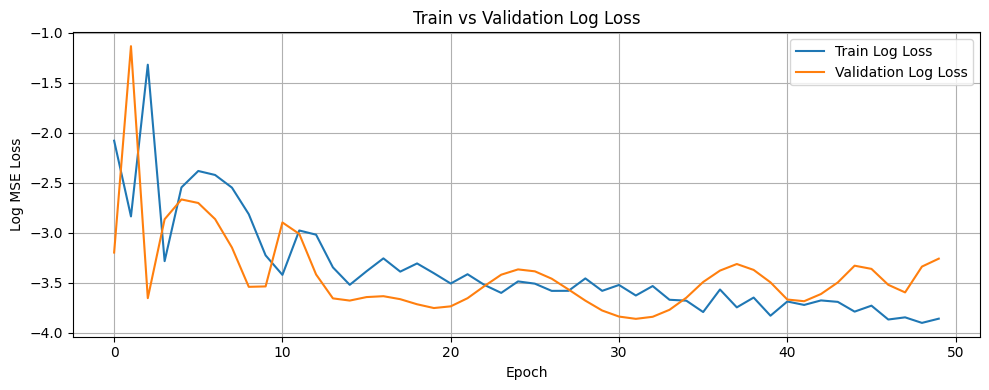

Training completed

=== Processing group: ('04 TO 06', 'BEDOK', '4 ROOM') ===
Group size: 18 rows
Calling prepare_lstm_data for ('04 TO 06', 'BEDOK', '4 ROOM')

Filtering for: BEDOK, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 882
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1439, Val Loss: 0.0627, Train R²: -1.0639, Val R²: -0.0406
Best model saved!
Epoch 2/50, Train Loss: 0.0690, Val Loss: 0.0714, Train R²: 0.0106, Val R²: -0.1848
Epoch 3/50, Train Loss: 0.0848, Val Loss: 0.0721, Train R²: -0.2165, Val R²: -0.1963
Epoch 4/50, Train Loss: 0.0694, Val Loss: 0.0791, Train R²: 0.0053, Val R²: -0.3111
Epoch 5/50, Tr

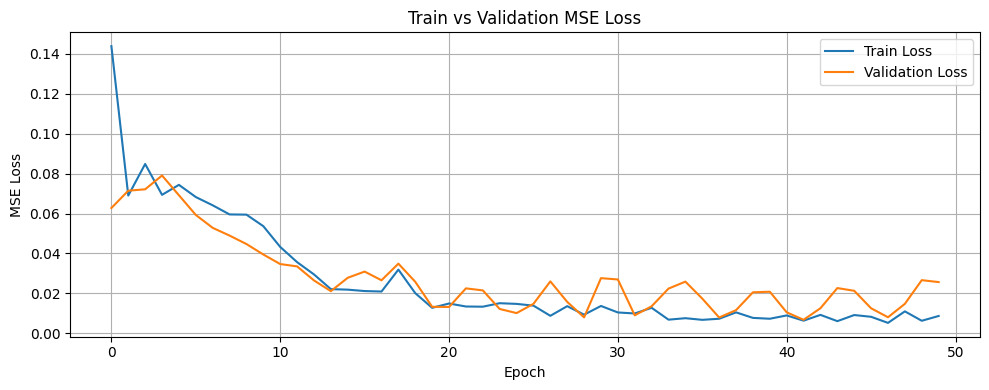

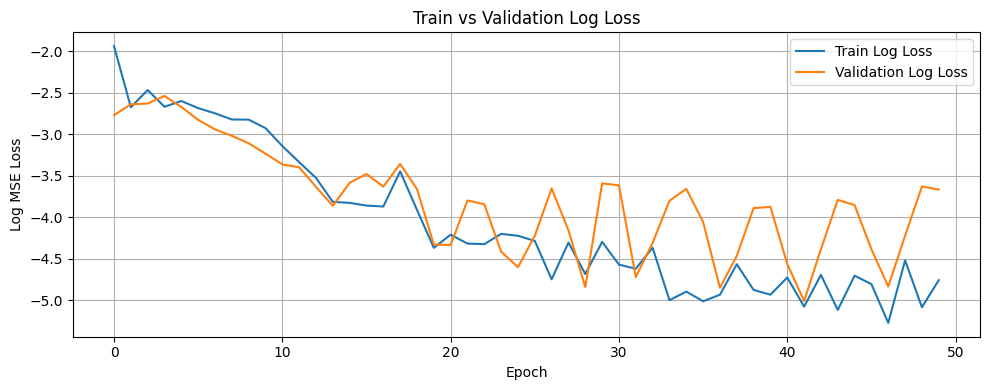

Training completed

=== Processing group: ('04 TO 06', 'BEDOK', '5 ROOM') ===
Group size: 8 rows
Calling prepare_lstm_data for ('04 TO 06', 'BEDOK', '5 ROOM')

Filtering for: BEDOK, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 433
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 42
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2487, Val Loss: 0.1336, Train R²: -2.0241, Val R²: -0.1244
Best model saved!
Epoch 2/50, Train Loss: 0.0912, Val Loss: 0.9081, Train R²: -0.1094, Val R²: -6.6404
Epoch 3/50, Train Loss: 0.8991, Val Loss: 0.1150, Train R²: -9.9337, Val R²: 0.0327
Best model saved!
Epoch 4/50, Train Loss: 0.0795, Val Loss: 0.1881, Train R²: 0.0336, Val R²: -0.58

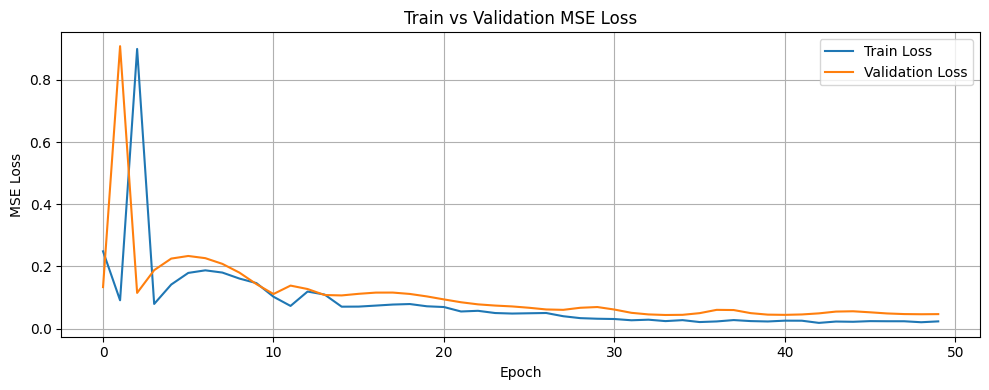

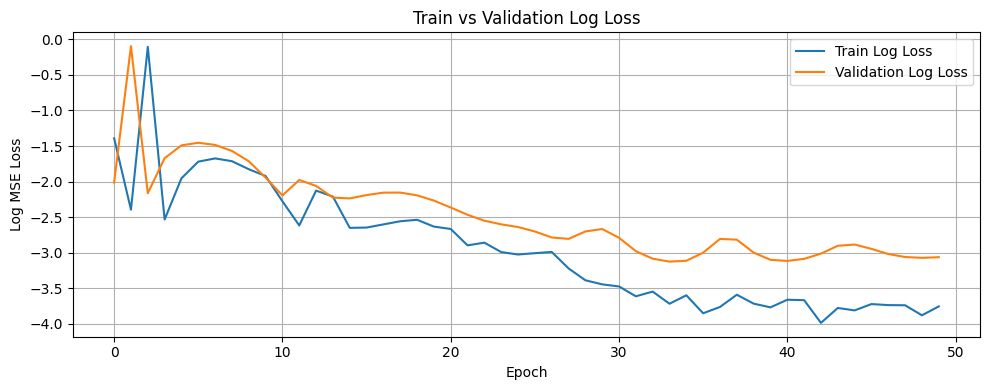

Training completed

=== Processing group: ('04 TO 06', 'BEDOK', 'EXECUTIVE') ===
Group size: 3 rows
Calling prepare_lstm_data for ('04 TO 06', 'BEDOK', 'EXECUTIVE')

Filtering for: BEDOK, EXECUTIVE, 04 TO 06, around 2025-01-01
Initial strict match count: 150
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 36
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2567, Val Loss: 0.0980, Train R²: -4.3551, Val R²: -3.0018
Best model saved!
Epoch 2/50, Train Loss: 0.1215, Val Loss: 0.1439, Train R²: -1.5348, Val R²: -4.8719
Epoch 3/50, Train Loss: 0.1752, Val Loss: 0.0408, Train R²: -2.6547, Val R²: -0.6672
Best model saved!
Epoch 4/50, Train Loss: 0.0665, Val Loss: 0.0858, Train R²: -0.3881, Va

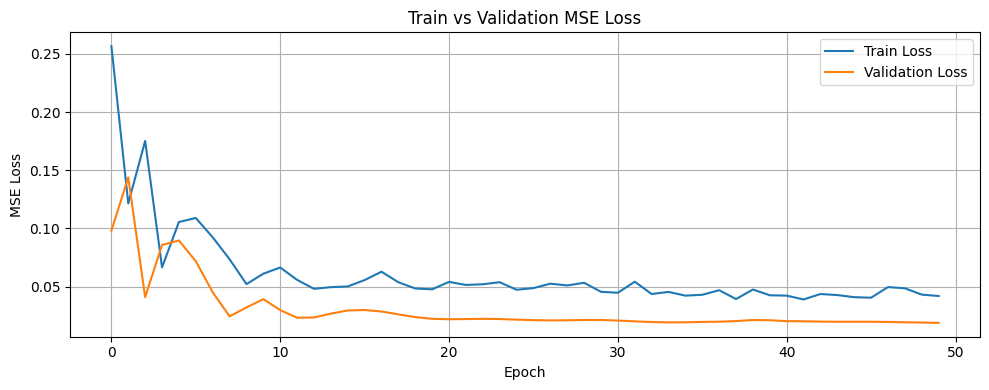

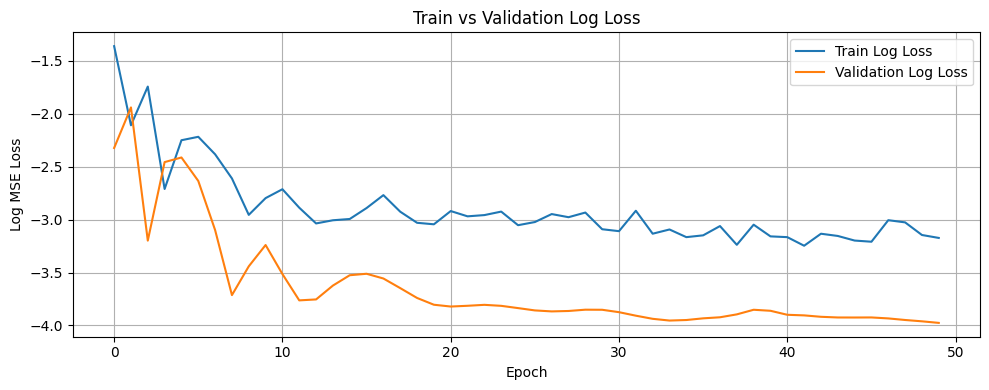

Training completed

=== Processing group: ('04 TO 06', 'BISHAN', '3 ROOM') ===
Group size: 5 rows
Calling prepare_lstm_data for ('04 TO 06', 'BISHAN', '3 ROOM')

Filtering for: BISHAN, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 105
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.4137, Val Loss: 0.2178, Train R²: -4.2227, Val R²: -4.5854
Best model saved!
Epoch 2/50, Train Loss: 0.1864, Val Loss: 0.4537, Train R²: -1.3533, Val R²: -10.6344
Epoch 3/50, Train Loss: 0.6303, Val Loss: 0.1001, Train R²: -6.9583, Val R²: -1.5670
Best model saved!
Epoch 4/50, Train Loss: 0.0960, Val Loss: 0.2567, Train R²: -0.2123, Val R²:

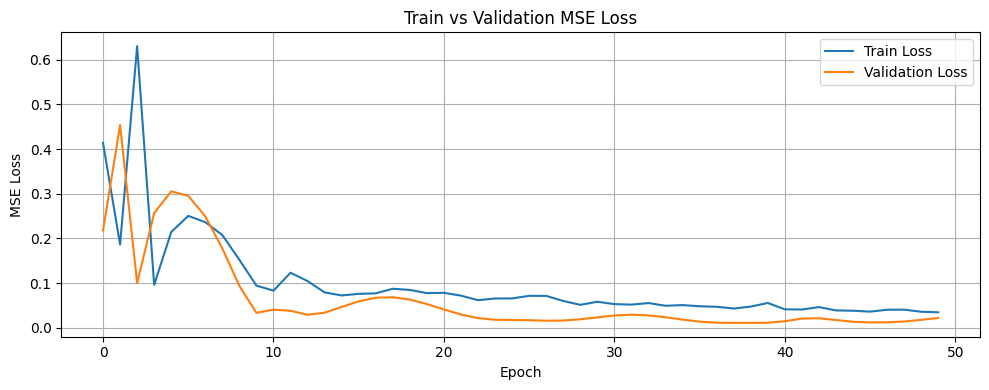

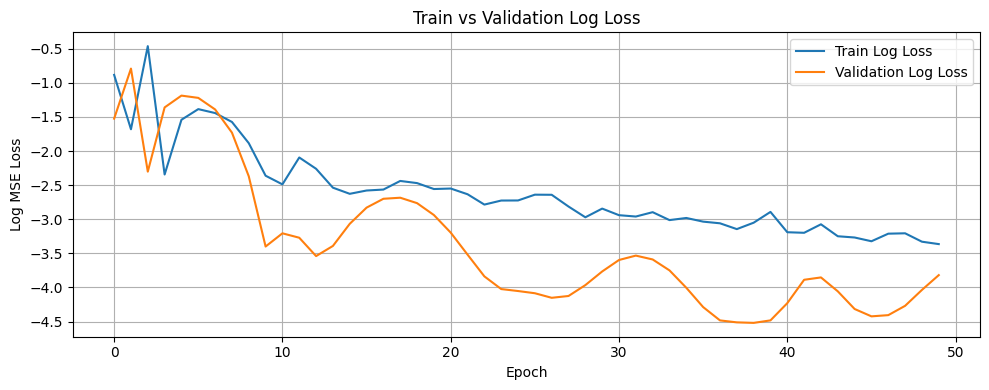

Training completed

=== Processing group: ('04 TO 06', 'BISHAN', '4 ROOM') ===
Group size: 6 rows
Calling prepare_lstm_data for ('04 TO 06', 'BISHAN', '4 ROOM')

Filtering for: BISHAN, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 457
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.4538, Val Loss: 0.2200, Train R²: -10.4715, Val R²: -10.2460
Best model saved!
Epoch 2/50, Train Loss: 0.2133, Val Loss: 0.1309, Train R²: -4.3933, Val R²: -5.6903
Best model saved!
Epoch 3/50, Train Loss: 0.1762, Val Loss: 0.0593, Train R²: -3.4554, Val R²: -2.0309
Best model saved!
Epoch 4/50, Train Loss: 0.0762, Val Loss: 0.1058, Train R

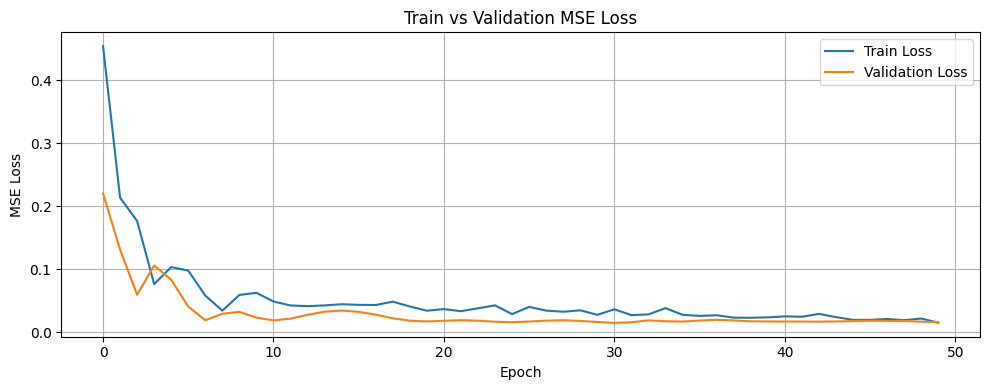

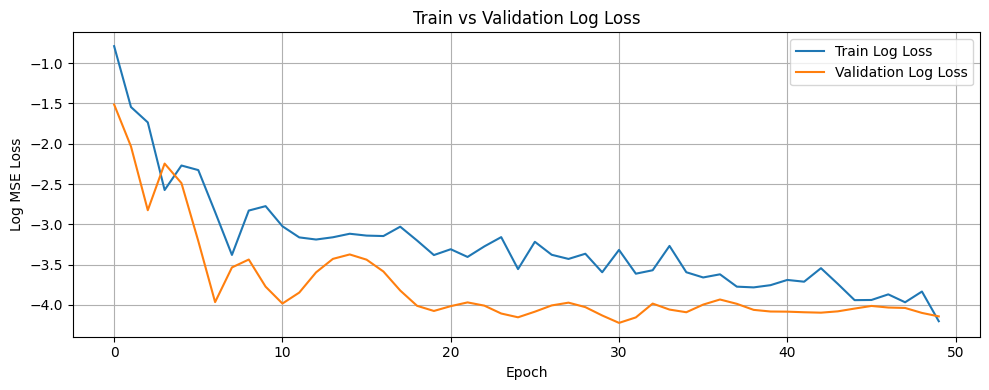

Training completed

=== Processing group: ('04 TO 06', 'BISHAN', '5 ROOM') ===
Group size: 3 rows
Calling prepare_lstm_data for ('04 TO 06', 'BISHAN', '5 ROOM')

Filtering for: BISHAN, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 214
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 43
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1216, Val Loss: 0.0066, Train R²: -1.6366, Val R²: -0.2009
Best model saved!
Epoch 2/50, Train Loss: 0.0462, Val Loss: 0.3118, Train R²: -0.0027, Val R²: -55.7400
Epoch 3/50, Train Loss: 0.3680, Val Loss: 0.0081, Train R²: -6.9808, Val R²: -0.4672
Epoch 4/50, Train Loss: 0.0476, Val Loss: 0.0383, Train R²: -0.0317, Val R²: -5.9771
Epoch 5/5

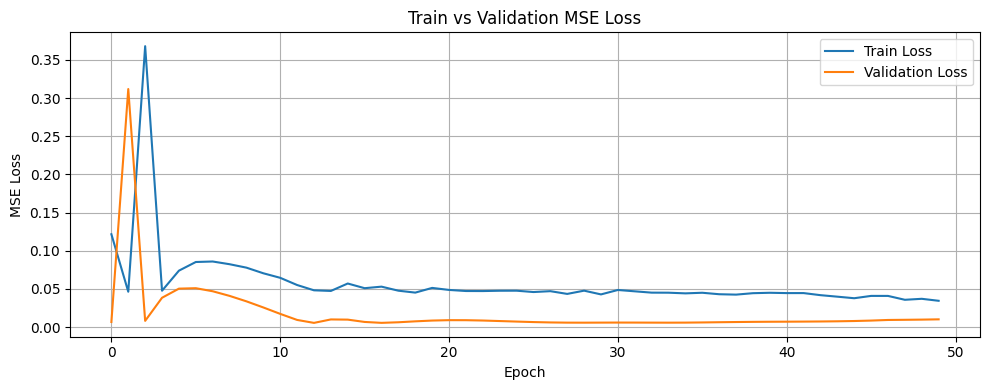

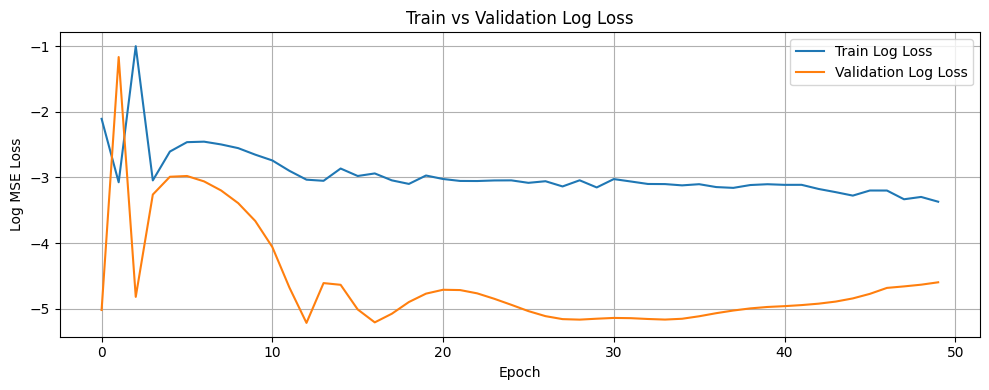

Training completed

=== Processing group: ('04 TO 06', 'BISHAN', 'EXECUTIVE') ===
Group size: 2 rows
Calling prepare_lstm_data for ('04 TO 06', 'BISHAN', 'EXECUTIVE')

Filtering for: BISHAN, EXECUTIVE, 04 TO 06, around 2025-01-01
Initial strict match count: 89
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 36
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1584, Val Loss: 0.0662, Train R²: -1.1152, Val R²: -0.0586
Best model saved!
Epoch 2/50, Train Loss: 0.0817, Val Loss: 0.0665, Train R²: -0.0918, Val R²: -0.0641
Epoch 3/50, Train Loss: 0.0791, Val Loss: 0.0890, Train R²: -0.0565, Val R²: -0.4225
Epoch 4/50, Train Loss: 0.0889, Val Loss: 0.0651, Train R²: -0.1873, Val R²: -0.0404
Be

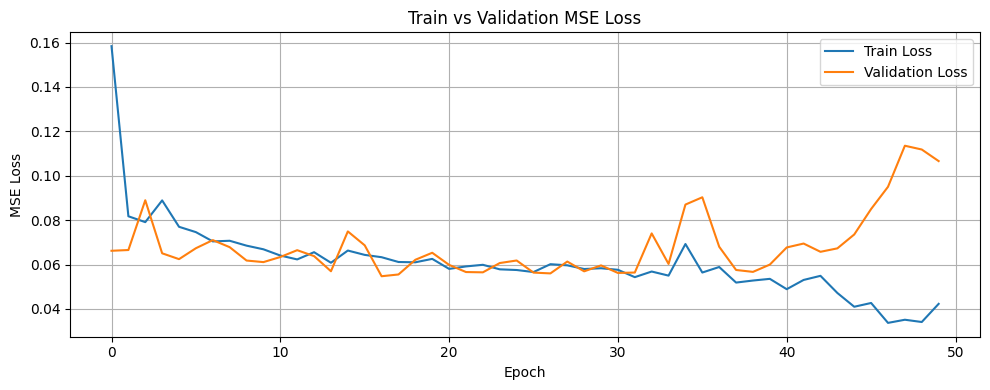

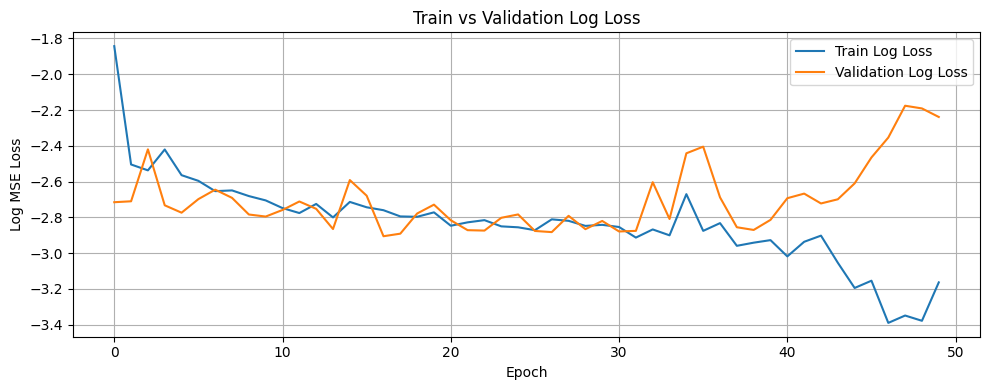

Training completed

=== Processing group: ('04 TO 06', 'BUKIT BATOK', '2 ROOM') ===
Group size: 2 rows
Calling prepare_lstm_data for ('04 TO 06', 'BUKIT BATOK', '2 ROOM')

Filtering for: BUKIT BATOK, 2 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 36
Using before_or_at_target with 35 records.
Removing 'block' column from dataset
Data shapes - x_train: (34, 9), y_train: (34,)
Flattened y shape: (34,), Unique values: 20
Using simple train-validation split (80/20).
Split sizes - Train: 27, Val: 7
Creating PyTorch datasets...
Dataset sizes - Train: 27, Val: 7
Using batch sizes - Train: 27, Val: 7
Starting model training...
Epoch 1/50, Train Loss: 0.4022, Val Loss: 0.1060, Train R²: -5.8922, Val R²: -1.1684
Best model saved!
Epoch 2/50, Train Loss: 0.1379, Val Loss: 0.4438, Train R²: -1.3635, Val R²: -8.0803
Epoch 3/50, Train Loss: 0.4081, Val Loss: 0.0491, Train R²: -5.9933, Val R²: -0.0051
Best model saved!
Epoch 4/50, Train Loss: 0.0694, Val Loss: 0.0938, Train R²: -0.188

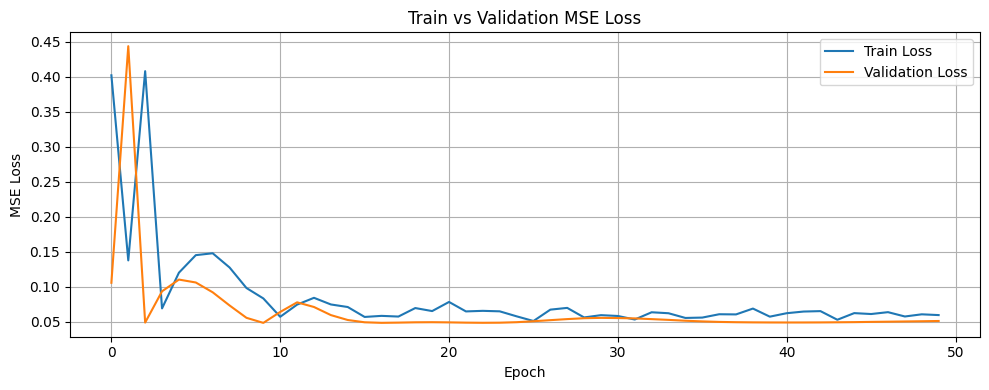

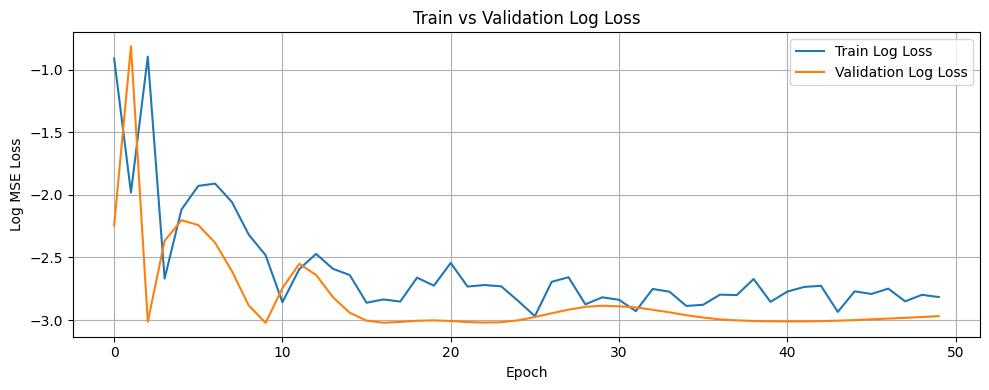

Training completed

=== Processing group: ('04 TO 06', 'BUKIT BATOK', '3 ROOM') ===
Group size: 25 rows
Calling prepare_lstm_data for ('04 TO 06', 'BUKIT BATOK', '3 ROOM')

Filtering for: BUKIT BATOK, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 733
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 29
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1558, Val Loss: 0.0106, Train R²: -2.4590, Val R²: -0.2938
Best model saved!
Epoch 2/50, Train Loss: 0.0479, Val Loss: 0.1958, Train R²: -0.0629, Val R²: -22.9203
Epoch 3/50, Train Loss: 0.1943, Val Loss: 0.0186, Train R²: -3.3139, Val R²: -1.2721
Epoch 4/50, Train Loss: 0.0619, Val Loss: 0.0401, Train R²: -0.3741, Val R²: -

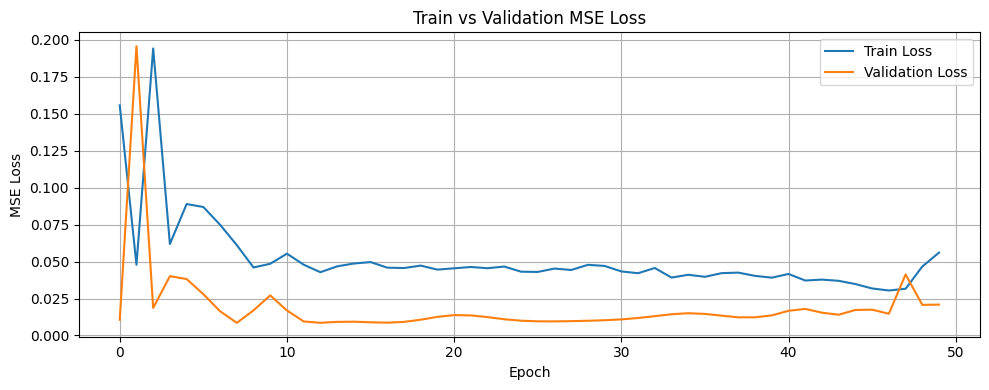

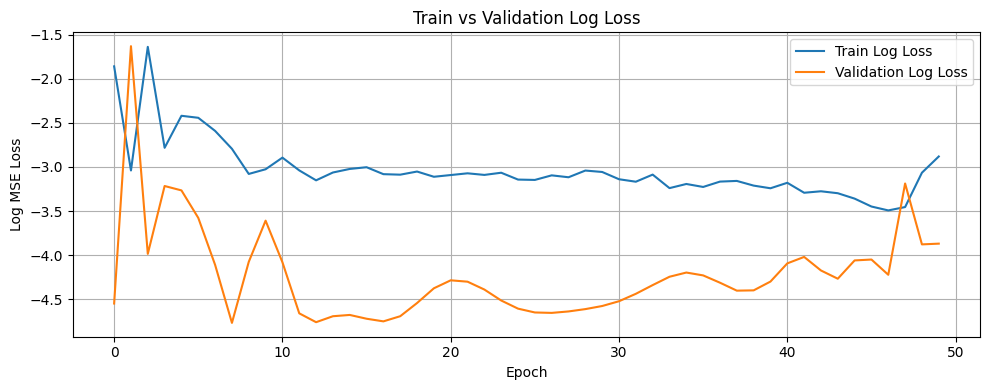

Training completed

=== Processing group: ('04 TO 06', 'BUKIT BATOK', '4 ROOM') ===
Group size: 33 rows
Calling prepare_lstm_data for ('04 TO 06', 'BUKIT BATOK', '4 ROOM')

Filtering for: BUKIT BATOK, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 850
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2064, Val Loss: 0.0599, Train R²: -1.5327, Val R²: -0.0160
Best model saved!
Epoch 2/50, Train Loss: 0.0820, Val Loss: 0.8803, Train R²: -0.0056, Val R²: -13.9347
Epoch 3/50, Train Loss: 0.9084, Val Loss: 0.0555, Train R²: -10.1463, Val R²: 0.0578
Best model saved!
Epoch 4/50, Train Loss: 0.0762, Val Loss: 0.0907, Train R²: 

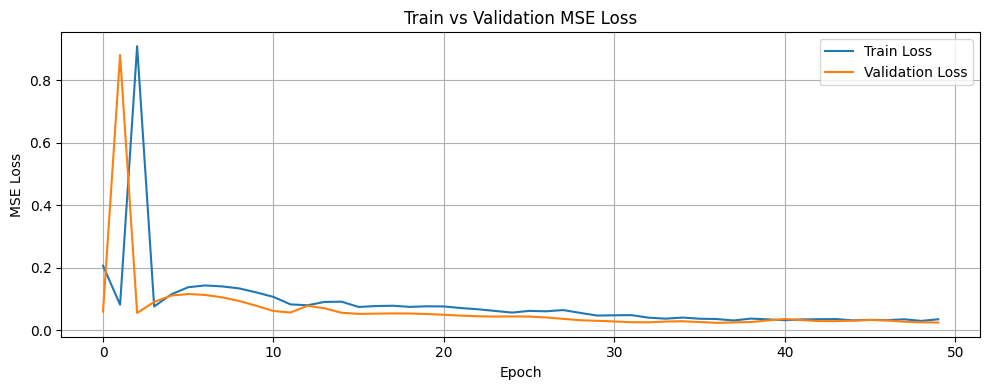

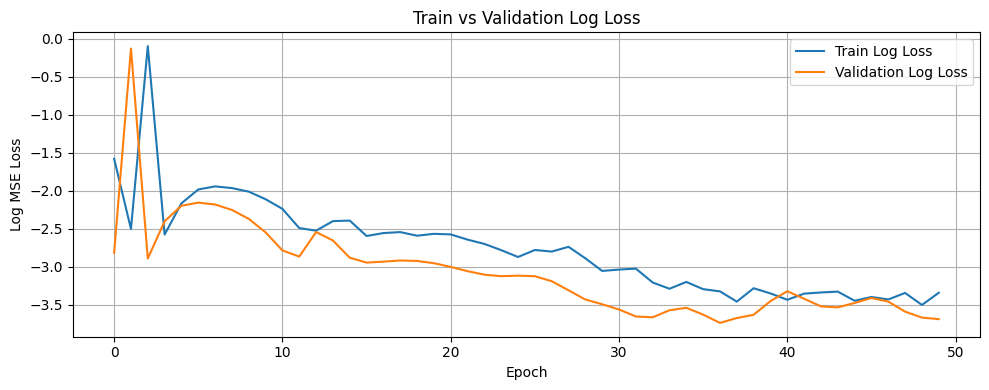

Training completed

=== Processing group: ('04 TO 06', 'BUKIT BATOK', '5 ROOM') ===
Group size: 13 rows
Calling prepare_lstm_data for ('04 TO 06', 'BUKIT BATOK', '5 ROOM')

Filtering for: BUKIT BATOK, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 226
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 38
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2967, Val Loss: 0.0442, Train R²: -4.4457, Val R²: -0.2131
Best model saved!
Epoch 2/50, Train Loss: 0.0603, Val Loss: 1.5961, Train R²: -0.1070, Val R²: -42.8202
Epoch 3/50, Train Loss: 1.6209, Val Loss: 0.0464, Train R²: -28.7488, Val R²: -0.2729
Epoch 4/50, Train Loss: 0.0561, Val Loss: 0.1000, Train R²: -0.0288, Val R²: 

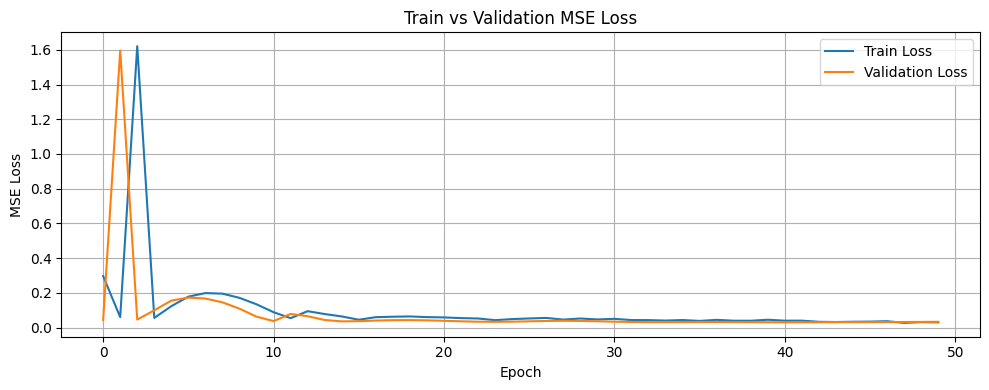

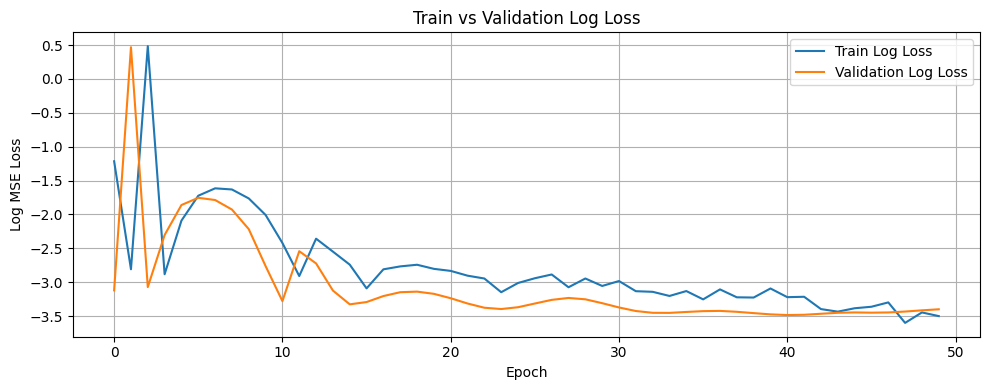

Training completed

=== Processing group: ('04 TO 06', 'BUKIT BATOK', 'EXECUTIVE') ===
Group size: 3 rows
Calling prepare_lstm_data for ('04 TO 06', 'BUKIT BATOK', 'EXECUTIVE')

Filtering for: BUKIT BATOK, EXECUTIVE, 04 TO 06, around 2025-01-01
Initial strict match count: 174
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1111, Val Loss: 0.0261, Train R²: -3.0934, Val R²: -0.2418
Best model saved!
Epoch 2/50, Train Loss: 0.0287, Val Loss: 0.2206, Train R²: -0.0565, Val R²: -9.5014
Epoch 3/50, Train Loss: 0.2740, Val Loss: 0.0256, Train R²: -9.0975, Val R²: -0.2176
Best model saved!
Epoch 4/50, Train Loss: 0.0301, Val Loss: 0.0571, Tra

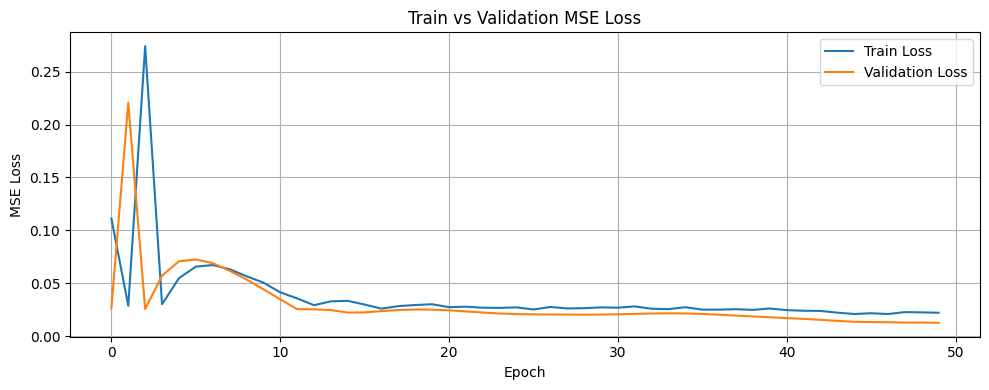

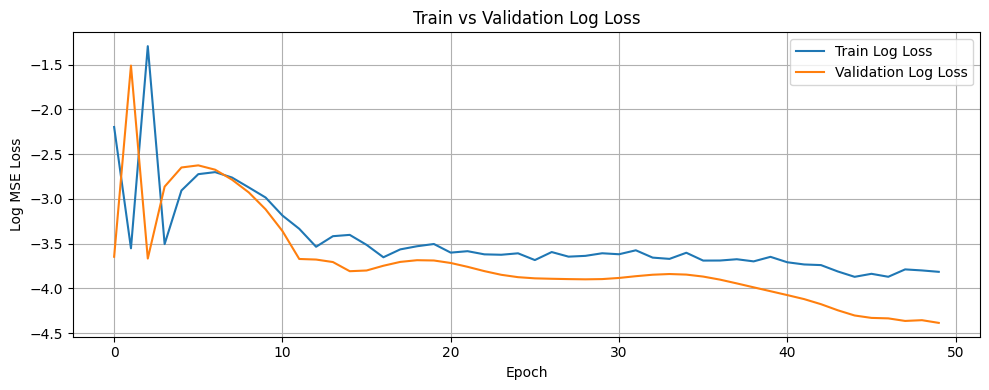

Training completed

=== Processing group: ('04 TO 06', 'BUKIT MERAH', '2 ROOM') ===
Group size: 2 rows
Calling prepare_lstm_data for ('04 TO 06', 'BUKIT MERAH', '2 ROOM')

Filtering for: BUKIT MERAH, 2 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 58
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.0847, Val Loss: 0.0529, Train R²: -0.7208, Val R²: -0.5853
Best model saved!
Epoch 2/50, Train Loss: 0.0740, Val Loss: 0.0401, Train R²: -0.5032, Val R²: -0.2007
Best model saved!
Epoch 3/50, Train Loss: 0.0537, Val Loss: 0.0466, Train R²: -0.0905, Val R²: -0.3974
Epoch 4/50, Train Loss: 0.0604, Val Loss: 0.0421, Train R²: -0.

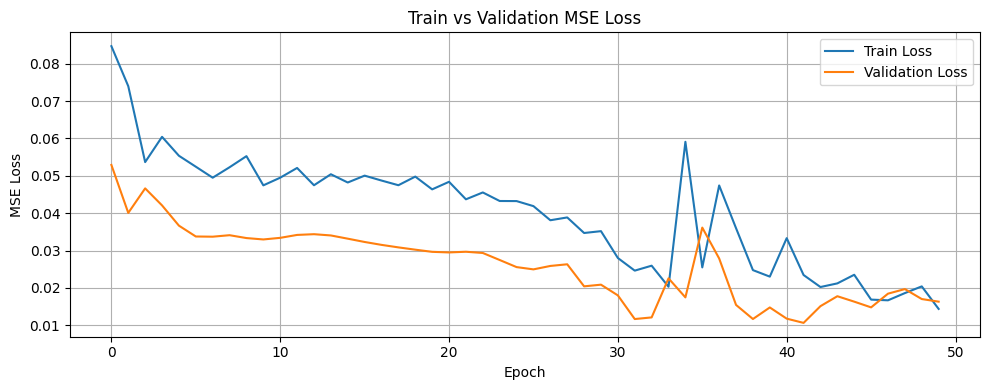

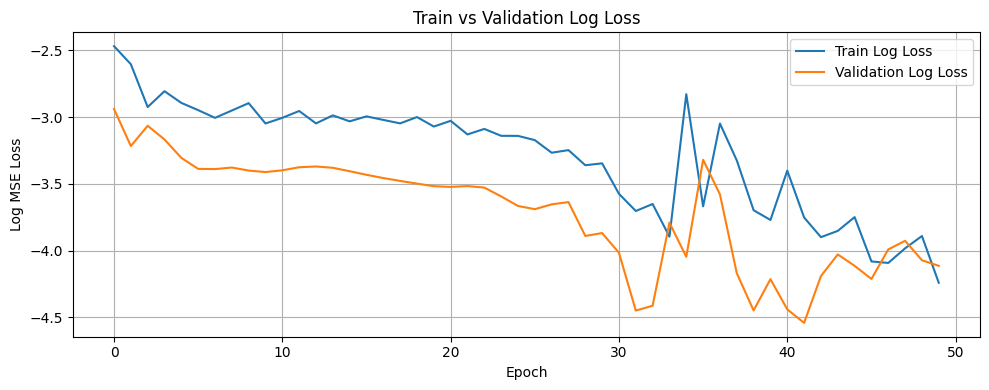

Training completed

=== Processing group: ('04 TO 06', 'BUKIT MERAH', '3 ROOM') ===
Group size: 19 rows
Calling prepare_lstm_data for ('04 TO 06', 'BUKIT MERAH', '3 ROOM')

Filtering for: BUKIT MERAH, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 633
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 43
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2082, Val Loss: 0.0500, Train R²: -1.3961, Val R²: 0.0649
Best model saved!
Epoch 2/50, Train Loss: 0.0814, Val Loss: 0.7494, Train R²: 0.0631, Val R²: -13.0298
Epoch 3/50, Train Loss: 0.7224, Val Loss: 0.0484, Train R²: -7.3145, Val R²: 0.0946
Best model saved!
Epoch 4/50, Train Loss: 0.0850, Val Loss: 0.0940, Train R²: 0.0

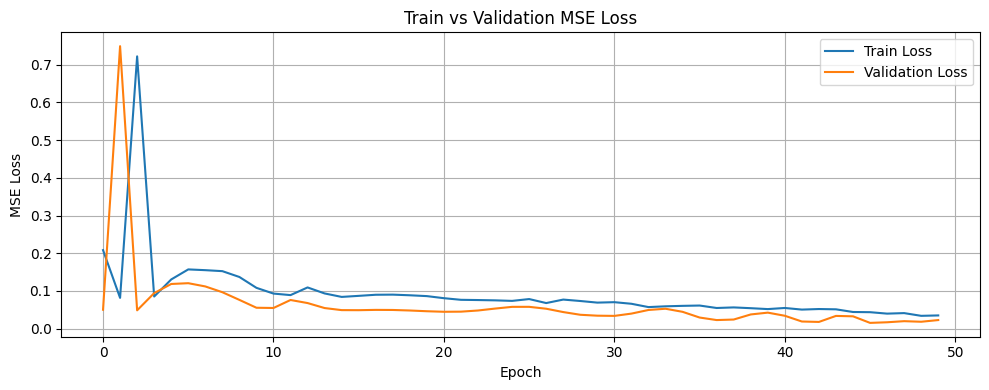

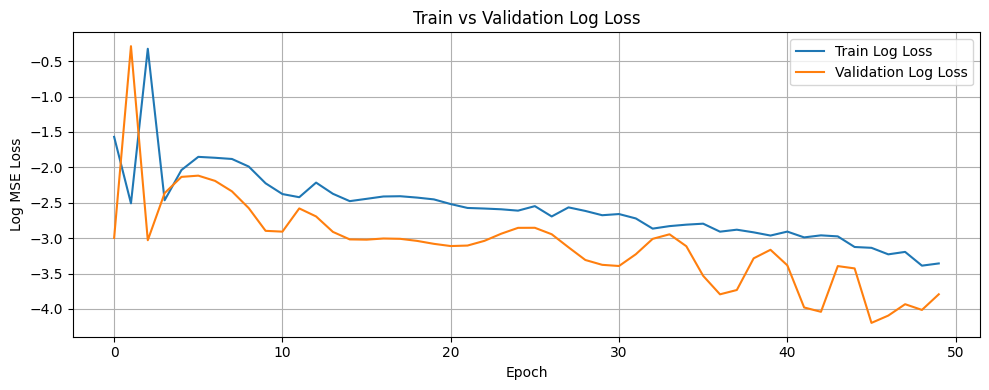

Training completed

=== Processing group: ('04 TO 06', 'BUKIT MERAH', '4 ROOM') ===
Group size: 17 rows
Calling prepare_lstm_data for ('04 TO 06', 'BUKIT MERAH', '4 ROOM')

Filtering for: BUKIT MERAH, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 437
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 47
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2113, Val Loss: 0.0737, Train R²: -2.2244, Val R²: 0.0238
Best model saved!
Epoch 2/50, Train Loss: 0.0682, Val Loss: 0.7499, Train R²: -0.0412, Val R²: -8.9352
Epoch 3/50, Train Loss: 0.7631, Val Loss: 0.0710, Train R²: -10.6469, Val R²: 0.0593
Best model saved!
Epoch 4/50, Train Loss: 0.0630, Val Loss: 0.1345, Train R²: 0.

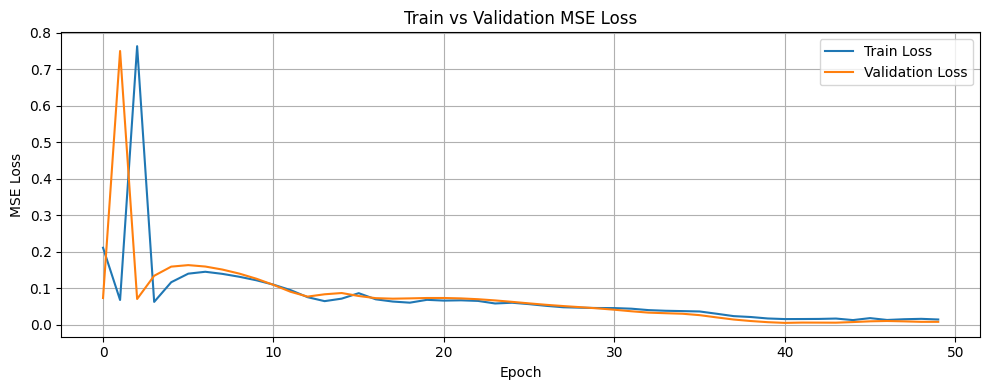

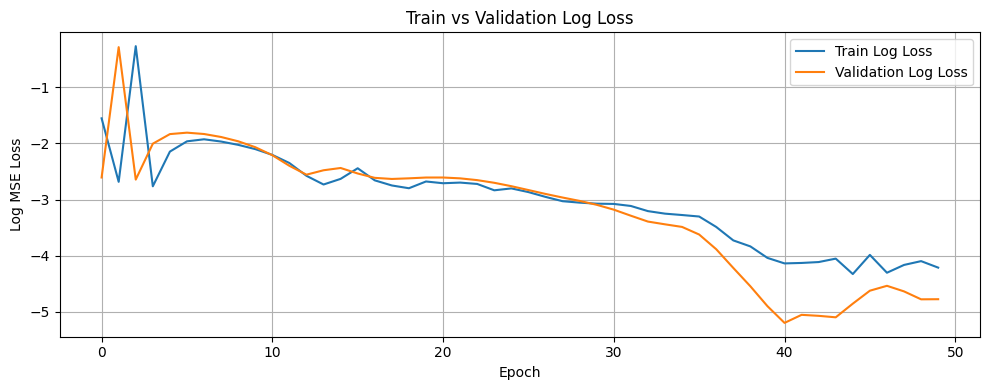

Training completed

=== Processing group: ('04 TO 06', 'BUKIT MERAH', '5 ROOM') ===
Group size: 6 rows
Calling prepare_lstm_data for ('04 TO 06', 'BUKIT MERAH', '5 ROOM')

Filtering for: BUKIT MERAH, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 249
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 40
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1960, Val Loss: 0.0617, Train R²: -3.0121, Val R²: -0.0774
Best model saved!
Epoch 2/50, Train Loss: 0.0491, Val Loss: 0.8602, Train R²: -0.0063, Val R²: -14.0297
Epoch 3/50, Train Loss: 0.9593, Val Loss: 0.0575, Train R²: -18.6419, Val R²: -0.0048
Best model saved!
Epoch 4/50, Train Loss: 0.0480, Val Loss: 0.1175, Train R²: 

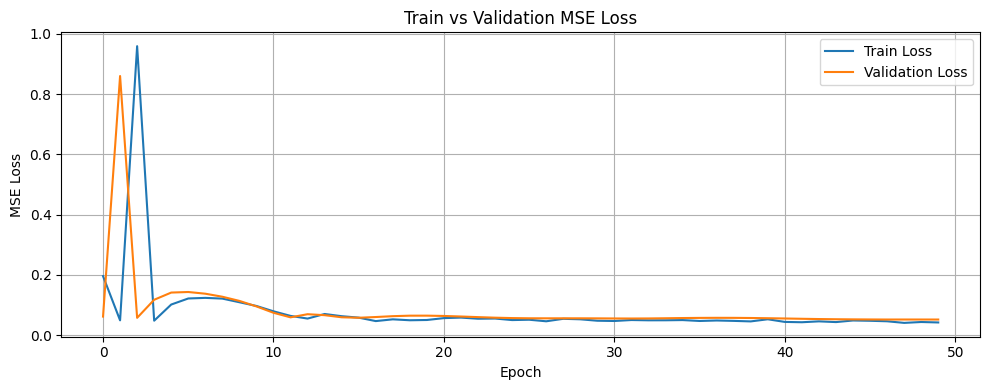

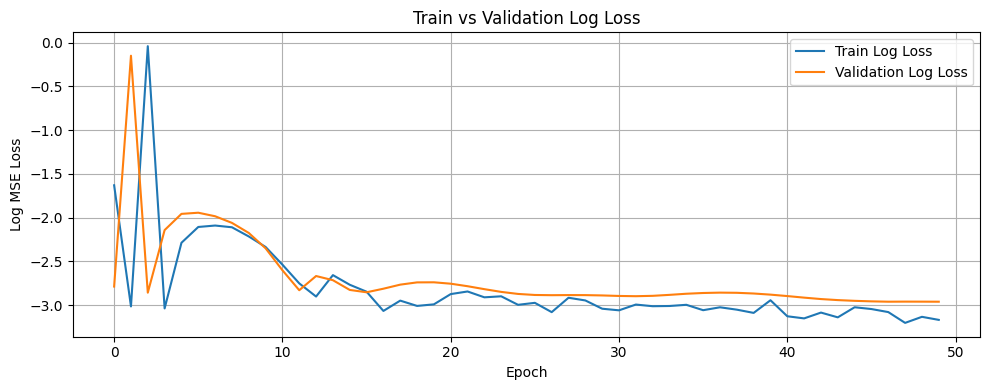

Training completed

=== Processing group: ('04 TO 06', 'BUKIT PANJANG', '3 ROOM') ===
Group size: 4 rows
Calling prepare_lstm_data for ('04 TO 06', 'BUKIT PANJANG', '3 ROOM')

Filtering for: BUKIT PANJANG, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 209
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 33
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2438, Val Loss: 0.0585, Train R²: -6.4301, Val R²: -2.1335
Best model saved!
Epoch 2/50, Train Loss: 0.0881, Val Loss: 0.2606, Train R²: -1.6846, Val R²: -12.9610
Epoch 3/50, Train Loss: 0.2855, Val Loss: 0.0252, Train R²: -7.7031, Val R²: -0.3478
Best model saved!
Epoch 4/50, Train Loss: 0.0458, Val Loss: 0.0664, Train

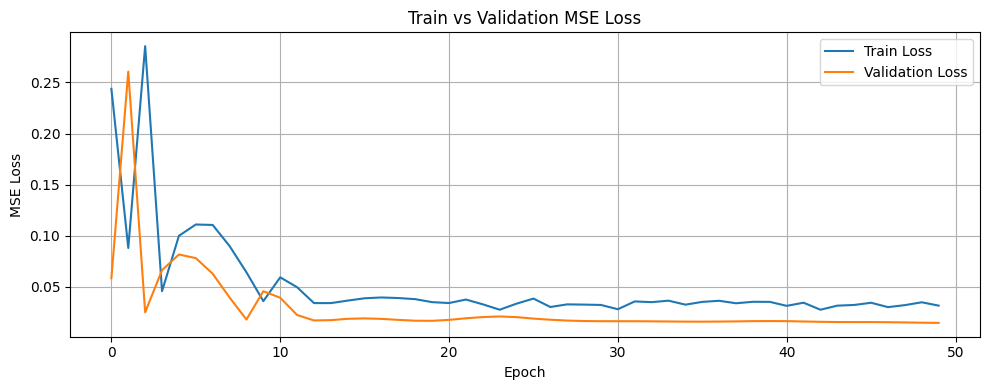

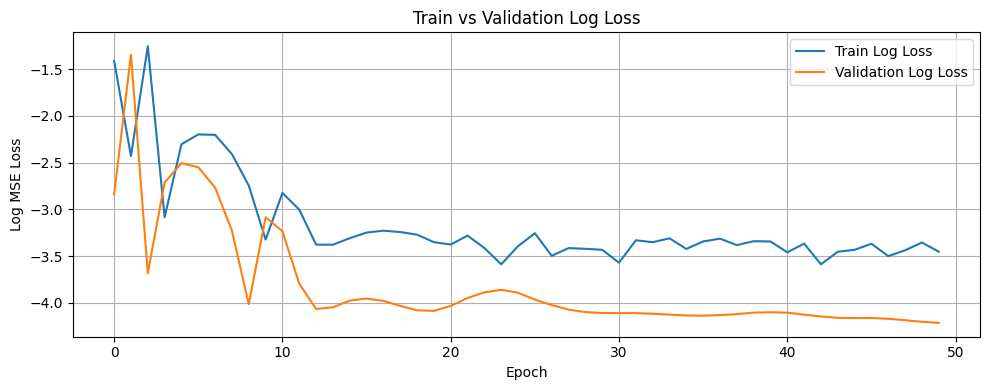

Training completed

=== Processing group: ('04 TO 06', 'BUKIT PANJANG', '4 ROOM') ===
Group size: 17 rows
Calling prepare_lstm_data for ('04 TO 06', 'BUKIT PANJANG', '4 ROOM')

Filtering for: BUKIT PANJANG, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 696
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 36
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1092, Val Loss: 0.0263, Train R²: -2.0281, Val R²: 0.0847
Best model saved!
Epoch 2/50, Train Loss: 0.0404, Val Loss: 0.0329, Train R²: -0.1208, Val R²: -0.1445
Epoch 3/50, Train Loss: 0.0375, Val Loss: 0.0308, Train R²: -0.0386, Val R²: -0.0735
Epoch 4/50, Train Loss: 0.0340, Val Loss: 0.0271, Train R²: 0.0568, Val R²

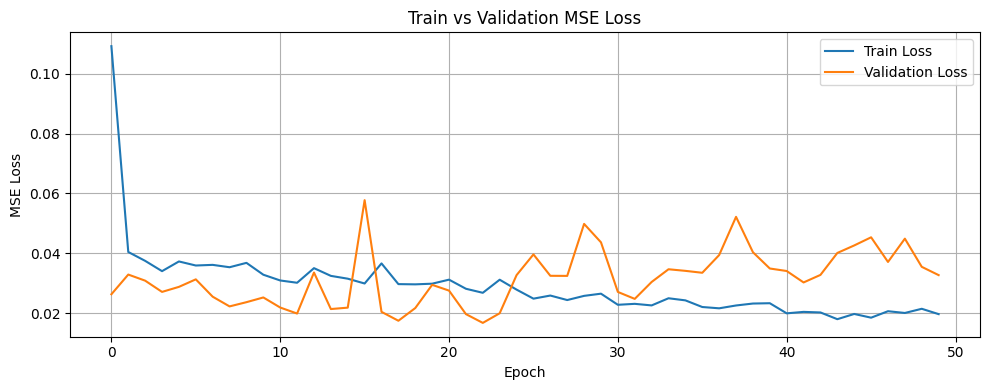

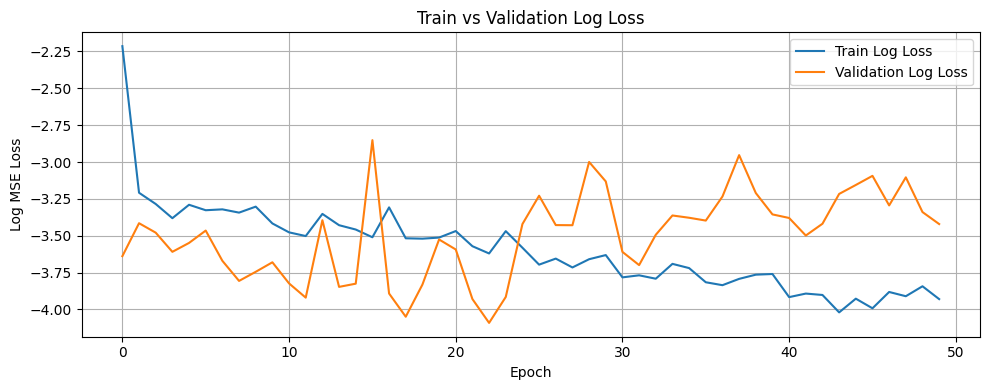

Training completed

=== Processing group: ('04 TO 06', 'BUKIT PANJANG', '5 ROOM') ===
Group size: 5 rows
Calling prepare_lstm_data for ('04 TO 06', 'BUKIT PANJANG', '5 ROOM')

Filtering for: BUKIT PANJANG, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 366
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 35
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1379, Val Loss: 0.0482, Train R²: -1.7895, Val R²: -0.4640
Best model saved!
Epoch 2/50, Train Loss: 0.0519, Val Loss: 0.0343, Train R²: -0.0485, Val R²: -0.0427
Best model saved!
Epoch 3/50, Train Loss: 0.0584, Val Loss: 0.0325, Train R²: -0.1805, Val R²: 0.0119
Best model saved!
Epoch 4/50, Train Loss: 0.0555, Val Los

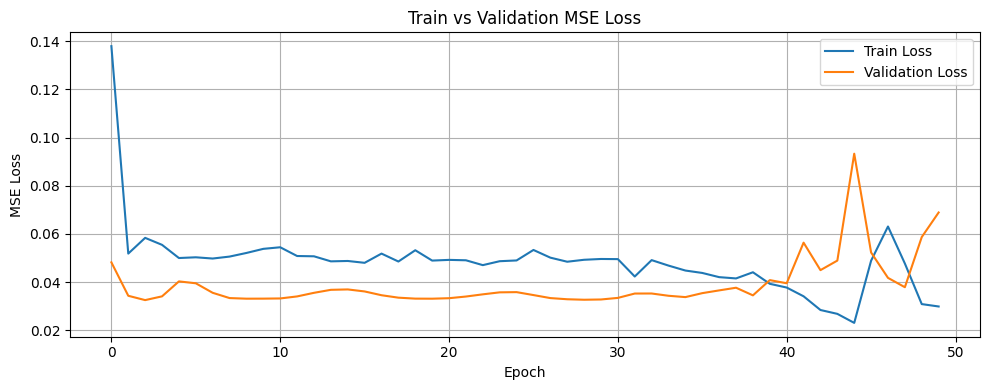

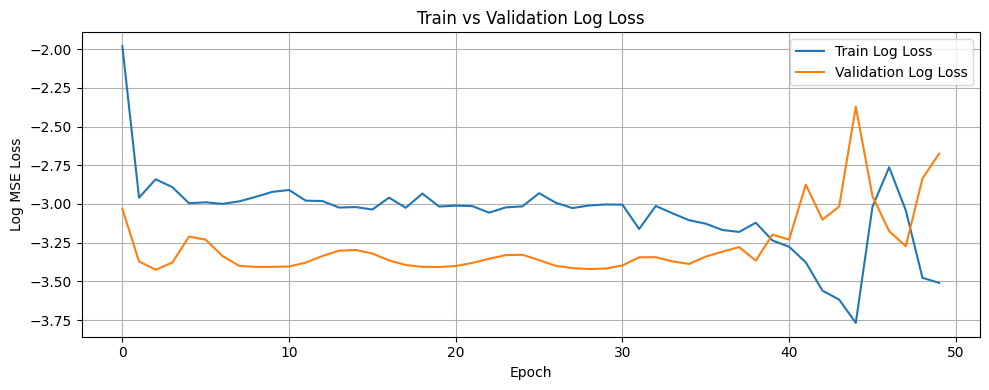

Training completed

=== Processing group: ('04 TO 06', 'BUKIT PANJANG', 'EXECUTIVE') ===
Group size: 4 rows
Calling prepare_lstm_data for ('04 TO 06', 'BUKIT PANJANG', 'EXECUTIVE')

Filtering for: BUKIT PANJANG, EXECUTIVE, 04 TO 06, around 2025-01-01
Initial strict match count: 166
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 39
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2885, Val Loss: 0.0799, Train R²: -5.2633, Val R²: -4.5597
Best model saved!
Epoch 2/50, Train Loss: 0.1268, Val Loss: 0.2389, Train R²: -1.7532, Val R²: -15.6235
Epoch 3/50, Train Loss: 0.2782, Val Loss: 0.0366, Train R²: -5.0398, Val R²: -1.5494
Best model saved!
Epoch 4/50, Train Loss: 0.0783, Val Loss: 0.08

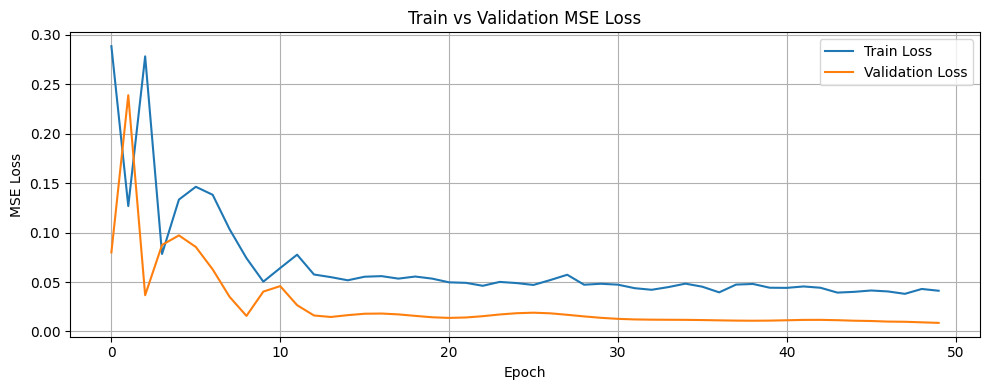

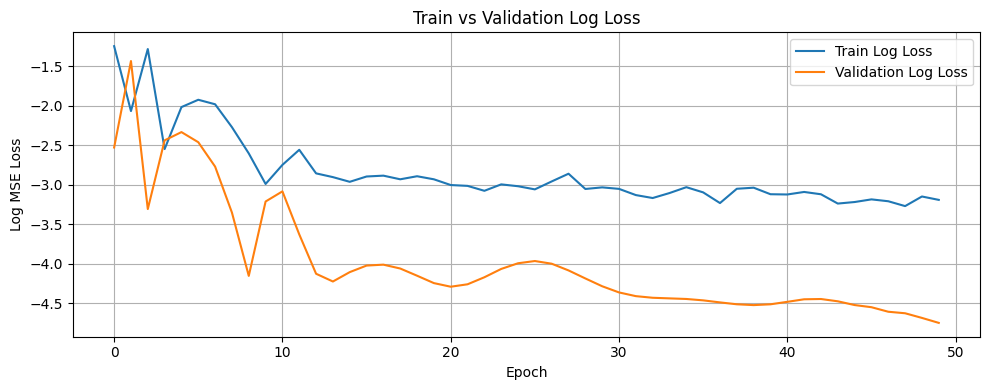

Training completed

=== Processing group: ('04 TO 06', 'BUKIT TIMAH', '3 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('04 TO 06', 'BUKIT TIMAH', '3 ROOM')

Filtering for: BUKIT TIMAH, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 27
Using before_or_at_target with 27 records.
Removing 'block' column from dataset
Data shapes - x_train: (26, 9), y_train: (26,)
Flattened y shape: (26,), Unique values: 22
Using simple train-validation split (80/20).
Split sizes - Train: 20, Val: 6
Creating PyTorch datasets...
Dataset sizes - Train: 20, Val: 6
Using batch sizes - Train: 20, Val: 6
Starting model training...
Epoch 1/50, Train Loss: 0.1642, Val Loss: 0.0508, Train R²: -1.9101, Val R²: -0.5406
Best model saved!
Epoch 2/50, Train Loss: 0.0535, Val Loss: 0.5551, Train R²: 0.0512, Val R²: -15.8180
Epoch 3/50, Train Loss: 0.4166, Val Loss: 0.0475, Train R²: -6.3838, Val R²: -0.4399
Best model saved!
Epoch 4/50, Train Loss: 0.0602, Val Loss: 0.0340, Train R²: -0.066

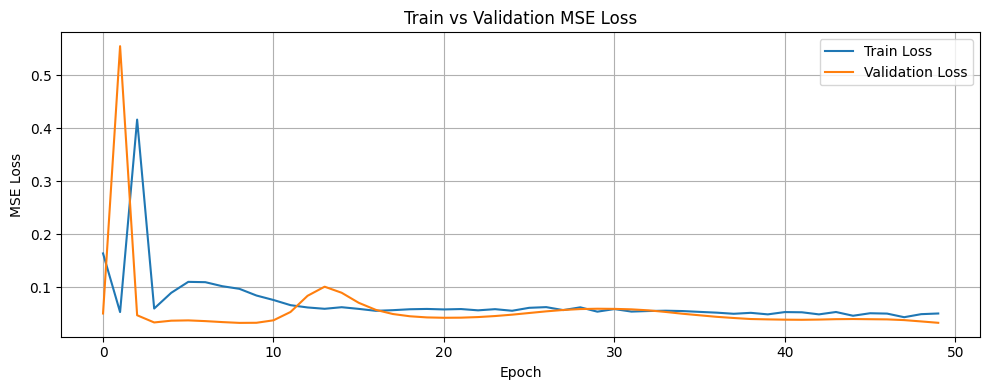

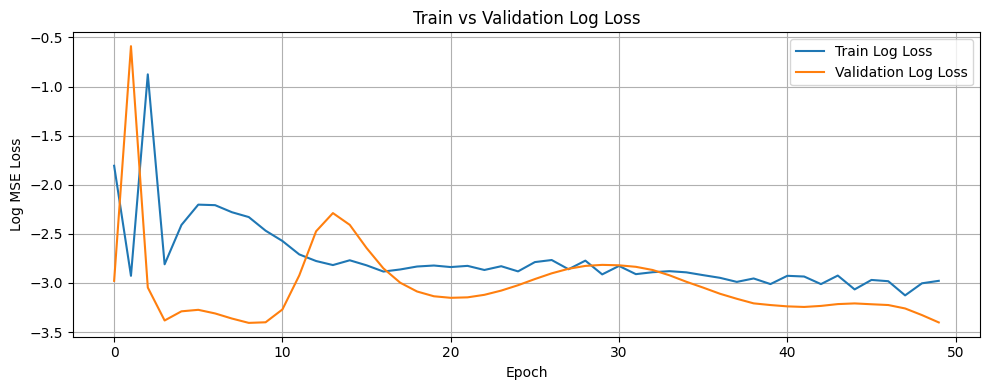

Training completed

=== Processing group: ('04 TO 06', 'BUKIT TIMAH', '5 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('04 TO 06', 'BUKIT TIMAH', '5 ROOM')

Filtering for: BUKIT TIMAH, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 22
Using before_or_at_target with 21 records.
Removing 'block' column from dataset
Data shapes - x_train: (20, 9), y_train: (20,)
Flattened y shape: (20,), Unique values: 20
Using simple train-validation split (80/20).
Split sizes - Train: 16, Val: 4
Creating PyTorch datasets...
Dataset sizes - Train: 16, Val: 4
Using batch sizes - Train: 16, Val: 4
Starting model training...
Epoch 1/50, Train Loss: 0.1365, Val Loss: 0.1132, Train R²: -0.9134, Val R²: -0.1209
Best model saved!
Epoch 2/50, Train Loss: 0.1030, Val Loss: 0.1160, Train R²: -0.4438, Val R²: -0.1480
Epoch 3/50, Train Loss: 0.0866, Val Loss: 0.1224, Train R²: -0.2147, Val R²: -0.2114
Epoch 4/50, Train Loss: 0.0837, Val Loss: 0.1133, Train R²: -0.1734, Val R²: -0.1220

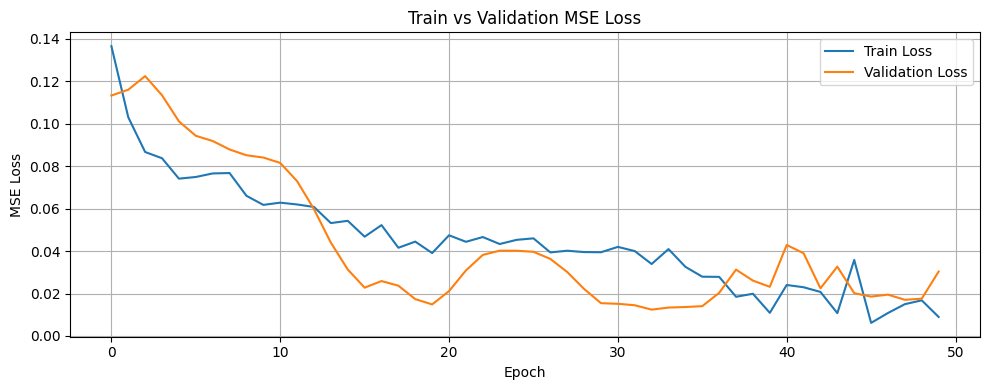

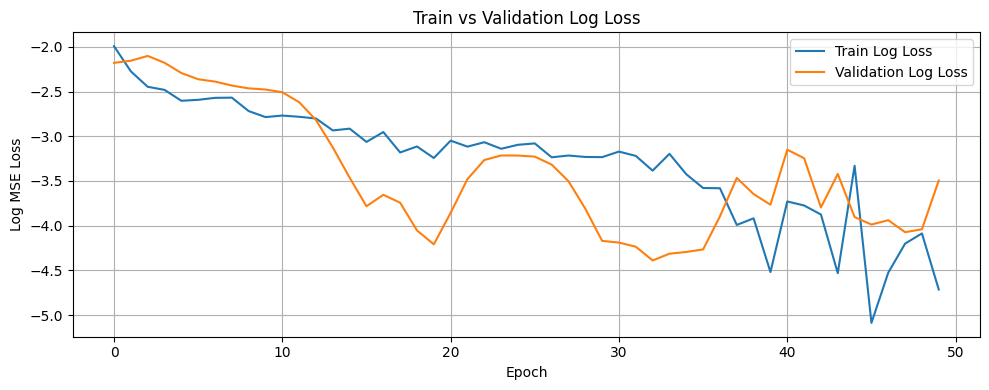

Training completed

=== Processing group: ('04 TO 06', 'CENTRAL AREA', '3 ROOM') ===
Group size: 3 rows
Calling prepare_lstm_data for ('04 TO 06', 'CENTRAL AREA', '3 ROOM')

Filtering for: CENTRAL AREA, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 128
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2111, Val Loss: 0.0695, Train R²: -2.4340, Val R²: -0.7800
Best model saved!
Epoch 2/50, Train Loss: 0.0903, Val Loss: 0.2813, Train R²: -0.4693, Val R²: -6.2034
Epoch 3/50, Train Loss: 0.3111, Val Loss: 0.0452, Train R²: -4.0617, Val R²: -0.1563
Best model saved!
Epoch 4/50, Train Loss: 0.0639, Val Loss: 0.0911, Train R²:

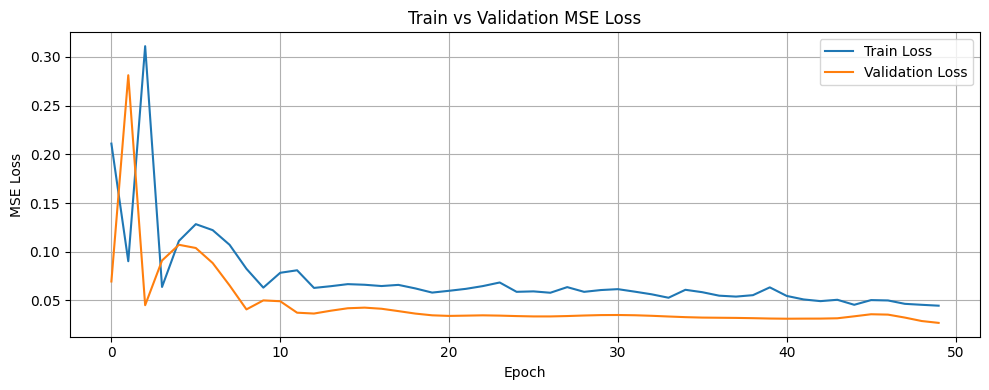

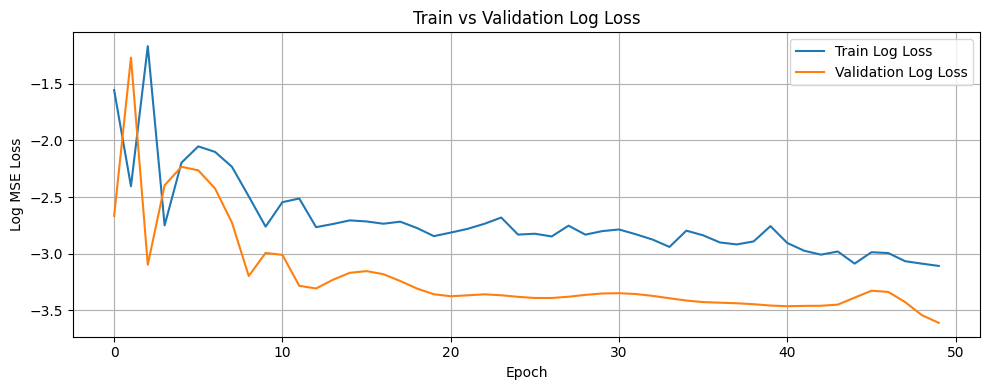

Training completed

=== Processing group: ('04 TO 06', 'CENTRAL AREA', '4 ROOM') ===
Group size: 2 rows
Calling prepare_lstm_data for ('04 TO 06', 'CENTRAL AREA', '4 ROOM')

Filtering for: CENTRAL AREA, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 68
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2331, Val Loss: 0.1022, Train R²: -2.2307, Val R²: -0.2239
Best model saved!
Epoch 2/50, Train Loss: 0.0865, Val Loss: 0.5636, Train R²: -0.1986, Val R²: -5.7489
Epoch 3/50, Train Loss: 0.6527, Val Loss: 0.0800, Train R²: -8.0469, Val R²: 0.0418
Best model saved!
Epoch 4/50, Train Loss: 0.0714, Val Loss: 0.1454, Train R²: 0

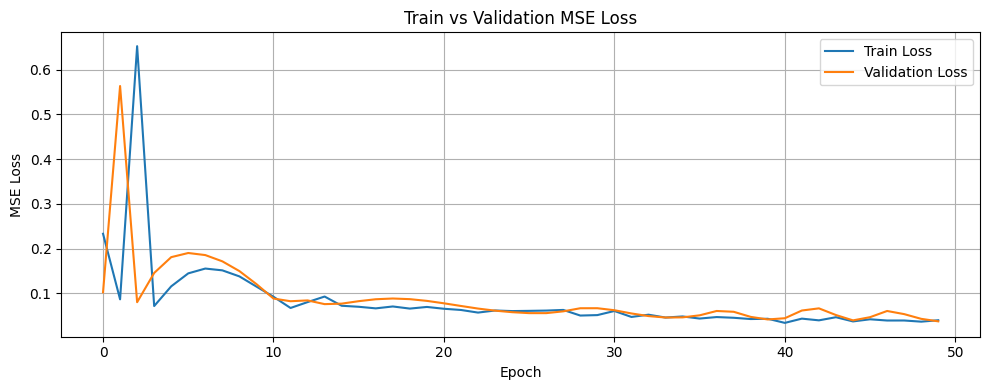

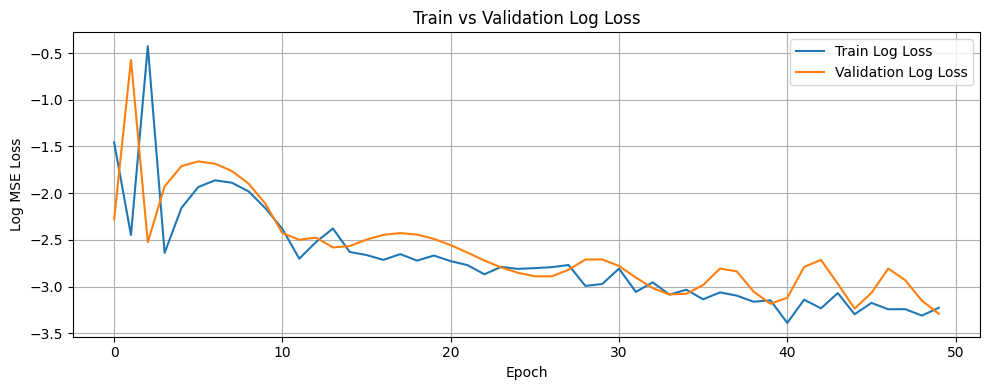

Training completed

=== Processing group: ('04 TO 06', 'CHOA CHU KANG', '3 ROOM') ===
Group size: 2 rows
Calling prepare_lstm_data for ('04 TO 06', 'CHOA CHU KANG', '3 ROOM')

Filtering for: CHOA CHU KANG, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 138
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1475, Val Loss: 0.0821, Train R²: -2.0774, Val R²: -0.0296
Best model saved!
Epoch 2/50, Train Loss: 0.0473, Val Loss: 0.0748, Train R²: 0.0130, Val R²: 0.0615
Best model saved!
Epoch 3/50, Train Loss: 0.0473, Val Loss: 0.0678, Train R²: 0.0141, Val R²: 0.1492
Best model saved!
Epoch 4/50, Train Loss: 0.0440, Val Loss: 

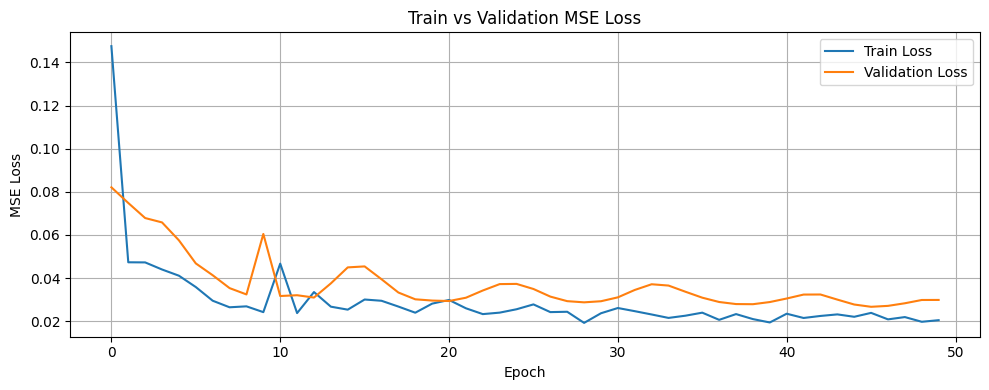

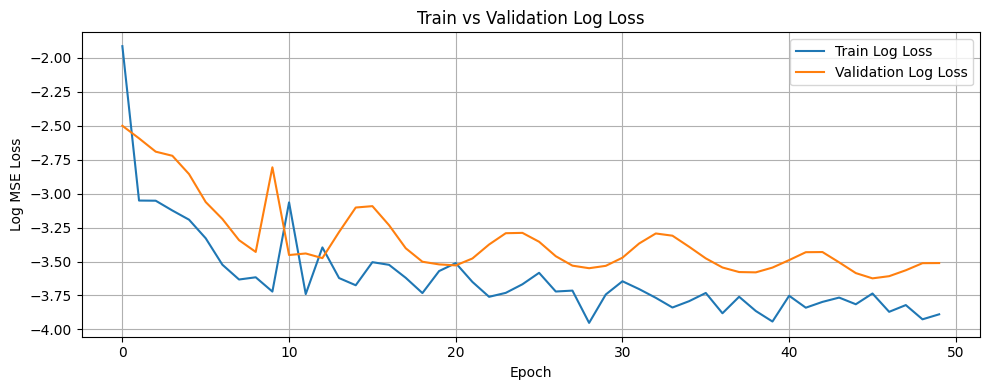

Training completed

=== Processing group: ('04 TO 06', 'CHOA CHU KANG', '4 ROOM') ===
Group size: 26 rows
Calling prepare_lstm_data for ('04 TO 06', 'CHOA CHU KANG', '4 ROOM')

Filtering for: CHOA CHU KANG, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 1057
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2759, Val Loss: 0.0492, Train R²: -3.2991, Val R²: -1.0957
Best model saved!
Epoch 2/50, Train Loss: 0.1080, Val Loss: 0.2478, Train R²: -0.6838, Val R²: -9.5628
Epoch 3/50, Train Loss: 0.2473, Val Loss: 0.0226, Train R²: -2.8533, Val R²: 0.0362
Best model saved!
Epoch 4/50, Train Loss: 0.0722, Val Loss: 0.0433, Train

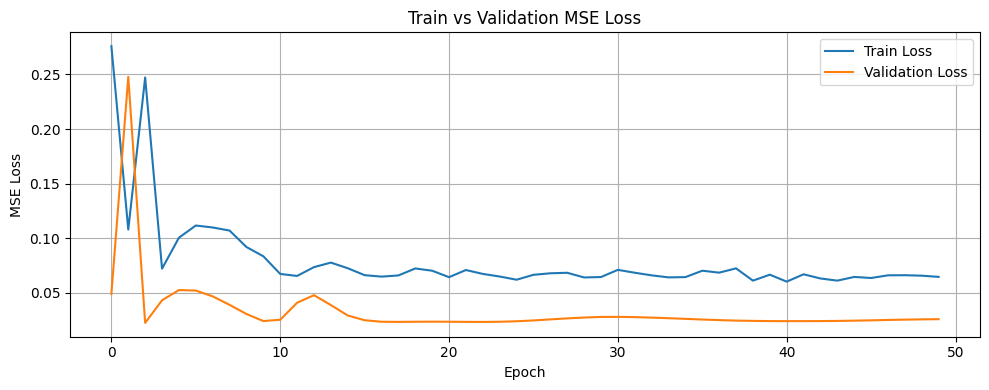

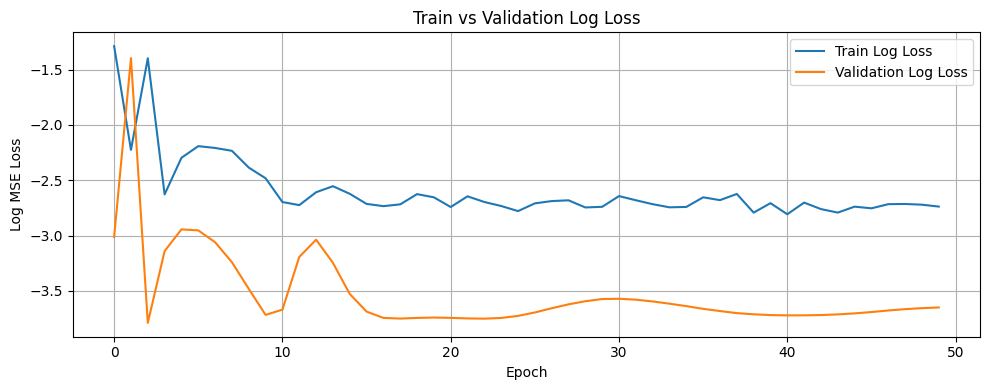

Training completed

=== Processing group: ('04 TO 06', 'CHOA CHU KANG', '5 ROOM') ===
Group size: 22 rows
Calling prepare_lstm_data for ('04 TO 06', 'CHOA CHU KANG', '5 ROOM')

Filtering for: CHOA CHU KANG, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 717
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1912, Val Loss: 0.0728, Train R²: -2.5531, Val R²: -0.0431
Best model saved!
Epoch 2/50, Train Loss: 0.0549, Val Loss: 0.7914, Train R²: -0.0212, Val R²: -10.3439
Epoch 3/50, Train Loss: 0.6166, Val Loss: 0.0746, Train R²: -10.4610, Val R²: -0.0700
Epoch 4/50, Train Loss: 0.0590, Val Loss: 0.0829, Train R²: -0.0969, Va

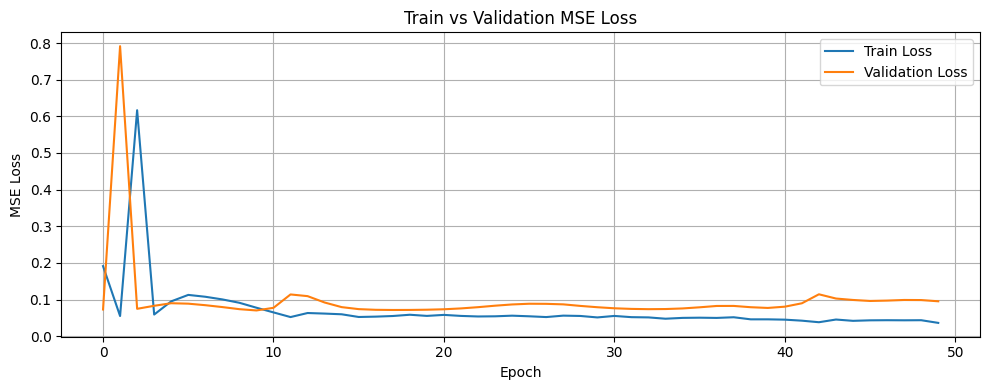

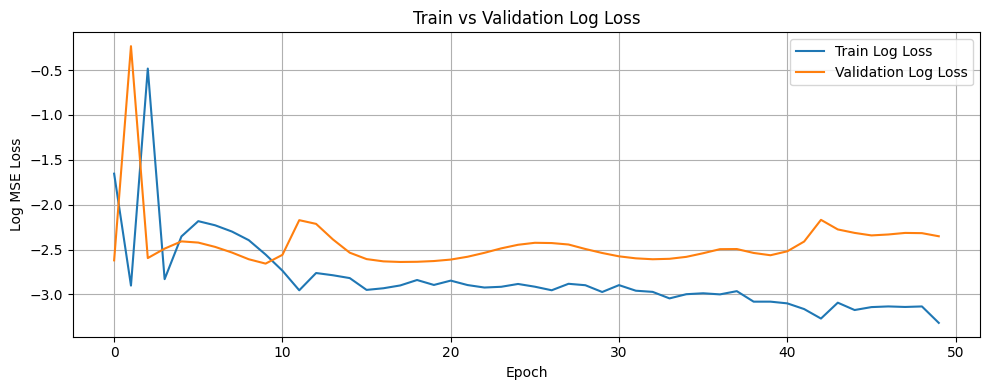

Training completed

=== Processing group: ('04 TO 06', 'CHOA CHU KANG', 'EXECUTIVE') ===
Group size: 4 rows
Calling prepare_lstm_data for ('04 TO 06', 'CHOA CHU KANG', 'EXECUTIVE')

Filtering for: CHOA CHU KANG, EXECUTIVE, 04 TO 06, around 2025-01-01
Initial strict match count: 276
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 31
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3119, Val Loss: 0.0803, Train R²: -6.0356, Val R²: -0.5609
Best model saved!
Epoch 2/50, Train Loss: 0.0955, Val Loss: 0.7131, Train R²: -1.1549, Val R²: -12.8658
Epoch 3/50, Train Loss: 0.6386, Val Loss: 0.0557, Train R²: -13.4043, Val R²: -0.0838
Best model saved!
Epoch 4/50, Train Loss: 0.0595, Val Loss: 0.1

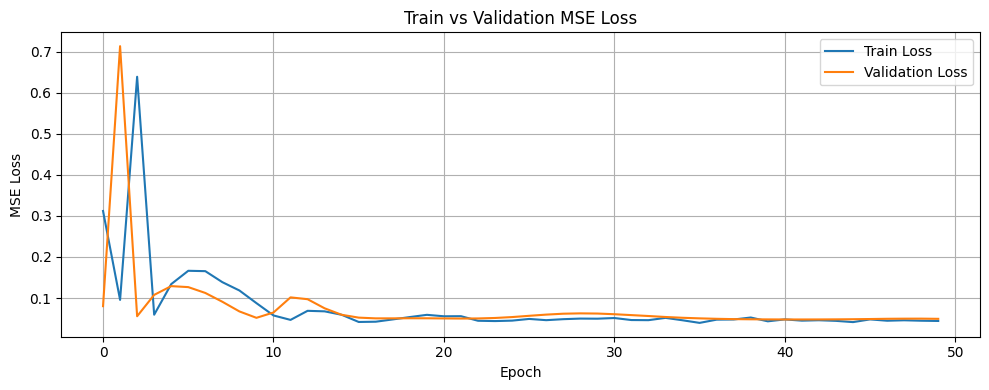

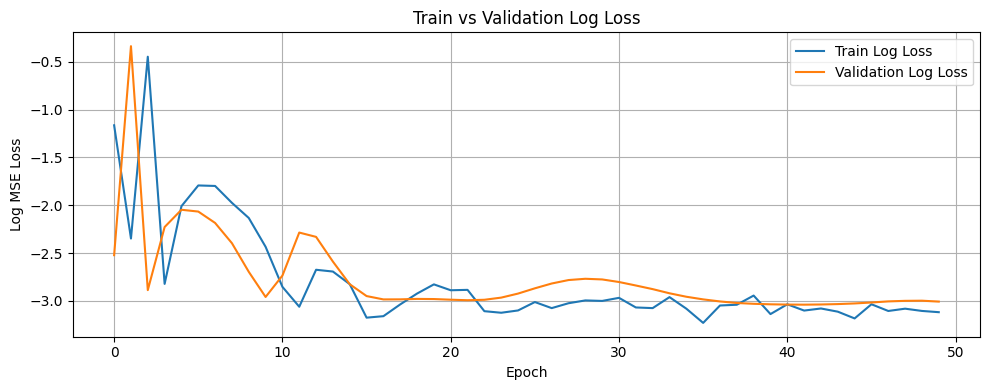

Training completed

=== Processing group: ('04 TO 06', 'CLEMENTI', '3 ROOM') ===
Group size: 15 rows
Calling prepare_lstm_data for ('04 TO 06', 'CLEMENTI', '3 ROOM')

Filtering for: CLEMENTI, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 518
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 36
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1028, Val Loss: 0.0415, Train R²: -1.4451, Val R²: -0.9026
Best model saved!
Epoch 2/50, Train Loss: 0.0576, Val Loss: 0.0253, Train R²: -0.3704, Val R²: -0.1586
Best model saved!
Epoch 3/50, Train Loss: 0.0479, Val Loss: 0.0275, Train R²: -0.1397, Val R²: -0.2632
Epoch 4/50, Train Loss: 0.0500, Val Loss: 0.0241, Train R²: -0.1893, V

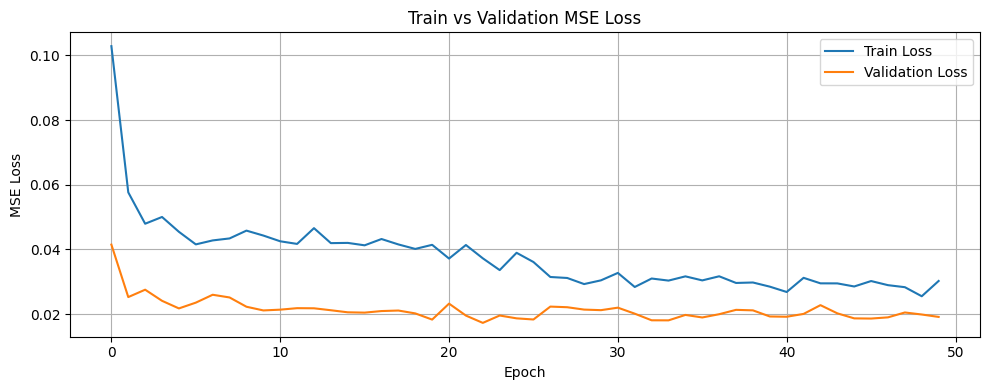

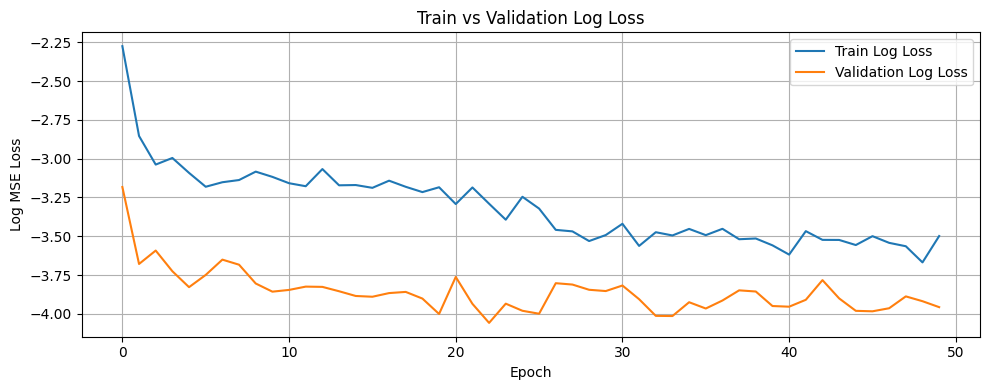

Training completed

=== Processing group: ('04 TO 06', 'CLEMENTI', '4 ROOM') ===
Group size: 6 rows
Calling prepare_lstm_data for ('04 TO 06', 'CLEMENTI', '4 ROOM')

Filtering for: CLEMENTI, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 319
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 43
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1751, Val Loss: 0.1104, Train R²: -1.4170, Val R²: -0.0810
Best model saved!
Epoch 2/50, Train Loss: 0.0700, Val Loss: 0.2195, Train R²: 0.0336, Val R²: -1.1491
Epoch 3/50, Train Loss: 0.2432, Val Loss: 0.1127, Train R²: -2.3576, Val R²: -0.1040
Epoch 4/50, Train Loss: 0.0678, Val Loss: 0.1585, Train R²: 0.0642, Val R²: -0.5522
Epoch 

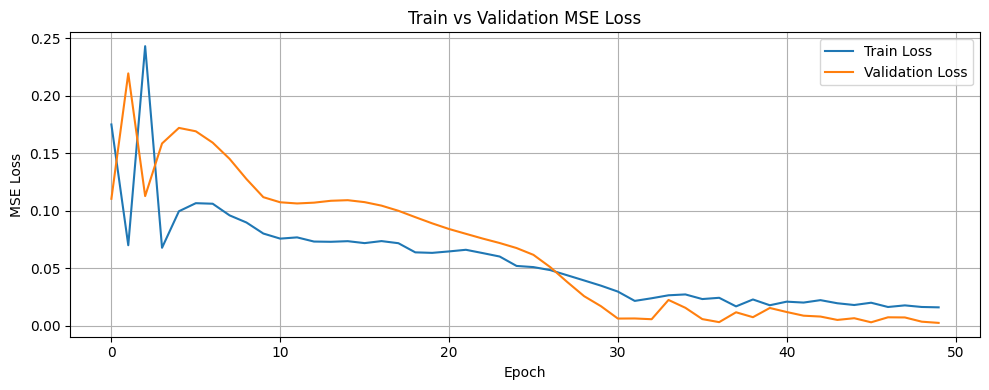

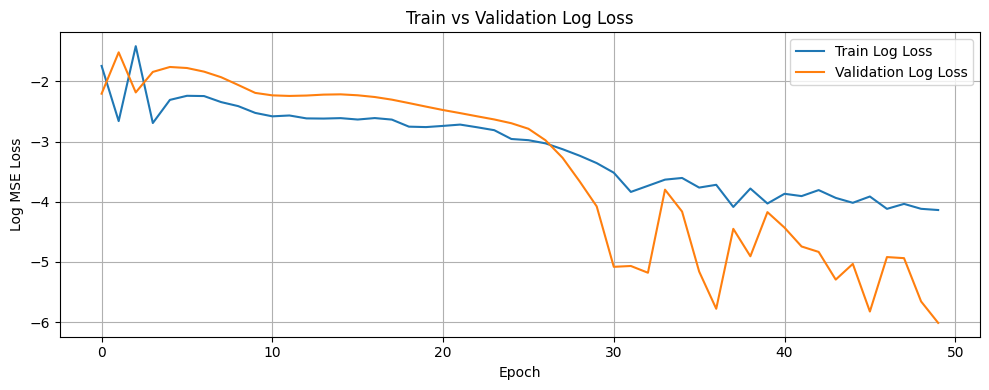

Training completed

=== Processing group: ('04 TO 06', 'CLEMENTI', '5 ROOM') ===
Group size: 5 rows
Calling prepare_lstm_data for ('04 TO 06', 'CLEMENTI', '5 ROOM')

Filtering for: CLEMENTI, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 87
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1462, Val Loss: 0.0810, Train R²: -1.2605, Val R²: -0.2106
Best model saved!
Epoch 2/50, Train Loss: 0.0635, Val Loss: 0.3134, Train R²: 0.0178, Val R²: -3.6864
Epoch 3/50, Train Loss: 0.4112, Val Loss: 0.0861, Train R²: -5.3592, Val R²: -0.2872
Epoch 4/50, Train Loss: 0.0599, Val Loss: 0.1549, Train R²: 0.0738, Val R²: -1.3160
Epoch 5

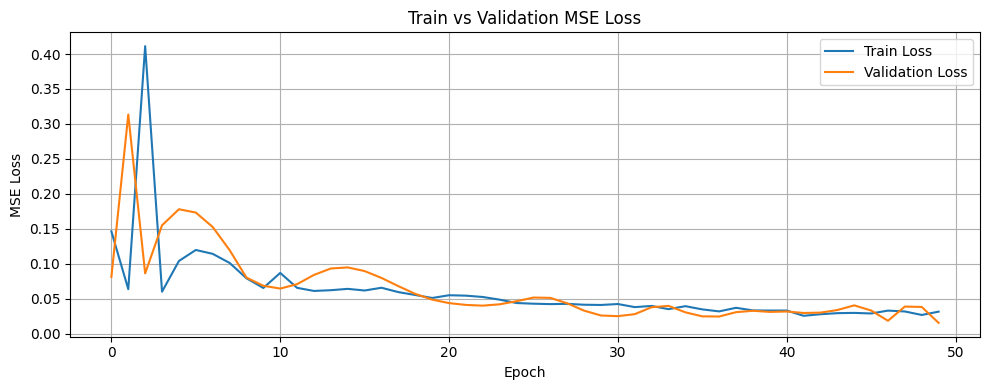

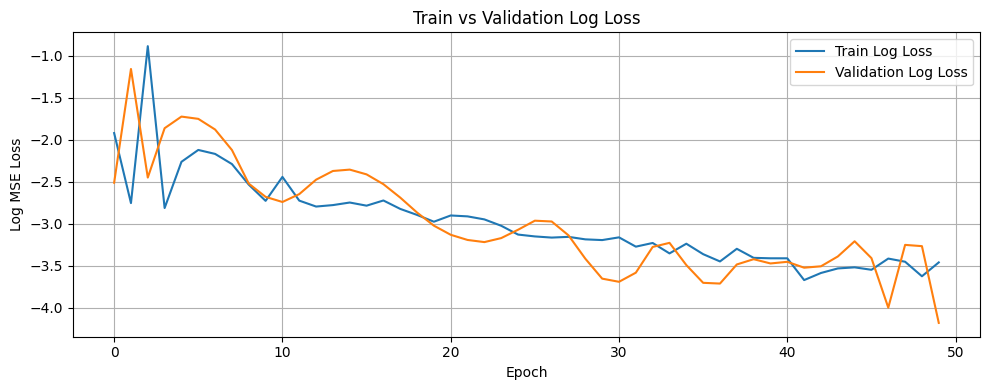

Training completed

=== Processing group: ('04 TO 06', 'CLEMENTI', 'EXECUTIVE') ===
Group size: 1 rows
Calling prepare_lstm_data for ('04 TO 06', 'CLEMENTI', 'EXECUTIVE')

Filtering for: CLEMENTI, EXECUTIVE, 04 TO 06, around 2025-01-01
Initial strict match count: 39
Using before_or_at_target with 38 records.
Removing 'block' column from dataset
Data shapes - x_train: (37, 9), y_train: (37,)
Flattened y shape: (37,), Unique values: 35
Using simple train-validation split (80/20).
Split sizes - Train: 29, Val: 8
Creating PyTorch datasets...
Dataset sizes - Train: 29, Val: 8
Using batch sizes - Train: 29, Val: 8
Starting model training...
Epoch 1/50, Train Loss: 0.1640, Val Loss: 0.1175, Train R²: -2.6232, Val R²: -0.5247
Best model saved!
Epoch 2/50, Train Loss: 0.0588, Val Loss: 0.4709, Train R²: -0.2989, Val R²: -5.1136
Epoch 3/50, Train Loss: 0.5622, Val Loss: 0.0887, Train R²: -11.4176, Val R²: -0.1517
Best model saved!
Epoch 4/50, Train Loss: 0.0460, Val Loss: 0.1590, Train R²: -0.01

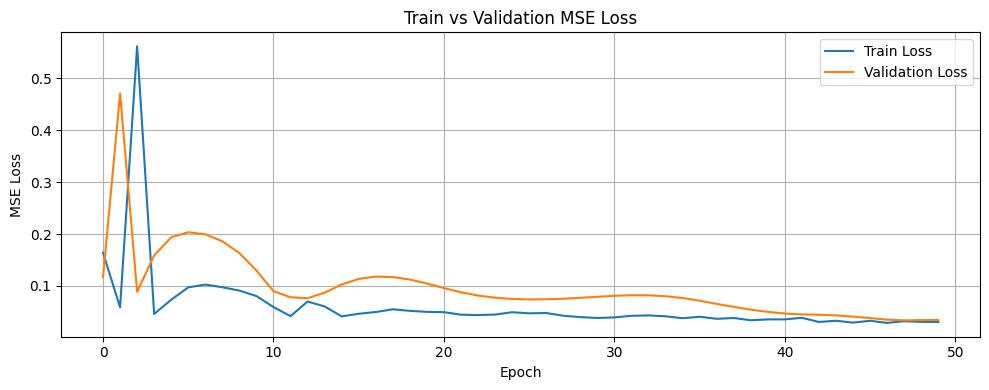

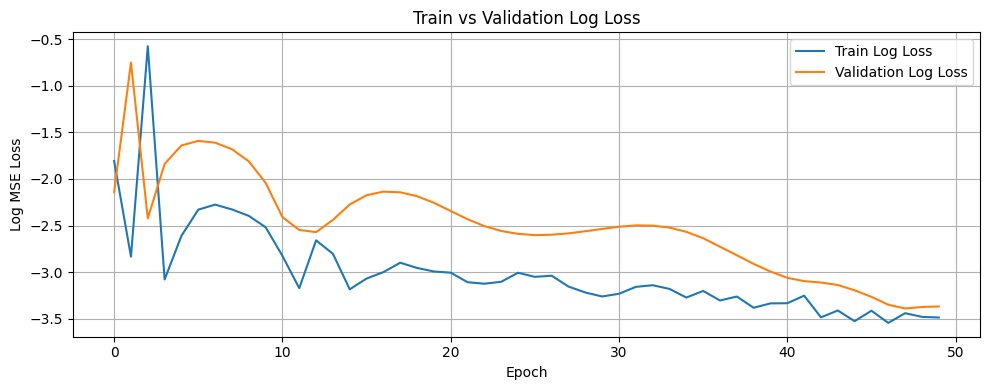

Training completed

=== Processing group: ('04 TO 06', 'GEYLANG', '2 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('04 TO 06', 'GEYLANG', '2 ROOM')

Filtering for: GEYLANG, 2 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 53
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 30
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2167, Val Loss: 0.0865, Train R²: -3.5208, Val R²: -1.3898
Best model saved!
Epoch 2/50, Train Loss: 0.0798, Val Loss: 0.7831, Train R²: -0.6646, Val R²: -20.6466
Epoch 3/50, Train Loss: 0.9028, Val Loss: 0.0511, Train R²: -17.8333, Val R²: -0.4124
Best model saved!
Epoch 4/50, Train Loss: 0.0667, Val Loss: 0.1482, Train R²: -0.3919, Val 

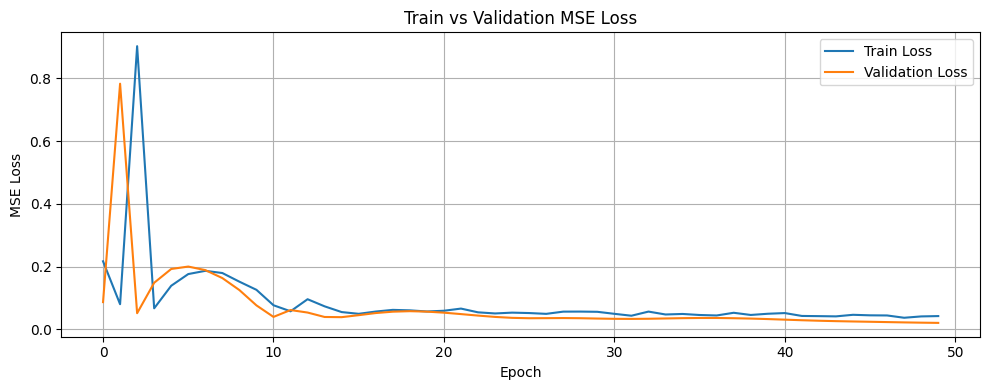

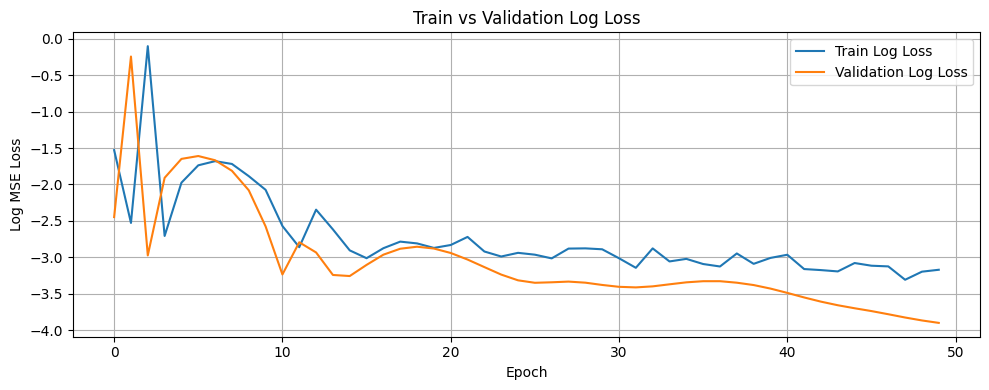

Training completed

=== Processing group: ('04 TO 06', 'GEYLANG', '3 ROOM') ===
Group size: 19 rows
Calling prepare_lstm_data for ('04 TO 06', 'GEYLANG', '3 ROOM')

Filtering for: GEYLANG, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 630
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 39
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1824, Val Loss: 0.1192, Train R²: -0.8665, Val R²: -0.0115
Best model saved!
Epoch 2/50, Train Loss: 0.0940, Val Loss: 0.3433, Train R²: 0.0385, Val R²: -1.9133
Epoch 3/50, Train Loss: 0.4104, Val Loss: 0.1127, Train R²: -3.1997, Val R²: 0.0434
Best model saved!
Epoch 4/50, Train Loss: 0.0929, Val Loss: 0.1559, Train R²: 0.0491, Val R²:

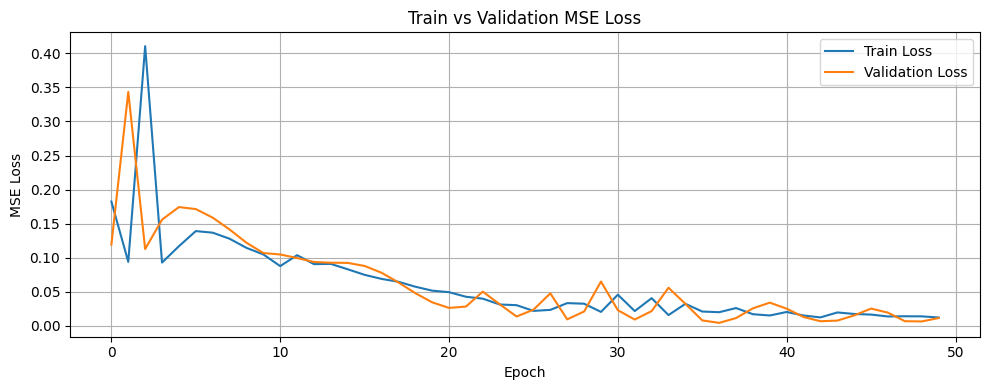

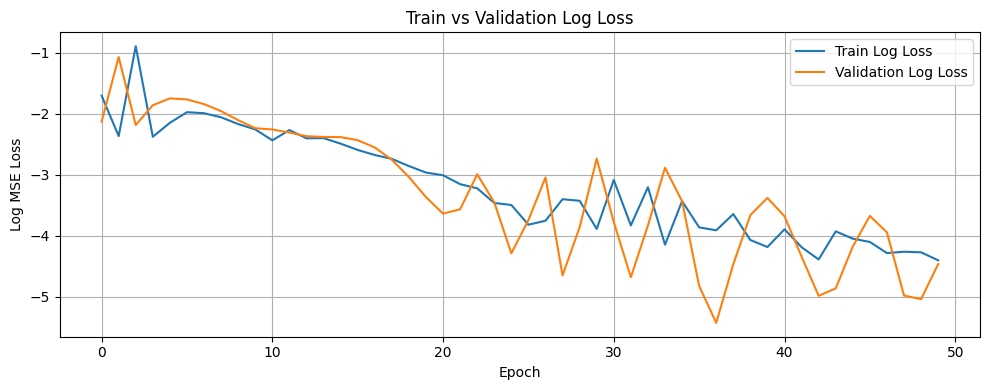

Training completed

=== Processing group: ('04 TO 06', 'GEYLANG', '4 ROOM') ===
Group size: 11 rows
Calling prepare_lstm_data for ('04 TO 06', 'GEYLANG', '4 ROOM')

Filtering for: GEYLANG, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 387
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 44
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3765, Val Loss: 0.2904, Train R²: -2.5894, Val R²: -2.3139
Best model saved!
Epoch 2/50, Train Loss: 0.1946, Val Loss: 0.1603, Train R²: -0.8553, Val R²: -0.8290
Best model saved!
Epoch 3/50, Train Loss: 0.3040, Val Loss: 0.1841, Train R²: -1.8982, Val R²: -1.1008
Epoch 4/50, Train Loss: 0.1340, Val Loss: 0.2699, Train R²: -0.2772, Val 

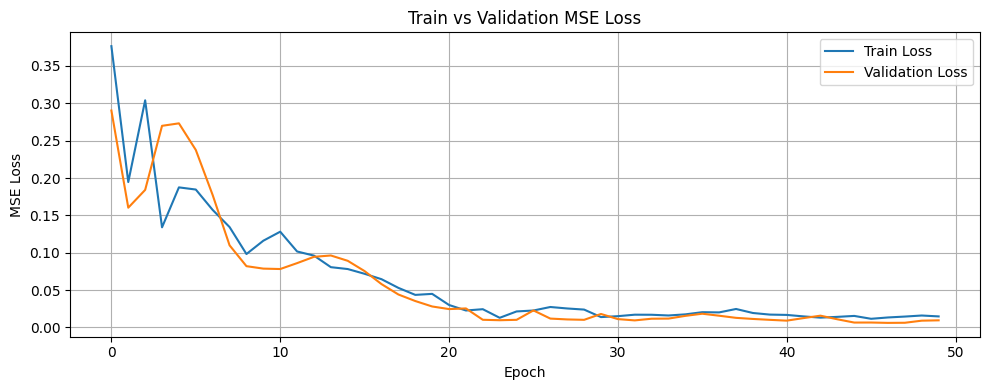

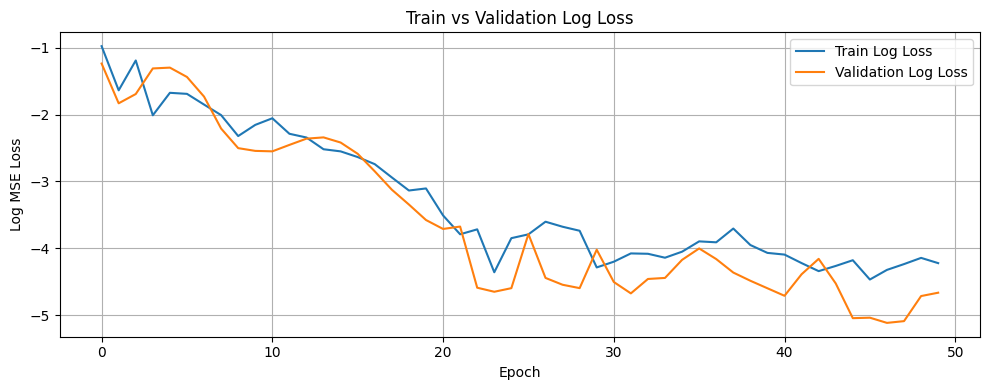

Training completed

=== Processing group: ('04 TO 06', 'GEYLANG', '5 ROOM') ===
Group size: 2 rows
Calling prepare_lstm_data for ('04 TO 06', 'GEYLANG', '5 ROOM')

Filtering for: GEYLANG, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 143
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 46
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2448, Val Loss: 0.1396, Train R²: -2.2968, Val R²: -0.2807
Best model saved!
Epoch 2/50, Train Loss: 0.0832, Val Loss: 1.1015, Train R²: -0.1208, Val R²: -9.1043
Epoch 3/50, Train Loss: 1.2907, Val Loss: 0.1104, Train R²: -16.3828, Val R²: -0.0124
Best model saved!
Epoch 4/50, Train Loss: 0.0747, Val Loss: 0.2272, Train R²: -0.0054, Val 

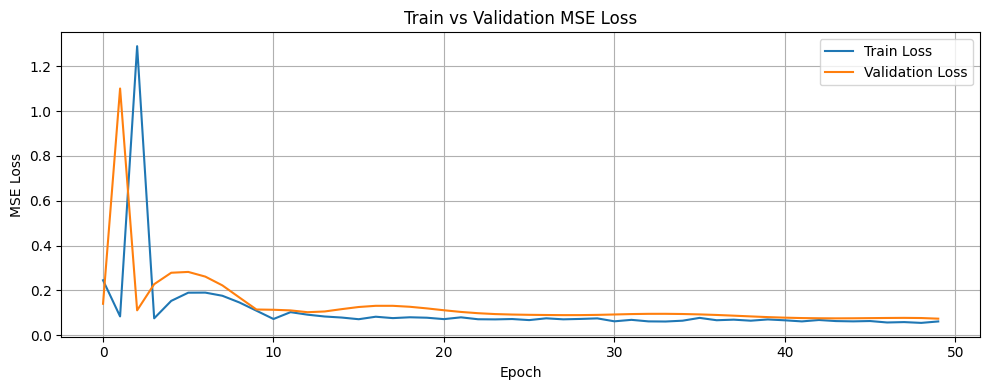

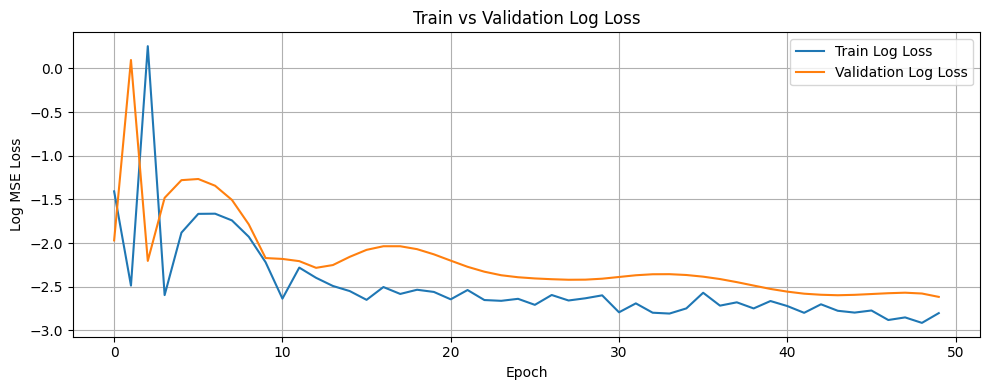

Training completed

=== Processing group: ('04 TO 06', 'GEYLANG', 'EXECUTIVE') ===
Group size: 2 rows
Calling prepare_lstm_data for ('04 TO 06', 'GEYLANG', 'EXECUTIVE')

Filtering for: GEYLANG, EXECUTIVE, 04 TO 06, around 2025-01-01
Initial strict match count: 38
Using before_or_at_target with 37 records.
Removing 'block' column from dataset
Data shapes - x_train: (36, 9), y_train: (36,)
Flattened y shape: (36,), Unique values: 31
Using simple train-validation split (80/20).
Split sizes - Train: 28, Val: 8
Creating PyTorch datasets...
Dataset sizes - Train: 28, Val: 8
Using batch sizes - Train: 28, Val: 8
Starting model training...
Epoch 1/50, Train Loss: 0.1220, Val Loss: 0.0734, Train R²: -0.9399, Val R²: -0.0781
Best model saved!
Epoch 2/50, Train Loss: 0.0734, Val Loss: 0.0705, Train R²: -0.1671, Val R²: -0.0351
Best model saved!
Epoch 3/50, Train Loss: 0.0602, Val Loss: 0.0674, Train R²: 0.0417, Val R²: 0.0100
Best model saved!
Epoch 4/50, Train Loss: 0.0634, Val Loss: 0.0650, Tra

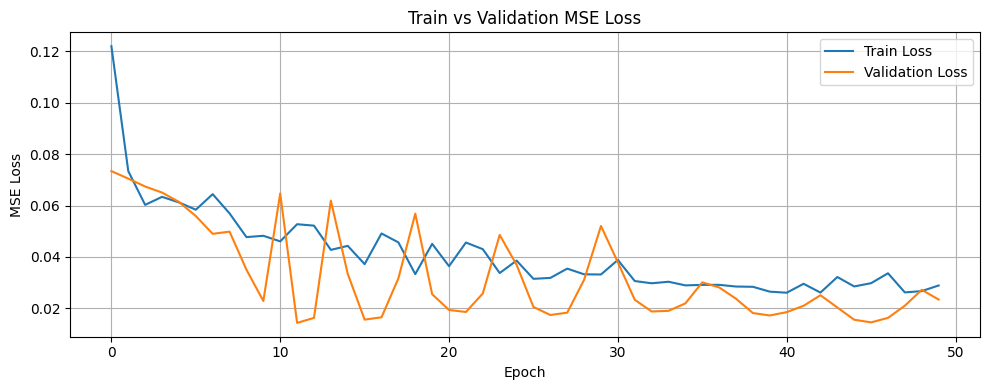

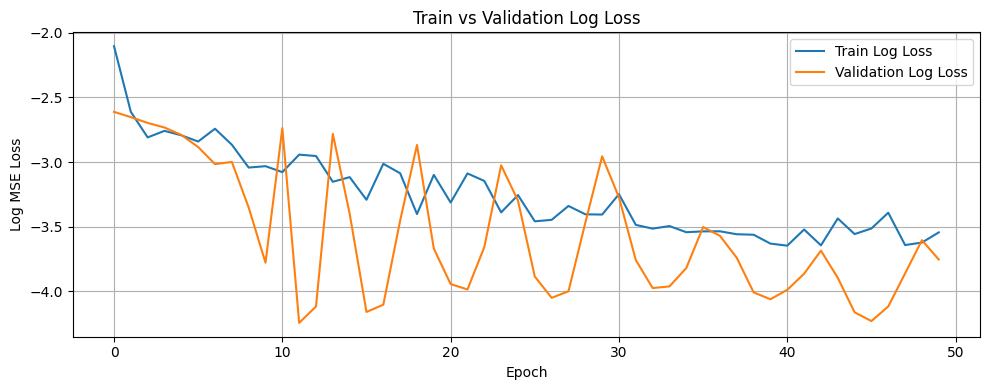

Training completed

=== Processing group: ('04 TO 06', 'HOUGANG', '2 ROOM') ===
Group size: 3 rows
Calling prepare_lstm_data for ('04 TO 06', 'HOUGANG', '2 ROOM')

Filtering for: HOUGANG, 2 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 20
Using before_or_at_target with 19 records.
Removing 'block' column from dataset
Data shapes - x_train: (18, 9), y_train: (18,)
Flattened y shape: (18,), Unique values: 17
Using simple train-validation split (80/20).
Split sizes - Train: 14, Val: 4
Creating PyTorch datasets...
Dataset sizes - Train: 14, Val: 4
Using batch sizes - Train: 14, Val: 4
Starting model training...
Epoch 1/50, Train Loss: 0.4214, Val Loss: 0.1254, Train R²: -5.3296, Val R²: -0.0691
Best model saved!
Epoch 2/50, Train Loss: 0.1554, Val Loss: 1.0094, Train R²: -1.3337, Val R²: -7.6048
Epoch 3/50, Train Loss: 0.5782, Val Loss: 0.1137, Train R²: -7.6847, Val R²: 0.0304
Best model saved!
Epoch 4/50, Train Loss: 0.0828, Val Loss: 0.1377, Train R²: -0.2433, Val R²: -0

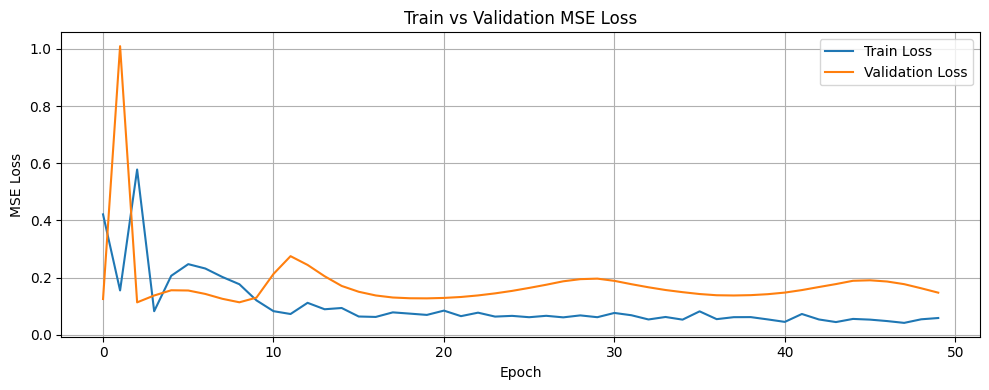

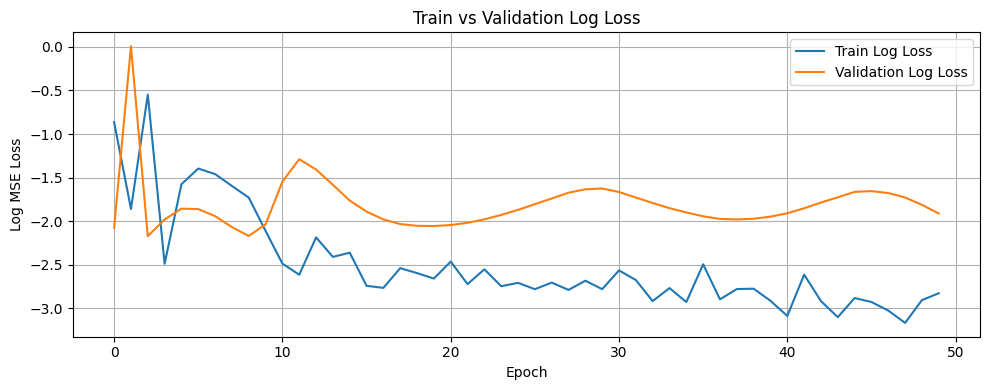

Training completed

=== Processing group: ('04 TO 06', 'HOUGANG', '3 ROOM') ===
Group size: 27 rows
Calling prepare_lstm_data for ('04 TO 06', 'HOUGANG', '3 ROOM')

Filtering for: HOUGANG, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 560
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 36
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2377, Val Loss: 0.0634, Train R²: -4.7560, Val R²: -0.5178
Best model saved!
Epoch 2/50, Train Loss: 0.0586, Val Loss: 0.6847, Train R²: -0.4181, Val R²: -15.3993
Epoch 3/50, Train Loss: 0.7741, Val Loss: 0.0385, Train R²: -17.7470, Val R²: 0.0768
Best model saved!
Epoch 4/50, Train Loss: 0.0367, Val Loss: 0.1126, Train R²: 0.1122, Val 

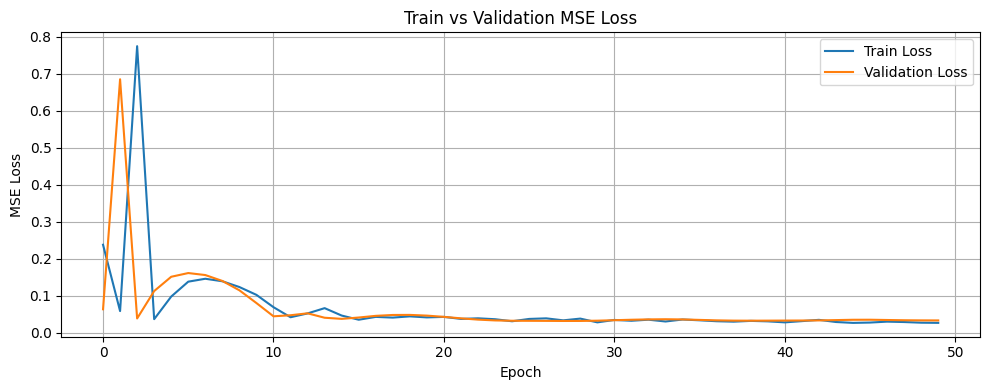

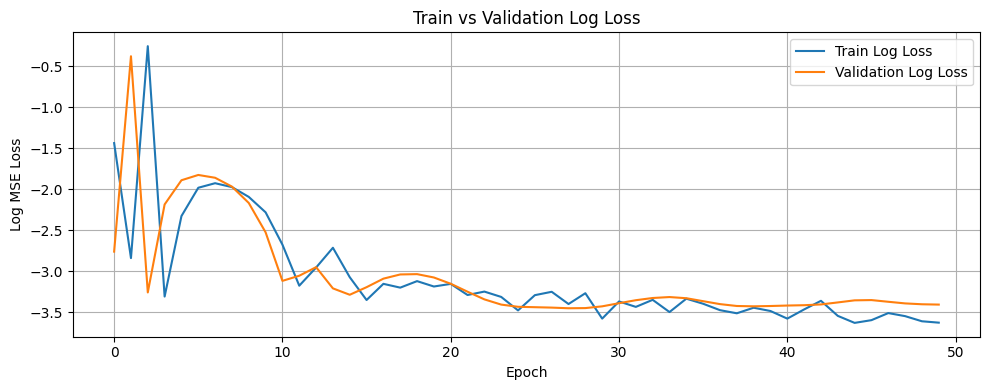

Training completed

=== Processing group: ('04 TO 06', 'HOUGANG', '4 ROOM') ===
Group size: 35 rows
Calling prepare_lstm_data for ('04 TO 06', 'HOUGANG', '4 ROOM')

Filtering for: HOUGANG, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 1126
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 38
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2193, Val Loss: 0.0432, Train R²: -3.5185, Val R²: -0.2968
Best model saved!
Epoch 2/50, Train Loss: 0.0469, Val Loss: 0.0359, Train R²: 0.0347, Val R²: -0.0776
Best model saved!
Epoch 3/50, Train Loss: 0.0572, Val Loss: 0.1713, Train R²: -0.1791, Val R²: -4.1394
Epoch 4/50, Train Loss: 0.0924, Val Loss: 0.0790, Train R²: -0.9037, Val 

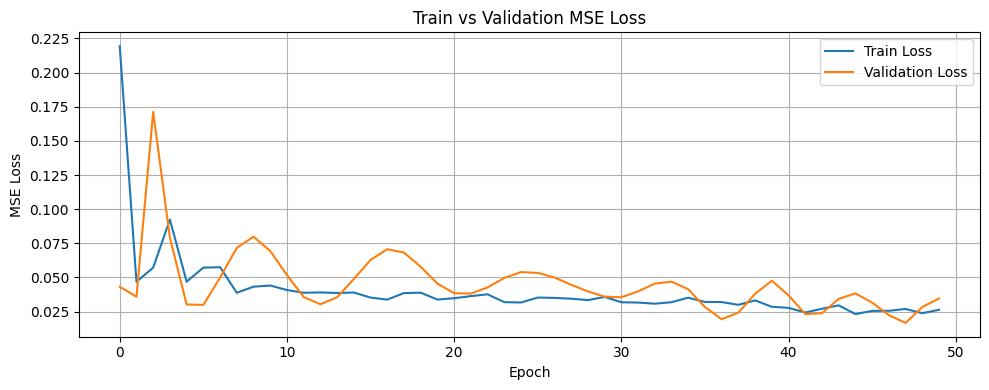

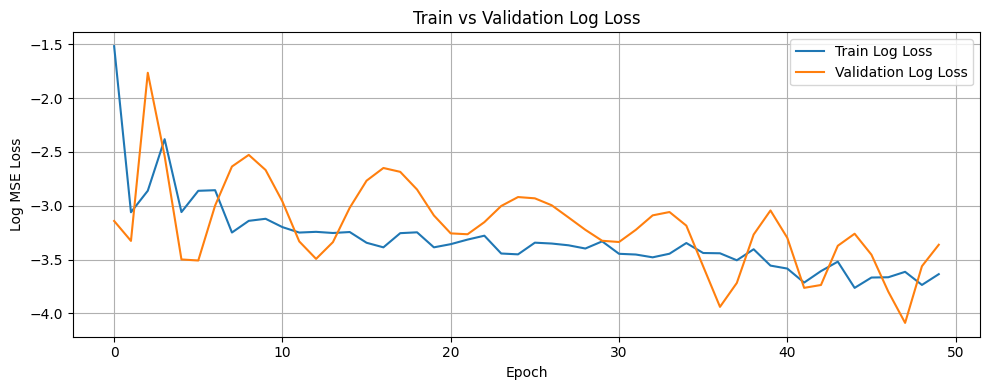

Training completed

=== Processing group: ('04 TO 06', 'HOUGANG', '5 ROOM') ===
Group size: 6 rows
Calling prepare_lstm_data for ('04 TO 06', 'HOUGANG', '5 ROOM')

Filtering for: HOUGANG, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 471
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 39
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.0945, Val Loss: 0.0640, Train R²: -1.9444, Val R²: -0.0622
Best model saved!
Epoch 2/50, Train Loss: 0.0323, Val Loss: 0.0700, Train R²: -0.0047, Val R²: -0.1617
Epoch 3/50, Train Loss: 0.0314, Val Loss: 0.0719, Train R²: 0.0202, Val R²: -0.1929
Epoch 4/50, Train Loss: 0.0300, Val Loss: 0.0618, Train R²: 0.0662, Val R²: -0.0251
Best mode

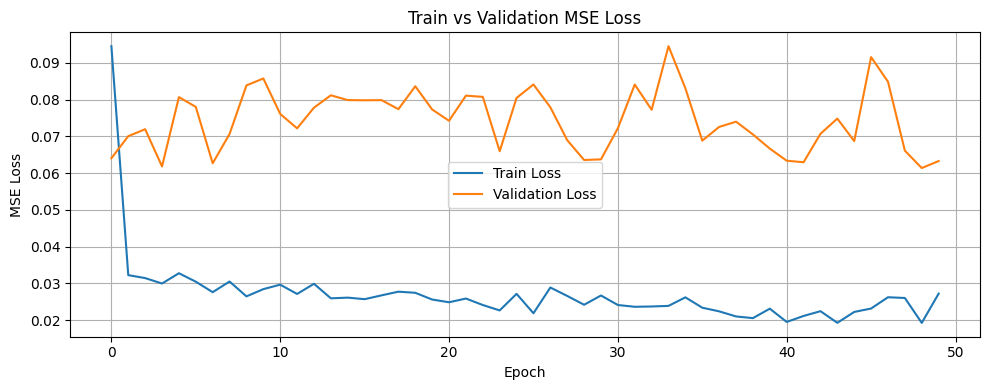

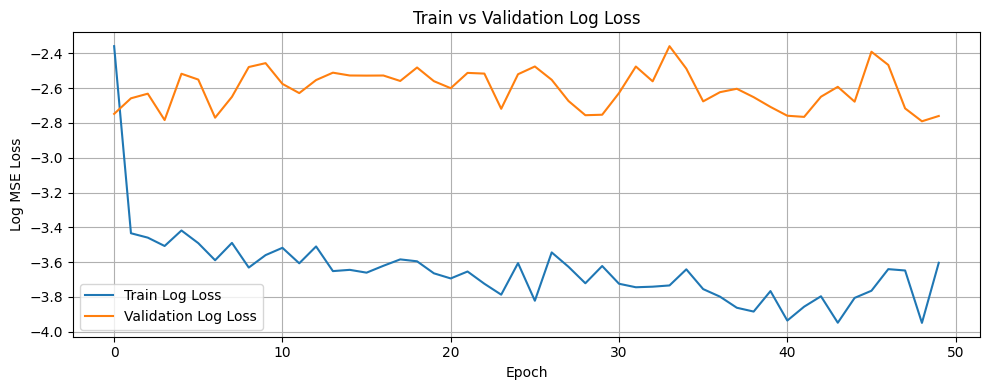

Training completed

=== Processing group: ('04 TO 06', 'HOUGANG', 'EXECUTIVE') ===
Group size: 5 rows
Calling prepare_lstm_data for ('04 TO 06', 'HOUGANG', 'EXECUTIVE')

Filtering for: HOUGANG, EXECUTIVE, 04 TO 06, around 2025-01-01
Initial strict match count: 312
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 36
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2234, Val Loss: 0.0486, Train R²: -4.8505, Val R²: -0.3637
Best model saved!
Epoch 2/50, Train Loss: 0.0452, Val Loss: 0.8752, Train R²: -0.1837, Val R²: -23.5479
Epoch 3/50, Train Loss: 1.0033, Val Loss: 0.0472, Train R²: -25.2792, Val R²: -0.3234
Best model saved!
Epoch 4/50, Train Loss: 0.0393, Val Loss: 0.1493, Train R²: -0.

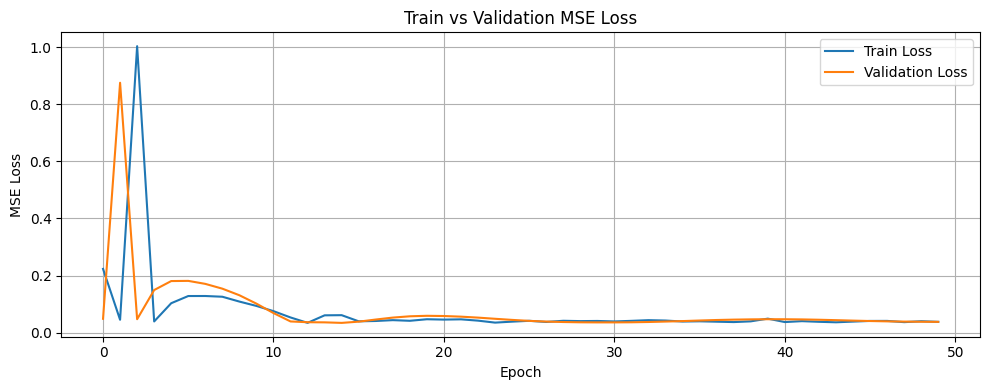

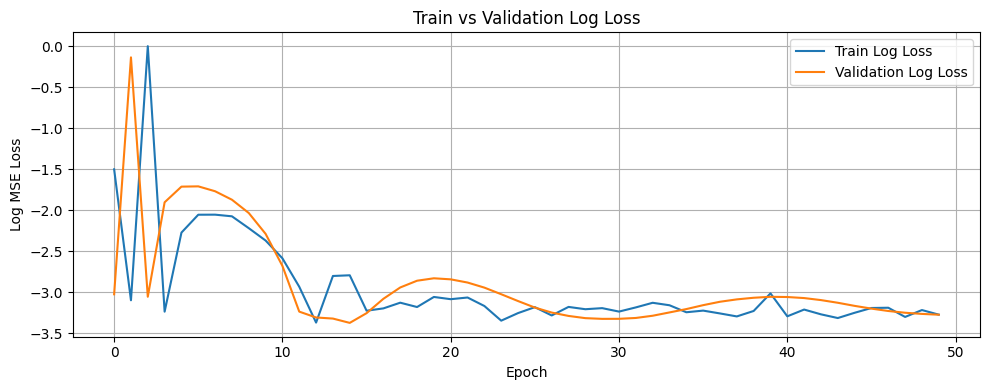

Training completed

=== Processing group: ('04 TO 06', 'JURONG EAST', '3 ROOM') ===
Group size: 12 rows
Calling prepare_lstm_data for ('04 TO 06', 'JURONG EAST', '3 ROOM')

Filtering for: JURONG EAST, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 394
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 26
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1701, Val Loss: 0.0208, Train R²: -2.7036, Val R²: -0.1073
Best model saved!
Epoch 2/50, Train Loss: 0.0486, Val Loss: 0.9594, Train R²: -0.0587, Val R²: -50.1045
Epoch 3/50, Train Loss: 0.9313, Val Loss: 0.0232, Train R²: -19.2836, Val R²: -0.2377
Epoch 4/50, Train Loss: 0.0487, Val Loss: 0.0417, Train R²: -0.0605, Val R²: 

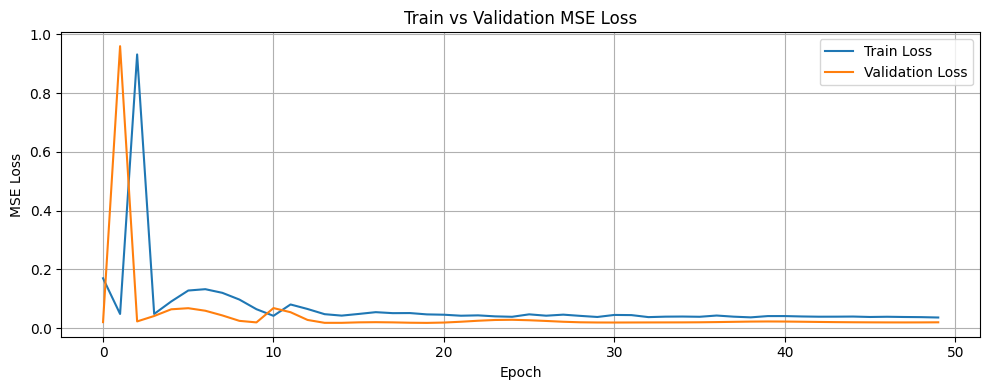

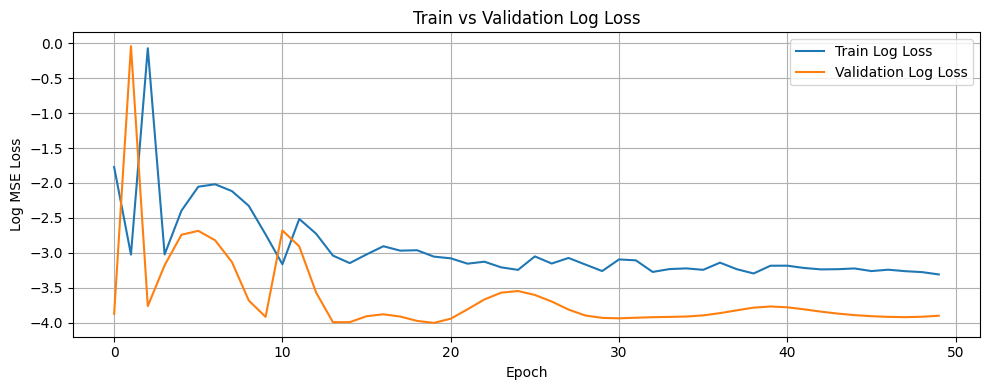

Training completed

=== Processing group: ('04 TO 06', 'JURONG EAST', '4 ROOM') ===
Group size: 10 rows
Calling prepare_lstm_data for ('04 TO 06', 'JURONG EAST', '4 ROOM')

Filtering for: JURONG EAST, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 307
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 38
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2452, Val Loss: 0.0742, Train R²: -4.8689, Val R²: -8.6181
Best model saved!
Epoch 2/50, Train Loss: 0.1161, Val Loss: 0.3648, Train R²: -1.7776, Val R²: -46.2648
Epoch 3/50, Train Loss: 0.3526, Val Loss: 0.0282, Train R²: -7.4389, Val R²: -2.6506
Best model saved!
Epoch 4/50, Train Loss: 0.0690, Val Loss: 0.0968, Train R²: 

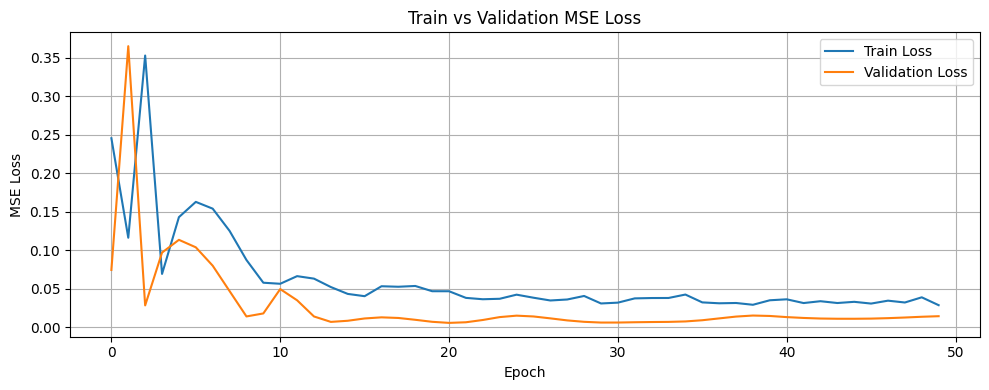

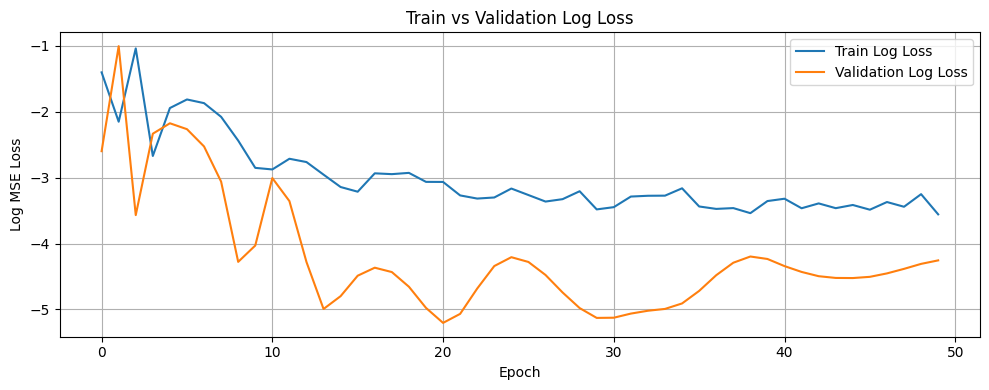

Training completed

=== Processing group: ('04 TO 06', 'JURONG EAST', '5 ROOM') ===
Group size: 3 rows
Calling prepare_lstm_data for ('04 TO 06', 'JURONG EAST', '5 ROOM')

Filtering for: JURONG EAST, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 186
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2757, Val Loss: 0.0449, Train R²: -3.4821, Val R²: -1.9301
Best model saved!
Epoch 2/50, Train Loss: 0.1110, Val Loss: 0.2441, Train R²: -0.8043, Val R²: -14.9369
Epoch 3/50, Train Loss: 0.2575, Val Loss: 0.0210, Train R²: -3.1857, Val R²: -0.3687
Best model saved!
Epoch 4/50, Train Loss: 0.0746, Val Loss: 0.0540, Train R²: -

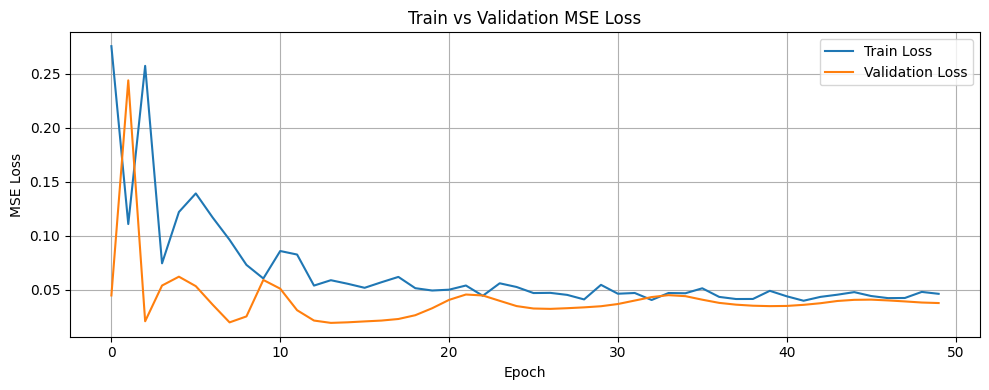

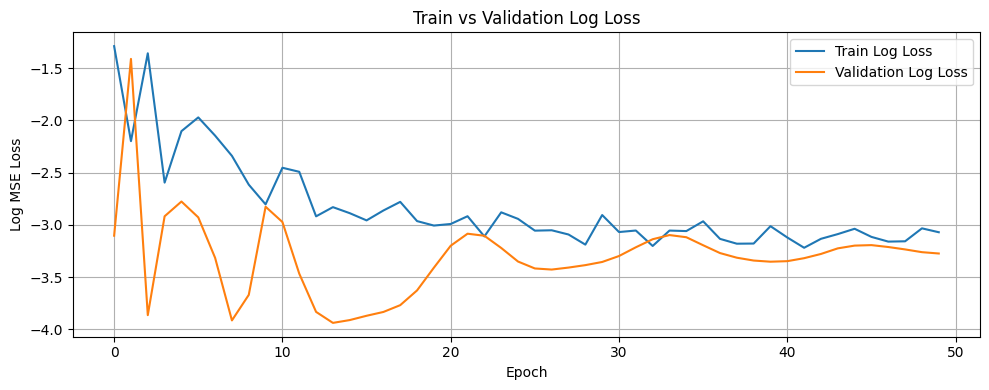

Training completed

=== Processing group: ('04 TO 06', 'JURONG EAST', 'EXECUTIVE') ===
Group size: 3 rows
Calling prepare_lstm_data for ('04 TO 06', 'JURONG EAST', 'EXECUTIVE')

Filtering for: JURONG EAST, EXECUTIVE, 04 TO 06, around 2025-01-01
Initial strict match count: 114
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 39
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2953, Val Loss: 0.2109, Train R²: -3.8985, Val R²: -5.4373
Best model saved!
Epoch 2/50, Train Loss: 0.1339, Val Loss: 0.1550, Train R²: -1.2221, Val R²: -3.7288
Best model saved!
Epoch 3/50, Train Loss: 0.3138, Val Loss: 0.1241, Train R²: -4.2063, Val R²: -2.7867
Best model saved!
Epoch 4/50, Train Loss: 0.0805, Val

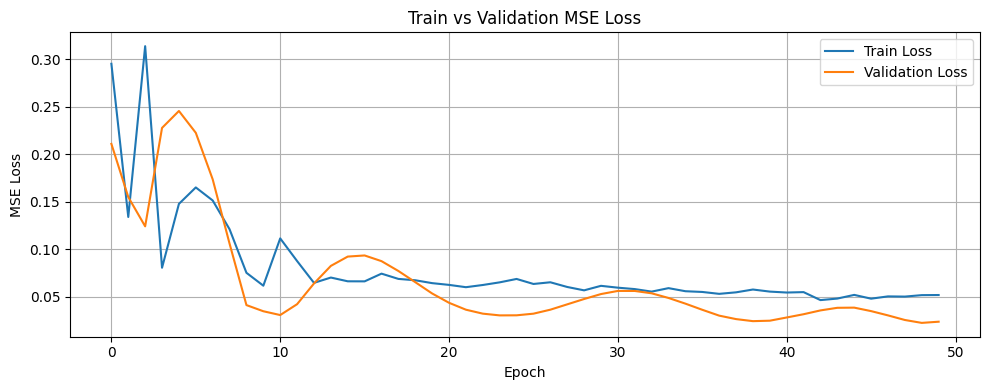

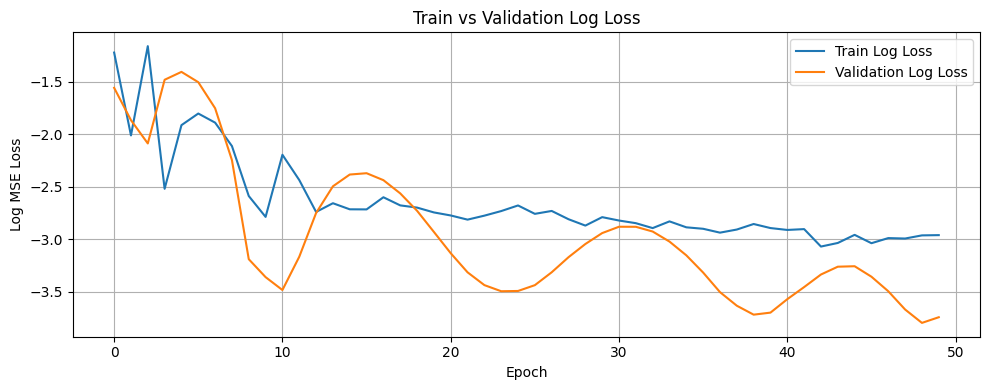

Training completed

=== Processing group: ('04 TO 06', 'JURONG WEST', '2 ROOM') ===
Group size: 3 rows
Calling prepare_lstm_data for ('04 TO 06', 'JURONG WEST', '2 ROOM')

Filtering for: JURONG WEST, 2 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 45
Using before_or_at_target with 43 records.
Removing 'block' column from dataset
Data shapes - x_train: (42, 9), y_train: (42,)
Flattened y shape: (42,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 33, Val: 9
Creating PyTorch datasets...
Dataset sizes - Train: 33, Val: 9
Using batch sizes - Train: 33, Val: 9
Starting model training...
Epoch 1/50, Train Loss: 0.1936, Val Loss: 0.1438, Train R²: -2.1240, Val R²: -0.2632
Best model saved!
Epoch 2/50, Train Loss: 0.0658, Val Loss: 0.3123, Train R²: -0.0614, Val R²: -1.7437
Epoch 3/50, Train Loss: 0.3874, Val Loss: 0.1228, Train R²: -5.2515, Val R²: -0.0791
Best model saved!
Epoch 4/50, Train Loss: 0.0630, Val Loss: 0.1840, Train R²: -0.016

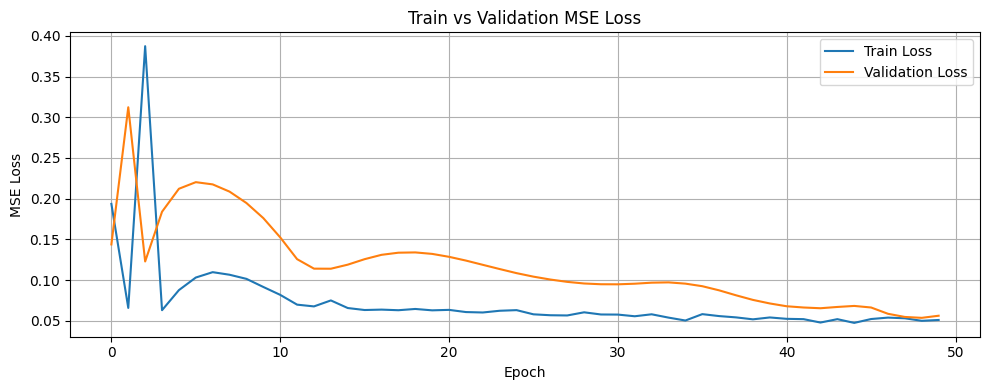

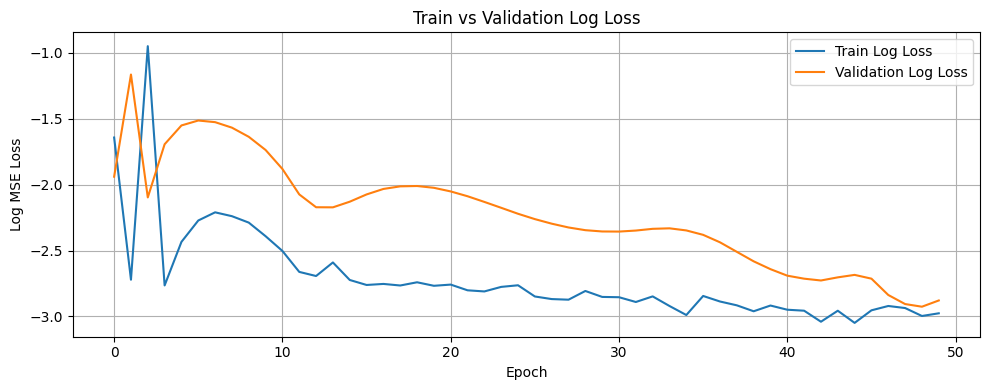

Training completed

=== Processing group: ('04 TO 06', 'JURONG WEST', '3 ROOM') ===
Group size: 18 rows
Calling prepare_lstm_data for ('04 TO 06', 'JURONG WEST', '3 ROOM')

Filtering for: JURONG WEST, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 594
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 40
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1185, Val Loss: 0.1037, Train R²: -1.7300, Val R²: -1.1807
Best model saved!
Epoch 2/50, Train Loss: 0.0394, Val Loss: 0.0953, Train R²: 0.0918, Val R²: -1.0027
Best model saved!
Epoch 3/50, Train Loss: 0.2153, Val Loss: 0.1197, Train R²: -3.9614, Val R²: -1.5163
Epoch 4/50, Train Loss: 0.0435, Val Loss: 0.1917, Train R²: -0

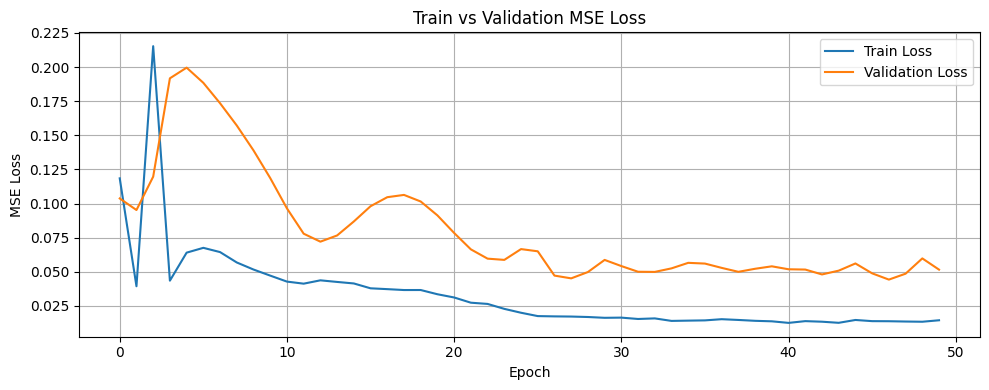

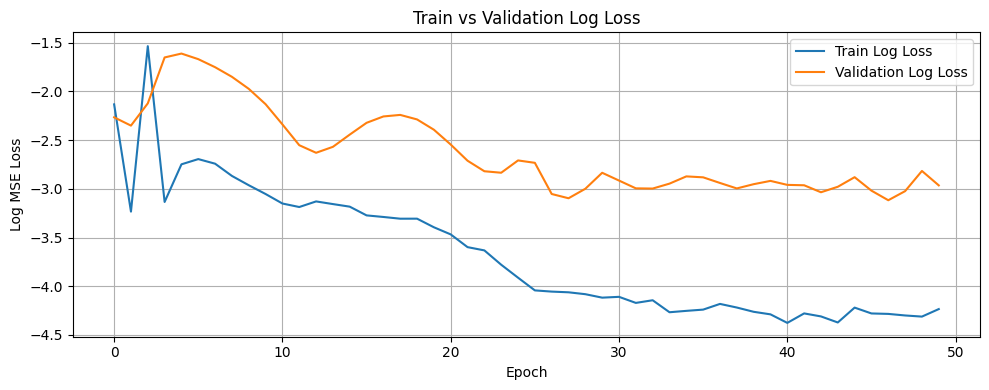

Training completed

=== Processing group: ('04 TO 06', 'JURONG WEST', '4 ROOM') ===
Group size: 27 rows
Calling prepare_lstm_data for ('04 TO 06', 'JURONG WEST', '4 ROOM')

Filtering for: JURONG WEST, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 1265
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 32
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1214, Val Loss: 0.0851, Train R²: -2.1921, Val R²: 0.0406
Best model saved!
Epoch 2/50, Train Loss: 0.0561, Val Loss: 0.1685, Train R²: -0.4748, Val R²: -0.8998
Epoch 3/50, Train Loss: 0.0977, Val Loss: 0.1557, Train R²: -1.5674, Val R²: -0.7547
Epoch 4/50, Train Loss: 0.0834, Val Loss: 0.1243, Train R²: -1.1928, Val R²: -0

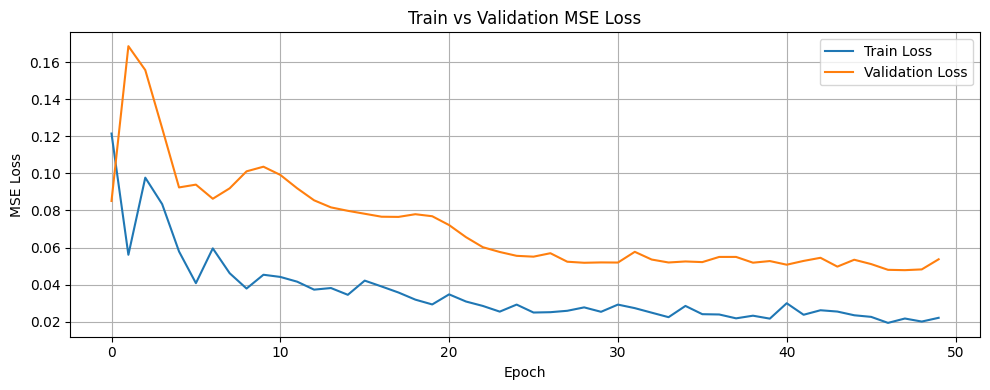

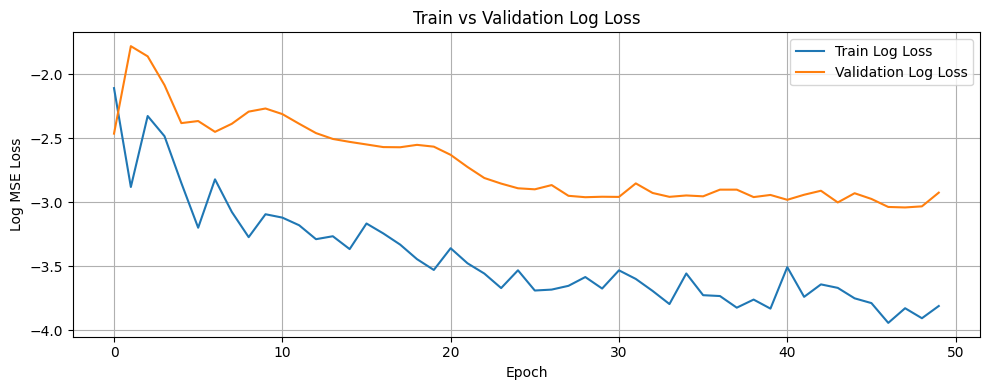

Training completed

=== Processing group: ('04 TO 06', 'JURONG WEST', '5 ROOM') ===
Group size: 21 rows
Calling prepare_lstm_data for ('04 TO 06', 'JURONG WEST', '5 ROOM')

Filtering for: JURONG WEST, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 911
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 38
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1409, Val Loss: 0.0540, Train R²: -1.5752, Val R²: -0.9495
Best model saved!
Epoch 2/50, Train Loss: 0.0673, Val Loss: 0.0281, Train R²: -0.2305, Val R²: -0.0152
Best model saved!
Epoch 3/50, Train Loss: 0.0655, Val Loss: 0.0277, Train R²: -0.1960, Val R²: 0.0012
Best model saved!
Epoch 4/50, Train Loss: 0.0626, Val Loss: 0.

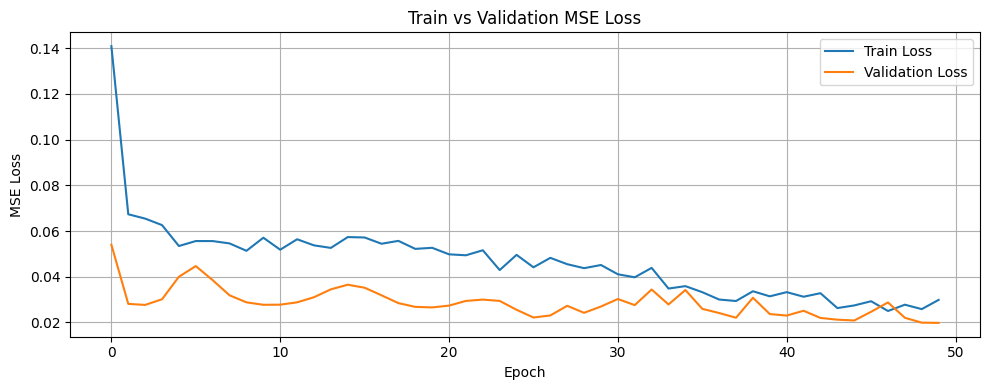

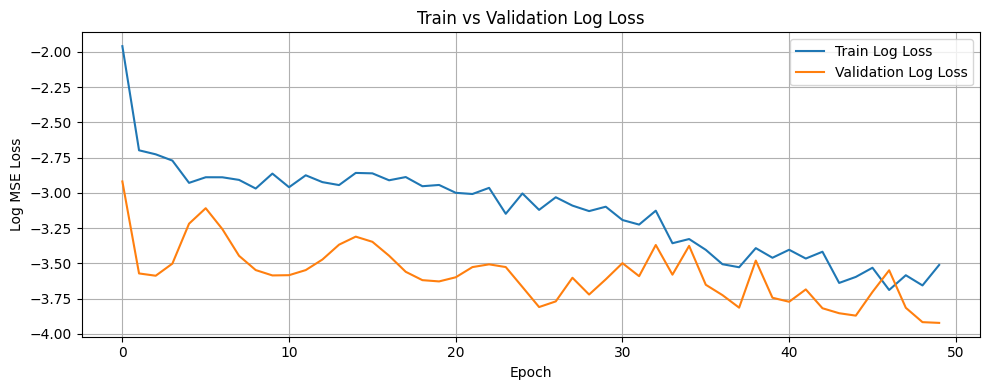

Training completed

=== Processing group: ('04 TO 06', 'JURONG WEST', 'EXECUTIVE') ===
Group size: 3 rows
Calling prepare_lstm_data for ('04 TO 06', 'JURONG WEST', 'EXECUTIVE')

Filtering for: JURONG WEST, EXECUTIVE, 04 TO 06, around 2025-01-01
Initial strict match count: 384
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 44
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1991, Val Loss: 0.0206, Train R²: -3.4784, Val R²: -0.2741
Best model saved!
Epoch 2/50, Train Loss: 0.0602, Val Loss: 0.5255, Train R²: -0.3528, Val R²: -31.4312
Epoch 3/50, Train Loss: 0.5109, Val Loss: 0.0150, Train R²: -10.4898, Val R²: 0.0767
Best model saved!
Epoch 4/50, Train Loss: 0.0421, Val Loss: 0.0482, Tr

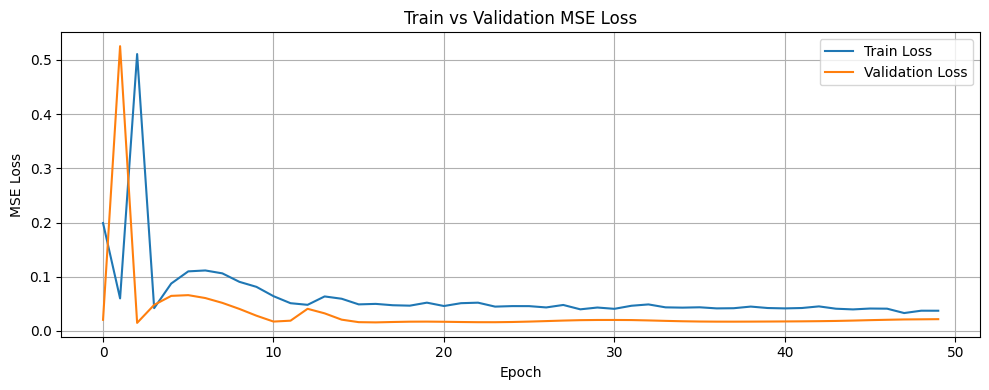

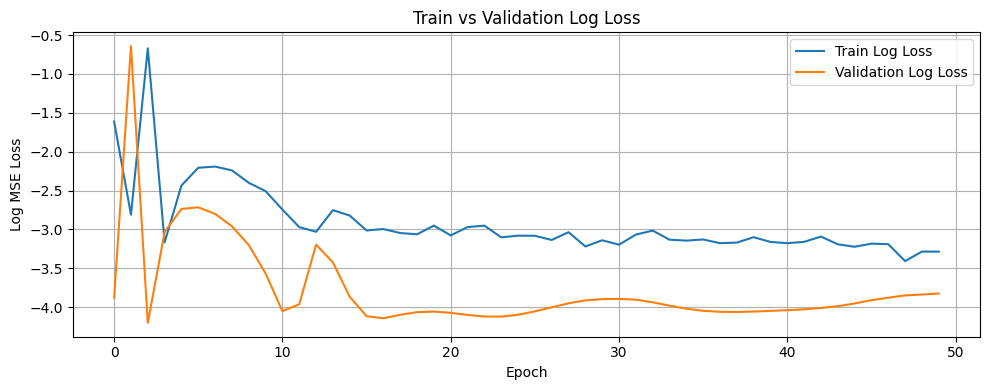

Training completed

=== Processing group: ('04 TO 06', 'KALLANG/WHAMPOA', '2 ROOM') ===
Group size: 3 rows
Calling prepare_lstm_data for ('04 TO 06', 'KALLANG/WHAMPOA', '2 ROOM')

Filtering for: KALLANG/WHAMPOA, 2 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 30
Using before_or_at_target with 27 records.
Removing 'block' column from dataset
Data shapes - x_train: (26, 9), y_train: (26,)
Flattened y shape: (26,), Unique values: 21
Using simple train-validation split (80/20).
Split sizes - Train: 20, Val: 6
Creating PyTorch datasets...
Dataset sizes - Train: 20, Val: 6
Using batch sizes - Train: 20, Val: 6
Starting model training...
Epoch 1/50, Train Loss: 0.2444, Val Loss: 0.1007, Train R²: -1.9371, Val R²: 0.0080
Best model saved!
Epoch 2/50, Train Loss: 0.1019, Val Loss: 1.4459, Train R²: -0.2248, Val R²: -13.2459
Epoch 3/50, Train Loss: 1.1324, Val Loss: 0.1072, Train R²: -12.6111, Val R²: -0.0563
Epoch 4/50, Train Loss: 0.0952, Val Loss: 0.1331, Train R²: -0.1438, Va

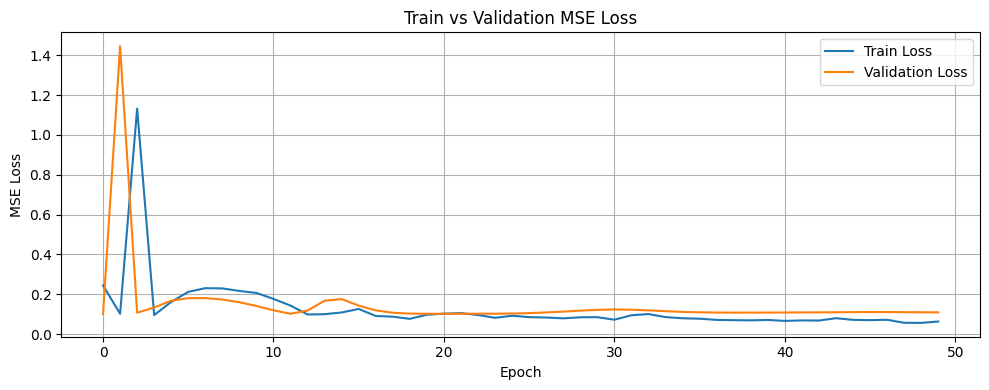

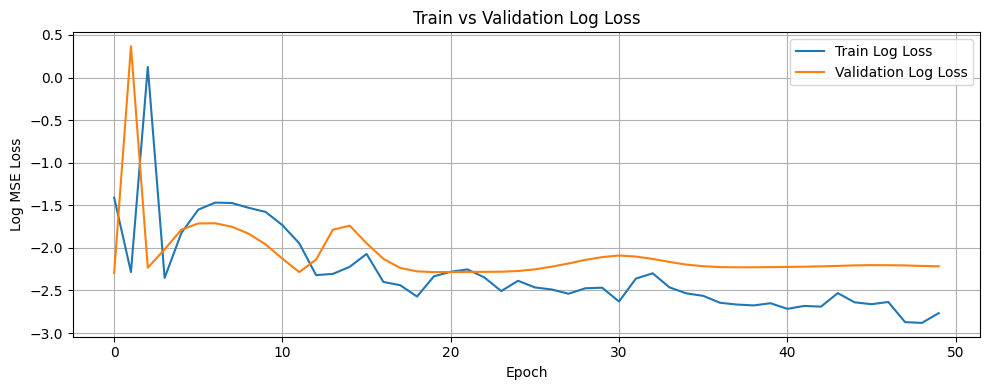

Error processing group ('04 TO 06', 'KALLANG/WHAMPOA', '2 ROOM'): [Errno 2] No such file or directory: '/content/saved_models/04_TO_06_KALLANG/WHAMPOA_2_ROOM_bundle.pkl'

=== Processing group: ('04 TO 06', 'KALLANG/WHAMPOA', '3 ROOM') ===
Group size: 15 rows
Calling prepare_lstm_data for ('04 TO 06', 'KALLANG/WHAMPOA', '3 ROOM')

Filtering for: KALLANG/WHAMPOA, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 617
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1199, Val Loss: 0.0326, Train R²: -1.2973, Val R²: -2.2919
Best model saved!
Epoch 2/50, Train Loss: 0.0703, Val Loss: 0.1854, Train R²: -0.3480, Val R²: -17.6976


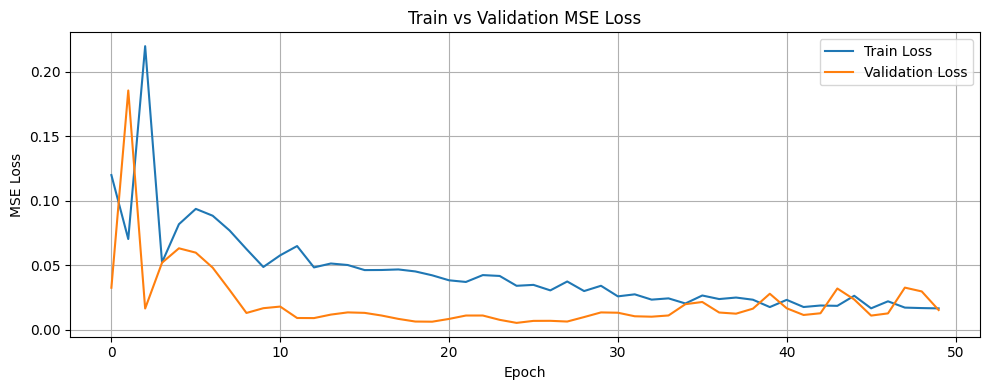

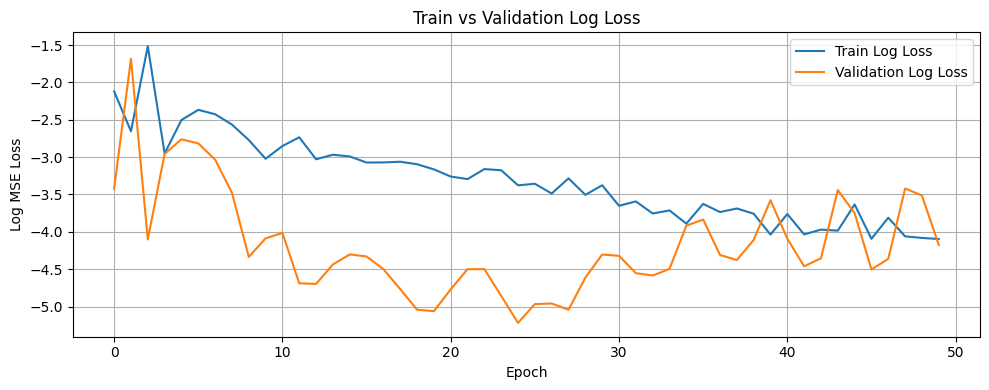

Error processing group ('04 TO 06', 'KALLANG/WHAMPOA', '3 ROOM'): [Errno 2] No such file or directory: '/content/saved_models/04_TO_06_KALLANG/WHAMPOA_3_ROOM_bundle.pkl'

=== Processing group: ('04 TO 06', 'KALLANG/WHAMPOA', '4 ROOM') ===
Group size: 14 rows
Calling prepare_lstm_data for ('04 TO 06', 'KALLANG/WHAMPOA', '4 ROOM')

Filtering for: KALLANG/WHAMPOA, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 380
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 42
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1660, Val Loss: 0.0911, Train R²: -1.0802, Val R²: 0.0195
Best model saved!
Epoch 2/50, Train Loss: 0.0845, Val Loss: 0.1607, Train R²: -0.0590, Val R²: -0.7288
Ep

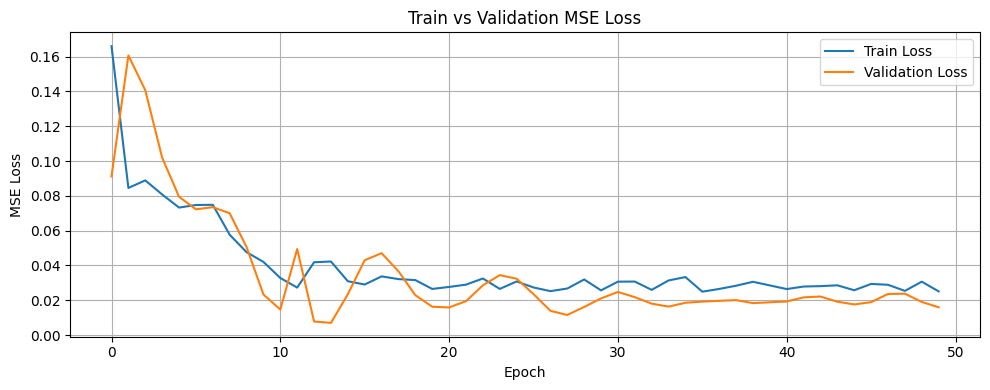

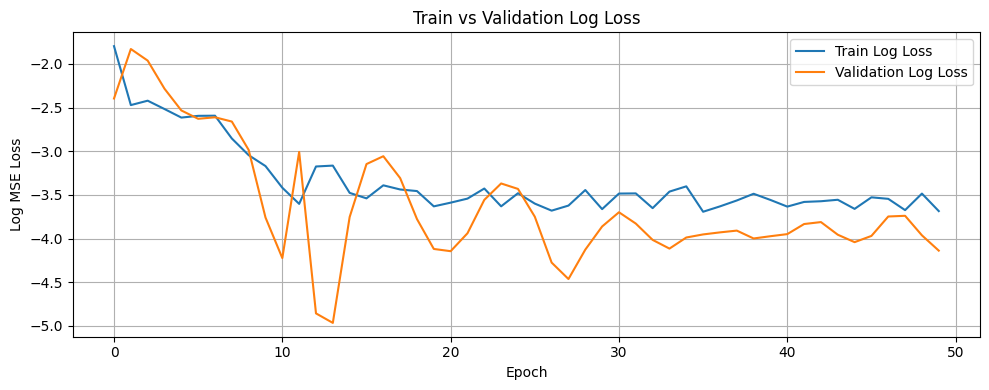

Error processing group ('04 TO 06', 'KALLANG/WHAMPOA', '4 ROOM'): [Errno 2] No such file or directory: '/content/saved_models/04_TO_06_KALLANG/WHAMPOA_4_ROOM_bundle.pkl'

=== Processing group: ('04 TO 06', 'KALLANG/WHAMPOA', '5 ROOM') ===
Group size: 4 rows
Calling prepare_lstm_data for ('04 TO 06', 'KALLANG/WHAMPOA', '5 ROOM')

Filtering for: KALLANG/WHAMPOA, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 154
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 40
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1874, Val Loss: 0.0614, Train R²: -2.9632, Val R²: -0.1134
Best model saved!
Epoch 2/50, Train Loss: 0.0474, Val Loss: 0.8627, Train R²: -0.0030, Val R²: -14.6408
E

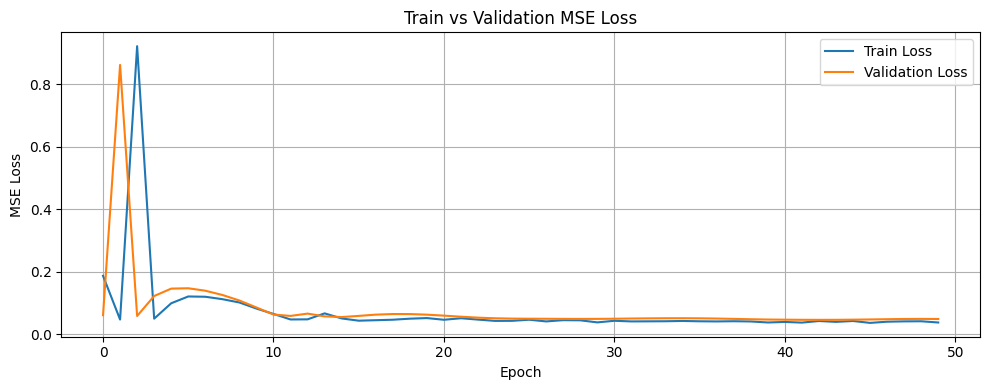

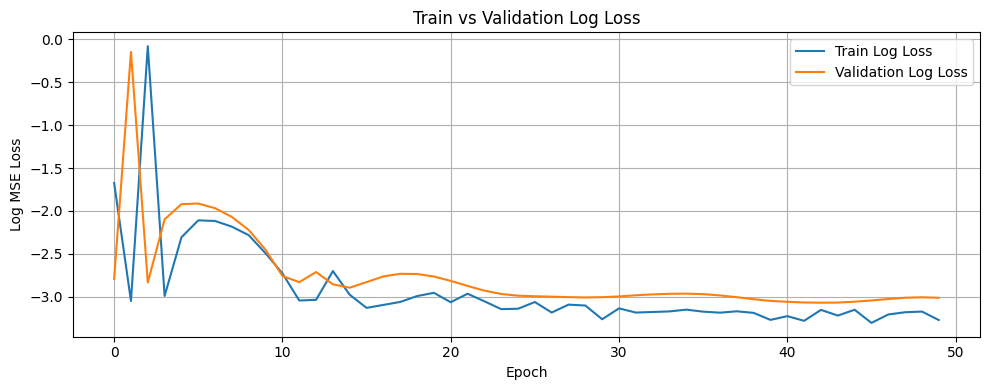

Error processing group ('04 TO 06', 'KALLANG/WHAMPOA', '5 ROOM'): [Errno 2] No such file or directory: '/content/saved_models/04_TO_06_KALLANG/WHAMPOA_5_ROOM_bundle.pkl'

=== Processing group: ('04 TO 06', 'MARINE PARADE', '3 ROOM') ===
Group size: 5 rows
Calling prepare_lstm_data for ('04 TO 06', 'MARINE PARADE', '3 ROOM')

Filtering for: MARINE PARADE, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 151
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 38
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1944, Val Loss: 0.0920, Train R²: -4.0215, Val R²: -0.7615
Best model saved!
Epoch 2/50, Train Loss: 0.0521, Val Loss: 0.5343, Train R²: -0.3454, Val R²: -9.2328
Epoch 3/

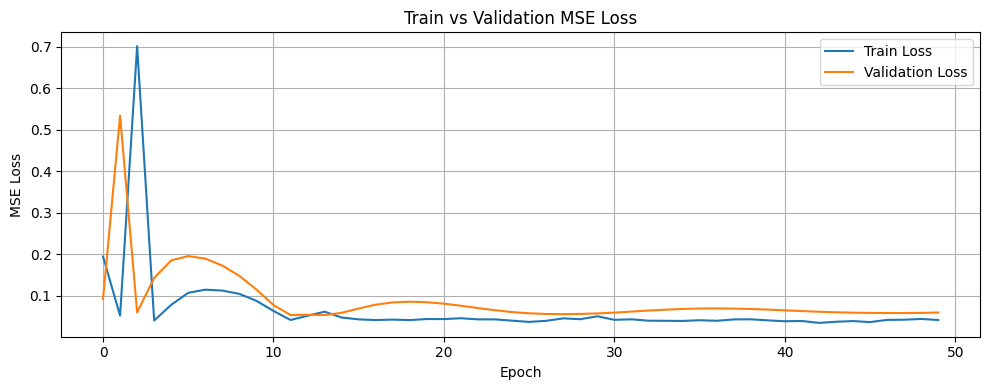

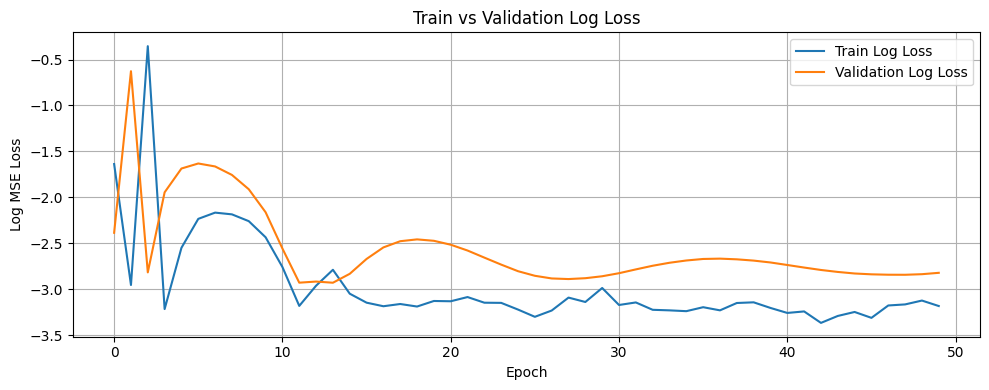

Training completed

=== Processing group: ('04 TO 06', 'MARINE PARADE', '4 ROOM') ===
Group size: 2 rows
Calling prepare_lstm_data for ('04 TO 06', 'MARINE PARADE', '4 ROOM')

Filtering for: MARINE PARADE, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 68
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1048, Val Loss: 0.0833, Train R²: -1.5938, Val R²: -0.0772
Best model saved!
Epoch 2/50, Train Loss: 0.0569, Val Loss: 0.0862, Train R²: -0.4070, Val R²: -0.1153
Epoch 3/50, Train Loss: 0.0423, Val Loss: 0.0880, Train R²: -0.0466, Val R²: -0.1388
Epoch 4/50, Train Loss: 0.0456, Val Loss: 0.0818, Train R²: -0.1272, Val R²

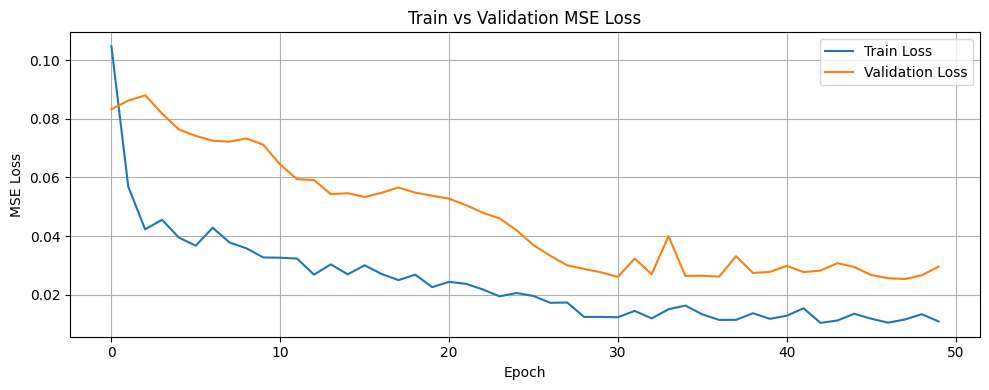

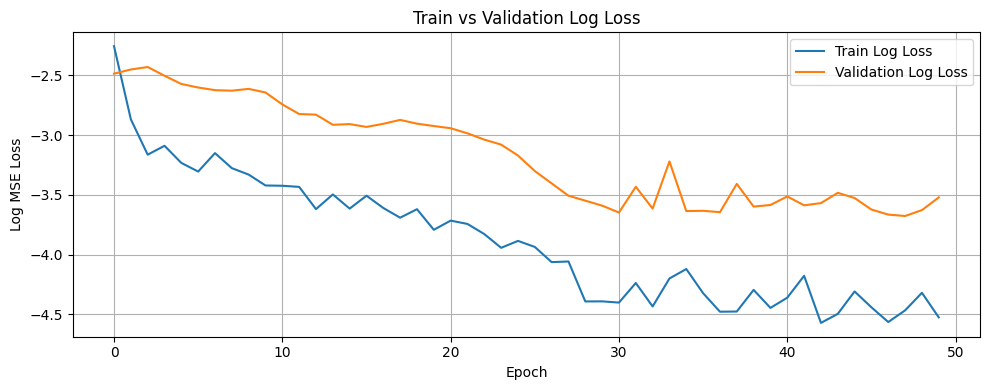

Training completed

=== Processing group: ('04 TO 06', 'MARINE PARADE', '5 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('04 TO 06', 'MARINE PARADE', '5 ROOM')

Filtering for: MARINE PARADE, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 48
Using before_or_at_target with 47 records.
Removing 'block' column from dataset
Data shapes - x_train: (46, 9), y_train: (46,)
Flattened y shape: (46,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 36, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 36, Val: 10
Using batch sizes - Train: 36, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1426, Val Loss: 0.0234, Train R²: -2.5948, Val R²: -0.0529
Best model saved!
Epoch 2/50, Train Loss: 0.0448, Val Loss: 0.6636, Train R²: -0.1283, Val R²: -28.8298
Epoch 3/50, Train Loss: 0.6195, Val Loss: 0.0330, Train R²: -14.6160, Val R²: -0.4824
Epoch 4/50, Train Loss: 0.0404, Val Loss: 0.0305, Train R²: -0.0196, Val 

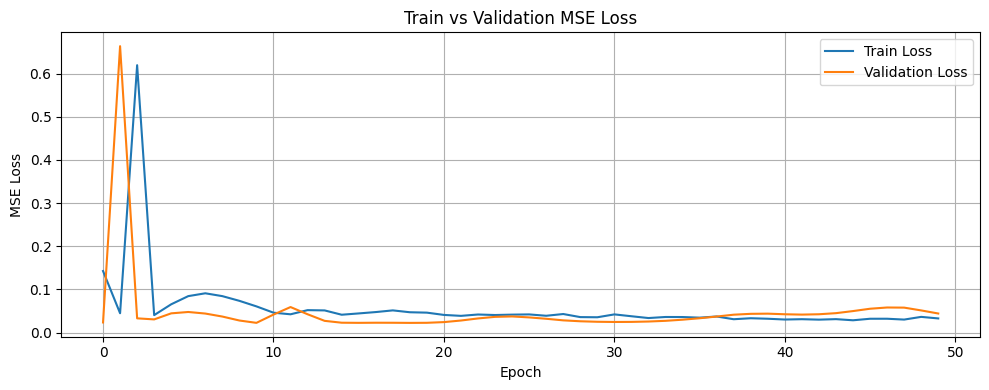

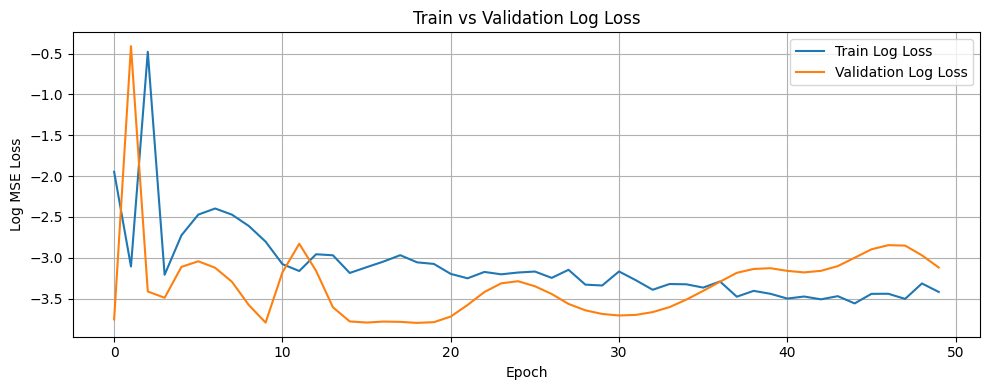

Training completed

=== Processing group: ('04 TO 06', 'PASIR RIS', '3 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('04 TO 06', 'PASIR RIS', '3 ROOM')

Filtering for: PASIR RIS, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 50
Using before_or_at_target with 49 records.
Removing 'block' column from dataset
Data shapes - x_train: (48, 9), y_train: (48,)
Flattened y shape: (48,), Unique values: 39
Using simple train-validation split (80/20).
Split sizes - Train: 38, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 38, Val: 10
Using batch sizes - Train: 38, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2554, Val Loss: 0.0452, Train R²: -2.4360, Val R²: -0.0353
Best model saved!
Epoch 2/50, Train Loss: 0.0912, Val Loss: 0.4184, Train R²: -0.2277, Val R²: -8.5894
Epoch 3/50, Train Loss: 0.3988, Val Loss: 0.0384, Train R²: -4.3669, Val R²: 0.1191
Best model saved!
Epoch 4/50, Train Loss: 0.0743, Val Loss: 0.0570, Train R²: -0.0001, V

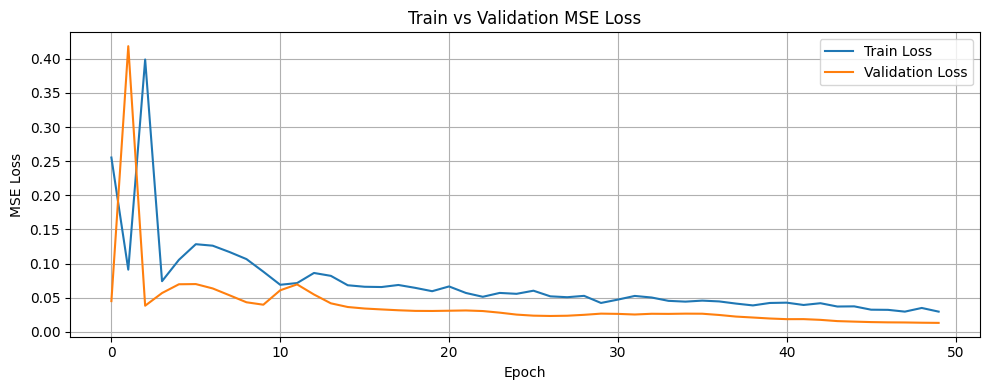

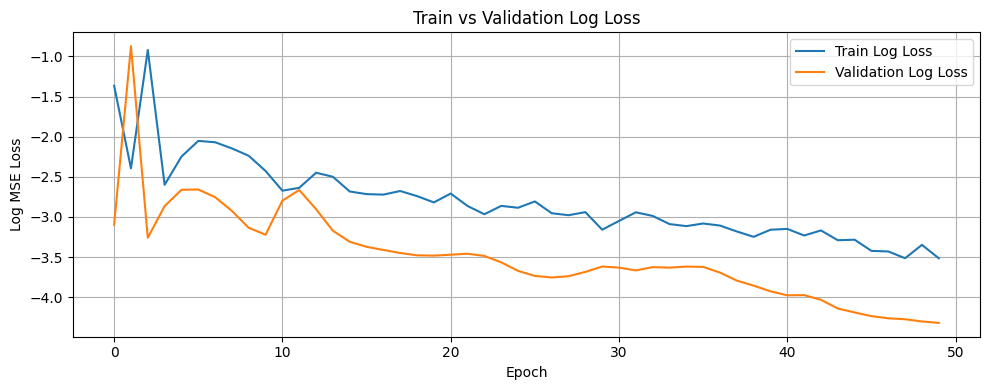

Training completed

=== Processing group: ('04 TO 06', 'PASIR RIS', '4 ROOM') ===
Group size: 10 rows
Calling prepare_lstm_data for ('04 TO 06', 'PASIR RIS', '4 ROOM')

Filtering for: PASIR RIS, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 663
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1362, Val Loss: 0.1154, Train R²: -2.7647, Val R²: -0.7141
Best model saved!
Epoch 2/50, Train Loss: 0.0409, Val Loss: 0.3896, Train R²: -0.1294, Val R²: -4.7875
Epoch 3/50, Train Loss: 0.5689, Val Loss: 0.0872, Train R²: -14.7190, Val R²: -0.2959
Best model saved!
Epoch 4/50, Train Loss: 0.0359, Val Loss: 0.1798, Train R²: 0.0078

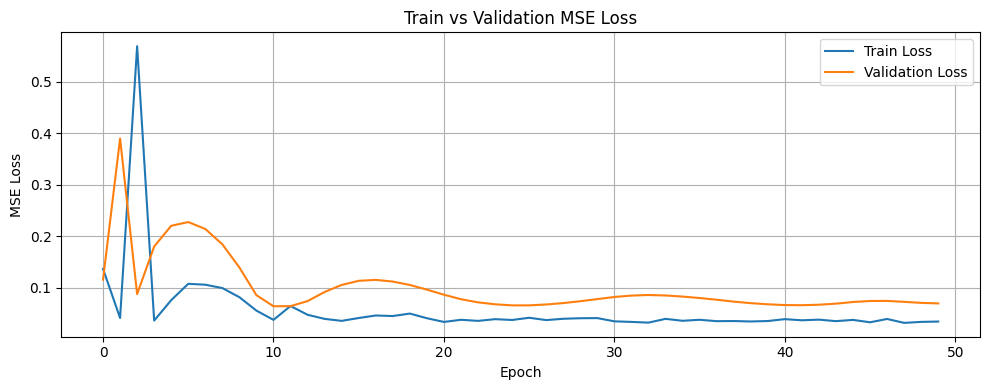

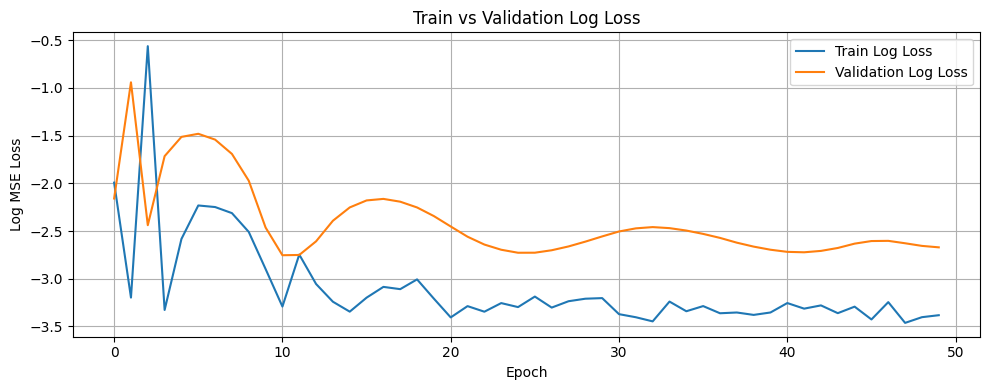

Training completed

=== Processing group: ('04 TO 06', 'PASIR RIS', '5 ROOM') ===
Group size: 7 rows
Calling prepare_lstm_data for ('04 TO 06', 'PASIR RIS', '5 ROOM')

Filtering for: PASIR RIS, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 472
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 31
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1276, Val Loss: 0.0336, Train R²: -1.3899, Val R²: 0.0033
Best model saved!
Epoch 2/50, Train Loss: 0.0553, Val Loss: 0.0341, Train R²: -0.0361, Val R²: -0.0099
Epoch 3/50, Train Loss: 0.0532, Val Loss: 0.0339, Train R²: 0.0040, Val R²: -0.0041
Epoch 4/50, Train Loss: 0.0545, Val Loss: 0.0340, Train R²: -0.0213, Val R²: -0.0075
Epo

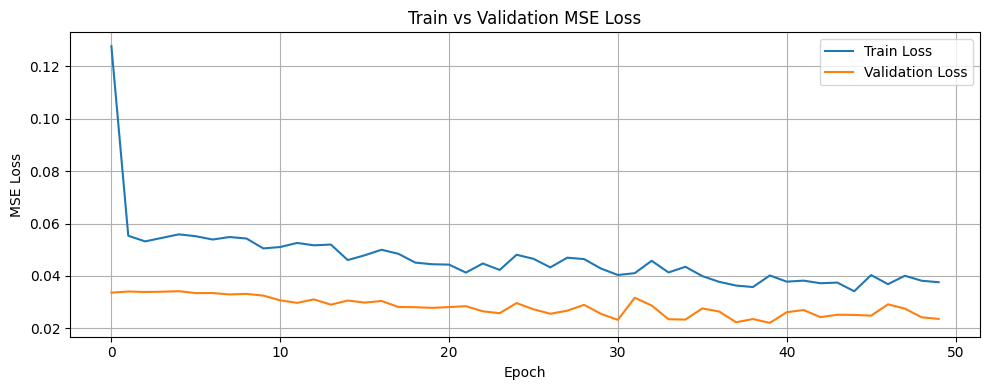

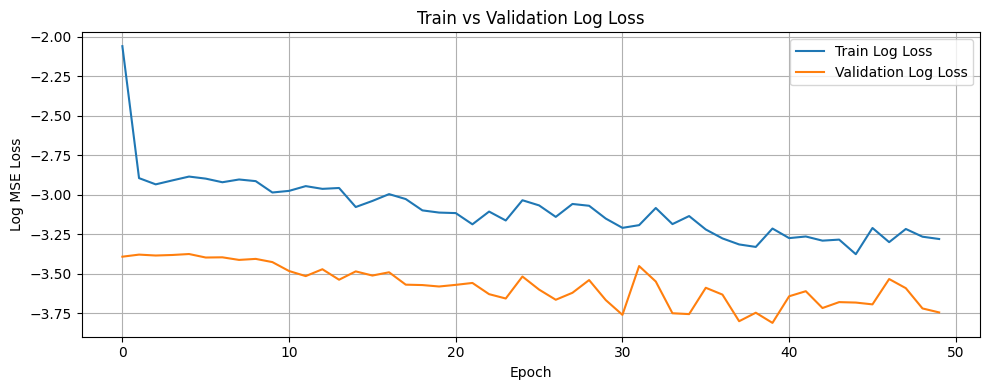

Training completed

=== Processing group: ('04 TO 06', 'PASIR RIS', 'EXECUTIVE') ===
Group size: 8 rows
Calling prepare_lstm_data for ('04 TO 06', 'PASIR RIS', 'EXECUTIVE')

Filtering for: PASIR RIS, EXECUTIVE, 04 TO 06, around 2025-01-01
Initial strict match count: 422
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 35
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1466, Val Loss: 0.0505, Train R²: -2.3642, Val R²: -0.0368
Best model saved!
Epoch 2/50, Train Loss: 0.0516, Val Loss: 0.0721, Train R²: -0.1850, Val R²: -0.4810
Epoch 3/50, Train Loss: 0.0443, Val Loss: 0.0602, Train R²: -0.0169, Val R²: -0.2381
Epoch 4/50, Train Loss: 0.0457, Val Loss: 0.0523, Train R²: -0.0494, Val R²: 

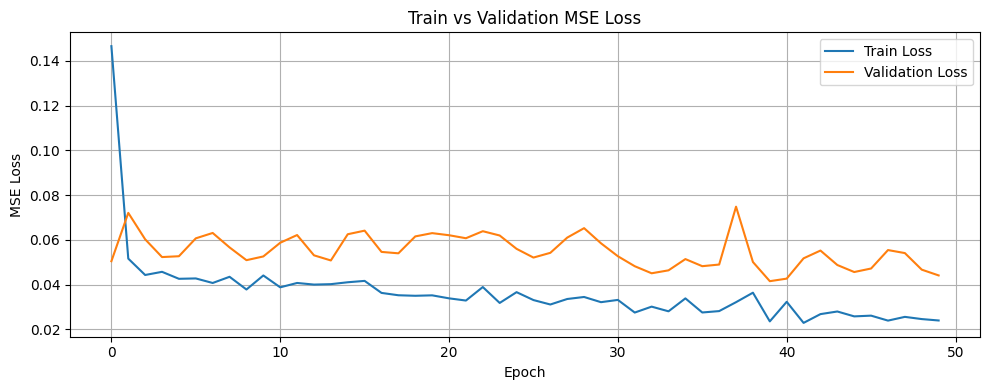

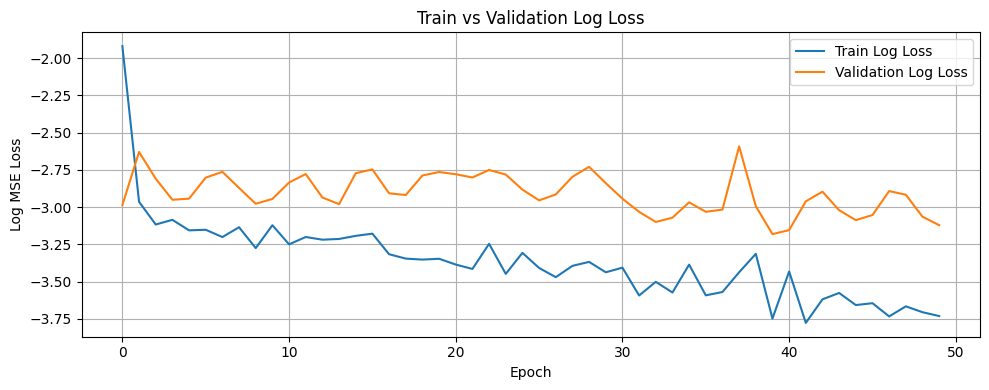

Training completed

=== Processing group: ('04 TO 06', 'PUNGGOL', '2 ROOM') ===
Group size: 2 rows
Calling prepare_lstm_data for ('04 TO 06', 'PUNGGOL', '2 ROOM')

Filtering for: PUNGGOL, 2 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 77
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 30
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2324, Val Loss: 0.1810, Train R²: -3.7446, Val R²: -2.9196
Best model saved!
Epoch 2/50, Train Loss: 0.0914, Val Loss: 0.3338, Train R²: -0.8667, Val R²: -6.2288
Epoch 3/50, Train Loss: 0.5292, Val Loss: 0.1311, Train R²: -9.8059, Val R²: -1.8384
Best model saved!
Epoch 4/50, Train Loss: 0.0680, Val Loss: 0.2561, Train R²: -0.3877, Val R²

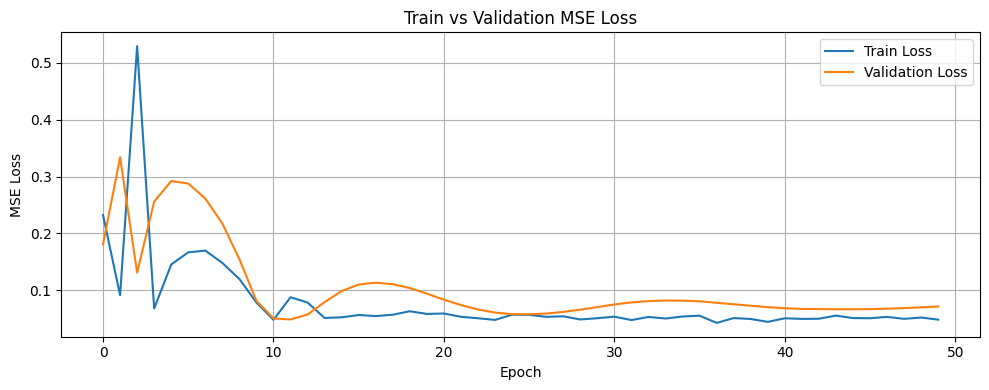

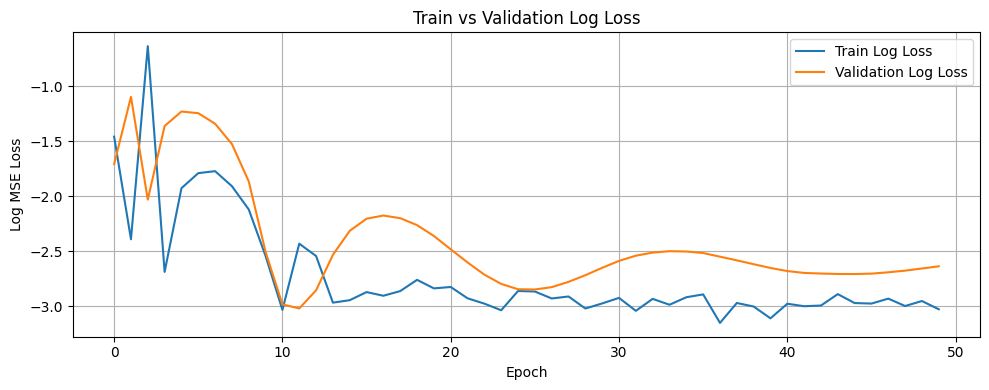

Training completed

=== Processing group: ('04 TO 06', 'PUNGGOL', '3 ROOM') ===
Group size: 5 rows
Calling prepare_lstm_data for ('04 TO 06', 'PUNGGOL', '3 ROOM')

Filtering for: PUNGGOL, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 285
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 30
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3380, Val Loss: 0.2450, Train R²: -4.4533, Val R²: -4.8469
Best model saved!
Epoch 2/50, Train Loss: 0.2101, Val Loss: 0.0561, Train R²: -2.3905, Val R²: -0.3384
Best model saved!
Epoch 3/50, Train Loss: 0.0934, Val Loss: 0.0798, Train R²: -0.5074, Val R²: -0.9049
Epoch 4/50, Train Loss: 0.0805, Val Loss: 0.0722, Train R²: -0.2985, Val R

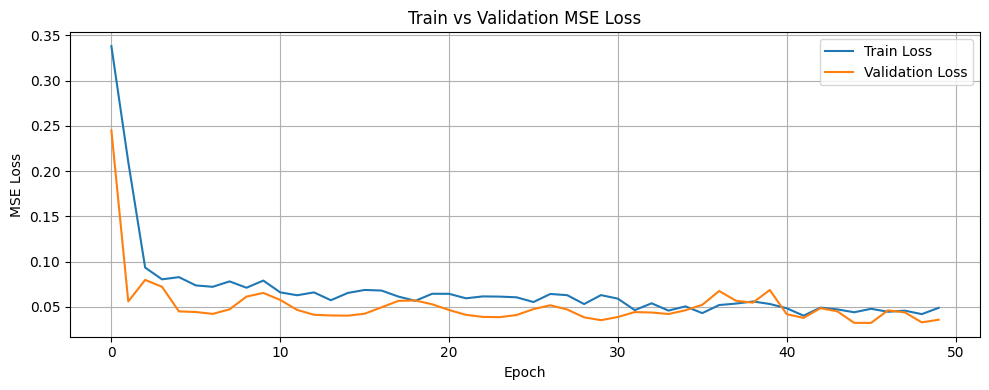

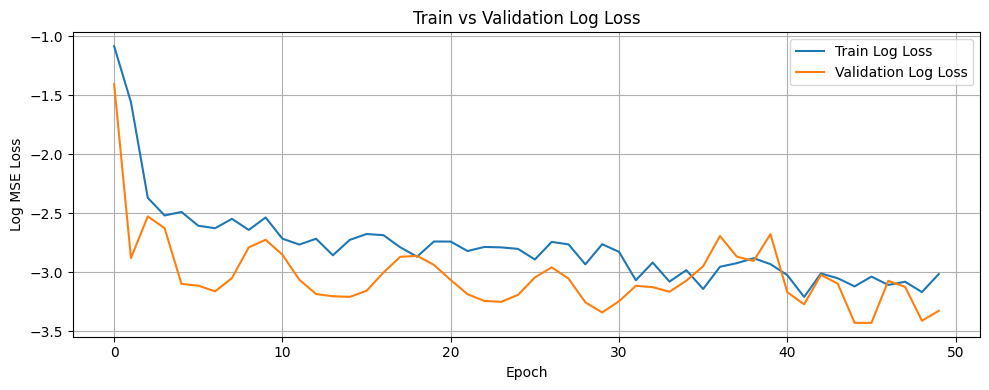

Training completed

=== Processing group: ('04 TO 06', 'PUNGGOL', '4 ROOM') ===
Group size: 27 rows
Calling prepare_lstm_data for ('04 TO 06', 'PUNGGOL', '4 ROOM')

Filtering for: PUNGGOL, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 1472
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 30
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2543, Val Loss: 0.0274, Train R²: -3.8674, Val R²: -0.5919
Best model saved!
Epoch 2/50, Train Loss: 0.0852, Val Loss: 0.6248, Train R²: -0.6313, Val R²: -35.3497
Epoch 3/50, Train Loss: 0.5293, Val Loss: 0.0179, Train R²: -9.1287, Val R²: -0.0418
Best model saved!
Epoch 4/50, Train Loss: 0.0589, Val Loss: 0.0386, Train R²: -0.1280, Va

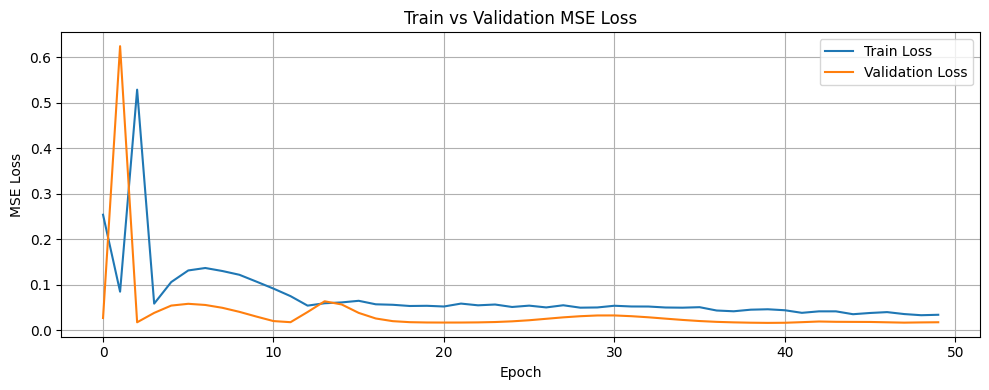

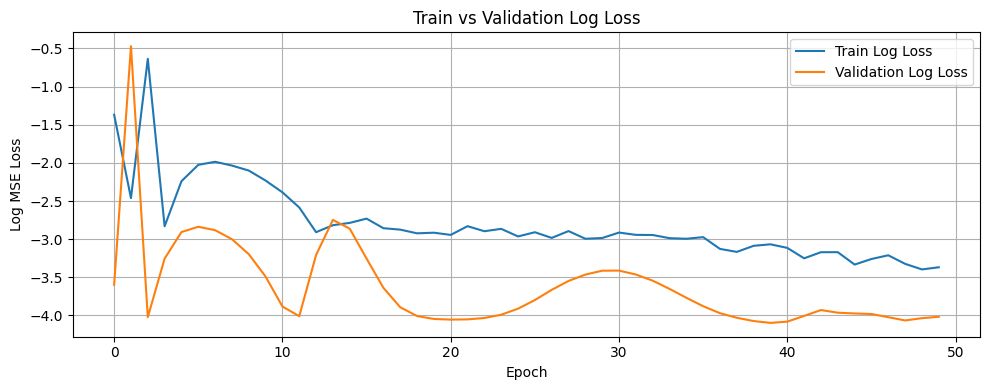

Training completed

=== Processing group: ('04 TO 06', 'PUNGGOL', '5 ROOM') ===
Group size: 16 rows
Calling prepare_lstm_data for ('04 TO 06', 'PUNGGOL', '5 ROOM')

Filtering for: PUNGGOL, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 958
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1466, Val Loss: 0.0593, Train R²: -1.8076, Val R²: -0.0120
Best model saved!
Epoch 2/50, Train Loss: 0.0528, Val Loss: 0.2051, Train R²: -0.0115, Val R²: -2.5011
Epoch 3/50, Train Loss: 0.2462, Val Loss: 0.0599, Train R²: -3.7135, Val R²: -0.0219
Epoch 4/50, Train Loss: 0.0454, Val Loss: 0.1026, Train R²: 0.1302, Val R²: -0.7519
Epoch 5

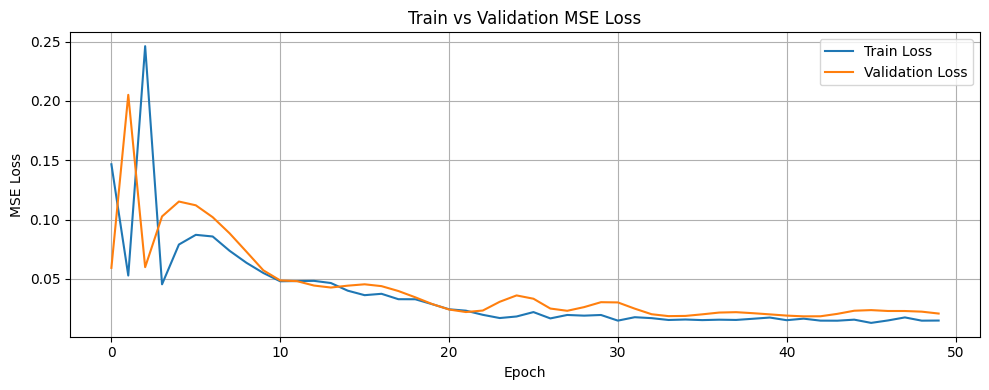

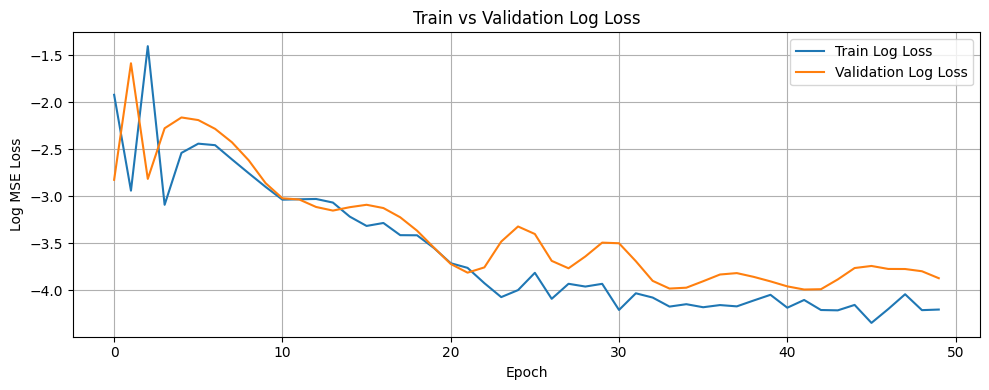

Training completed

=== Processing group: ('04 TO 06', 'QUEENSTOWN', '2 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('04 TO 06', 'QUEENSTOWN', '2 ROOM')

Filtering for: QUEENSTOWN, 2 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 36
Using before_or_at_target with 36 records.
Removing 'block' column from dataset
Data shapes - x_train: (35, 9), y_train: (35,)
Flattened y shape: (35,), Unique values: 26
Using simple train-validation split (80/20).
Split sizes - Train: 28, Val: 7
Creating PyTorch datasets...
Dataset sizes - Train: 28, Val: 7
Using batch sizes - Train: 28, Val: 7
Starting model training...
Epoch 1/50, Train Loss: 0.1846, Val Loss: 0.0448, Train R²: -1.5112, Val R²: -0.1971
Best model saved!
Epoch 2/50, Train Loss: 0.0784, Val Loss: 0.0355, Train R²: -0.0664, Val R²: 0.0504
Best model saved!
Epoch 3/50, Train Loss: 0.0976, Val Loss: 0.1399, Train R²: -0.3274, Val R²: -2.7412
Epoch 4/50, Train Loss: 0.1232, Val Loss: 0.1211, Train R²: -0.6763, V

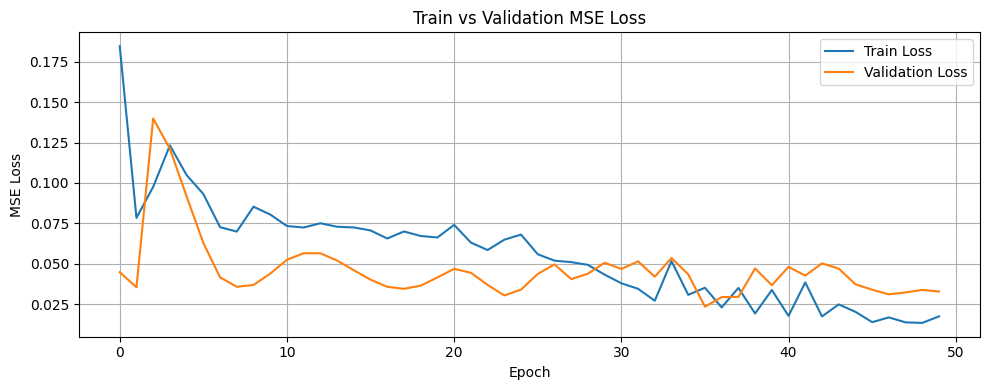

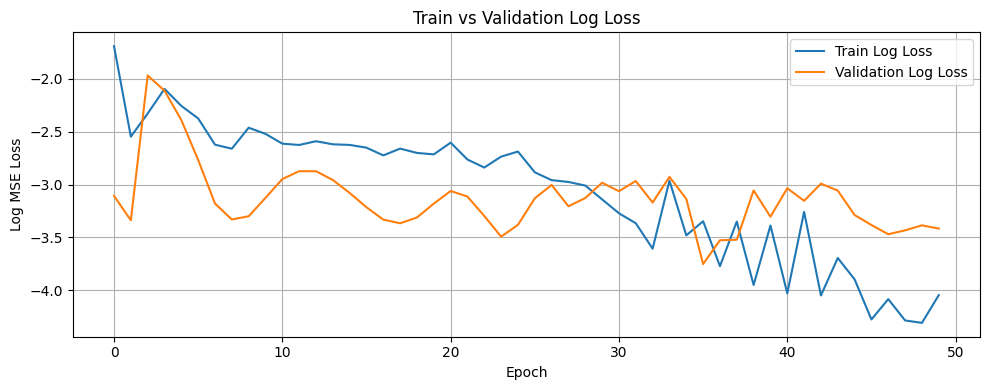

Training completed

=== Processing group: ('04 TO 06', 'QUEENSTOWN', '3 ROOM') ===
Group size: 13 rows
Calling prepare_lstm_data for ('04 TO 06', 'QUEENSTOWN', '3 ROOM')

Filtering for: QUEENSTOWN, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 510
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1053, Val Loss: 0.0707, Train R²: -0.6075, Val R²: 0.0305
Best model saved!
Epoch 2/50, Train Loss: 0.0680, Val Loss: 0.0695, Train R²: -0.0377, Val R²: 0.0472
Best model saved!
Epoch 3/50, Train Loss: 0.0636, Val Loss: 0.0655, Train R²: 0.0288, Val R²: 0.1021
Best model saved!
Epoch 4/50, Train Loss: 0.0643, Val Loss: 0.0574, 

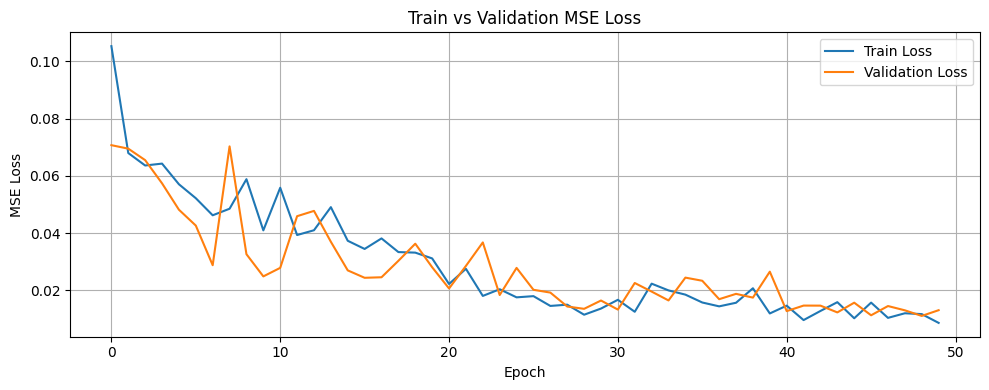

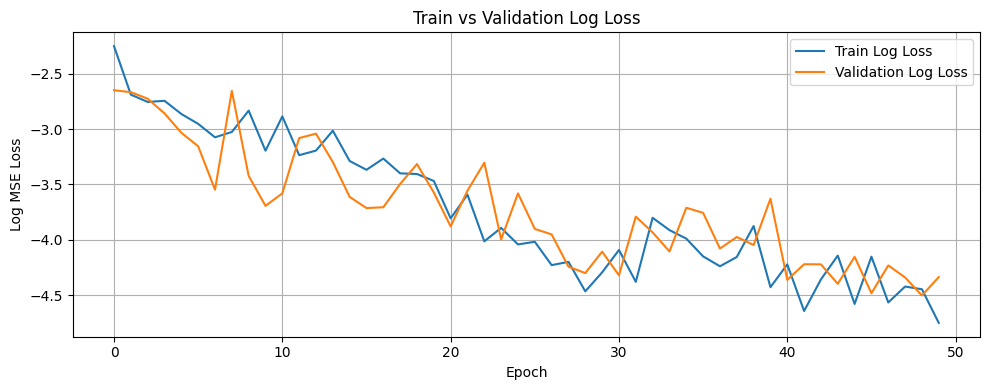

Training completed

=== Processing group: ('04 TO 06', 'QUEENSTOWN', '4 ROOM') ===
Group size: 5 rows
Calling prepare_lstm_data for ('04 TO 06', 'QUEENSTOWN', '4 ROOM')

Filtering for: QUEENSTOWN, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 268
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3279, Val Loss: 0.0533, Train R²: -5.7451, Val R²: 0.0043
Best model saved!
Epoch 2/50, Train Loss: 0.0704, Val Loss: 0.8391, Train R²: -0.4491, Val R²: -14.6743
Epoch 3/50, Train Loss: 0.7072, Val Loss: 0.0520, Train R²: -13.5482, Val R²: 0.0288
Best model saved!
Epoch 4/50, Train Loss: 0.0489, Val Loss: 0.0778, Train R²: -0.00

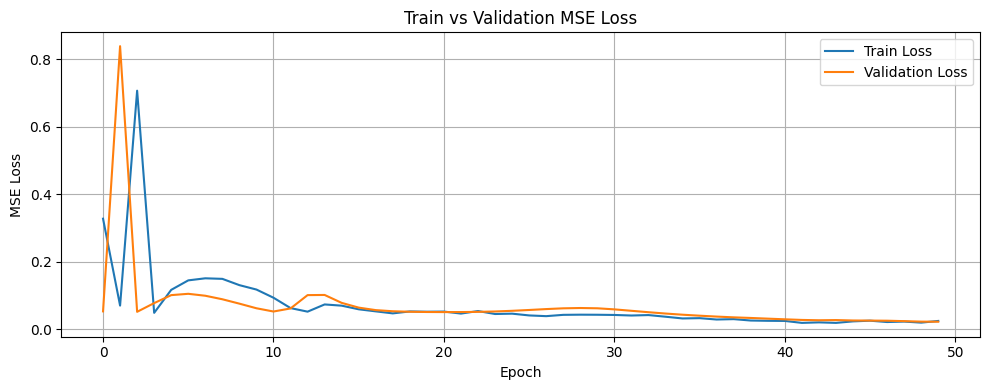

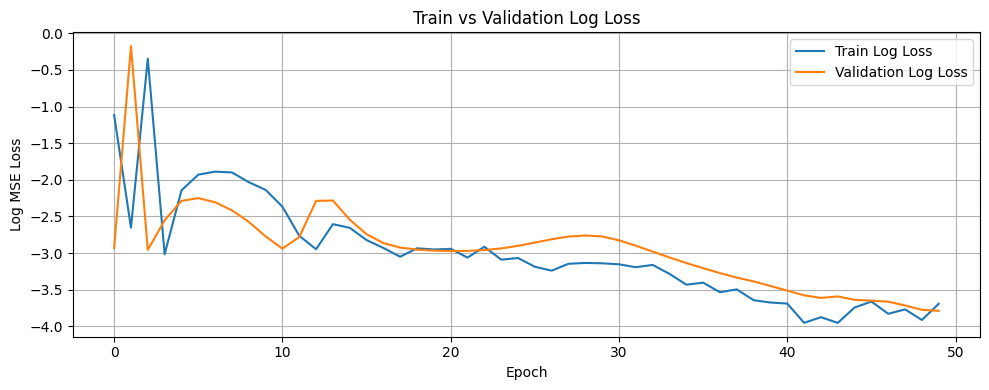

Training completed

=== Processing group: ('04 TO 06', 'QUEENSTOWN', '5 ROOM') ===
Group size: 3 rows
Calling prepare_lstm_data for ('04 TO 06', 'QUEENSTOWN', '5 ROOM')

Filtering for: QUEENSTOWN, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 101
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 42
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2498, Val Loss: 0.0910, Train R²: -3.8143, Val R²: -0.3937
Best model saved!
Epoch 2/50, Train Loss: 0.0715, Val Loss: 0.8197, Train R²: -0.3769, Val R²: -11.5526
Epoch 3/50, Train Loss: 0.9141, Val Loss: 0.0675, Train R²: -16.6157, Val R²: -0.0331
Best model saved!
Epoch 4/50, Train Loss: 0.0550, Val Loss: 0.1603, Train R²: -0.

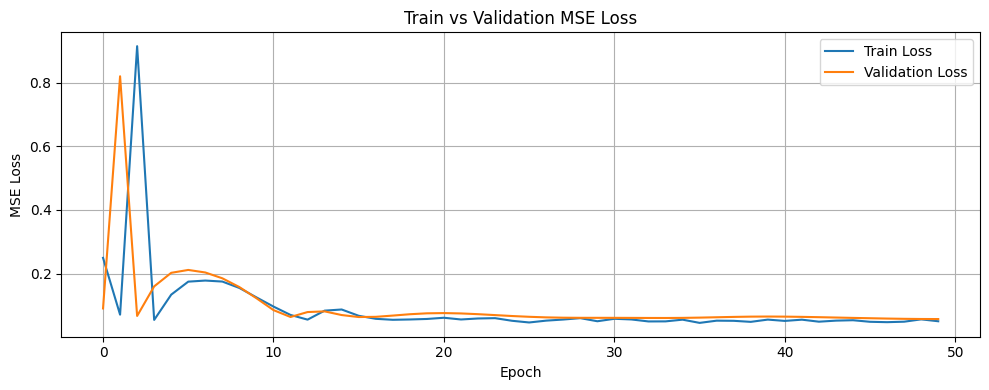

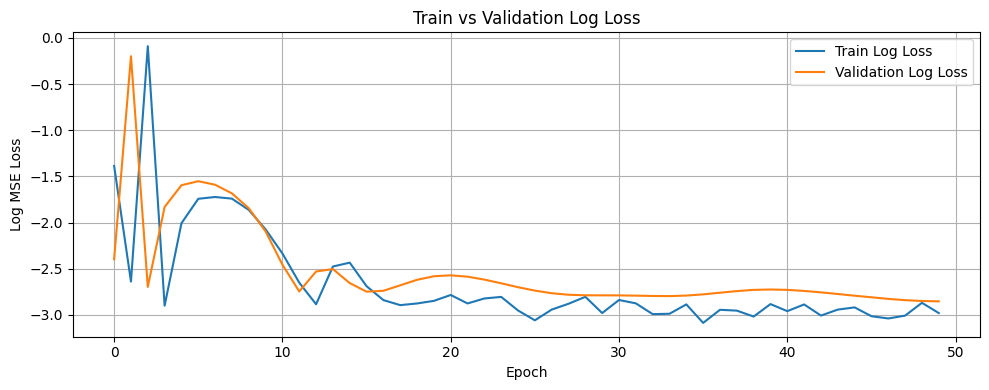

Training completed

=== Processing group: ('04 TO 06', 'SEMBAWANG', '2 ROOM') ===
Group size: 5 rows
Calling prepare_lstm_data for ('04 TO 06', 'SEMBAWANG', '2 ROOM')

Filtering for: SEMBAWANG, 2 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 66
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 32
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3053, Val Loss: 0.2097, Train R²: -6.5736, Val R²: -5.7165
Best model saved!
Epoch 2/50, Train Loss: 0.1225, Val Loss: 0.0613, Train R²: -2.0390, Val R²: -0.9643
Best model saved!
Epoch 3/50, Train Loss: 0.1255, Val Loss: 0.0896, Train R²: -2.1134, Val R²: -1.8699
Epoch 4/50, Train Loss: 0.0525, Val Loss: 0.1398, Train R²: -0.3033, 

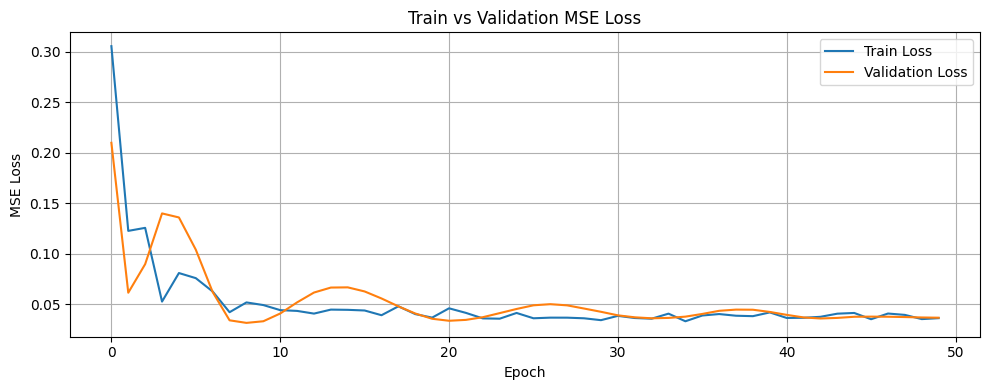

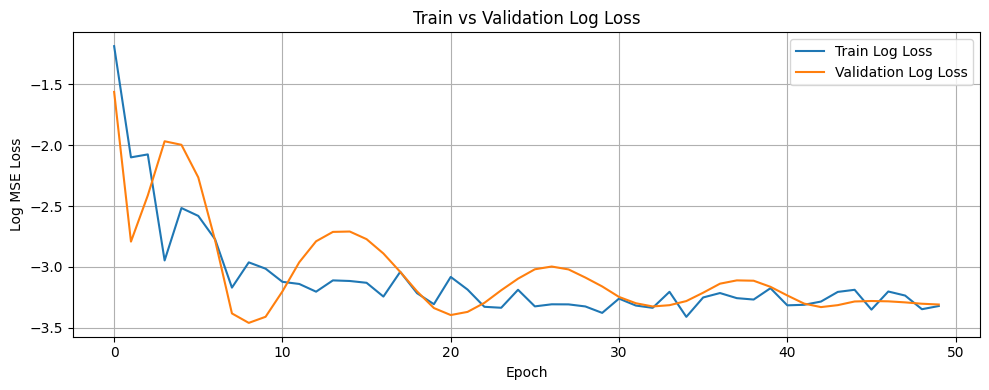

Training completed

=== Processing group: ('04 TO 06', 'SEMBAWANG', '3 ROOM') ===
Group size: 5 rows
Calling prepare_lstm_data for ('04 TO 06', 'SEMBAWANG', '3 ROOM')

Filtering for: SEMBAWANG, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 79
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1676, Val Loss: 0.0692, Train R²: -2.4302, Val R²: -0.0692
Best model saved!
Epoch 2/50, Train Loss: 0.0524, Val Loss: 0.1212, Train R²: -0.0729, Val R²: -0.8716
Epoch 3/50, Train Loss: 0.1447, Val Loss: 0.0851, Train R²: -1.9614, Val R²: -0.3133
Epoch 4/50, Train Loss: 0.0547, Val Loss: 0.1217, Train R²: -0.1196, Val R²: -0.8798
Ep

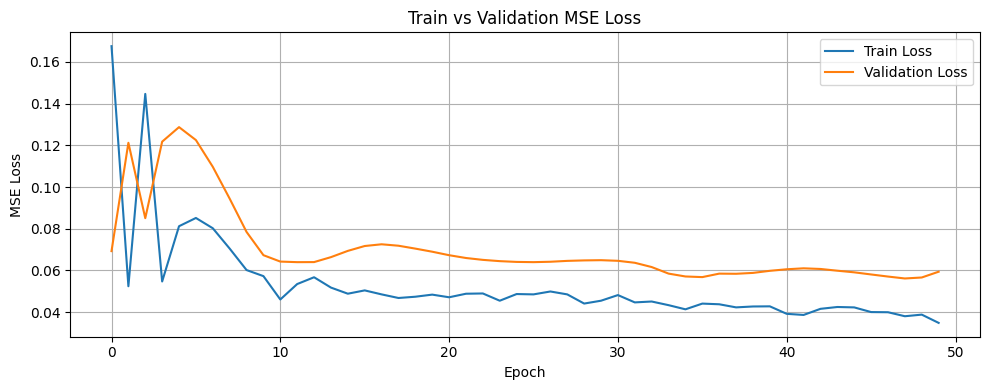

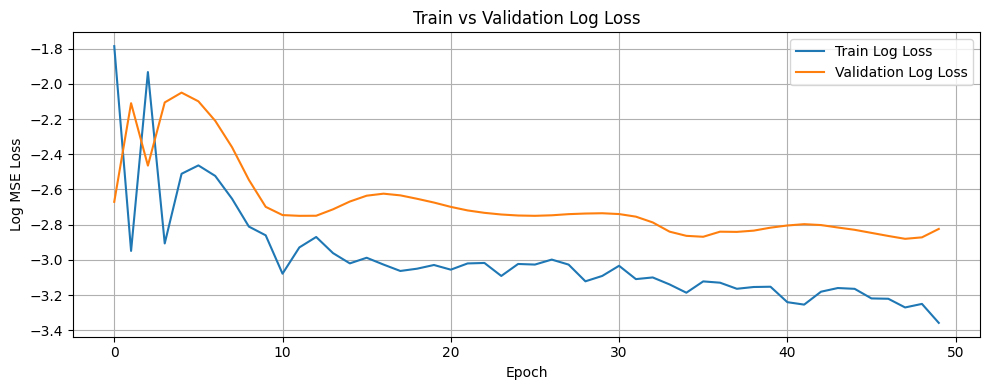

Training completed

=== Processing group: ('04 TO 06', 'SEMBAWANG', '4 ROOM') ===
Group size: 37 rows
Calling prepare_lstm_data for ('04 TO 06', 'SEMBAWANG', '4 ROOM')

Filtering for: SEMBAWANG, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 564
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 36
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1737, Val Loss: 0.0821, Train R²: -1.5497, Val R²: -0.0361
Best model saved!
Epoch 2/50, Train Loss: 0.0708, Val Loss: 0.0737, Train R²: -0.0397, Val R²: 0.0703
Best model saved!
Epoch 3/50, Train Loss: 0.0654, Val Loss: 0.2269, Train R²: 0.0402, Val R²: -1.8624
Epoch 4/50, Train Loss: 0.1999, Val Loss: 0.0661, Train R²: -1.9333, 

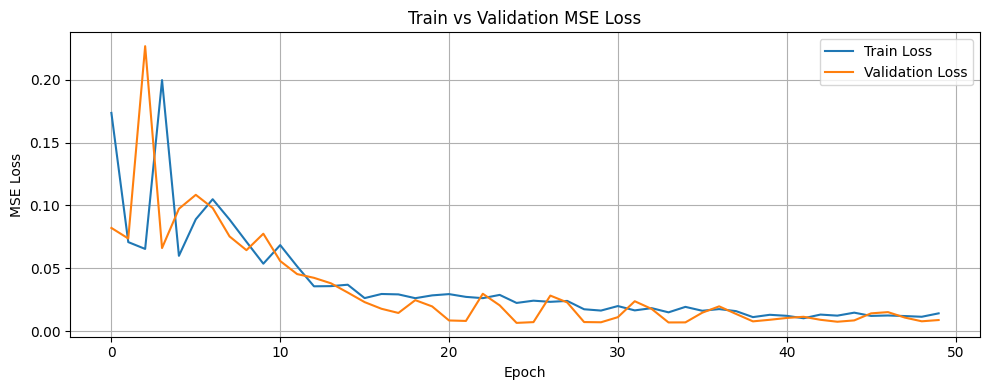

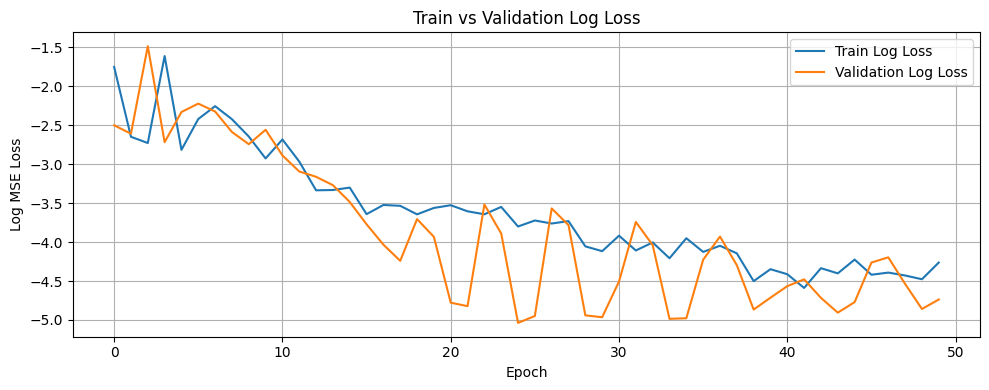

Training completed

=== Processing group: ('04 TO 06', 'SEMBAWANG', '5 ROOM') ===
Group size: 19 rows
Calling prepare_lstm_data for ('04 TO 06', 'SEMBAWANG', '5 ROOM')

Filtering for: SEMBAWANG, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 384
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 40
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3825, Val Loss: 0.0685, Train R²: -3.4693, Val R²: -0.3612
Best model saved!
Epoch 2/50, Train Loss: 0.1668, Val Loss: 0.4998, Train R²: -0.9490, Val R²: -8.9381
Epoch 3/50, Train Loss: 0.3810, Val Loss: 0.0505, Train R²: -3.4520, Val R²: -0.0043
Best model saved!
Epoch 4/50, Train Loss: 0.0961, Val Loss: 0.0648, Train R²: -0.1236

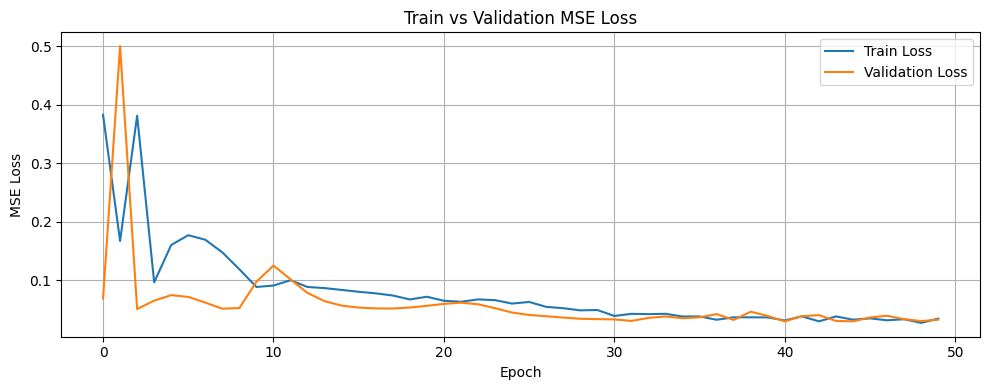

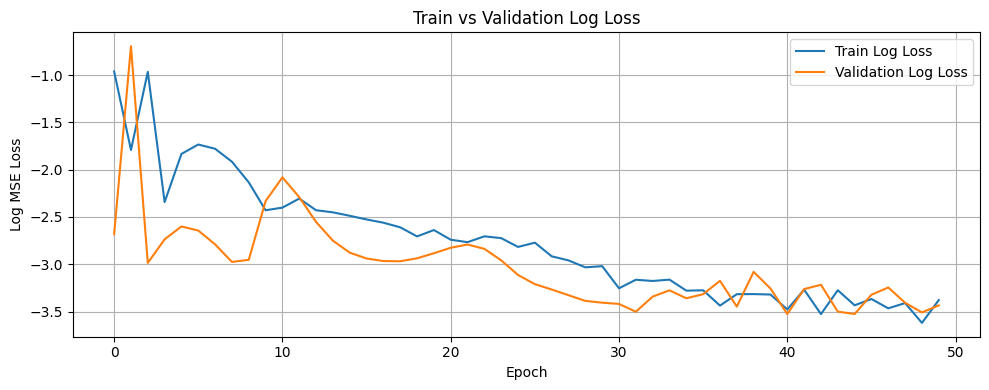

Training completed

=== Processing group: ('04 TO 06', 'SEMBAWANG', 'EXECUTIVE') ===
Group size: 6 rows
Calling prepare_lstm_data for ('04 TO 06', 'SEMBAWANG', 'EXECUTIVE')

Filtering for: SEMBAWANG, EXECUTIVE, 04 TO 06, around 2025-01-01
Initial strict match count: 133
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1975, Val Loss: 0.1029, Train R²: -4.1355, Val R²: -4.4466
Best model saved!
Epoch 2/50, Train Loss: 0.0895, Val Loss: 0.1503, Train R²: -1.3289, Val R²: -6.9546
Epoch 3/50, Train Loss: 0.2184, Val Loss: 0.0581, Train R²: -4.6809, Val R²: -2.0721
Best model saved!
Epoch 4/50, Train Loss: 0.0581, Val Loss: 0.1177, Train R²:

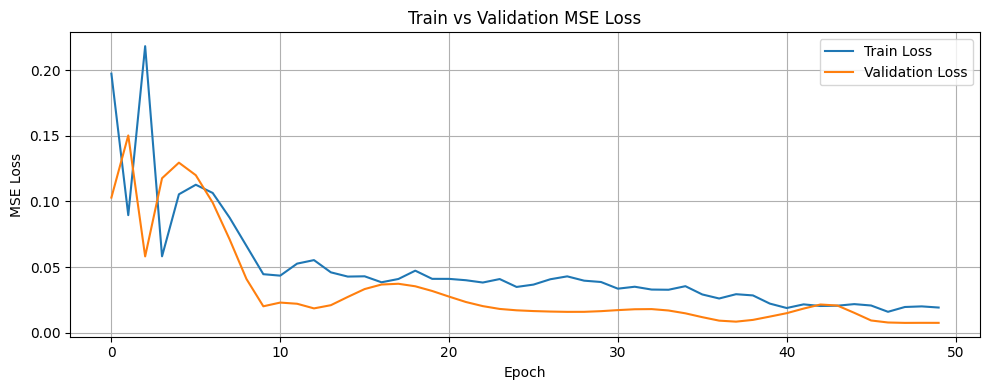

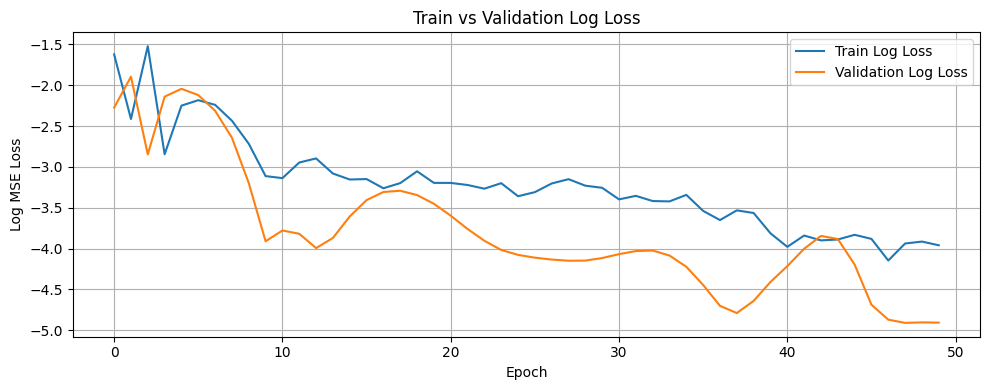

Training completed

=== Processing group: ('04 TO 06', 'SENGKANG', '2 ROOM') ===
Group size: 7 rows
Calling prepare_lstm_data for ('04 TO 06', 'SENGKANG', '2 ROOM')

Filtering for: SENGKANG, 2 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 78
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 33
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1772, Val Loss: 0.0713, Train R²: -2.0133, Val R²: -0.2345
Best model saved!
Epoch 2/50, Train Loss: 0.0652, Val Loss: 0.0948, Train R²: -0.1086, Val R²: -0.6421
Epoch 3/50, Train Loss: 0.0598, Val Loss: 0.0852, Train R²: -0.0169, Val R²: -0.4764
Epoch 4/50, Train Loss: 0.0622, Val Loss: 0.0748, Train R²: -0.0571, Val R²: -0.2966
Epoch

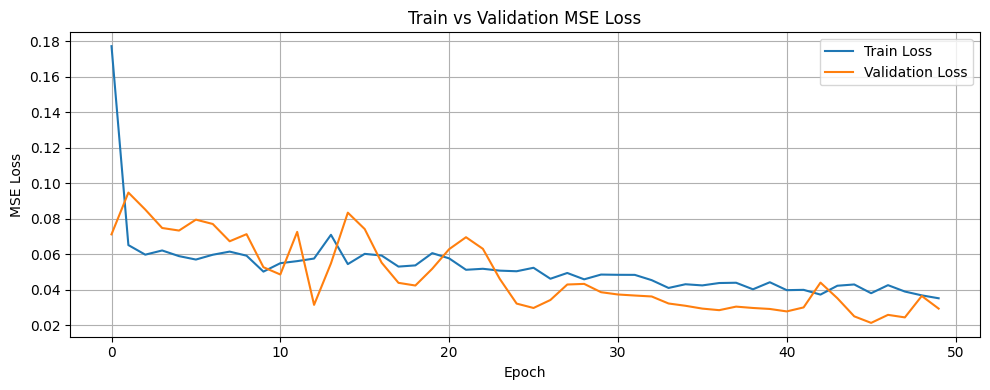

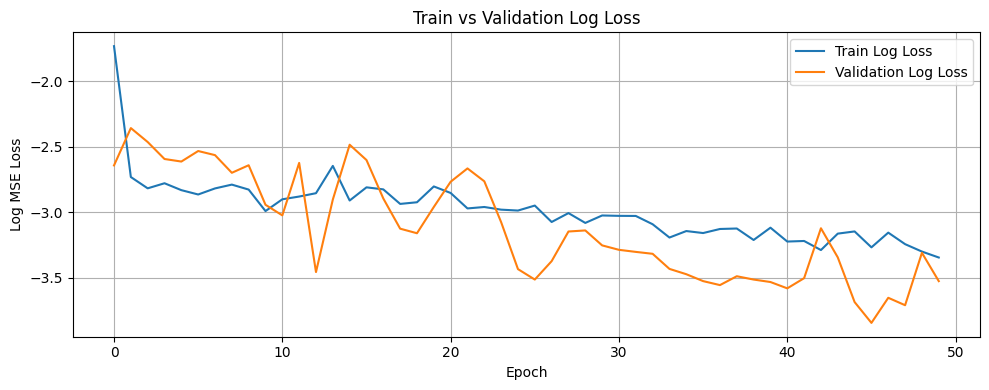

Training completed

=== Processing group: ('04 TO 06', 'SENGKANG', '3 ROOM') ===
Group size: 9 rows
Calling prepare_lstm_data for ('04 TO 06', 'SENGKANG', '3 ROOM')

Filtering for: SENGKANG, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 181
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 31
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1969, Val Loss: 0.0526, Train R²: -2.4625, Val R²: -0.1978
Best model saved!
Epoch 2/50, Train Loss: 0.0614, Val Loss: 0.7793, Train R²: -0.0799, Val R²: -16.7333
Epoch 3/50, Train Loss: 0.8394, Val Loss: 0.0460, Train R²: -13.7616, Val R²: -0.0472
Best model saved!
Epoch 4/50, Train Loss: 0.0662, Val Loss: 0.0828, Train R²: -0.1648, 

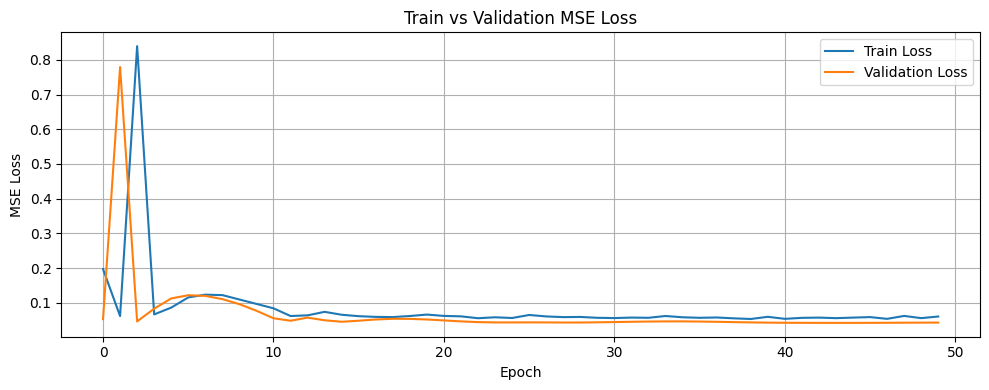

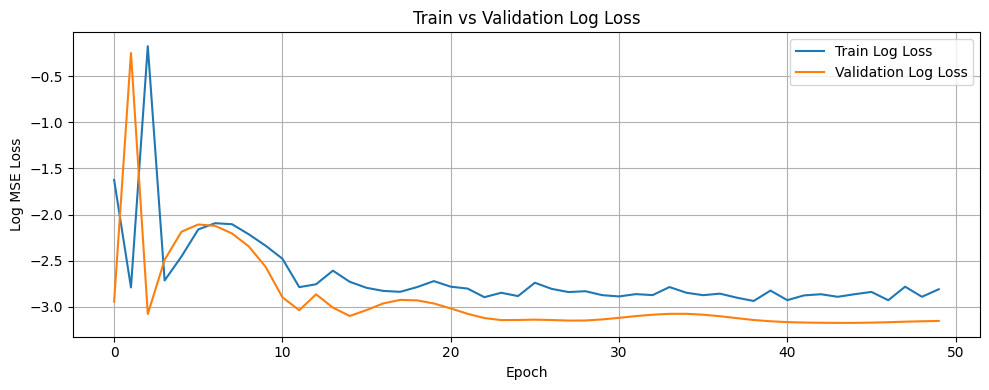

Training completed

=== Processing group: ('04 TO 06', 'SENGKANG', '4 ROOM') ===
Group size: 37 rows
Calling prepare_lstm_data for ('04 TO 06', 'SENGKANG', '4 ROOM')

Filtering for: SENGKANG, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 1391
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1349, Val Loss: 0.0478, Train R²: -1.7276, Val R²: 0.0314
Best model saved!
Epoch 2/50, Train Loss: 0.0691, Val Loss: 0.0913, Train R²: -0.3961, Val R²: -0.8499
Epoch 3/50, Train Loss: 0.0631, Val Loss: 0.0891, Train R²: -0.2762, Val R²: -0.8064
Epoch 4/50, Train Loss: 0.0605, Val Loss: 0.0702, Train R²: -0.2221, Val R²: -0.4222
Epo

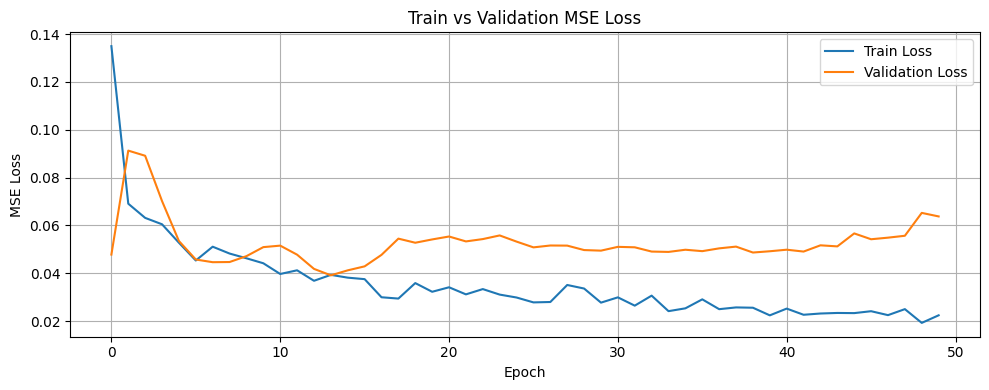

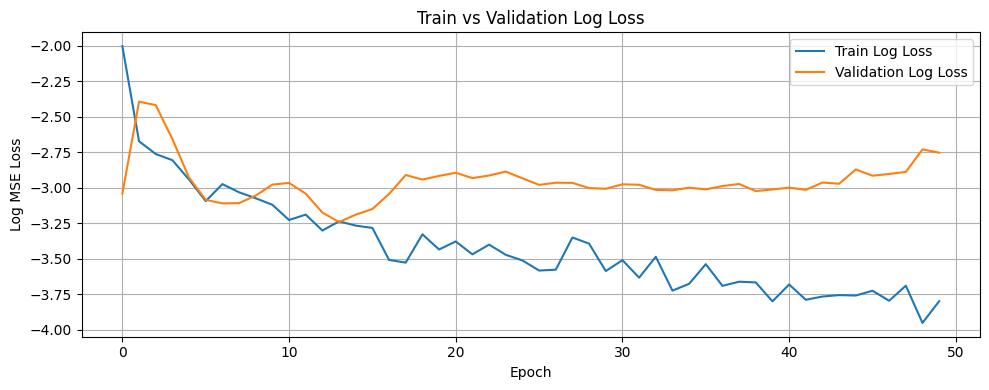

Training completed

=== Processing group: ('04 TO 06', 'SENGKANG', '5 ROOM') ===
Group size: 25 rows
Calling prepare_lstm_data for ('04 TO 06', 'SENGKANG', '5 ROOM')

Filtering for: SENGKANG, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 1023
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 35
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.0842, Val Loss: 0.0947, Train R²: -1.8329, Val R²: -0.1570
Best model saved!
Epoch 2/50, Train Loss: 0.0666, Val Loss: 0.1222, Train R²: -1.2413, Val R²: -0.4924
Epoch 3/50, Train Loss: 0.0520, Val Loss: 0.1331, Train R²: -0.7484, Val R²: -0.6255
Epoch 4/50, Train Loss: 0.0627, Val Loss: 0.1209, Train R²: -1.1104, Val R²: -0.4763
Ep

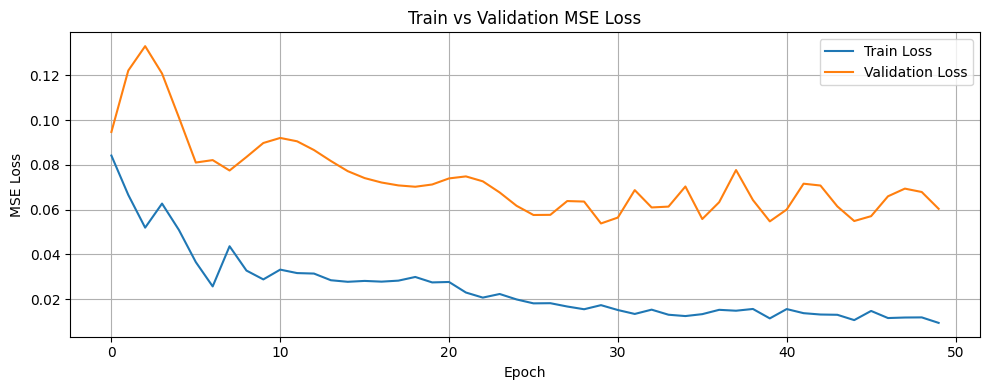

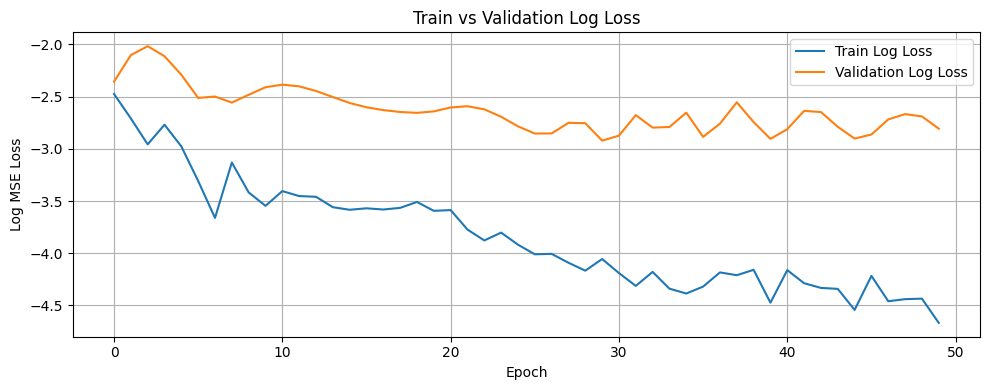

Training completed

=== Processing group: ('04 TO 06', 'SENGKANG', 'EXECUTIVE') ===
Group size: 4 rows
Calling prepare_lstm_data for ('04 TO 06', 'SENGKANG', 'EXECUTIVE')

Filtering for: SENGKANG, EXECUTIVE, 04 TO 06, around 2025-01-01
Initial strict match count: 231
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.0842, Val Loss: 0.0496, Train R²: -0.7406, Val R²: -0.0412
Best model saved!
Epoch 2/50, Train Loss: 0.0601, Val Loss: 0.0551, Train R²: -0.2418, Val R²: -0.1573
Epoch 3/50, Train Loss: 0.0501, Val Loss: 0.0581, Train R²: -0.0364, Val R²: -0.2184
Epoch 4/50, Train Loss: 0.0521, Val Loss: 0.0534, Train R²: -0.0768, Val R²: -0.

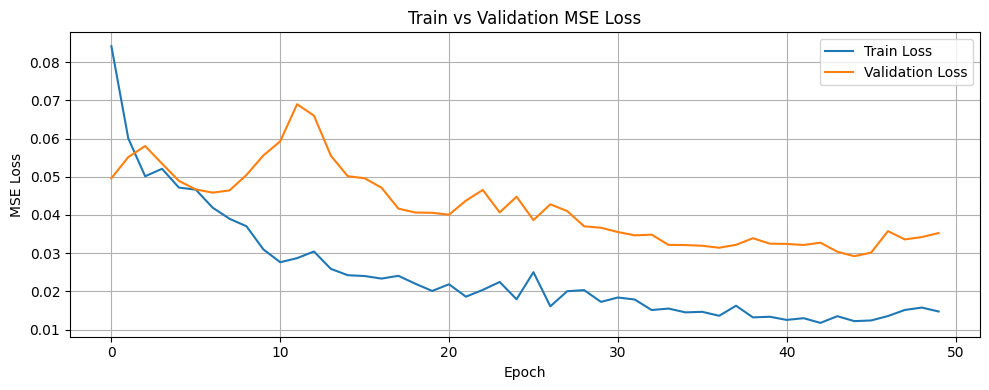

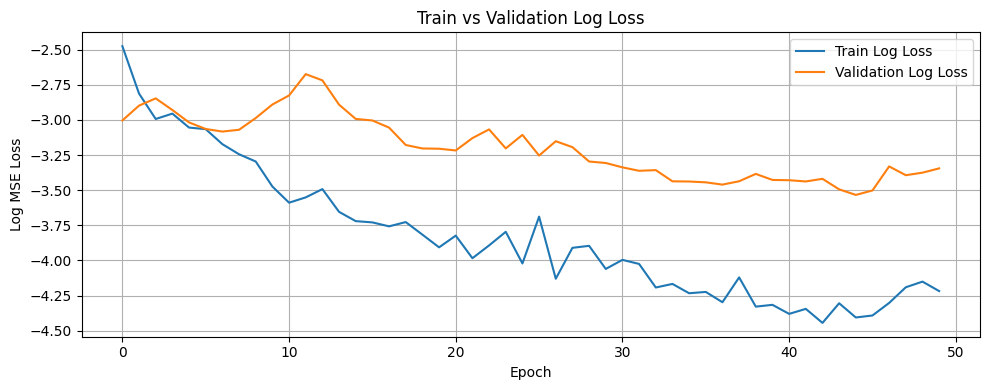

Training completed

=== Processing group: ('04 TO 06', 'SERANGOON', '3 ROOM') ===
Group size: 6 rows
Calling prepare_lstm_data for ('04 TO 06', 'SERANGOON', '3 ROOM')

Filtering for: SERANGOON, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 243
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 32
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2530, Val Loss: 0.1160, Train R²: -4.3136, Val R²: -2.3136
Best model saved!
Epoch 2/50, Train Loss: 0.0735, Val Loss: 0.2871, Train R²: -0.5430, Val R²: -7.2015
Epoch 3/50, Train Loss: 0.4894, Val Loss: 0.0588, Train R²: -9.2771, Val R²: -0.6798
Best model saved!
Epoch 4/50, Train Loss: 0.0518, Val Loss: 0.1466, Train R²: -0.0883,

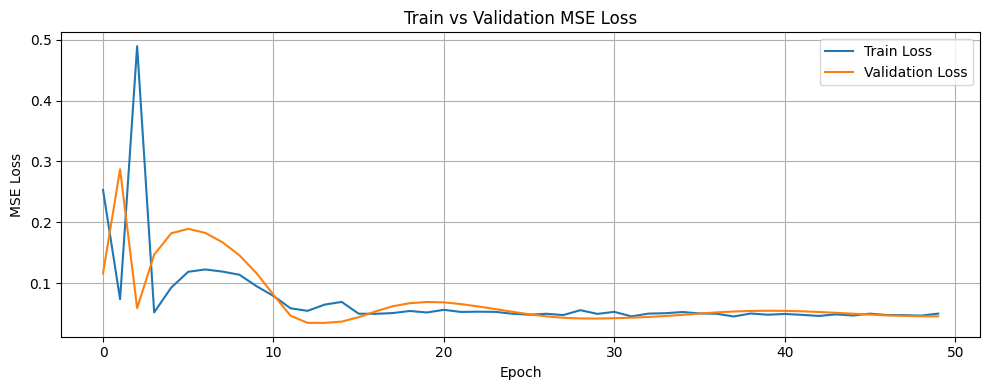

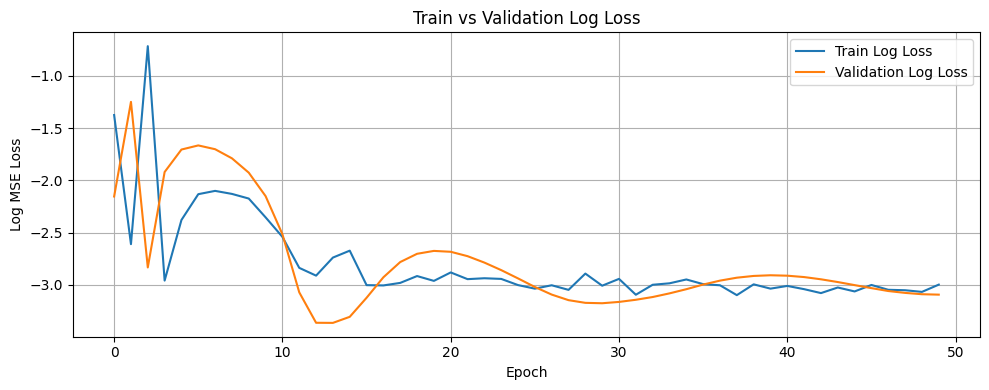

Training completed

=== Processing group: ('04 TO 06', 'SERANGOON', '4 ROOM') ===
Group size: 9 rows
Calling prepare_lstm_data for ('04 TO 06', 'SERANGOON', '4 ROOM')

Filtering for: SERANGOON, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 477
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2836, Val Loss: 0.0110, Train R²: -2.1515, Val R²: -0.2494
Best model saved!
Epoch 2/50, Train Loss: 0.1236, Val Loss: 0.9071, Train R²: -0.3736, Val R²: -101.7540
Epoch 3/50, Train Loss: 0.7754, Val Loss: 0.0151, Train R²: -7.6158, Val R²: -0.7056
Epoch 4/50, Train Loss: 0.0941, Val Loss: 0.0257, Train R²: -0.0456, Val R²: -1.9114

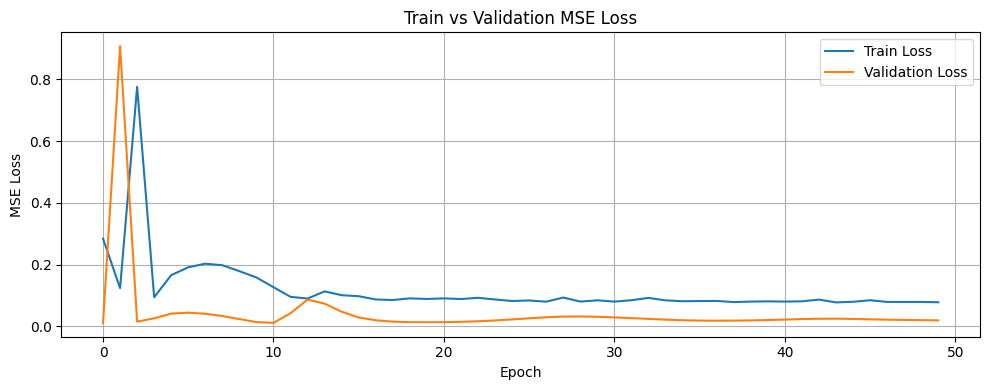

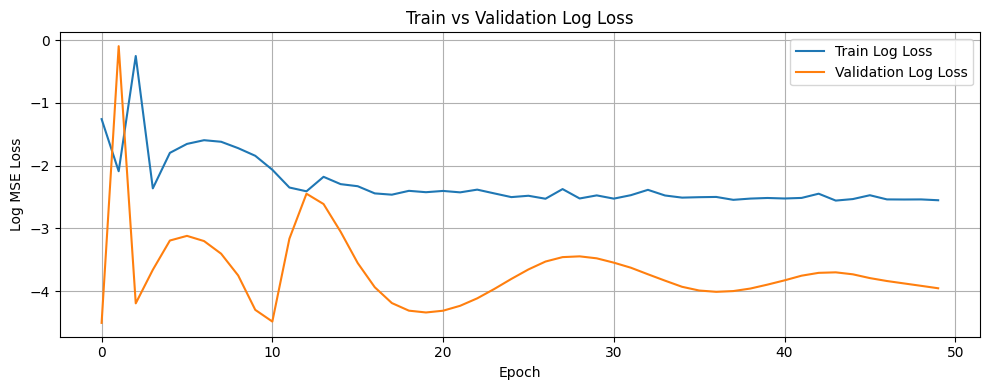

Training completed

=== Processing group: ('04 TO 06', 'SERANGOON', '5 ROOM') ===
Group size: 4 rows
Calling prepare_lstm_data for ('04 TO 06', 'SERANGOON', '5 ROOM')

Filtering for: SERANGOON, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 154
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2209, Val Loss: 0.0675, Train R²: -3.0147, Val R²: -0.1348
Best model saved!
Epoch 2/50, Train Loss: 0.0780, Val Loss: 0.7167, Train R²: -0.4177, Val R²: -11.0463
Epoch 3/50, Train Loss: 0.6244, Val Loss: 0.0608, Train R²: -10.3494, Val R²: -0.0228
Best model saved!
Epoch 4/50, Train Loss: 0.0615, Val Loss: 0.0941, Train R²: -0.117

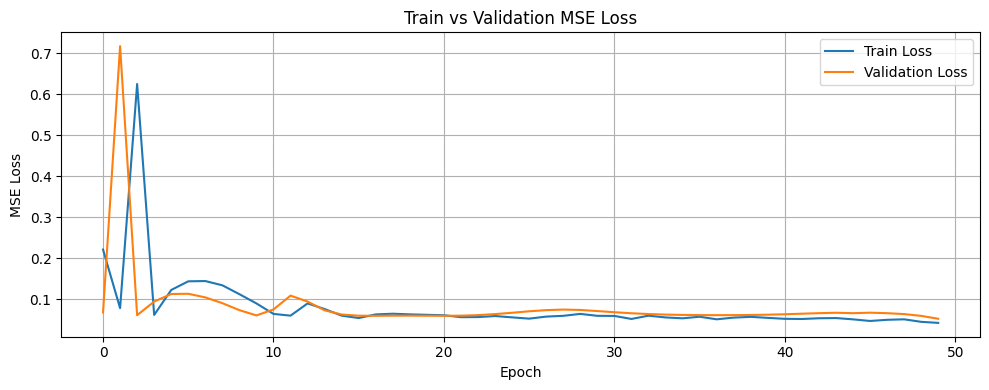

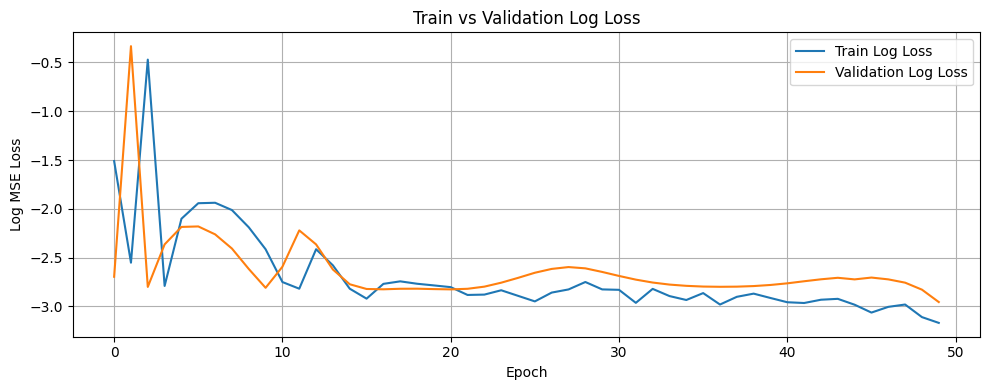

Training completed

=== Processing group: ('04 TO 06', 'SERANGOON', 'EXECUTIVE') ===
Group size: 2 rows
Calling prepare_lstm_data for ('04 TO 06', 'SERANGOON', 'EXECUTIVE')

Filtering for: SERANGOON, EXECUTIVE, 04 TO 06, around 2025-01-01
Initial strict match count: 163
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 40
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2541, Val Loss: 0.0544, Train R²: -3.3339, Val R²: -1.0339
Best model saved!
Epoch 2/50, Train Loss: 0.0720, Val Loss: 1.0174, Train R²: -0.2273, Val R²: -37.0641
Epoch 3/50, Train Loss: 1.2573, Val Loss: 0.0275, Train R²: -20.4406, Val R²: -0.0273
Best model saved!
Epoch 4/50, Train Loss: 0.0658, Val Loss: 0.1166, Train R

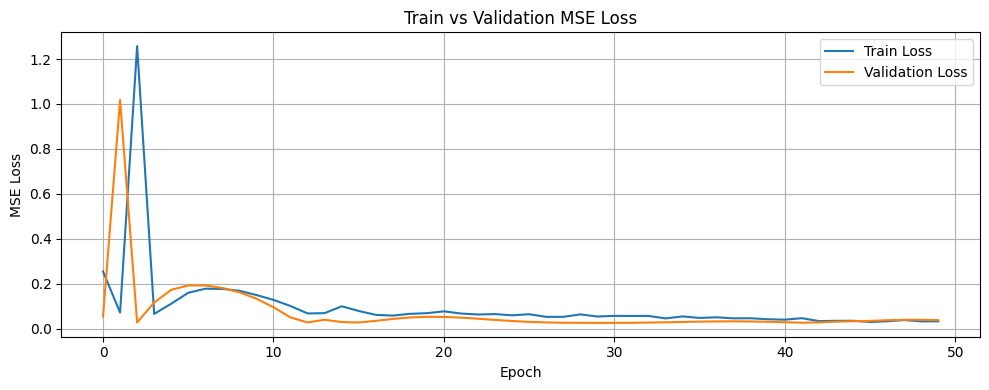

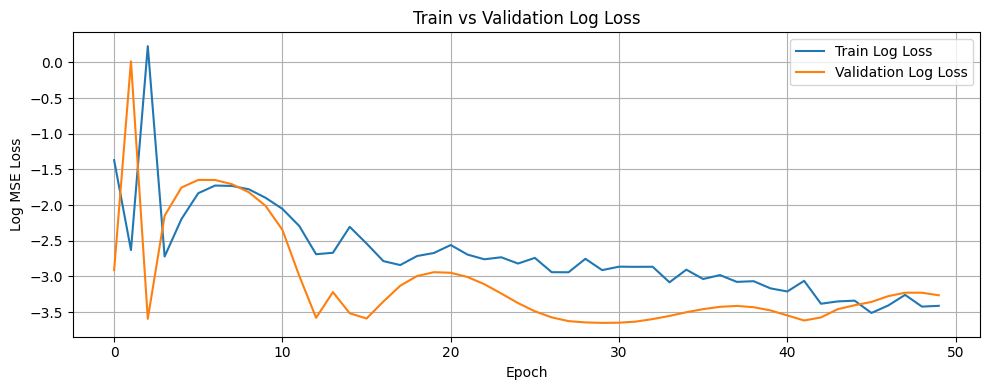

Training completed

=== Processing group: ('04 TO 06', 'TAMPINES', '2 ROOM') ===
Group size: 2 rows
Calling prepare_lstm_data for ('04 TO 06', 'TAMPINES', '2 ROOM')

Filtering for: TAMPINES, 2 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 20
Using before_or_at_target with 18 records.
Removing 'block' column from dataset
Data shapes - x_train: (17, 9), y_train: (17,)
Flattened y shape: (17,), Unique values: 14
Using simple train-validation split (80/20).
Split sizes - Train: 13, Val: 4
Creating PyTorch datasets...
Dataset sizes - Train: 13, Val: 4
Using batch sizes - Train: 13, Val: 4
Starting model training...
Epoch 1/50, Train Loss: 0.3987, Val Loss: 0.1203, Train R²: -3.0710, Val R²: -0.0682
Best model saved!
Epoch 2/50, Train Loss: 0.1700, Val Loss: 1.1509, Train R²: -0.7356, Val R²: -9.2201
Epoch 3/50, Train Loss: 0.8121, Val Loss: 0.1266, Train R²: -7.2914, Val R²: -0.1243
Epoch 4/50, Train Loss: 0.1110, Val Loss: 0.1309, Train R²: -0.1328, Val R²: -0.1624
Epoch 5/

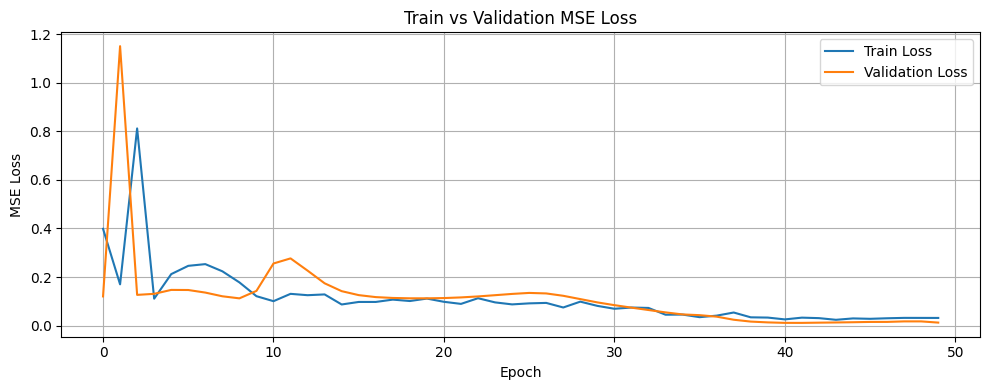

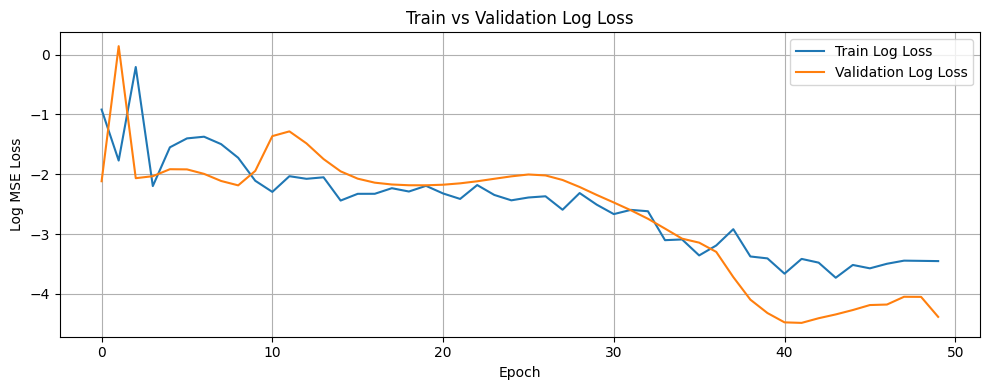

Training completed

=== Processing group: ('04 TO 06', 'TAMPINES', '3 ROOM') ===
Group size: 21 rows
Calling prepare_lstm_data for ('04 TO 06', 'TAMPINES', '3 ROOM')

Filtering for: TAMPINES, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 857
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2376, Val Loss: 0.0453, Train R²: -2.4663, Val R²: -0.1620
Best model saved!
Epoch 2/50, Train Loss: 0.0845, Val Loss: 0.5606, Train R²: -0.2334, Val R²: -13.3857
Epoch 3/50, Train Loss: 0.5286, Val Loss: 0.0382, Train R²: -6.7115, Val R²: 0.0195
Best model saved!
Epoch 4/50, Train Loss: 0.0697, Val Loss: 0.0688, Train R²: -0.0172, V

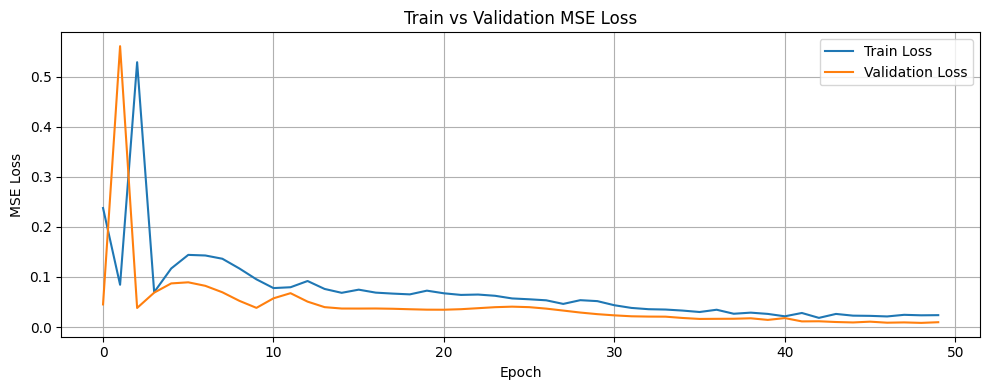

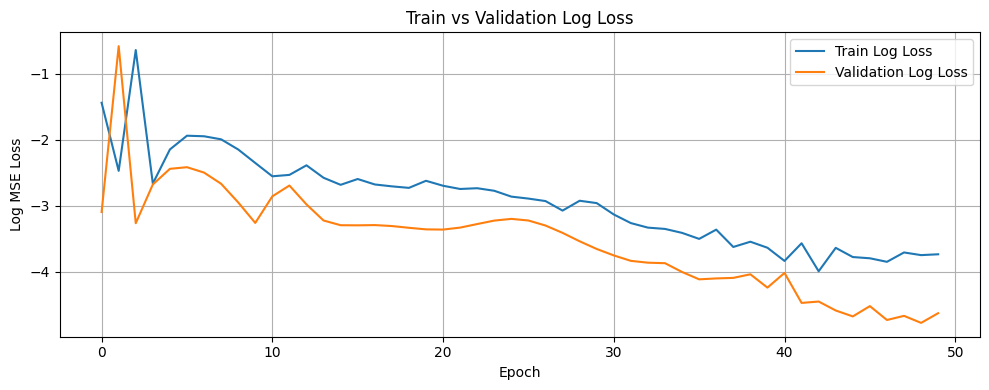

Training completed

=== Processing group: ('04 TO 06', 'TAMPINES', '4 ROOM') ===
Group size: 49 rows
Calling prepare_lstm_data for ('04 TO 06', 'TAMPINES', '4 ROOM')

Filtering for: TAMPINES, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 1534
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 36
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2485, Val Loss: 0.0240, Train R²: -4.2503, Val R²: -0.1238
Best model saved!
Epoch 2/50, Train Loss: 0.0832, Val Loss: 0.6418, Train R²: -0.7579, Val R²: -29.0603
Epoch 3/50, Train Loss: 0.5081, Val Loss: 0.0218, Train R²: -9.7351, Val R²: -0.0228
Best model saved!
Epoch 4/50, Train Loss: 0.0591, Val Loss: 0.0388, Train R²: -0.2486,

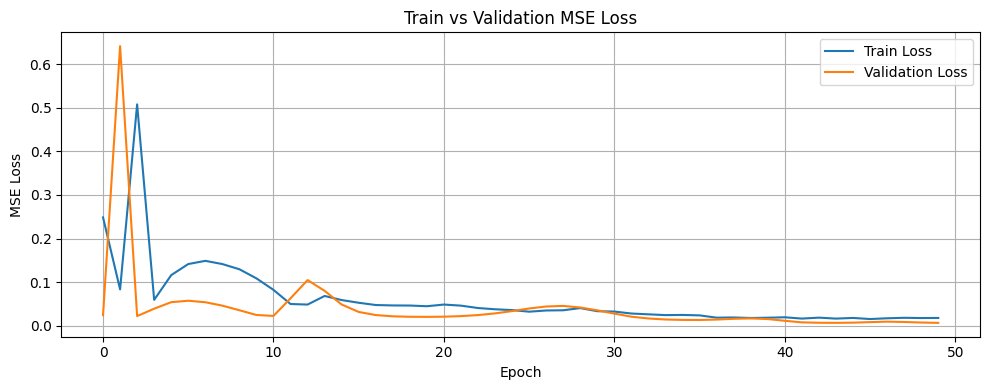

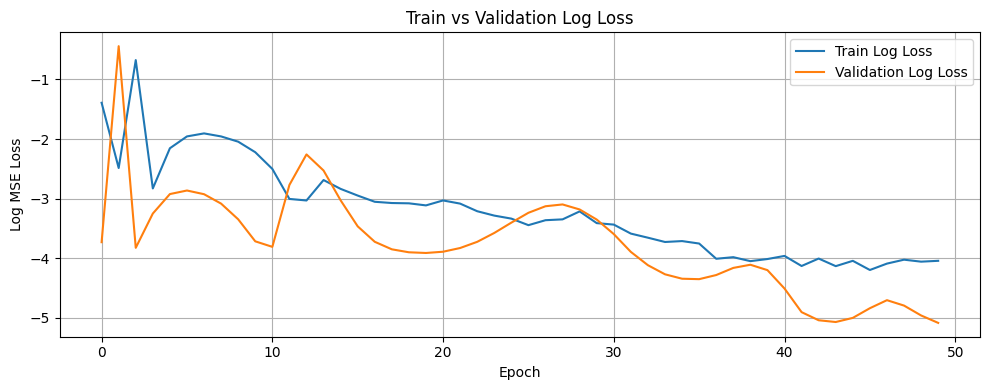

Training completed

=== Processing group: ('04 TO 06', 'TAMPINES', '5 ROOM') ===
Group size: 40 rows
Calling prepare_lstm_data for ('04 TO 06', 'TAMPINES', '5 ROOM')

Filtering for: TAMPINES, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 965
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1775, Val Loss: 0.0553, Train R²: -1.3770, Val R²: 0.0057
Best model saved!
Epoch 2/50, Train Loss: 0.0782, Val Loss: 0.0996, Train R²: -0.0468, Val R²: -0.7908
Epoch 3/50, Train Loss: 0.1390, Val Loss: 0.0731, Train R²: -0.8614, Val R²: -0.3153
Epoch 4/50, Train Loss: 0.0835, Val Loss: 0.0945, Train R²: -0.1187, Val R²: -0.7001
Epoc

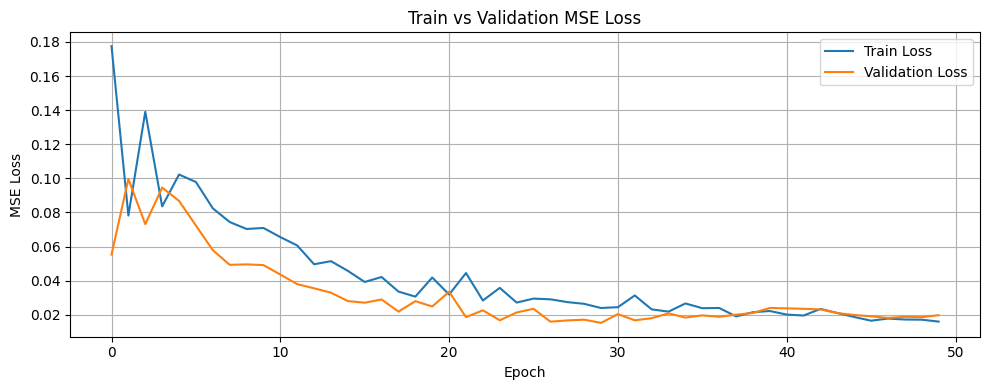

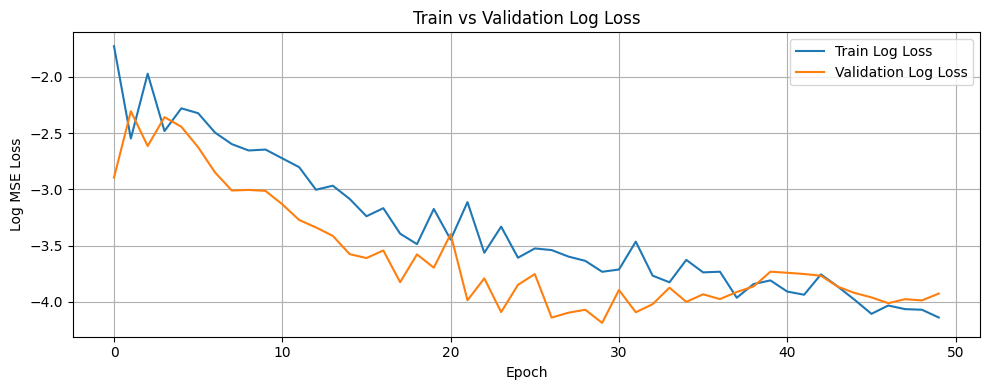

Training completed

=== Processing group: ('04 TO 06', 'TAMPINES', 'EXECUTIVE') ===
Group size: 13 rows
Calling prepare_lstm_data for ('04 TO 06', 'TAMPINES', 'EXECUTIVE')

Filtering for: TAMPINES, EXECUTIVE, 04 TO 06, around 2025-01-01
Initial strict match count: 466
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 33
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2222, Val Loss: 0.0473, Train R²: -2.5842, Val R²: -0.7068
Best model saved!
Epoch 2/50, Train Loss: 0.0879, Val Loss: 0.3625, Train R²: -0.4185, Val R²: -12.0842
Epoch 3/50, Train Loss: 0.4052, Val Loss: 0.0307, Train R²: -5.5372, Val R²: -0.1093
Best model saved!
Epoch 4/50, Train Loss: 0.0746, Val Loss: 0.0755, Train R²: 

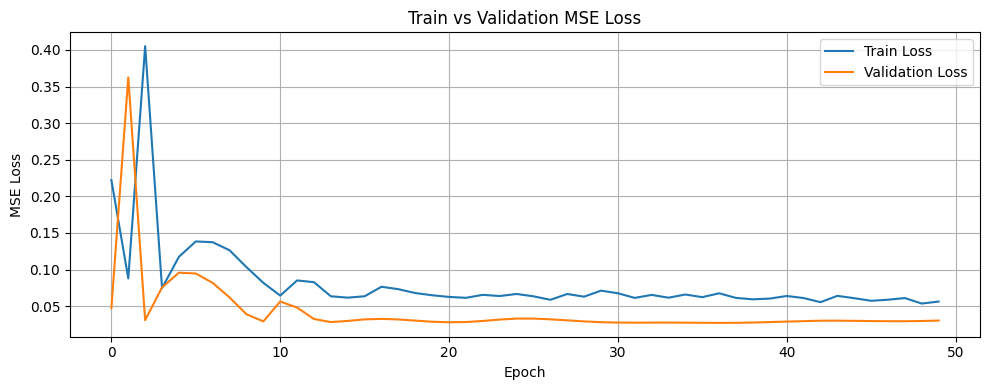

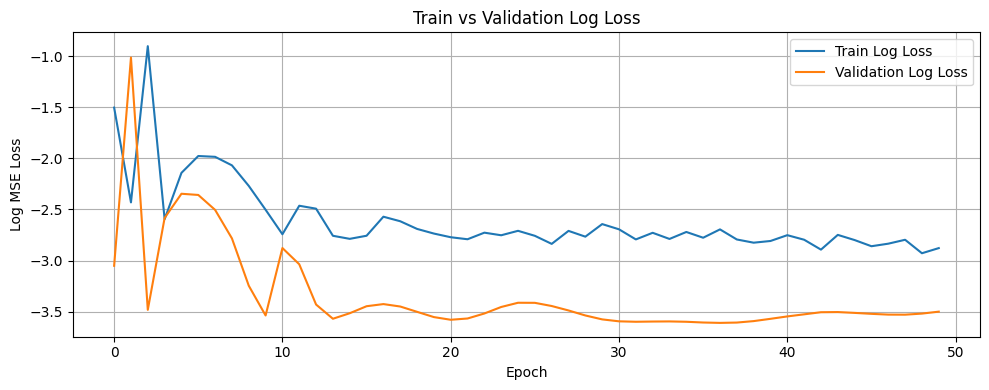

Training completed

=== Processing group: ('04 TO 06', 'TOA PAYOH', '2 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('04 TO 06', 'TOA PAYOH', '2 ROOM')

Filtering for: TOA PAYOH, 2 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 47
Using before_or_at_target with 46 records.
Removing 'block' column from dataset
Data shapes - x_train: (45, 9), y_train: (45,)
Flattened y shape: (45,), Unique values: 28
Using simple train-validation split (80/20).
Split sizes - Train: 36, Val: 9
Creating PyTorch datasets...
Dataset sizes - Train: 36, Val: 9
Using batch sizes - Train: 36, Val: 9
Starting model training...
Epoch 1/50, Train Loss: 0.2021, Val Loss: 0.1119, Train R²: -1.0357, Val R²: -0.2914
Best model saved!
Epoch 2/50, Train Loss: 0.1001, Val Loss: 0.1235, Train R²: -0.0083, Val R²: -0.4252
Epoch 3/50, Train Loss: 0.2043, Val Loss: 0.1478, Train R²: -1.0586, Val R²: -0.7051
Epoch 4/50, Train Loss: 0.1098, Val Loss: 0.1975, Train R²: -0.1063, Val R²: -1.2795
Epoch

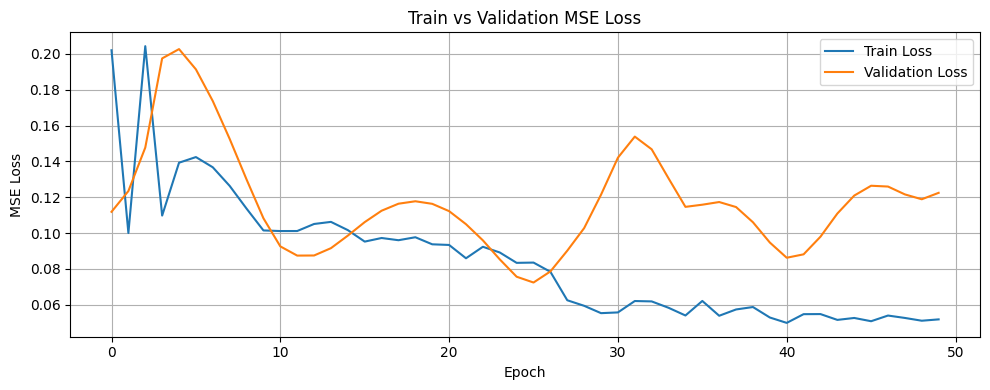

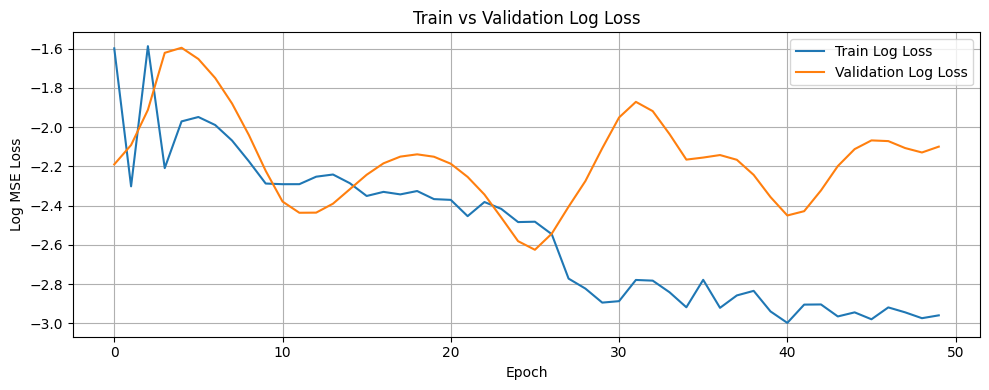

Training completed

=== Processing group: ('04 TO 06', 'TOA PAYOH', '3 ROOM') ===
Group size: 21 rows
Calling prepare_lstm_data for ('04 TO 06', 'TOA PAYOH', '3 ROOM')

Filtering for: TOA PAYOH, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 733
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.0497, Val Loss: 0.0640, Train R²: -0.5310, Val R²: -0.4153
Best model saved!
Epoch 2/50, Train Loss: 0.0577, Val Loss: 0.0497, Train R²: -0.7755, Val R²: -0.1001
Best model saved!
Epoch 3/50, Train Loss: 0.0332, Val Loss: 0.0564, Train R²: -0.0220, Val R²: -0.2487
Epoch 4/50, Train Loss: 0.0376, Val Loss: 0.0540, Train R²: -0.1574

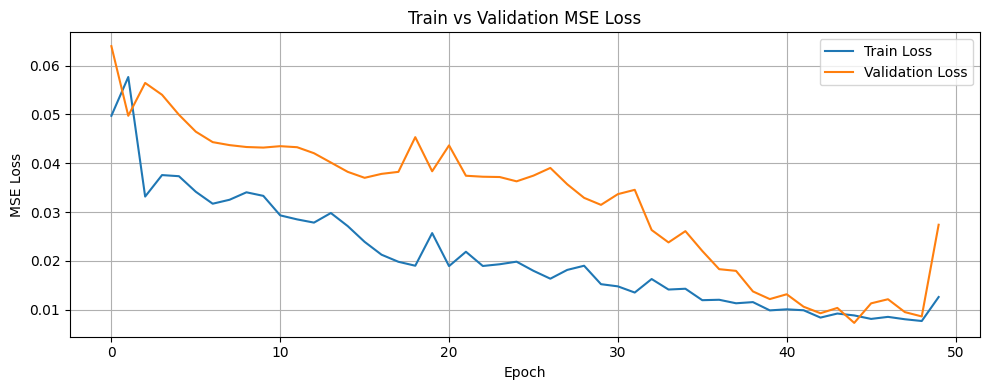

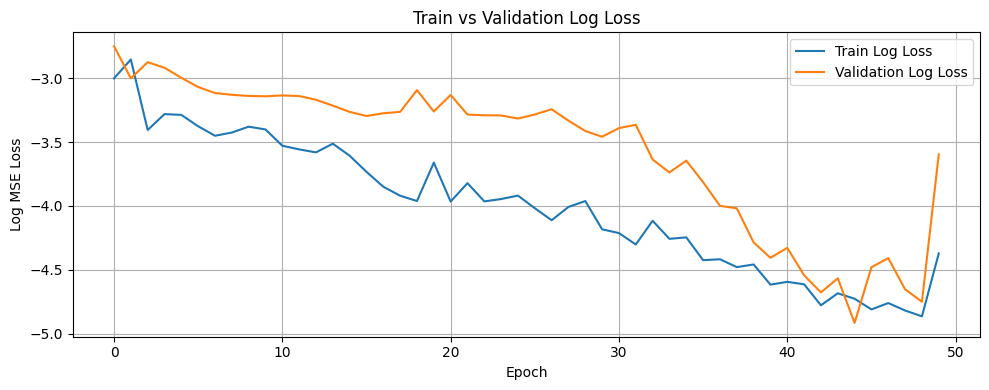

Training completed

=== Processing group: ('04 TO 06', 'TOA PAYOH', '4 ROOM') ===
Group size: 9 rows
Calling prepare_lstm_data for ('04 TO 06', 'TOA PAYOH', '4 ROOM')

Filtering for: TOA PAYOH, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 322
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 44
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2090, Val Loss: 0.0555, Train R²: -2.6839, Val R²: 0.0440
Best model saved!
Epoch 2/50, Train Loss: 0.0599, Val Loss: 0.6441, Train R²: -0.0559, Val R²: -10.0893
Epoch 3/50, Train Loss: 0.5921, Val Loss: 0.0542, Train R²: -9.4355, Val R²: 0.0667
Best model saved!
Epoch 4/50, Train Loss: 0.0542, Val Loss: 0.0750, Train R²: 0.0448, V

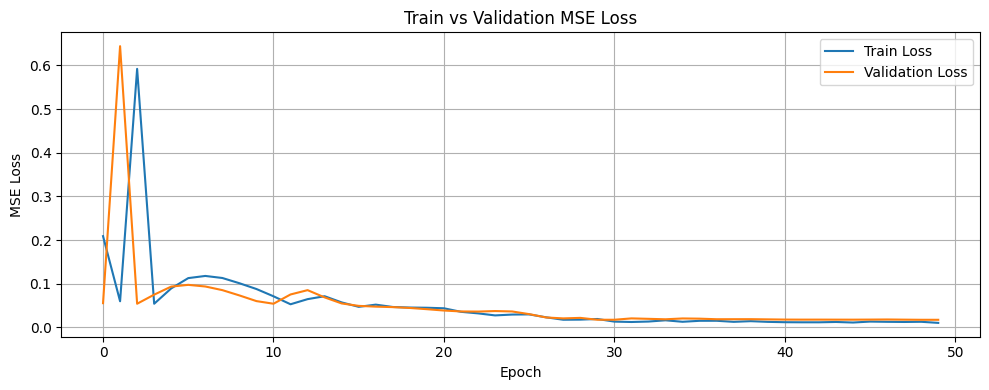

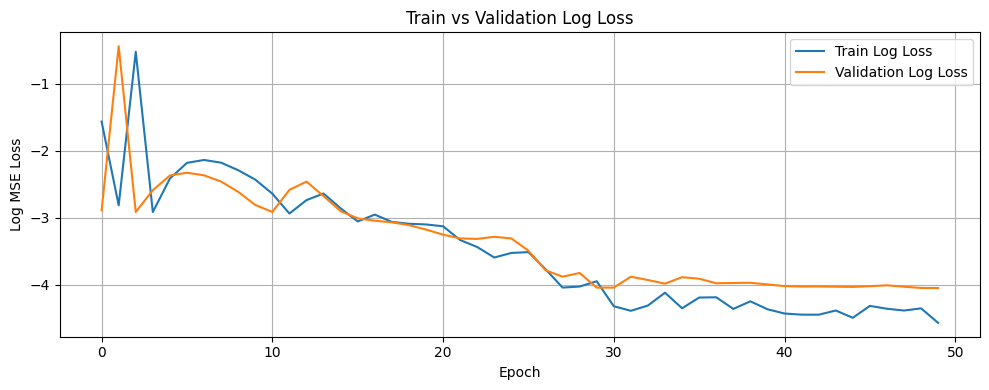

Training completed

=== Processing group: ('04 TO 06', 'TOA PAYOH', '5 ROOM') ===
Group size: 2 rows
Calling prepare_lstm_data for ('04 TO 06', 'TOA PAYOH', '5 ROOM')

Filtering for: TOA PAYOH, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 154
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 45
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2263, Val Loss: 0.2093, Train R²: -2.9424, Val R²: -4.2931
Best model saved!
Epoch 2/50, Train Loss: 0.1030, Val Loss: 0.2630, Train R²: -0.7948, Val R²: -5.6522
Epoch 3/50, Train Loss: 0.5093, Val Loss: 0.1336, Train R²: -7.8708, Val R²: -2.3785
Best model saved!
Epoch 4/50, Train Loss: 0.0665, Val Loss: 0.2754, Train R²: -0.1580,

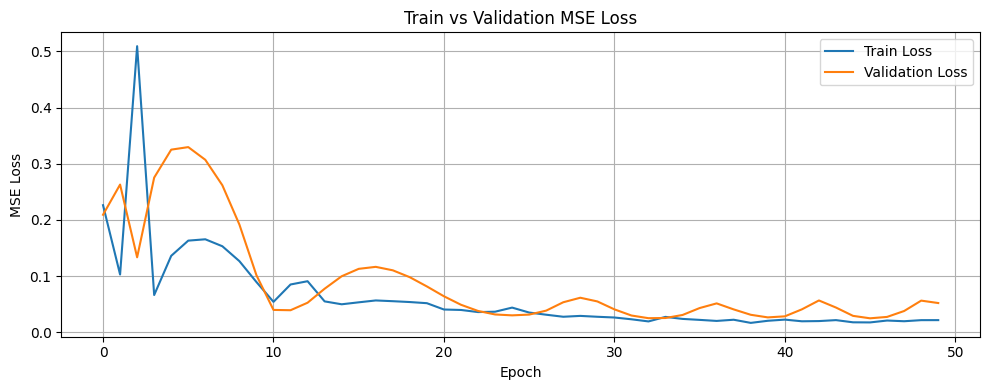

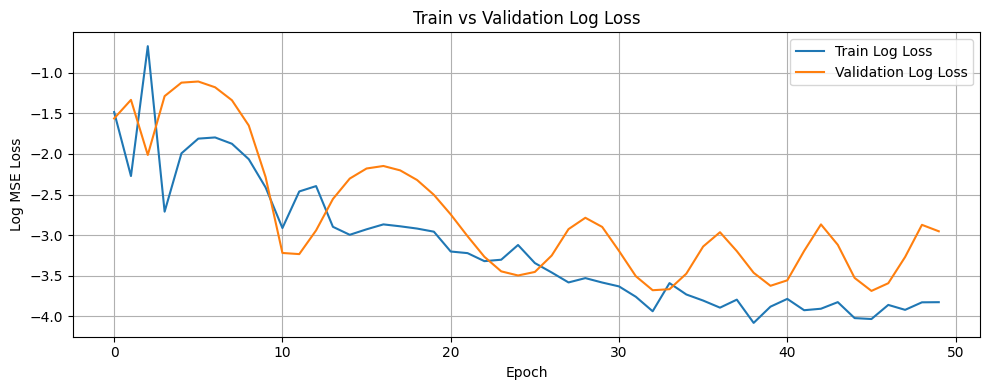

Training completed

=== Processing group: ('04 TO 06', 'TOA PAYOH', 'EXECUTIVE') ===
Group size: 1 rows
Calling prepare_lstm_data for ('04 TO 06', 'TOA PAYOH', 'EXECUTIVE')

Filtering for: TOA PAYOH, EXECUTIVE, 04 TO 06, around 2025-01-01
Initial strict match count: 44
Using before_or_at_target with 43 records.
Removing 'block' column from dataset
Data shapes - x_train: (42, 9), y_train: (42,)
Flattened y shape: (42,), Unique values: 38
Using simple train-validation split (80/20).
Split sizes - Train: 33, Val: 9
Creating PyTorch datasets...
Dataset sizes - Train: 33, Val: 9
Using batch sizes - Train: 33, Val: 9
Starting model training...
Epoch 1/50, Train Loss: 0.2343, Val Loss: 0.0795, Train R²: -2.1250, Val R²: -0.0564
Best model saved!
Epoch 2/50, Train Loss: 0.0873, Val Loss: 1.2079, Train R²: -0.1647, Val R²: -15.0607
Epoch 3/50, Train Loss: 0.9621, Val Loss: 0.1022, Train R²: -11.8318, Val R²: -0.3583
Epoch 4/50, Train Loss: 0.0752, Val Loss: 0.0782, Train R²: -0.0023, Val R²: -0

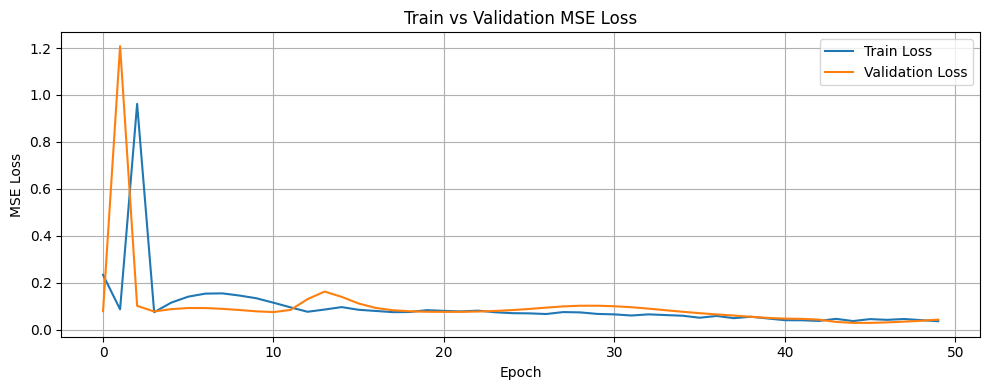

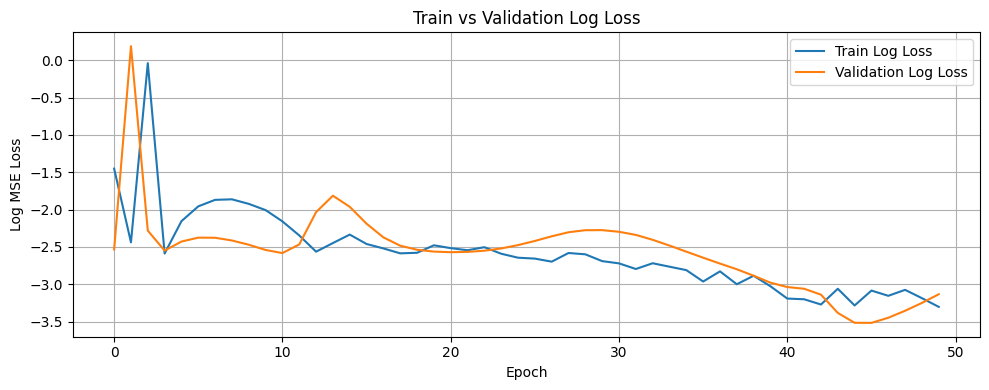

Training completed

=== Processing group: ('04 TO 06', 'WOODLANDS', '3 ROOM') ===
Group size: 13 rows
Calling prepare_lstm_data for ('04 TO 06', 'WOODLANDS', '3 ROOM')

Filtering for: WOODLANDS, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 439
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 40
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3476, Val Loss: 0.0728, Train R²: -3.2087, Val R²: 0.1294
Best model saved!
Epoch 2/50, Train Loss: 0.1072, Val Loss: 0.9721, Train R²: -0.2978, Val R²: -10.6327
Epoch 3/50, Train Loss: 0.6978, Val Loss: 0.0903, Train R²: -7.4497, Val R²: -0.0811
Epoch 4/50, Train Loss: 0.0715, Val Loss: 0.0818, Train R²: 0.1344, Val R²: 0.0209
Ep

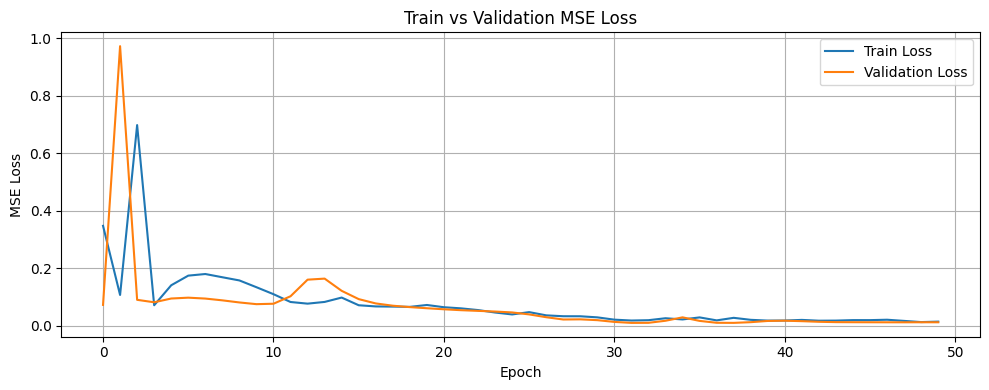

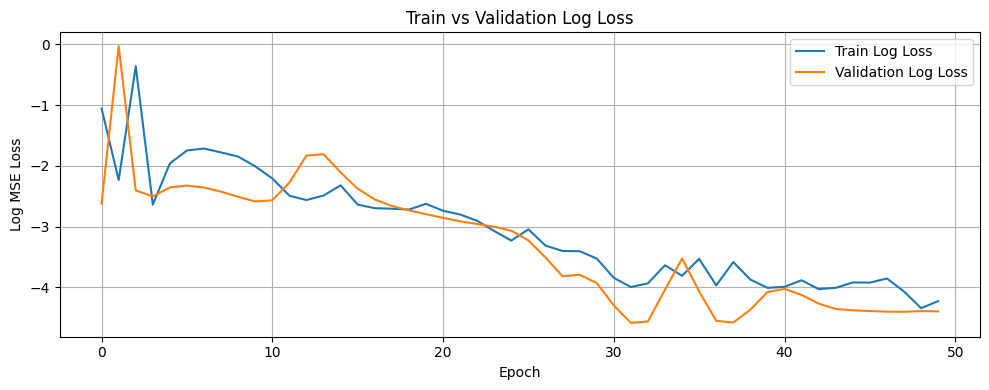

Training completed

=== Processing group: ('04 TO 06', 'WOODLANDS', '4 ROOM') ===
Group size: 45 rows
Calling prepare_lstm_data for ('04 TO 06', 'WOODLANDS', '4 ROOM')

Filtering for: WOODLANDS, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 1594
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 42
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2665, Val Loss: 0.0281, Train R²: -4.8630, Val R²: 0.0021
Best model saved!
Epoch 2/50, Train Loss: 0.0491, Val Loss: 1.3974, Train R²: -0.0810, Val R²: -48.6920
Epoch 3/50, Train Loss: 1.1540, Val Loss: 0.0364, Train R²: -24.3881, Val R²: -0.2959
Epoch 4/50, Train Loss: 0.0461, Val Loss: 0.0549, Train R²: -0.0132, Val R²: -0.952

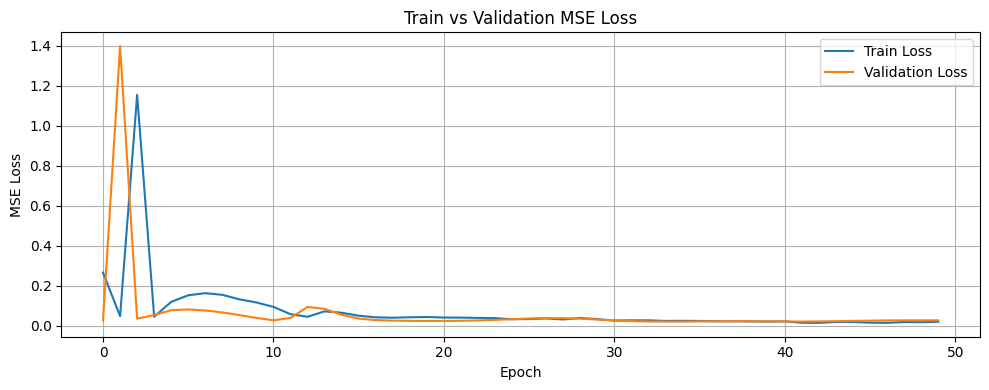

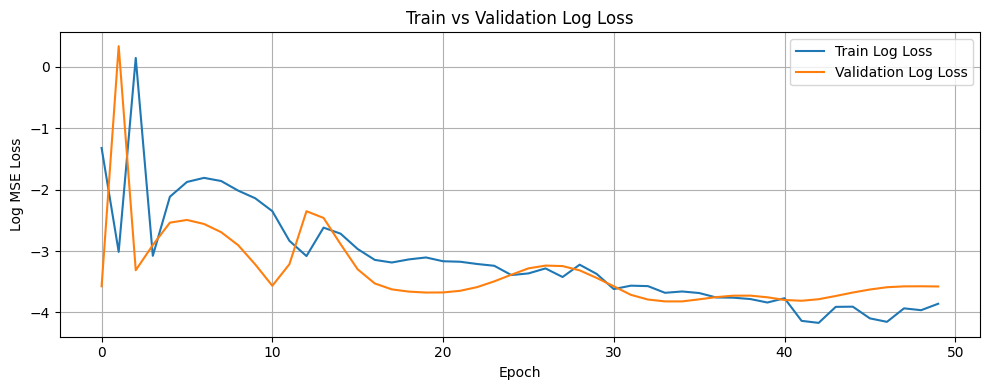

Training completed

=== Processing group: ('04 TO 06', 'WOODLANDS', '5 ROOM') ===
Group size: 29 rows
Calling prepare_lstm_data for ('04 TO 06', 'WOODLANDS', '5 ROOM')

Filtering for: WOODLANDS, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 1158
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3064, Val Loss: 0.0344, Train R²: -6.1866, Val R²: 0.0403
Best model saved!
Epoch 2/50, Train Loss: 0.0679, Val Loss: 1.6220, Train R²: -0.5932, Val R²: -44.2135
Epoch 3/50, Train Loss: 1.3691, Val Loss: 0.0465, Train R²: -31.1071, Val R²: -0.2961
Epoch 4/50, Train Loss: 0.0444, Val Loss: 0.0751, Train R²: -0.0409, Val R²: -1.094

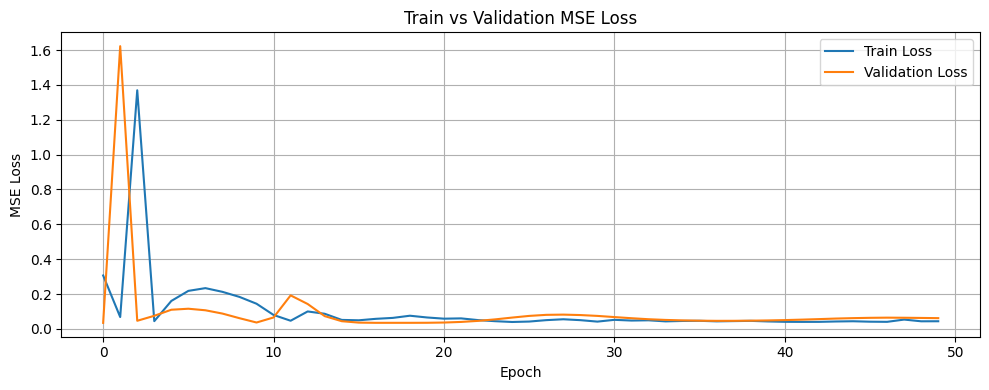

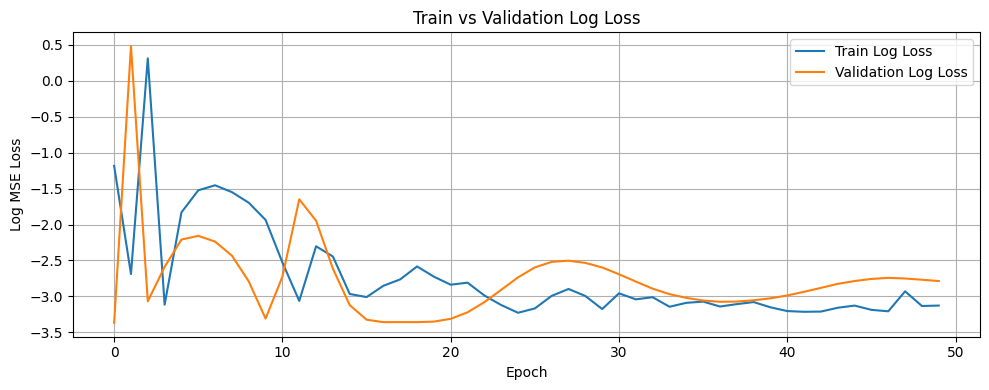

Training completed

=== Processing group: ('04 TO 06', 'WOODLANDS', 'EXECUTIVE') ===
Group size: 10 rows
Calling prepare_lstm_data for ('04 TO 06', 'WOODLANDS', 'EXECUTIVE')

Filtering for: WOODLANDS, EXECUTIVE, 04 TO 06, around 2025-01-01
Initial strict match count: 459
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1649, Val Loss: 0.1607, Train R²: -2.6396, Val R²: -1.5375
Best model saved!
Epoch 2/50, Train Loss: 0.0879, Val Loss: 0.1081, Train R²: -0.9397, Val R²: -0.7064
Best model saved!
Epoch 3/50, Train Loss: 0.1532, Val Loss: 0.1115, Train R²: -2.3814, Val R²: -0.7596
Epoch 4/50, Train Loss: 0.0586, Val Loss: 0.1616, Train R²

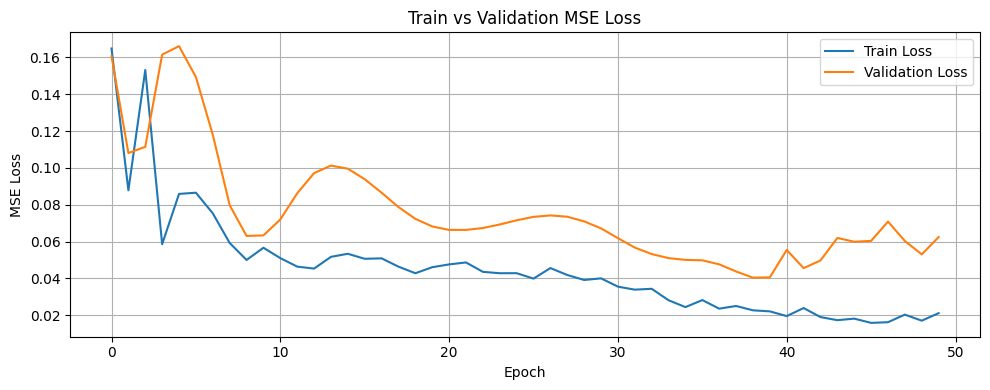

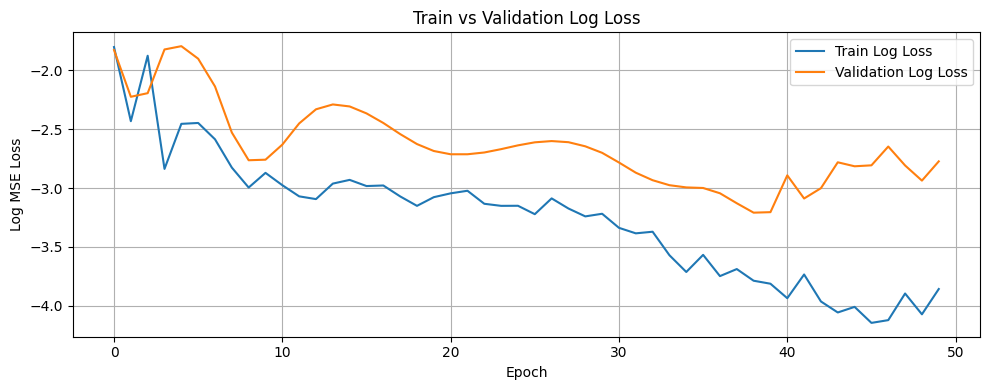

Training completed

=== Processing group: ('04 TO 06', 'YISHUN', '2 ROOM') ===
Group size: 3 rows
Calling prepare_lstm_data for ('04 TO 06', 'YISHUN', '2 ROOM')

Filtering for: YISHUN, 2 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 67
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 31
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.5279, Val Loss: 0.4541, Train R²: -10.0769, Val R²: -50.8392
Best model saved!
Epoch 2/50, Train Loss: 0.3047, Val Loss: 0.0108, Train R²: -5.3938, Val R²: -0.2303
Best model saved!
Epoch 3/50, Train Loss: 0.0926, Val Loss: 0.1271, Train R²: -0.9434, Val R²: -13.5038
Epoch 4/50, Train Loss: 0.0853, Val Loss: 0.1134, Train R²: -0.7893, Val R²

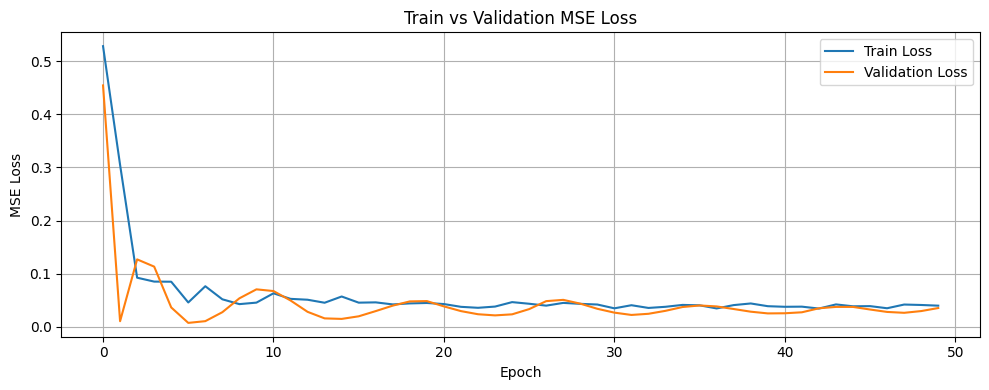

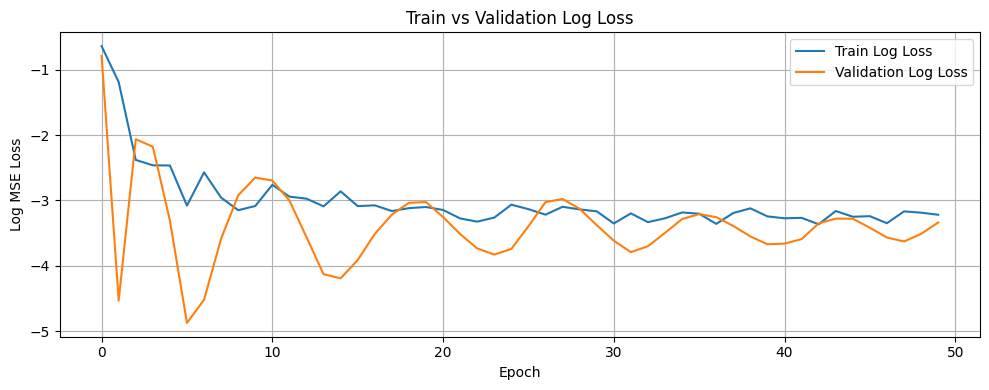

Training completed

=== Processing group: ('04 TO 06', 'YISHUN', '3 ROOM') ===
Group size: 31 rows
Calling prepare_lstm_data for ('04 TO 06', 'YISHUN', '3 ROOM')

Filtering for: YISHUN, 3 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 1090
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1689, Val Loss: 0.0305, Train R²: -2.5578, Val R²: -1.1705
Best model saved!
Epoch 2/50, Train Loss: 0.0640, Val Loss: 0.0362, Train R²: -0.3479, Val R²: -1.5716
Epoch 3/50, Train Loss: 0.0679, Val Loss: 0.0303, Train R²: -0.4311, Val R²: -1.1507
Best model saved!
Epoch 4/50, Train Loss: 0.0606, Val Loss: 0.0152, Train R²: -0.2767, Val R²

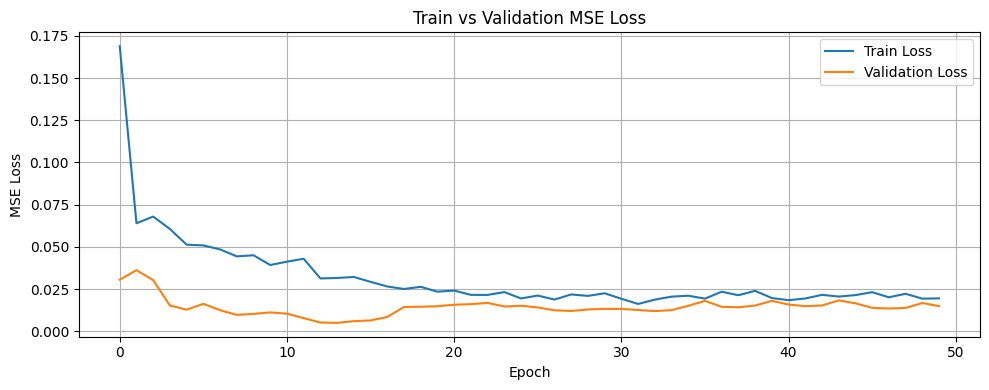

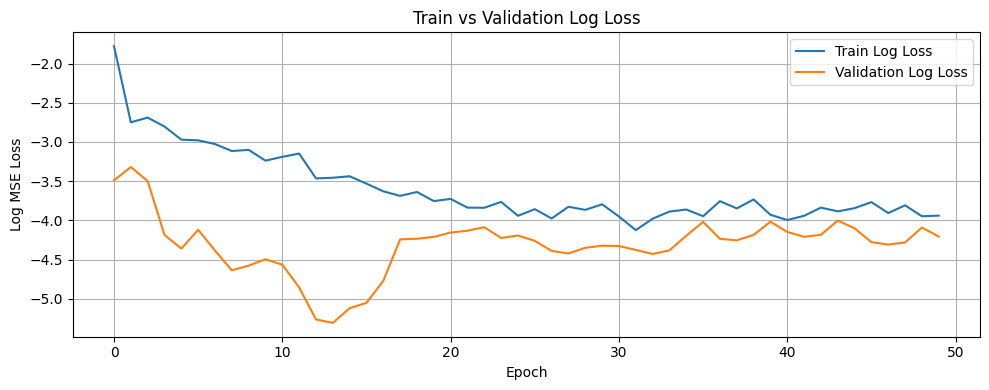

Training completed

=== Processing group: ('04 TO 06', 'YISHUN', '4 ROOM') ===
Group size: 39 rows
Calling prepare_lstm_data for ('04 TO 06', 'YISHUN', '4 ROOM')

Filtering for: YISHUN, 4 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 1791
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1638, Val Loss: 0.0525, Train R²: -2.2214, Val R²: -0.9240
Best model saved!
Epoch 2/50, Train Loss: 0.0736, Val Loss: 0.4091, Train R²: -0.4463, Val R²: -13.9993
Epoch 3/50, Train Loss: 0.4797, Val Loss: 0.0383, Train R²: -8.4329, Val R²: -0.4058
Best model saved!
Epoch 4/50, Train Loss: 0.0528, Val Loss: 0.0978, Train R²: -0.0381, Val R

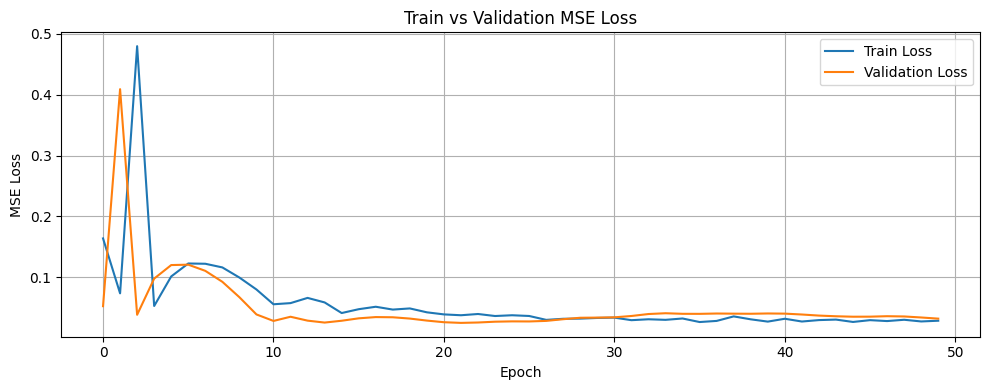

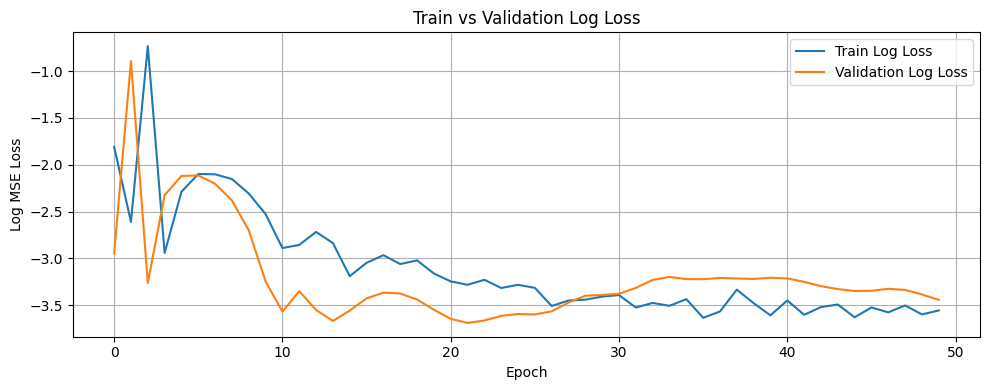

Training completed

=== Processing group: ('04 TO 06', 'YISHUN', '5 ROOM') ===
Group size: 15 rows
Calling prepare_lstm_data for ('04 TO 06', 'YISHUN', '5 ROOM')

Filtering for: YISHUN, 5 ROOM, 04 TO 06, around 2025-01-01
Initial strict match count: 590
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 35
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1134, Val Loss: 0.0479, Train R²: -2.4033, Val R²: -0.0575
Best model saved!
Epoch 2/50, Train Loss: 0.0322, Val Loss: 0.1367, Train R²: 0.0341, Val R²: -2.0147
Epoch 3/50, Train Loss: 0.1616, Val Loss: 0.0586, Train R²: -3.8495, Val R²: -0.2936
Epoch 4/50, Train Loss: 0.0376, Val Loss: 0.0827, Train R²: -0.1284, Val R²: -0.8246
Epoch 5/50

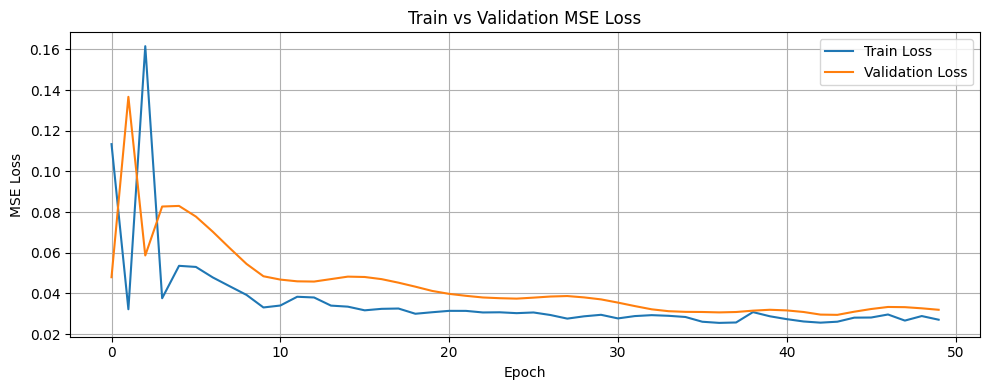

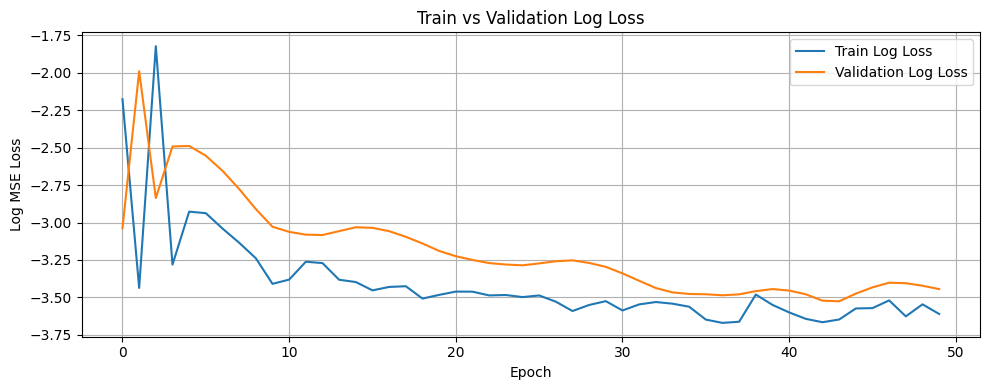

Training completed

=== Processing group: ('04 TO 06', 'YISHUN', 'EXECUTIVE') ===
Group size: 2 rows
Calling prepare_lstm_data for ('04 TO 06', 'YISHUN', 'EXECUTIVE')

Filtering for: YISHUN, EXECUTIVE, 04 TO 06, around 2025-01-01
Initial strict match count: 190
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 39
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3105, Val Loss: 0.1192, Train R²: -9.3534, Val R²: -1.0980
Best model saved!
Epoch 2/50, Train Loss: 0.0758, Val Loss: 0.9197, Train R²: -1.5280, Val R²: -15.1923
Epoch 3/50, Train Loss: 0.9152, Val Loss: 0.0720, Train R²: -29.5198, Val R²: -0.2673
Best model saved!
Epoch 4/50, Train Loss: 0.0359, Val Loss: 0.1908, Train R²: -0.198

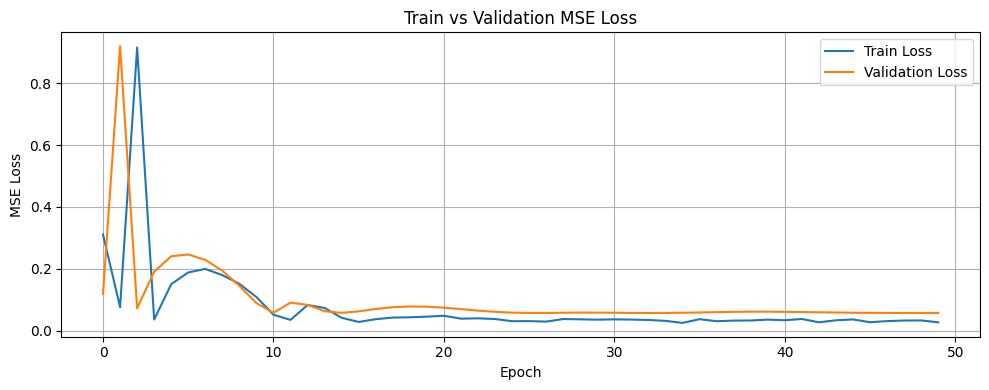

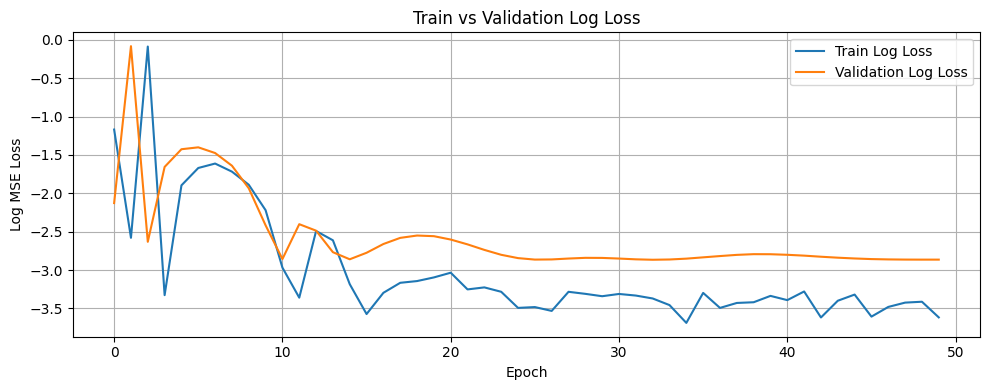

Training completed

=== Processing group: ('07 TO 09', 'ANG MO KIO', '2 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('07 TO 09', 'ANG MO KIO', '2 ROOM')

Filtering for: ANG MO KIO, 2 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 45
Using before_or_at_target with 44 records.
Removing 'block' column from dataset
Data shapes - x_train: (43, 9), y_train: (43,)
Flattened y shape: (43,), Unique values: 33
Using simple train-validation split (80/20).
Split sizes - Train: 34, Val: 9
Creating PyTorch datasets...
Dataset sizes - Train: 34, Val: 9
Using batch sizes - Train: 34, Val: 9
Starting model training...
Epoch 1/50, Train Loss: 0.2646, Val Loss: 0.1167, Train R²: -2.1849, Val R²: -0.8583
Best model saved!
Epoch 2/50, Train Loss: 0.1189, Val Loss: 0.6574, Train R²: -0.4308, Val R²: -9.4658
Epoch 3/50, Train Loss: 0.7680, Val Loss: 0.0791, Train R²: -8.2450, Val R²: -0.2597
Best model saved!
Epoch 4/50, Train Loss: 0.0936, Val Loss: 0.1801, Train R²: -0.1270, 

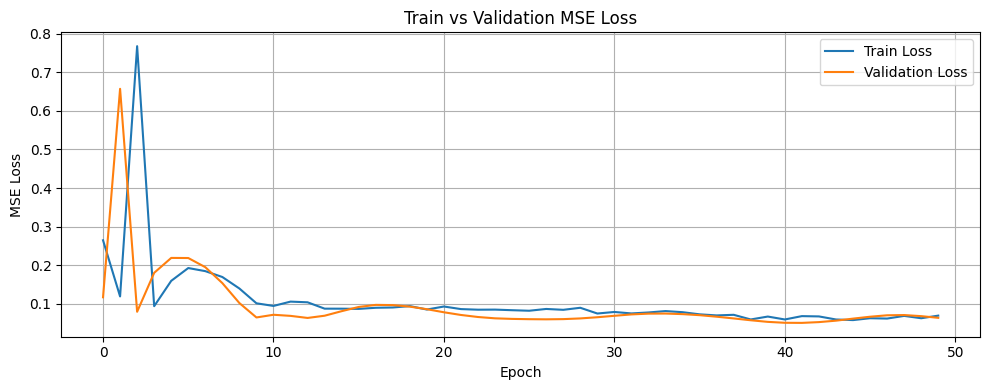

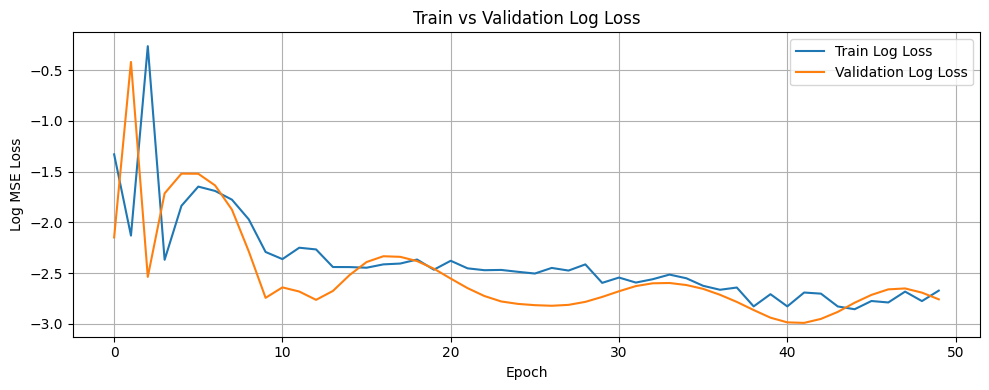

Training completed

=== Processing group: ('07 TO 09', 'ANG MO KIO', '3 ROOM') ===
Group size: 38 rows
Calling prepare_lstm_data for ('07 TO 09', 'ANG MO KIO', '3 ROOM')

Filtering for: ANG MO KIO, 3 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 1098
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 33
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2092, Val Loss: 0.0728, Train R²: -1.6380, Val R²: -0.7483
Best model saved!
Epoch 2/50, Train Loss: 0.1057, Val Loss: 0.3188, Train R²: -0.3327, Val R²: -6.6590
Epoch 3/50, Train Loss: 0.3620, Val Loss: 0.0508, Train R²: -3.5645, Val R²: -0.2198
Best model saved!
Epoch 4/50, Train Loss: 0.0891, Val Loss: 0.0991, Train R²: -0.

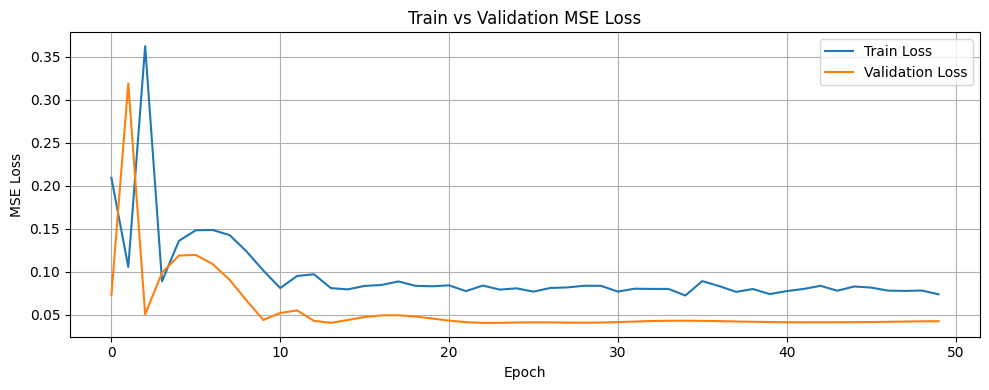

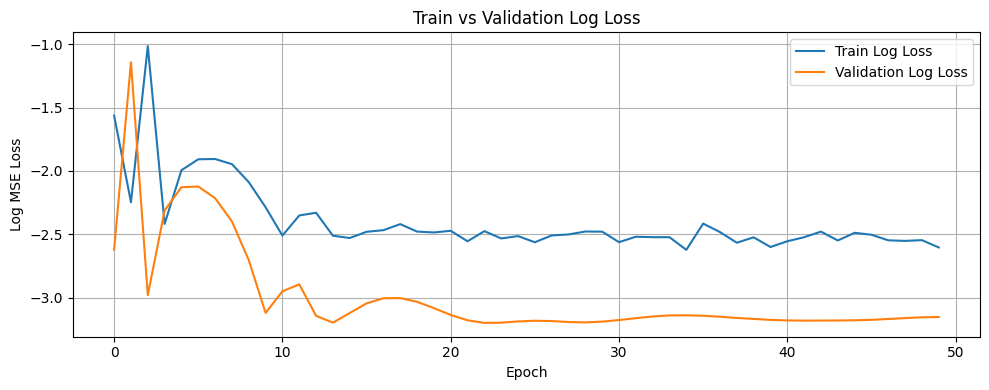

Training completed

=== Processing group: ('07 TO 09', 'ANG MO KIO', '4 ROOM') ===
Group size: 14 rows
Calling prepare_lstm_data for ('07 TO 09', 'ANG MO KIO', '4 ROOM')

Filtering for: ANG MO KIO, 4 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 542
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 35
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1352, Val Loss: 0.0316, Train R²: -0.8157, Val R²: -2.0458
Best model saved!
Epoch 2/50, Train Loss: 0.0726, Val Loss: 0.0130, Train R²: 0.0257, Val R²: -0.2552
Best model saved!
Epoch 3/50, Train Loss: 0.0747, Val Loss: 0.0137, Train R²: -0.0036, Val R²: -0.3207
Epoch 4/50, Train Loss: 0.0719, Val Loss: 0.0199, Train R²: 0.035

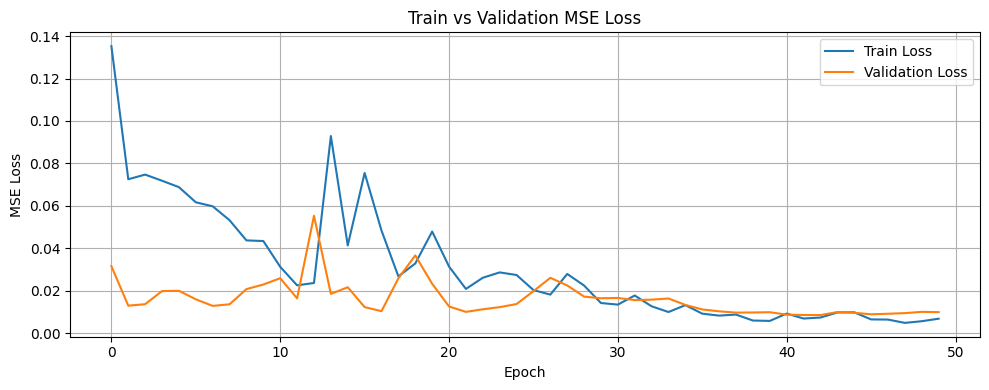

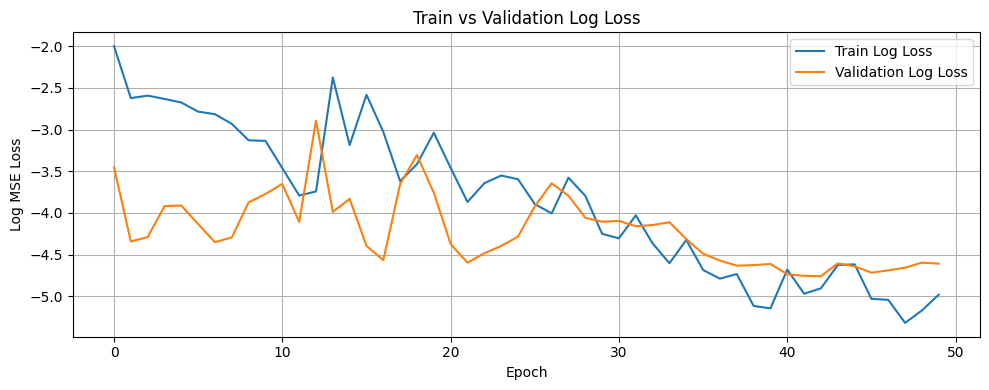

Training completed

=== Processing group: ('07 TO 09', 'ANG MO KIO', '5 ROOM') ===
Group size: 2 rows
Calling prepare_lstm_data for ('07 TO 09', 'ANG MO KIO', '5 ROOM')

Filtering for: ANG MO KIO, 5 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 192
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 39
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.0764, Val Loss: 0.0542, Train R²: -0.3340, Val R²: -0.5164
Best model saved!
Epoch 2/50, Train Loss: 0.0854, Val Loss: 0.0389, Train R²: -0.4908, Val R²: -0.0881
Best model saved!
Epoch 3/50, Train Loss: 0.0586, Val Loss: 0.0473, Train R²: -0.0220, Val R²: -0.3240
Epoch 4/50, Train Loss: 0.0631, Val Loss: 0.0450, Train R²: -0.10

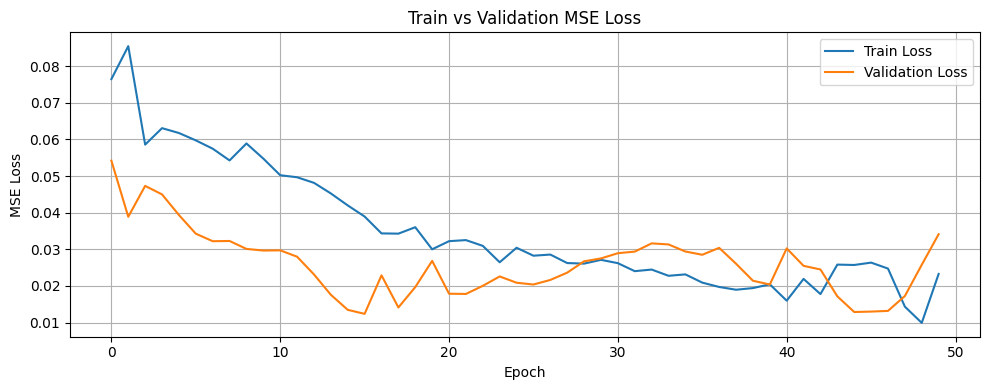

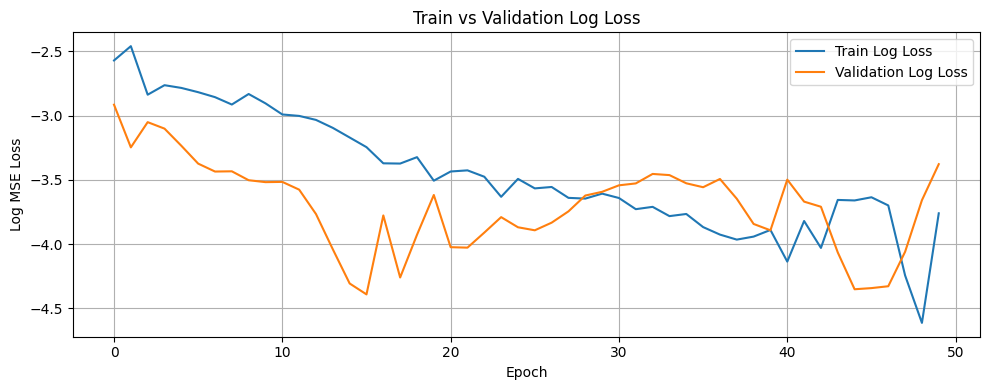

Training completed

=== Processing group: ('07 TO 09', 'ANG MO KIO', 'EXECUTIVE') ===
Group size: 1 rows
Calling prepare_lstm_data for ('07 TO 09', 'ANG MO KIO', 'EXECUTIVE')

Filtering for: ANG MO KIO, EXECUTIVE, 07 TO 09, around 2025-01-01
Initial strict match count: 35
Using before_or_at_target with 35 records.
Removing 'block' column from dataset
Data shapes - x_train: (34, 9), y_train: (34,)
Flattened y shape: (34,), Unique values: 31
Using simple train-validation split (80/20).
Split sizes - Train: 27, Val: 7
Creating PyTorch datasets...
Dataset sizes - Train: 27, Val: 7
Using batch sizes - Train: 27, Val: 7
Starting model training...
Epoch 1/50, Train Loss: 0.2398, Val Loss: 0.0879, Train R²: -3.6898, Val R²: -1.2470
Best model saved!
Epoch 2/50, Train Loss: 0.0766, Val Loss: 0.4612, Train R²: -0.4988, Val R²: -10.7941
Epoch 3/50, Train Loss: 0.5901, Val Loss: 0.0484, Train R²: -10.5432, Val R²: -0.2387
Best model saved!
Epoch 4/50, Train Loss: 0.0525, Val Loss: 0.1342, Train R²

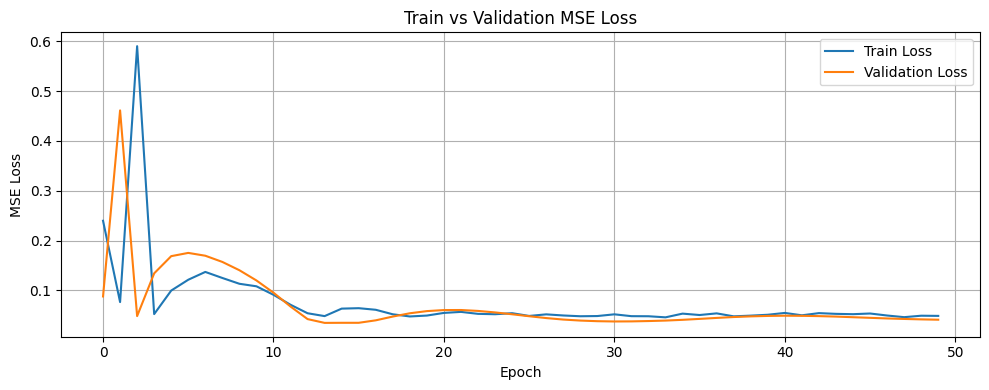

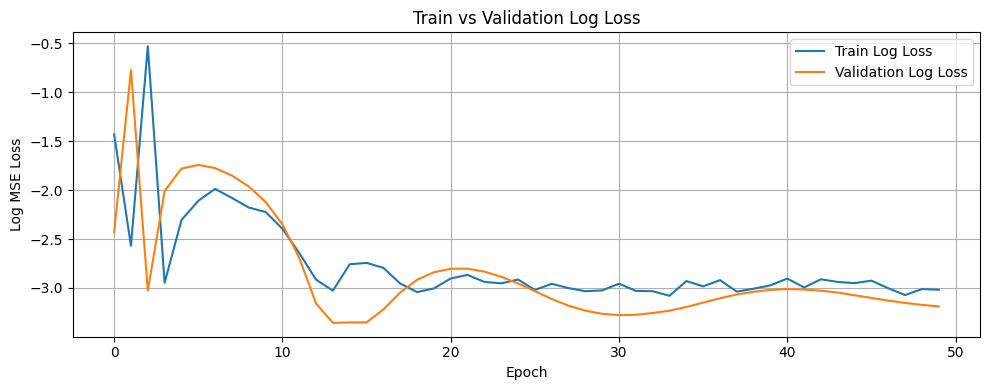

Training completed

=== Processing group: ('07 TO 09', 'BEDOK', '2 ROOM') ===
Group size: 3 rows
Calling prepare_lstm_data for ('07 TO 09', 'BEDOK', '2 ROOM')

Filtering for: BEDOK, 2 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 37
Using before_or_at_target with 34 records.
Removing 'block' column from dataset
Data shapes - x_train: (33, 9), y_train: (33,)
Flattened y shape: (33,), Unique values: 28
Using simple train-validation split (80/20).
Split sizes - Train: 26, Val: 7
Creating PyTorch datasets...
Dataset sizes - Train: 26, Val: 7
Using batch sizes - Train: 26, Val: 7
Starting model training...
Epoch 1/50, Train Loss: 0.2635, Val Loss: 0.0404, Train R²: -2.0613, Val R²: -0.3222
Best model saved!
Epoch 2/50, Train Loss: 0.1077, Val Loss: 0.4227, Train R²: -0.2511, Val R²: -12.8285
Epoch 3/50, Train Loss: 0.3907, Val Loss: 0.0334, Train R²: -3.5399, Val R²: -0.0921
Best model saved!
Epoch 4/50, Train Loss: 0.0828, Val Loss: 0.0514, Train R²: 0.0378, Val R²: -0.6815

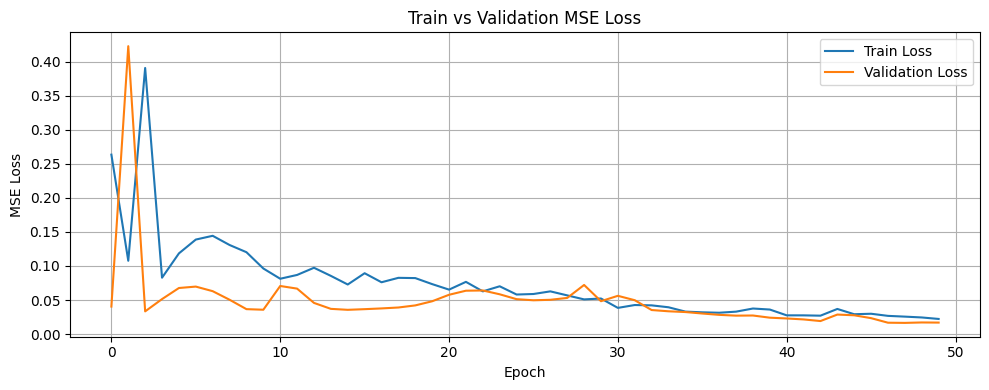

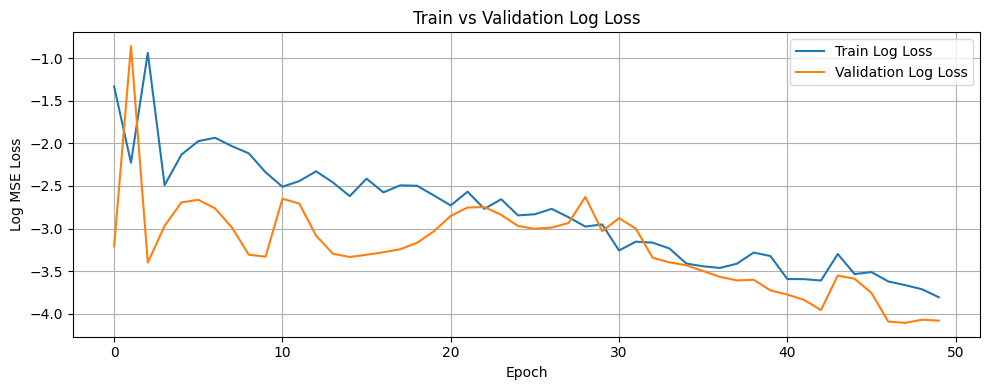

Training completed

=== Processing group: ('07 TO 09', 'BEDOK', '3 ROOM') ===
Group size: 28 rows
Calling prepare_lstm_data for ('07 TO 09', 'BEDOK', '3 ROOM')

Filtering for: BEDOK, 3 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 999
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 40
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1193, Val Loss: 0.0293, Train R²: -2.0552, Val R²: -0.9492
Best model saved!
Epoch 2/50, Train Loss: 0.0564, Val Loss: 0.3601, Train R²: -0.4447, Val R²: -22.9802
Epoch 3/50, Train Loss: 0.3887, Val Loss: 0.0153, Train R²: -8.9575, Val R²: -0.0181
Best model saved!
Epoch 4/50, Train Loss: 0.0414, Val Loss: 0.0610, Train R²: -0.0607, Val R²: -

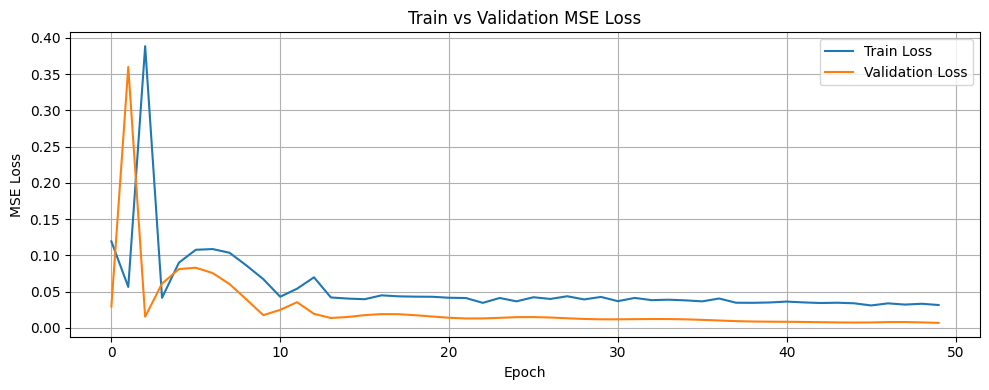

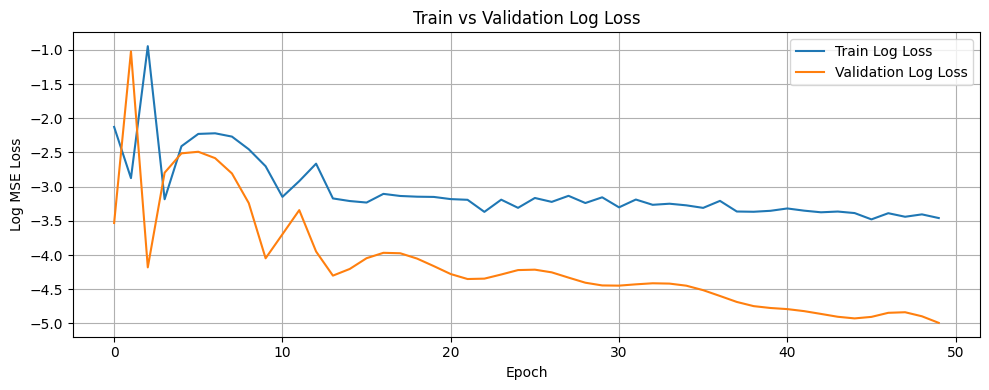

Training completed

=== Processing group: ('07 TO 09', 'BEDOK', '4 ROOM') ===
Group size: 16 rows
Calling prepare_lstm_data for ('07 TO 09', 'BEDOK', '4 ROOM')

Filtering for: BEDOK, 4 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 797
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1627, Val Loss: 0.0402, Train R²: -0.9546, Val R²: 0.0532
Best model saved!
Epoch 2/50, Train Loss: 0.0830, Val Loss: 0.0403, Train R²: 0.0024, Val R²: 0.0519
Epoch 3/50, Train Loss: 0.0749, Val Loss: 0.0374, Train R²: 0.1004, Val R²: 0.1187
Best model saved!
Epoch 4/50, Train Loss: 0.0829, Val Loss: 0.0487, Train R²: 0.0037, Val R²: -0.1470


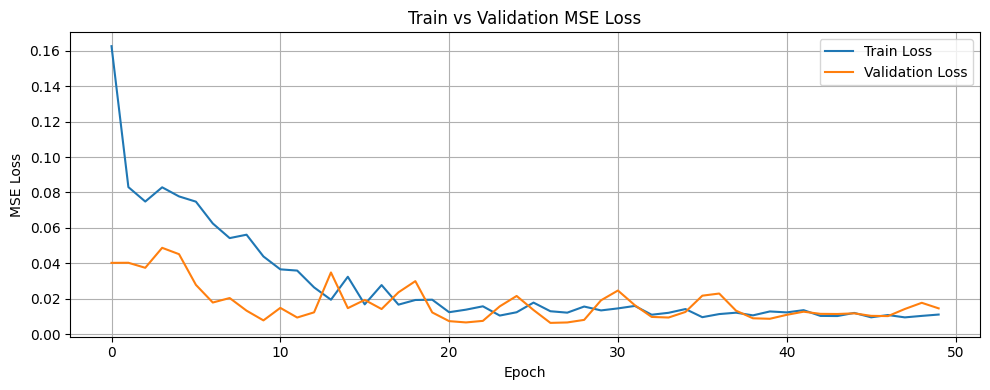

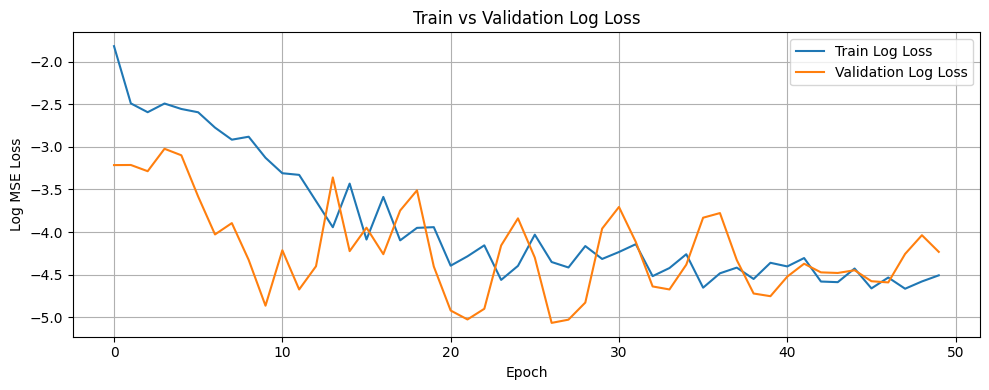

Training completed

=== Processing group: ('07 TO 09', 'BEDOK', '5 ROOM') ===
Group size: 11 rows
Calling prepare_lstm_data for ('07 TO 09', 'BEDOK', '5 ROOM')

Filtering for: BEDOK, 5 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 368
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 38
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1534, Val Loss: 0.0716, Train R²: -0.8413, Val R²: 0.0226
Best model saved!
Epoch 2/50, Train Loss: 0.0858, Val Loss: 0.0710, Train R²: -0.0296, Val R²: 0.0303
Best model saved!
Epoch 3/50, Train Loss: 0.0911, Val Loss: 0.0764, Train R²: -0.0930, Val R²: -0.0428
Epoch 4/50, Train Loss: 0.0838, Val Loss: 0.0712, Train R²: -0.0058, Val R²: 0.02

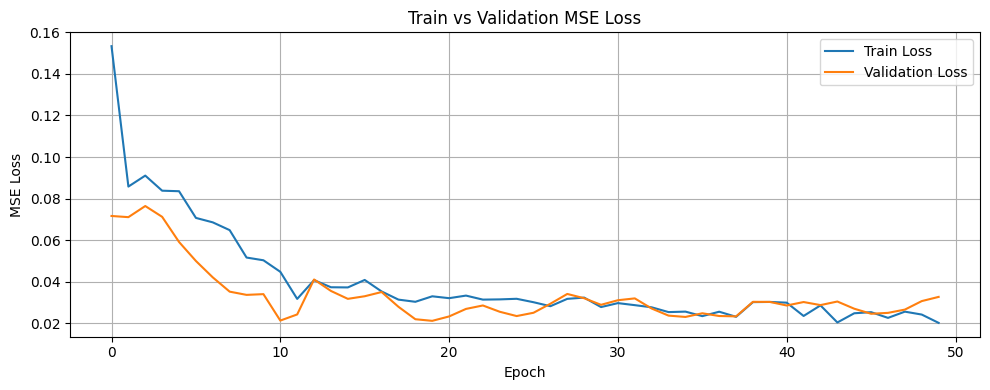

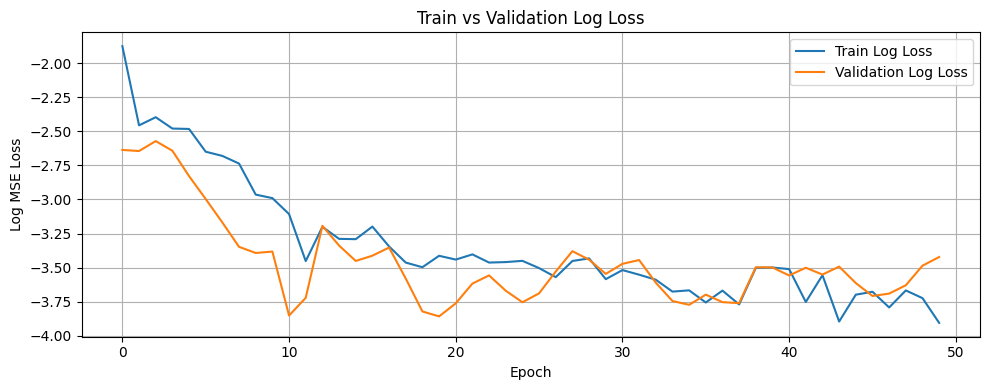

Training completed

=== Processing group: ('07 TO 09', 'BEDOK', 'EXECUTIVE') ===
Group size: 4 rows
Calling prepare_lstm_data for ('07 TO 09', 'BEDOK', 'EXECUTIVE')

Filtering for: BEDOK, EXECUTIVE, 07 TO 09, around 2025-01-01
Initial strict match count: 99
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2653, Val Loss: 0.1859, Train R²: -4.1499, Val R²: -2.3737
Best model saved!
Epoch 2/50, Train Loss: 0.0953, Val Loss: 0.3608, Train R²: -0.8499, Val R²: -5.5496
Epoch 3/50, Train Loss: 0.5754, Val Loss: 0.1170, Train R²: -10.1677, Val R²: -1.1243
Best model saved!
Epoch 4/50, Train Loss: 0.0615, Val Loss: 0.2514, Train R²: -0.1927, Va

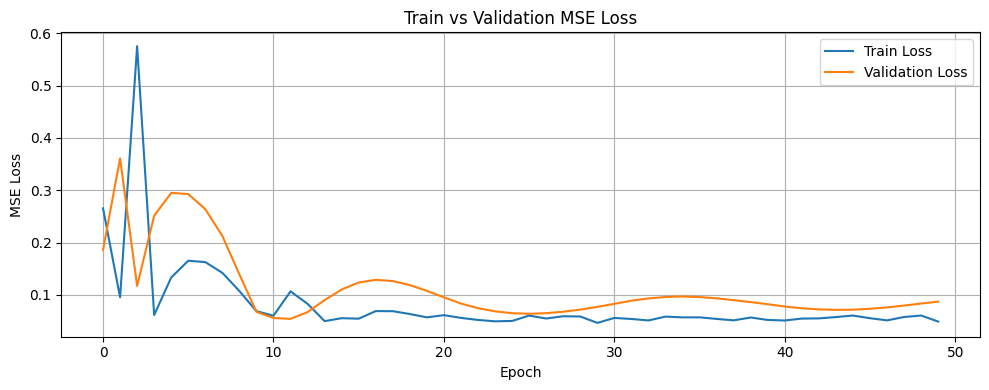

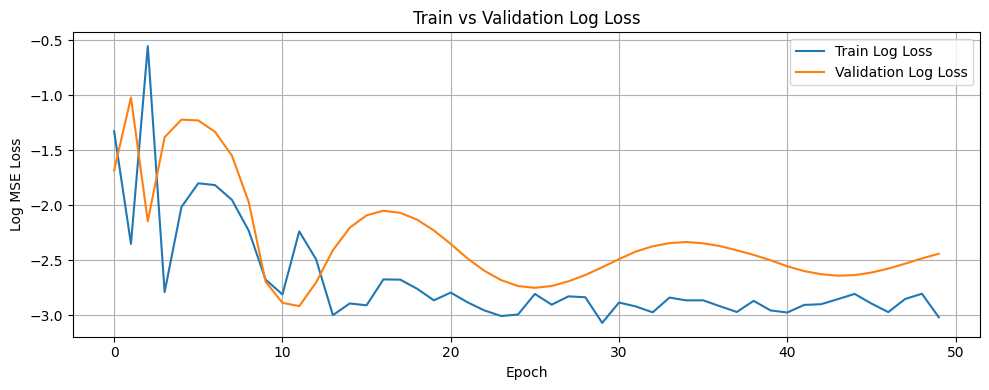

Training completed

=== Processing group: ('07 TO 09', 'BISHAN', '3 ROOM') ===
Group size: 4 rows
Calling prepare_lstm_data for ('07 TO 09', 'BISHAN', '3 ROOM')

Filtering for: BISHAN, 3 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 99
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2910, Val Loss: 0.1430, Train R²: -2.4781, Val R²: -0.4125
Best model saved!
Epoch 2/50, Train Loss: 0.1078, Val Loss: 0.6134, Train R²: -0.2892, Val R²: -5.0579
Epoch 3/50, Train Loss: 0.6772, Val Loss: 0.1043, Train R²: -7.0957, Val R²: -0.0300
Best model saved!
Epoch 4/50, Train Loss: 0.0829, Val Loss: 0.1826, Train R²: 0.0091, Val R²: -0

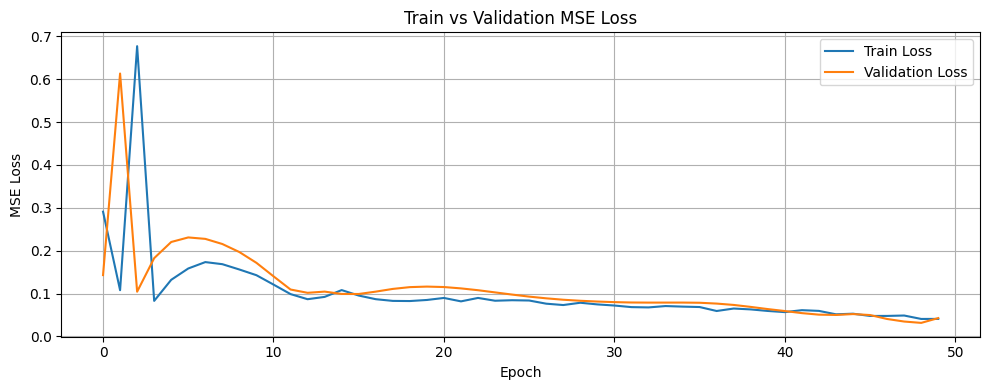

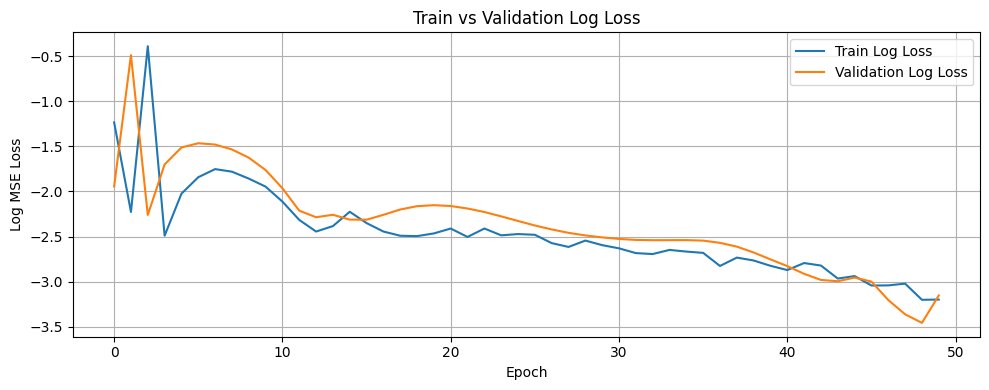

Training completed

=== Processing group: ('07 TO 09', 'BISHAN', '4 ROOM') ===
Group size: 8 rows
Calling prepare_lstm_data for ('07 TO 09', 'BISHAN', '4 ROOM')

Filtering for: BISHAN, 4 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 419
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 43
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1828, Val Loss: 0.1035, Train R²: -4.8636, Val R²: -3.0104
Best model saved!
Epoch 2/50, Train Loss: 0.0478, Val Loss: 0.1632, Train R²: -0.5337, Val R²: -5.3245
Epoch 3/50, Train Loss: 0.3270, Val Loss: 0.0558, Train R²: -9.4865, Val R²: -1.1625
Best model saved!
Epoch 4/50, Train Loss: 0.0281, Val Loss: 0.1278, Train R²: 0.0986, Val R²: -

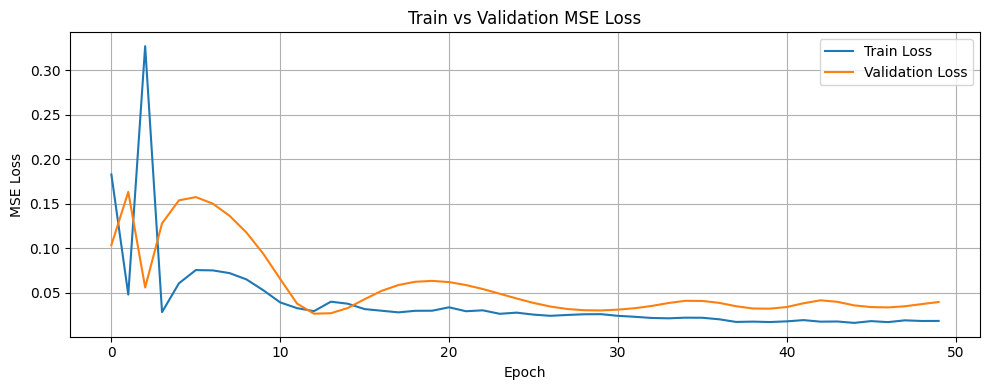

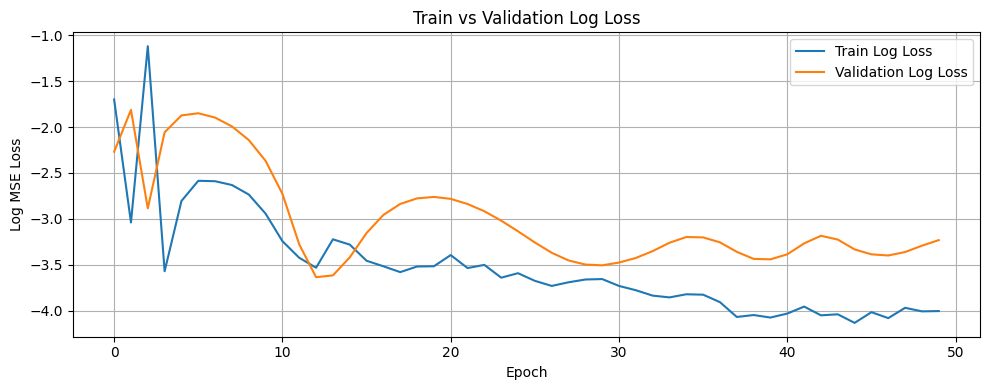

Training completed

=== Processing group: ('07 TO 09', 'BISHAN', '5 ROOM') ===
Group size: 4 rows
Calling prepare_lstm_data for ('07 TO 09', 'BISHAN', '5 ROOM')

Filtering for: BISHAN, 5 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 215
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 43
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1544, Val Loss: 0.0211, Train R²: -4.0944, Val R²: -0.1255
Best model saved!
Epoch 2/50, Train Loss: 0.0324, Val Loss: 0.4556, Train R²: -0.0708, Val R²: -23.2561
Epoch 3/50, Train Loss: 0.5263, Val Loss: 0.0183, Train R²: -16.3689, Val R²: 0.0244
Best model saved!
Epoch 4/50, Train Loss: 0.0295, Val Loss: 0.0498, Train R²: 0.0262, Val R²: 

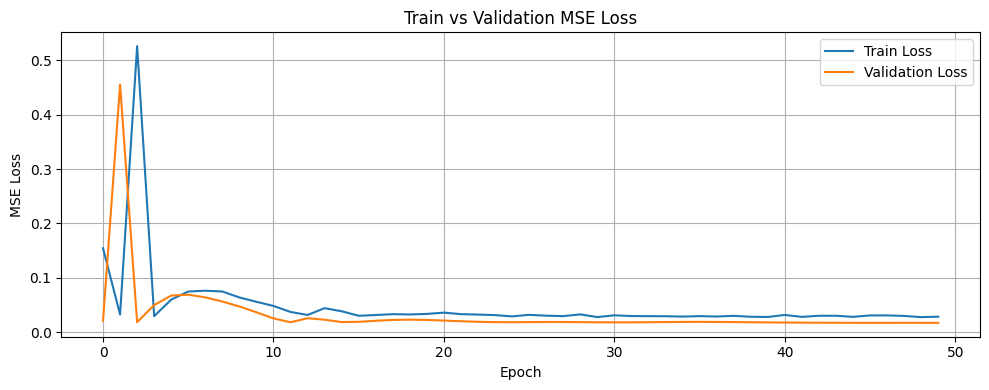

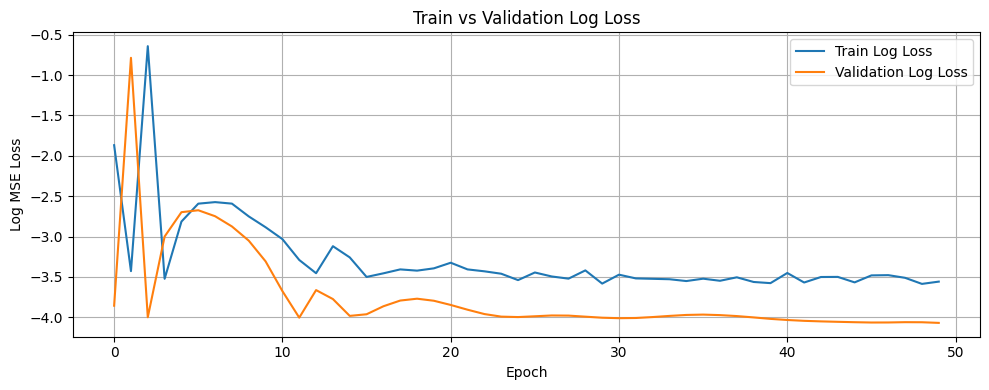

Training completed

=== Processing group: ('07 TO 09', 'BUKIT BATOK', '2 ROOM') ===
Group size: 2 rows
Calling prepare_lstm_data for ('07 TO 09', 'BUKIT BATOK', '2 ROOM')

Filtering for: BUKIT BATOK, 2 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 30
Using before_or_at_target with 28 records.
Removing 'block' column from dataset
Data shapes - x_train: (27, 9), y_train: (27,)
Flattened y shape: (27,), Unique values: 18
Using simple train-validation split (80/20).
Split sizes - Train: 21, Val: 6
Creating PyTorch datasets...
Dataset sizes - Train: 21, Val: 6
Using batch sizes - Train: 21, Val: 6
Starting model training...
Epoch 1/50, Train Loss: 0.3871, Val Loss: 0.0736, Train R²: -5.6049, Val R²: -0.4412
Best model saved!
Epoch 2/50, Train Loss: 0.1454, Val Loss: 0.3692, Train R²: -1.4801, Val R²: -6.2288
Epoch 3/50, Train Loss: 0.2400, Val Loss: 0.0525, Train R²: -3.0948, Val R²: -0.0274
Best model saved!
Epoch 4/50, Train Loss: 0.0724, Val Loss: 0.0617, Train R²: -0.234

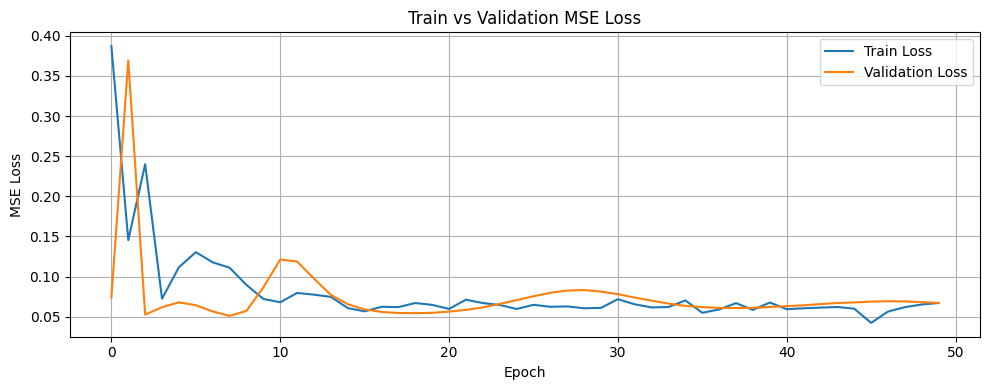

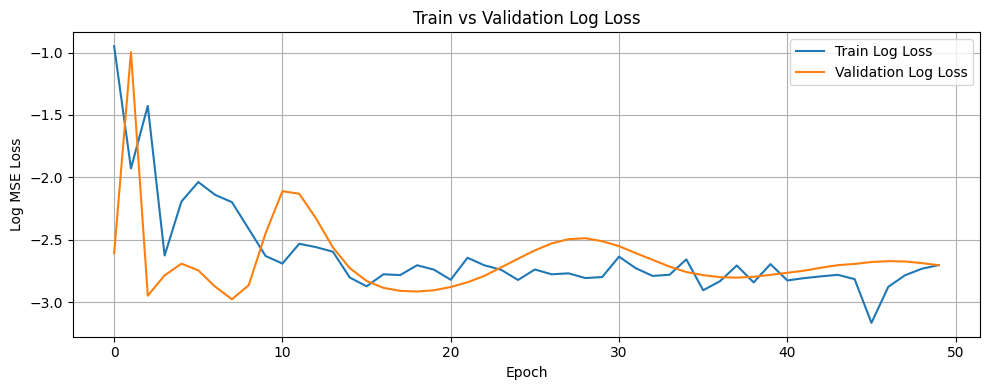

Training completed

=== Processing group: ('07 TO 09', 'BUKIT BATOK', '3 ROOM') ===
Group size: 13 rows
Calling prepare_lstm_data for ('07 TO 09', 'BUKIT BATOK', '3 ROOM')

Filtering for: BUKIT BATOK, 3 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 564
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 33
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1951, Val Loss: 0.0571, Train R²: -2.3568, Val R²: -0.1572
Best model saved!
Epoch 2/50, Train Loss: 0.0719, Val Loss: 0.7727, Train R²: -0.2371, Val R²: -14.6607
Epoch 3/50, Train Loss: 0.6999, Val Loss: 0.0500, Train R²: -11.0413, Val R²: -0.0135
Best model saved!
Epoch 4/50, Train Loss: 0.0577, Val Loss: 0.0828, Train R²:

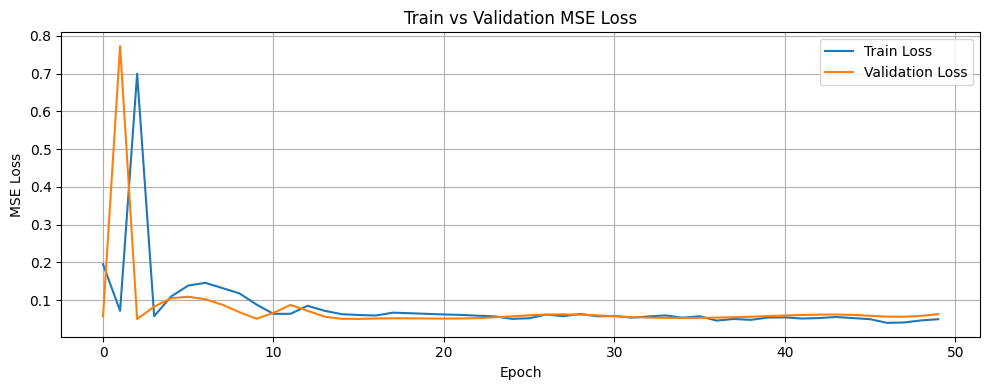

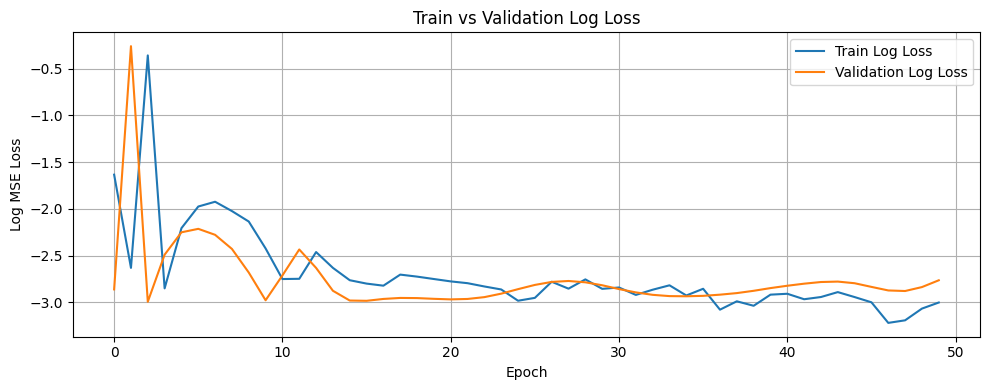

Training completed

=== Processing group: ('07 TO 09', 'BUKIT BATOK', '4 ROOM') ===
Group size: 21 rows
Calling prepare_lstm_data for ('07 TO 09', 'BUKIT BATOK', '4 ROOM')

Filtering for: BUKIT BATOK, 4 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 740
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 38
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2697, Val Loss: 0.0534, Train R²: -4.3388, Val R²: -0.5838
Best model saved!
Epoch 2/50, Train Loss: 0.0665, Val Loss: 0.7729, Train R²: -0.3169, Val R²: -21.9275
Epoch 3/50, Train Loss: 0.8073, Val Loss: 0.0323, Train R²: -14.9779, Val R²: 0.0423
Best model saved!
Epoch 4/50, Train Loss: 0.0521, Val Loss: 0.0915, Train R²: 

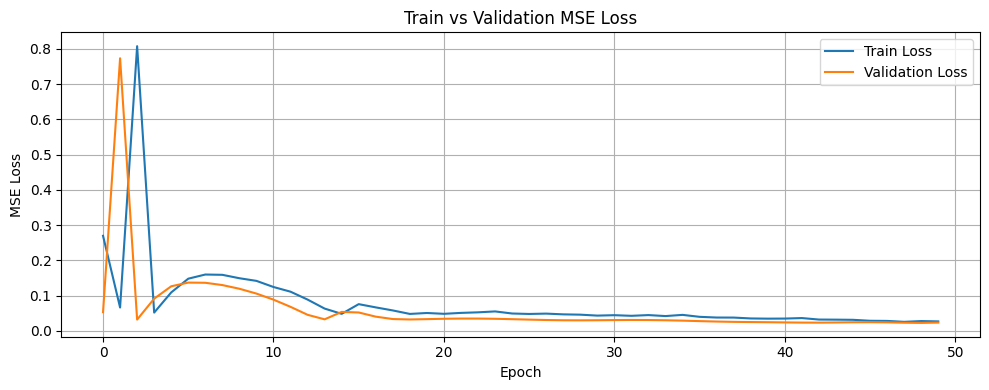

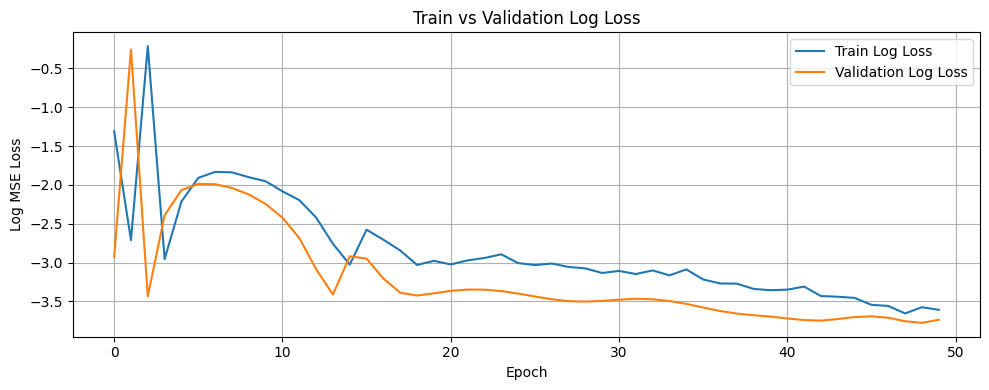

Training completed

=== Processing group: ('07 TO 09', 'BUKIT BATOK', '5 ROOM') ===
Group size: 6 rows
Calling prepare_lstm_data for ('07 TO 09', 'BUKIT BATOK', '5 ROOM')

Filtering for: BUKIT BATOK, 5 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 248
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3074, Val Loss: 0.0869, Train R²: -4.8522, Val R²: -0.4900
Best model saved!
Epoch 2/50, Train Loss: 0.0784, Val Loss: 0.5797, Train R²: -0.4927, Val R²: -8.9462
Epoch 3/50, Train Loss: 0.6371, Val Loss: 0.0556, Train R²: -11.1270, Val R²: 0.0467
Best model saved!
Epoch 4/50, Train Loss: 0.0435, Val Loss: 0.1131, Train R²: 0.

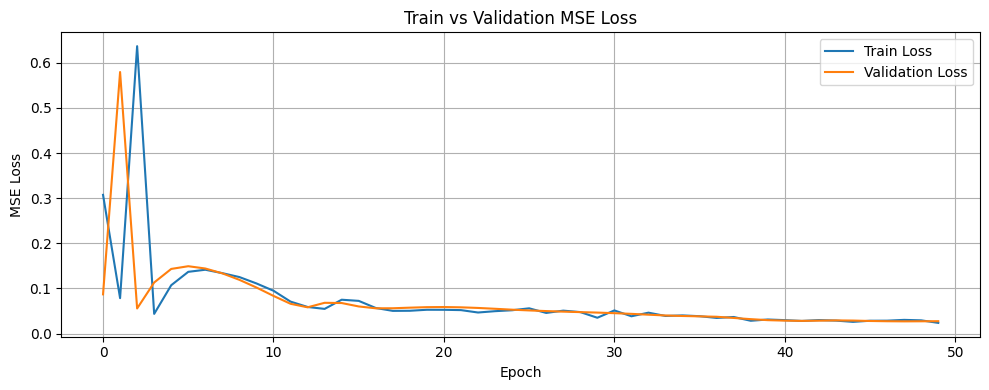

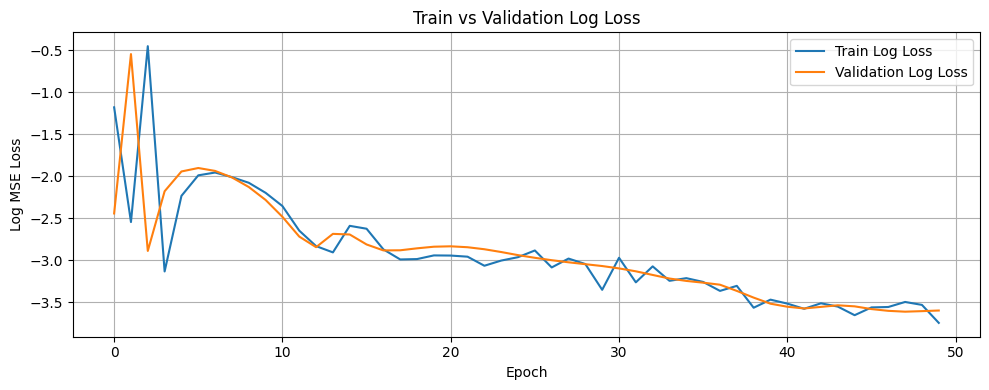

Training completed

=== Processing group: ('07 TO 09', 'BUKIT BATOK', 'EXECUTIVE') ===
Group size: 2 rows
Calling prepare_lstm_data for ('07 TO 09', 'BUKIT BATOK', 'EXECUTIVE')

Filtering for: BUKIT BATOK, EXECUTIVE, 07 TO 09, around 2025-01-01
Initial strict match count: 114
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2119, Val Loss: 0.0667, Train R²: -3.3844, Val R²: -3.3251
Best model saved!
Epoch 2/50, Train Loss: 0.0629, Val Loss: 0.1657, Train R²: -0.3023, Val R²: -9.7425
Epoch 3/50, Train Loss: 0.3013, Val Loss: 0.0280, Train R²: -5.2353, Val R²: -0.8149
Best model saved!
Epoch 4/50, Train Loss: 0.0500, Val Loss: 0.0775, Tra

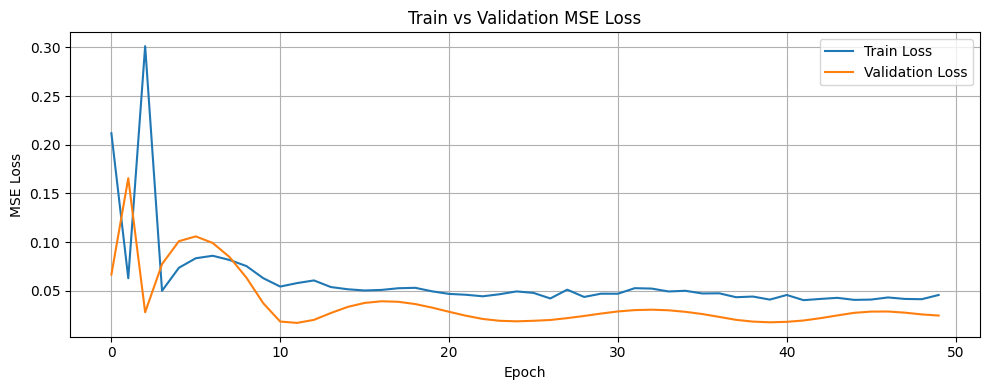

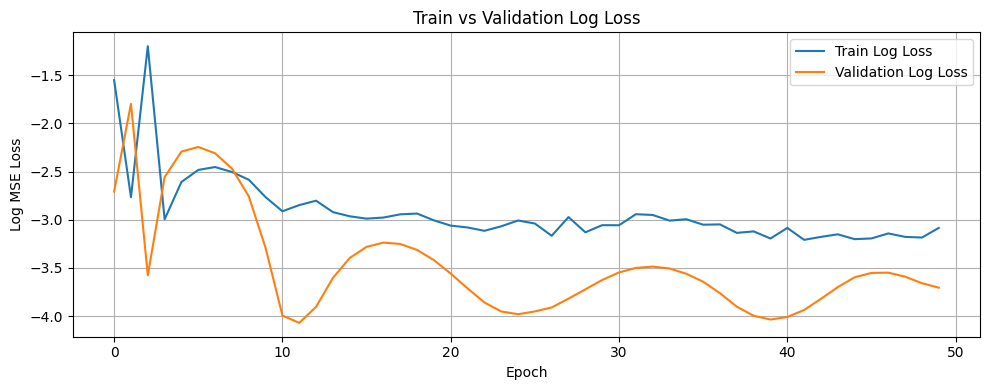

Training completed

=== Processing group: ('07 TO 09', 'BUKIT MERAH', '1 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('07 TO 09', 'BUKIT MERAH', '1 ROOM')

Filtering for: BUKIT MERAH, 1 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 17
Using before_or_at_target with 16 records.
Removing 'block' column from dataset
Data shapes - x_train: (15, 9), y_train: (15,)
Flattened y shape: (15,), Unique values: 12
Using simple train-validation split (80/20).
Split sizes - Train: 12, Val: 3
Creating PyTorch datasets...
Dataset sizes - Train: 12, Val: 3
Using batch sizes - Train: 12, Val: 3
Starting model training...
Epoch 1/50, Train Loss: 0.2343, Val Loss: 0.0979, Train R²: -1.5631, Val R²: -19.1304
Best model saved!
Epoch 2/50, Train Loss: 0.1391, Val Loss: 0.0551, Train R²: -0.5222, Val R²: -10.3260
Best model saved!
Epoch 3/50, Train Loss: 0.2061, Val Loss: 0.0470, Train R²: -1.2544, Val R²: -8.6586
Best model saved!
Epoch 4/50, Train Loss: 0.1024, Val Loss: 0.09

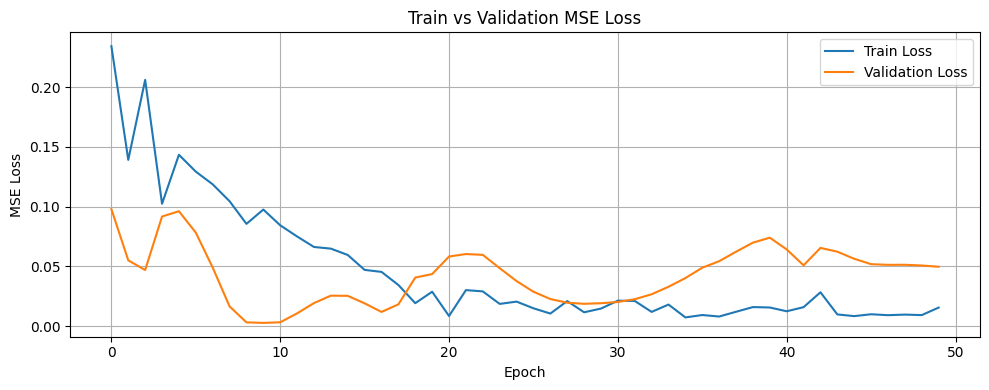

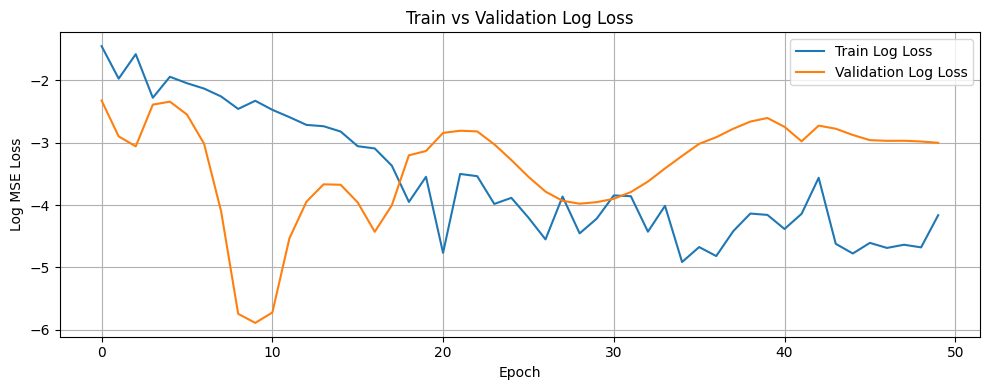

Training completed

=== Processing group: ('07 TO 09', 'BUKIT MERAH', '3 ROOM') ===
Group size: 12 rows
Calling prepare_lstm_data for ('07 TO 09', 'BUKIT MERAH', '3 ROOM')

Filtering for: BUKIT MERAH, 3 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 552
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 42
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1186, Val Loss: 0.1177, Train R²: -1.2948, Val R²: -0.4055
Best model saved!
Epoch 2/50, Train Loss: 0.0539, Val Loss: 0.3059, Train R²: -0.0424, Val R²: -2.6542
Epoch 3/50, Train Loss: 0.4445, Val Loss: 0.1135, Train R²: -7.6017, Val R²: -0.3552
Best model saved!
Epoch 4/50, Train Loss: 0.0500, Val Loss: 0.1903, Train R²: 0

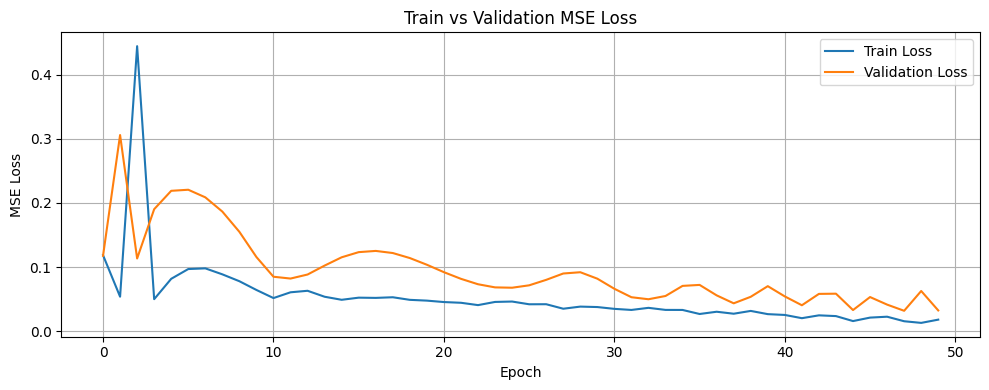

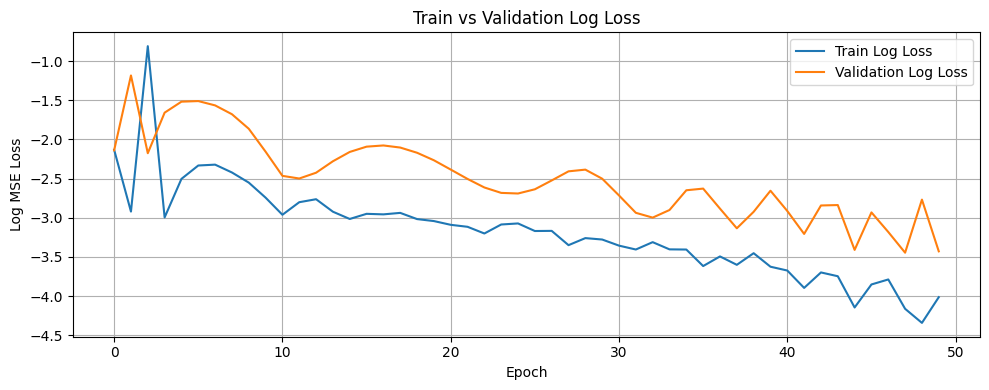

Training completed

=== Processing group: ('07 TO 09', 'BUKIT MERAH', '4 ROOM') ===
Group size: 12 rows
Calling prepare_lstm_data for ('07 TO 09', 'BUKIT MERAH', '4 ROOM')

Filtering for: BUKIT MERAH, 4 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 434
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 42
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2163, Val Loss: 0.0699, Train R²: -1.4470, Val R²: -0.3570
Best model saved!
Epoch 2/50, Train Loss: 0.0942, Val Loss: 0.1553, Train R²: -0.0657, Val R²: -2.0143
Epoch 3/50, Train Loss: 0.0910, Val Loss: 0.1153, Train R²: -0.0299, Val R²: -1.2377
Epoch 4/50, Train Loss: 0.0805, Val Loss: 0.0676, Train R²: 0.0898, Val R²: -0.

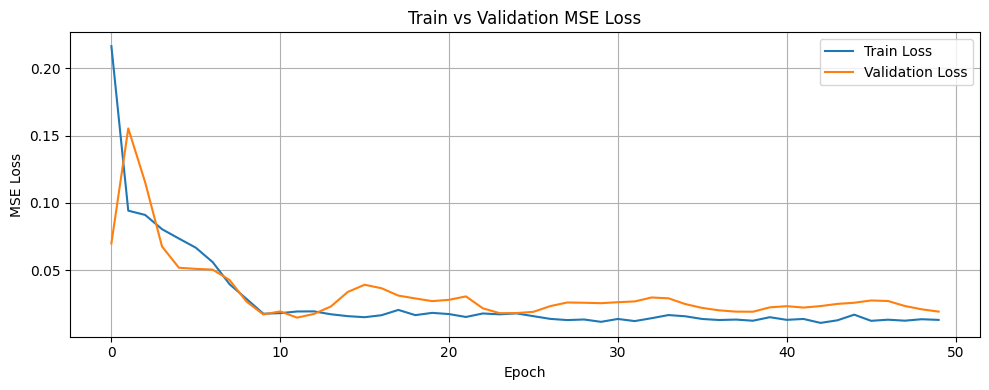

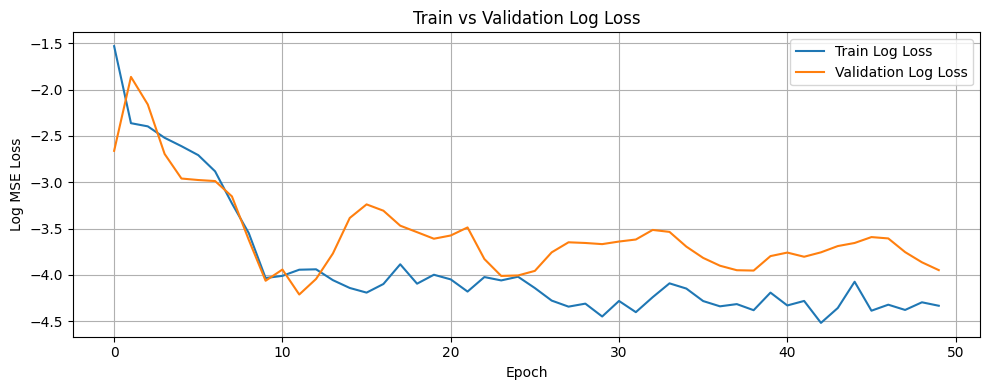

Training completed

=== Processing group: ('07 TO 09', 'BUKIT MERAH', '5 ROOM') ===
Group size: 6 rows
Calling prepare_lstm_data for ('07 TO 09', 'BUKIT MERAH', '5 ROOM')

Filtering for: BUKIT MERAH, 5 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 203
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 42
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2260, Val Loss: 0.0683, Train R²: -2.9671, Val R²: -0.2400
Best model saved!
Epoch 2/50, Train Loss: 0.0734, Val Loss: 0.7894, Train R²: -0.2893, Val R²: -13.3254
Epoch 3/50, Train Loss: 0.8007, Val Loss: 0.0555, Train R²: -13.0561, Val R²: -0.0077
Best model saved!
Epoch 4/50, Train Loss: 0.0636, Val Loss: 0.1100, Train R²: 

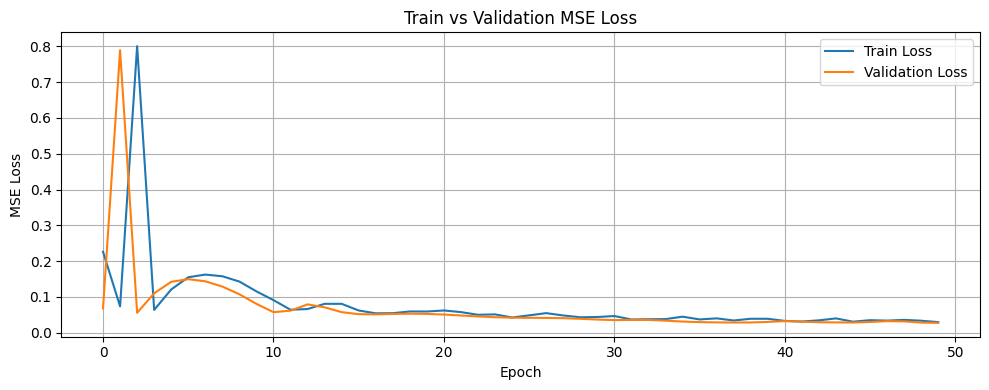

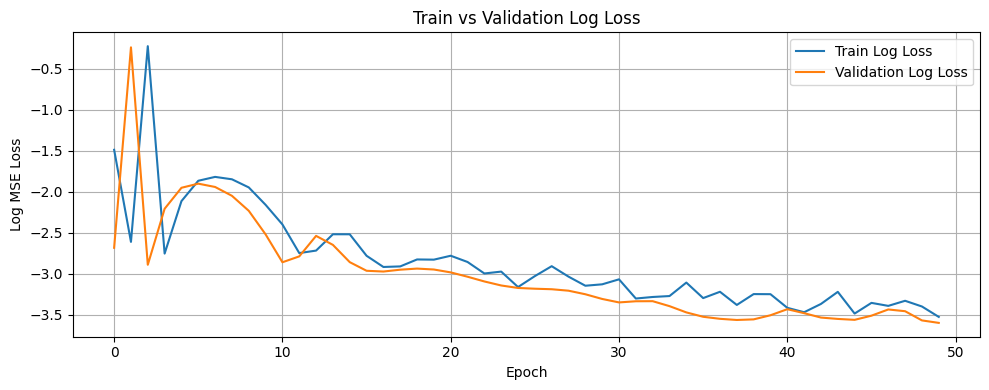

Training completed

=== Processing group: ('07 TO 09', 'BUKIT PANJANG', '3 ROOM') ===
Group size: 5 rows
Calling prepare_lstm_data for ('07 TO 09', 'BUKIT PANJANG', '3 ROOM')

Filtering for: BUKIT PANJANG, 3 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 167
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 36
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2647, Val Loss: 0.0755, Train R²: -2.3532, Val R²: -0.1892
Best model saved!
Epoch 2/50, Train Loss: 0.0957, Val Loss: 0.5598, Train R²: -0.2120, Val R²: -7.8165
Epoch 3/50, Train Loss: 0.5660, Val Loss: 0.0618, Train R²: -6.1695, Val R²: 0.0267
Best model saved!
Epoch 4/50, Train Loss: 0.0786, Val Loss: 0.0943, Train R

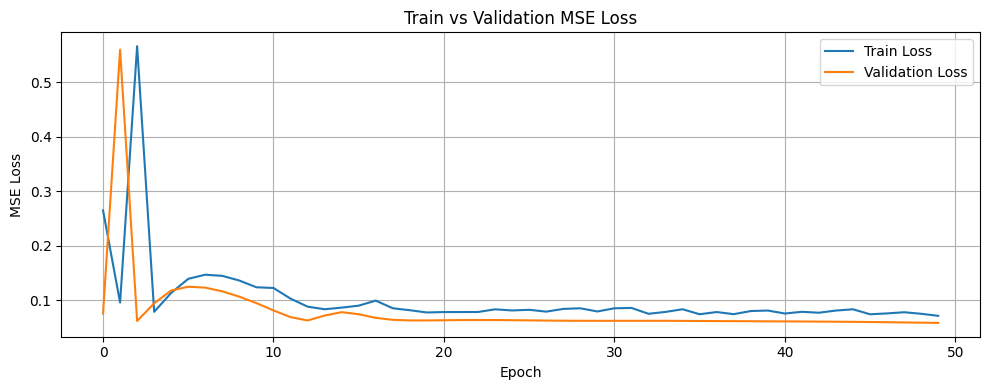

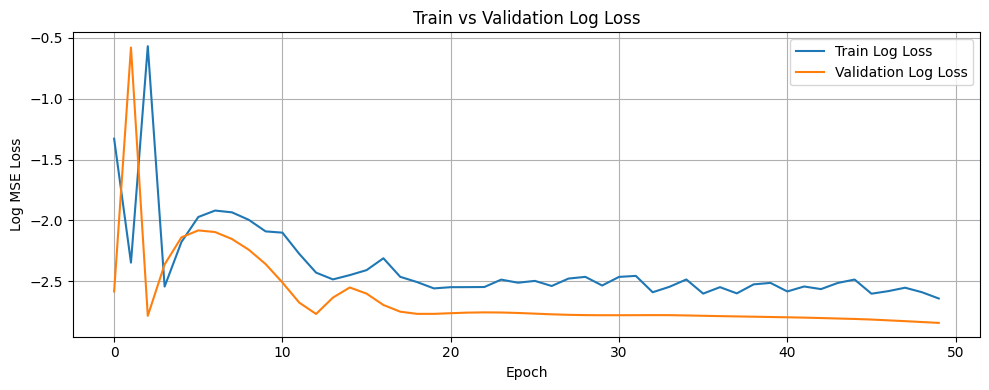

Training completed

=== Processing group: ('07 TO 09', 'BUKIT PANJANG', '4 ROOM') ===
Group size: 11 rows
Calling prepare_lstm_data for ('07 TO 09', 'BUKIT PANJANG', '4 ROOM')

Filtering for: BUKIT PANJANG, 4 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 599
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 40
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1523, Val Loss: 0.0538, Train R²: -2.7332, Val R²: -0.4911
Best model saved!
Epoch 2/50, Train Loss: 0.0481, Val Loss: 0.1504, Train R²: -0.1788, Val R²: -3.1702
Epoch 3/50, Train Loss: 0.1855, Val Loss: 0.0382, Train R²: -3.5460, Val R²: -0.0591
Best model saved!
Epoch 4/50, Train Loss: 0.0426, Val Loss: 0.0659, Train

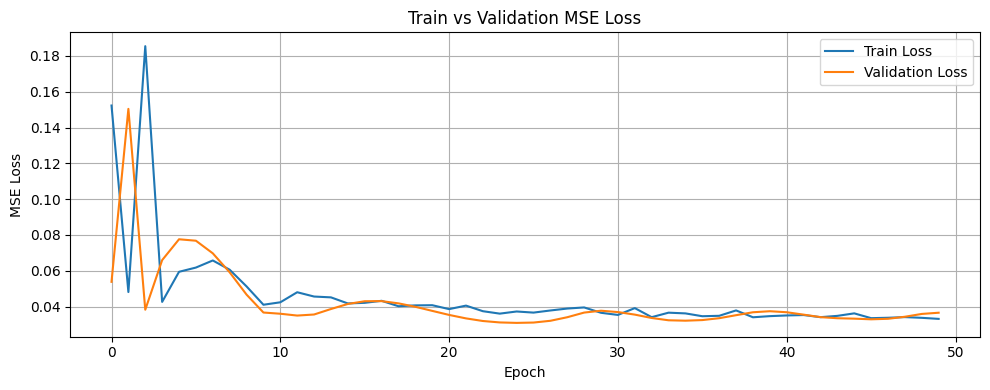

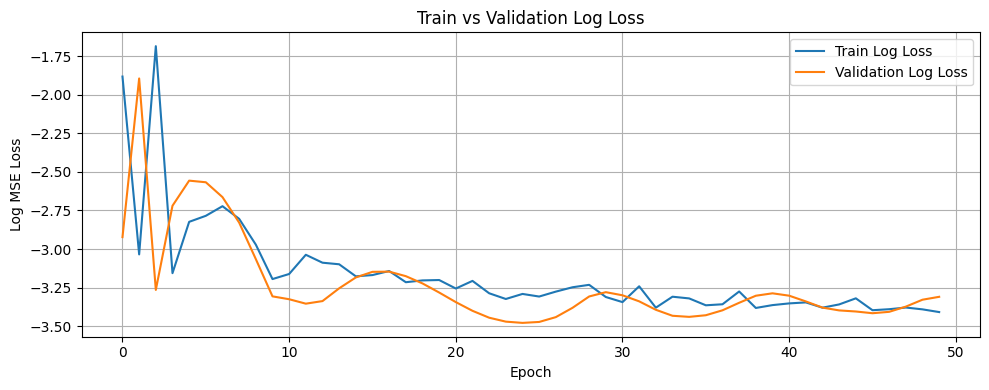

Training completed

=== Processing group: ('07 TO 09', 'BUKIT PANJANG', '5 ROOM') ===
Group size: 9 rows
Calling prepare_lstm_data for ('07 TO 09', 'BUKIT PANJANG', '5 ROOM')

Filtering for: BUKIT PANJANG, 5 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 346
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 39
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1343, Val Loss: 0.1435, Train R²: -2.4736, Val R²: -1.0162
Best model saved!
Epoch 2/50, Train Loss: 0.0377, Val Loss: 0.5752, Train R²: 0.0255, Val R²: -7.0837
Epoch 3/50, Train Loss: 0.9799, Val Loss: 0.1205, Train R²: -24.3381, Val R²: -0.6930
Best model saved!
Epoch 4/50, Train Loss: 0.0408, Val Loss: 0.2911, Train 

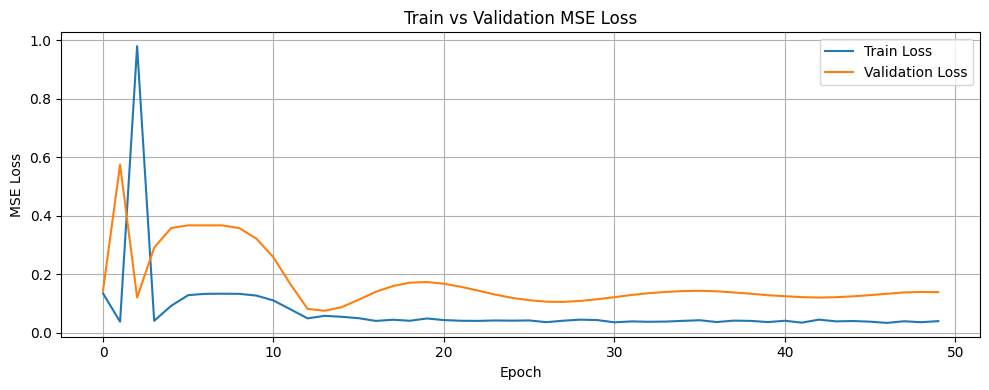

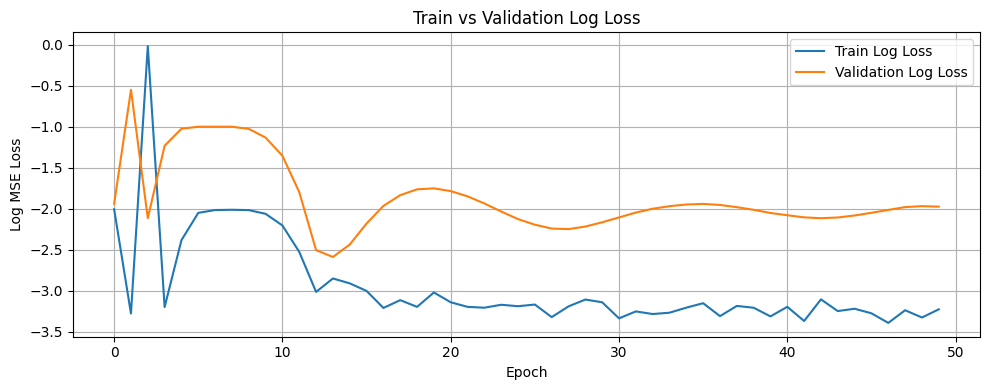

Training completed

=== Processing group: ('07 TO 09', 'BUKIT PANJANG', 'EXECUTIVE') ===
Group size: 4 rows
Calling prepare_lstm_data for ('07 TO 09', 'BUKIT PANJANG', 'EXECUTIVE')

Filtering for: BUKIT PANJANG, EXECUTIVE, 07 TO 09, around 2025-01-01
Initial strict match count: 124
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 35
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2612, Val Loss: 0.1020, Train R²: -5.4324, Val R²: -2.6108
Best model saved!
Epoch 2/50, Train Loss: 0.0906, Val Loss: 0.5019, Train R²: -1.2315, Val R²: -16.7596
Epoch 3/50, Train Loss: 0.5967, Val Loss: 0.0602, Train R²: -13.6957, Val R²: -1.1312
Best model saved!
Epoch 4/50, Train Loss: 0.0713, Val Loss: 0.1

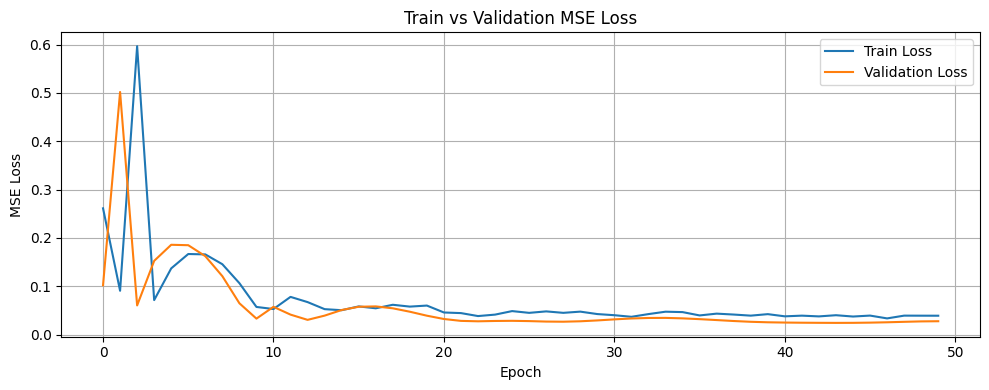

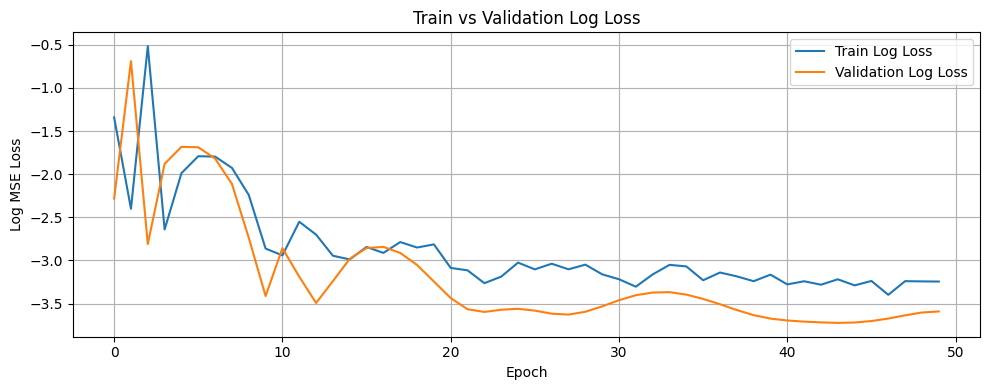

Training completed

=== Processing group: ('07 TO 09', 'BUKIT TIMAH', '3 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('07 TO 09', 'BUKIT TIMAH', '3 ROOM')

Filtering for: BUKIT TIMAH, 3 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 31
Using before_or_at_target with 30 records.
Removing 'block' column from dataset
Data shapes - x_train: (29, 9), y_train: (29,)
Flattened y shape: (29,), Unique values: 21
Using simple train-validation split (80/20).
Split sizes - Train: 23, Val: 6
Creating PyTorch datasets...
Dataset sizes - Train: 23, Val: 6
Using batch sizes - Train: 23, Val: 6
Starting model training...
Epoch 1/50, Train Loss: 0.2873, Val Loss: 0.0435, Train R²: -5.0192, Val R²: -1.5663
Best model saved!
Epoch 2/50, Train Loss: 0.1092, Val Loss: 0.2801, Train R²: -1.2885, Val R²: -15.5111
Epoch 3/50, Train Loss: 0.2169, Val Loss: 0.0187, Train R²: -3.5448, Val R²: -0.0999
Best model saved!
Epoch 4/50, Train Loss: 0.0584, Val Loss: 0.0371, Train R²: -0.22

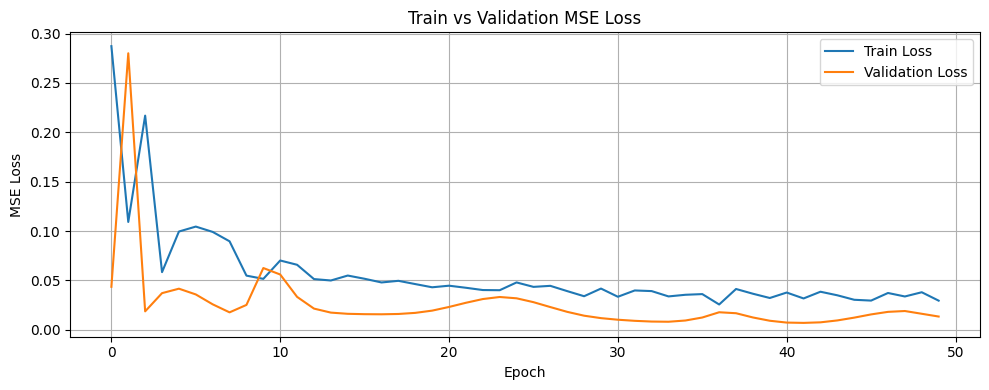

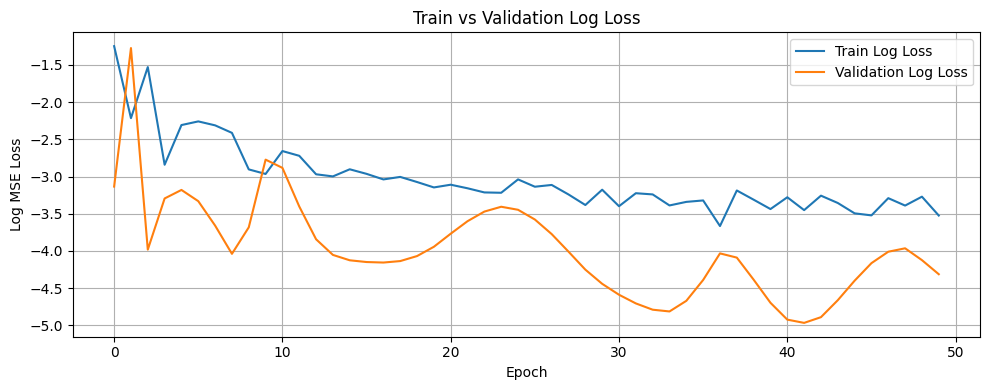

Training completed

=== Processing group: ('07 TO 09', 'BUKIT TIMAH', '4 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('07 TO 09', 'BUKIT TIMAH', '4 ROOM')

Filtering for: BUKIT TIMAH, 4 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 59
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1949, Val Loss: 0.0577, Train R²: -2.1892, Val R²: -0.6316
Best model saved!
Epoch 2/50, Train Loss: 0.0814, Val Loss: 0.3764, Train R²: -0.3313, Val R²: -9.6490
Epoch 3/50, Train Loss: 0.4406, Val Loss: 0.0382, Train R²: -6.2095, Val R²: -0.0823
Best model saved!
Epoch 4/50, Train Loss: 0.0650, Val Loss: 0.0918, Train R²: -0.

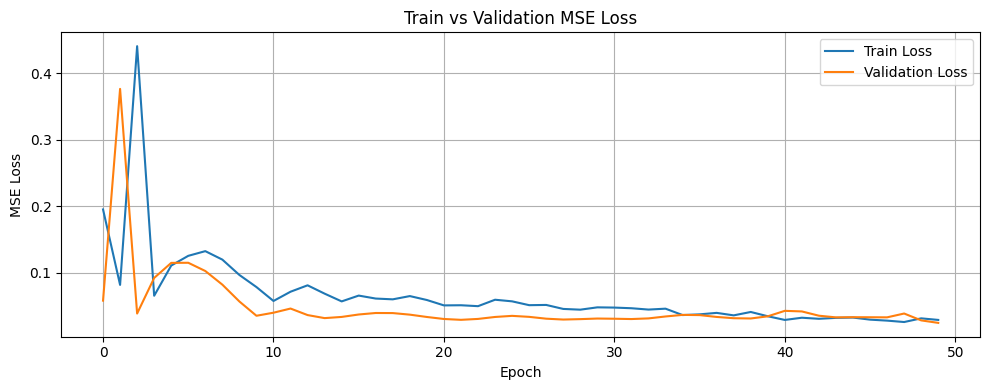

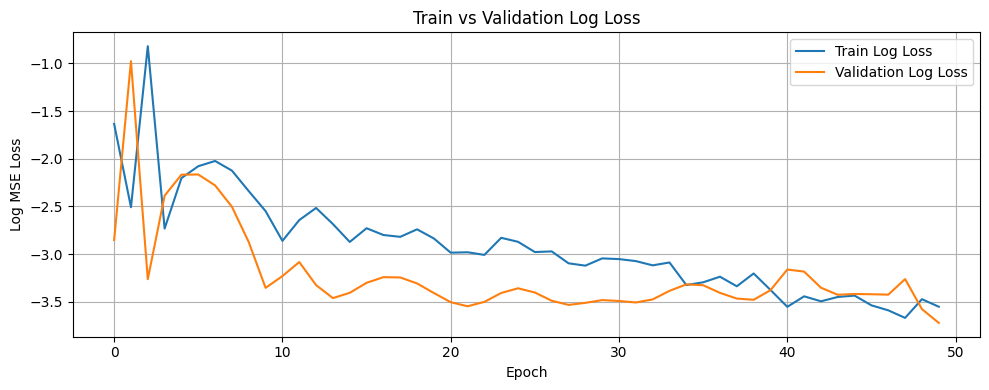

Training completed

=== Processing group: ('07 TO 09', 'BUKIT TIMAH', '5 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('07 TO 09', 'BUKIT TIMAH', '5 ROOM')

Filtering for: BUKIT TIMAH, 5 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 23
Using before_or_at_target with 22 records.
Removing 'block' column from dataset
Data shapes - x_train: (21, 9), y_train: (21,)
Flattened y shape: (21,), Unique values: 20
Using simple train-validation split (80/20).
Split sizes - Train: 16, Val: 5
Creating PyTorch datasets...
Dataset sizes - Train: 16, Val: 5
Using batch sizes - Train: 16, Val: 5
Starting model training...
Epoch 1/50, Train Loss: 0.1913, Val Loss: 0.0626, Train R²: -1.4152, Val R²: -0.0503
Best model saved!
Epoch 2/50, Train Loss: 0.0856, Val Loss: 0.5309, Train R²: -0.0808, Val R²: -7.9041
Epoch 3/50, Train Loss: 0.5030, Val Loss: 0.0624, Train R²: -5.3526, Val R²: -0.0461
Best model saved!
Epoch 4/50, Train Loss: 0.0769, Val Loss: 0.0761, Train R²: 0.0283

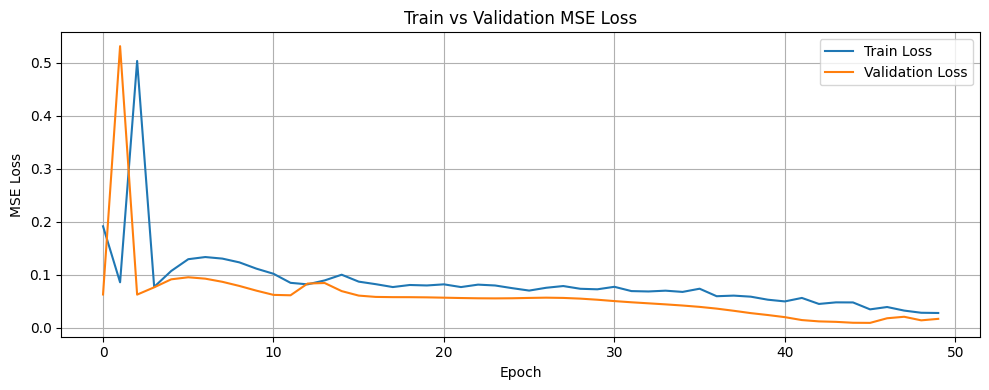

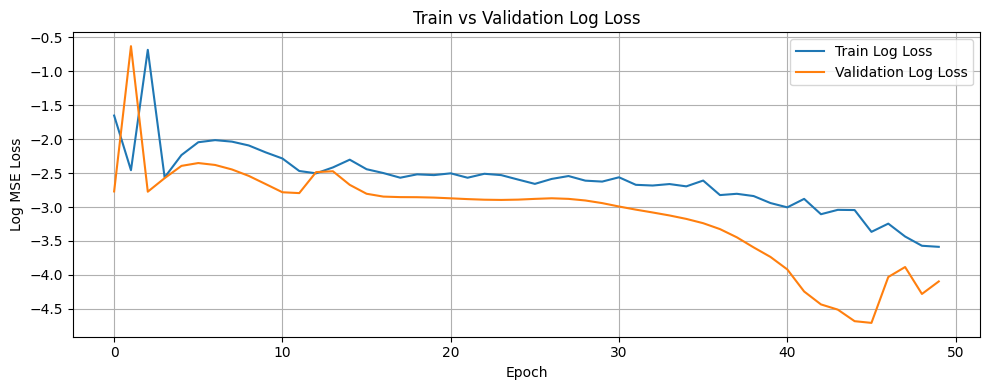

Training completed

=== Processing group: ('07 TO 09', 'CENTRAL AREA', '2 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('07 TO 09', 'CENTRAL AREA', '2 ROOM')

Filtering for: CENTRAL AREA, 2 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 23
Using before_or_at_target with 22 records.
Removing 'block' column from dataset
Data shapes - x_train: (21, 9), y_train: (21,)
Flattened y shape: (21,), Unique values: 17
Using simple train-validation split (80/20).
Split sizes - Train: 16, Val: 5
Creating PyTorch datasets...
Dataset sizes - Train: 16, Val: 5
Using batch sizes - Train: 16, Val: 5
Starting model training...
Epoch 1/50, Train Loss: 0.1519, Val Loss: 0.0496, Train R²: -1.5843, Val R²: -0.1091
Best model saved!
Epoch 2/50, Train Loss: 0.0616, Val Loss: 0.1607, Train R²: -0.0481, Val R²: -2.5899
Epoch 3/50, Train Loss: 0.1908, Val Loss: 0.0457, Train R²: -2.2463, Val R²: -0.0201
Best model saved!
Epoch 4/50, Train Loss: 0.0632, Val Loss: 0.0621, Train R²: -0.

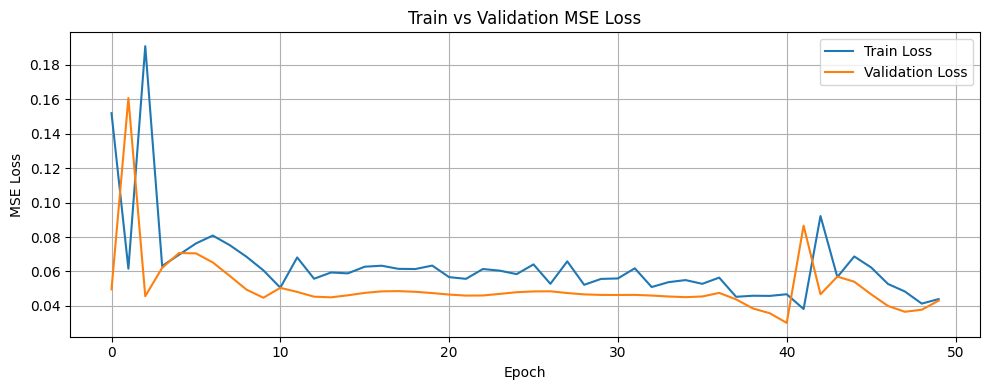

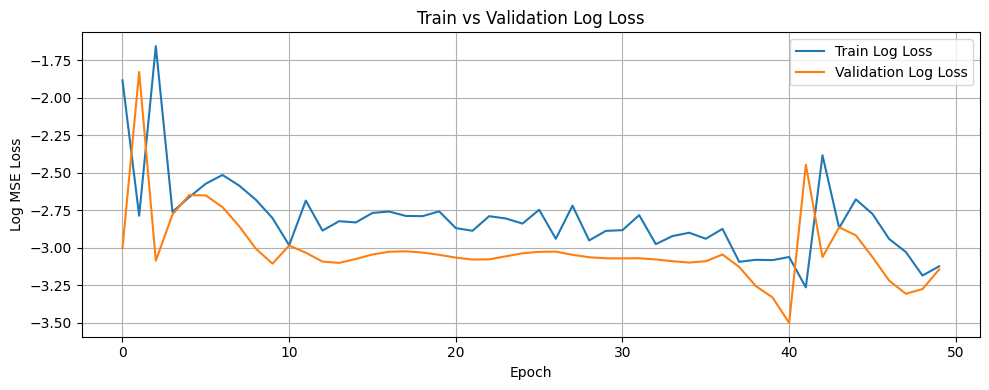

Training completed

=== Processing group: ('07 TO 09', 'CENTRAL AREA', '3 ROOM') ===
Group size: 2 rows
Calling prepare_lstm_data for ('07 TO 09', 'CENTRAL AREA', '3 ROOM')

Filtering for: CENTRAL AREA, 3 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 126
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2342, Val Loss: 0.0618, Train R²: -3.1990, Val R²: 0.0499
Best model saved!
Epoch 2/50, Train Loss: 0.0650, Val Loss: 0.7116, Train R²: -0.1657, Val R²: -9.9320
Epoch 3/50, Train Loss: 0.6591, Val Loss: 0.0629, Train R²: -10.8190, Val R²: 0.0335
Epoch 4/50, Train Loss: 0.0504, Val Loss: 0.0845, Train R²: 0.0966, Val R²: -0

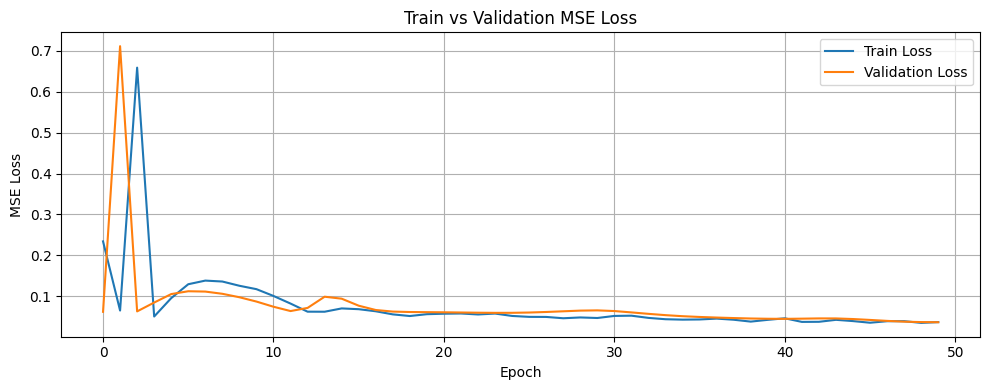

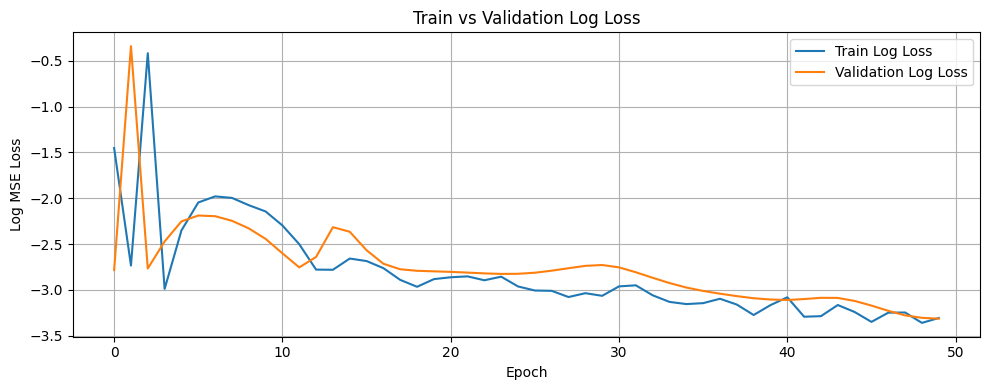

Training completed

=== Processing group: ('07 TO 09', 'CENTRAL AREA', '4 ROOM') ===
Group size: 2 rows
Calling prepare_lstm_data for ('07 TO 09', 'CENTRAL AREA', '4 ROOM')

Filtering for: CENTRAL AREA, 4 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 73
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1720, Val Loss: 0.0335, Train R²: -1.7525, Val R²: 0.0880
Best model saved!
Epoch 2/50, Train Loss: 0.0529, Val Loss: 0.0286, Train R²: 0.1528, Val R²: 0.2223
Best model saved!
Epoch 3/50, Train Loss: 0.0541, Val Loss: 0.3112, Train R²: 0.1335, Val R²: -7.4692
Epoch 4/50, Train Loss: 0.3006, Val Loss: 0.0237, Train R²: -3.8

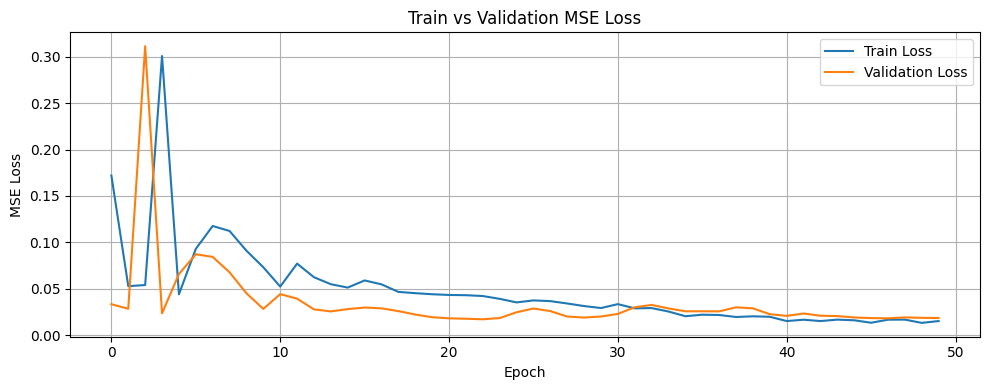

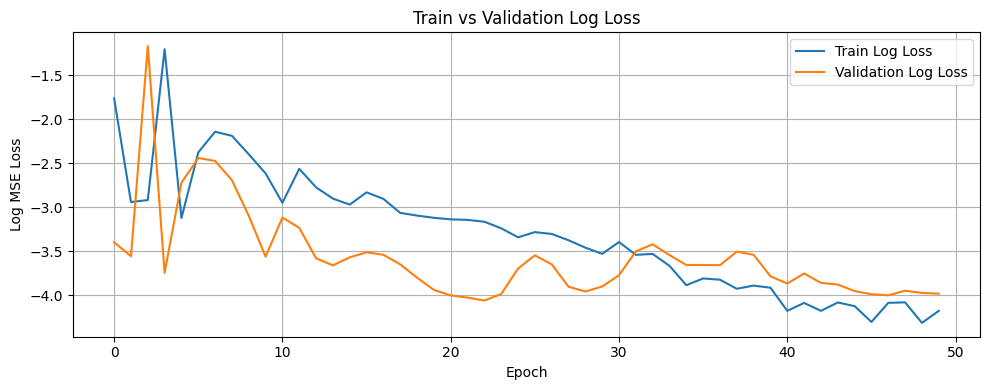

Training completed

=== Processing group: ('07 TO 09', 'CHOA CHU KANG', '3 ROOM') ===
Group size: 2 rows
Calling prepare_lstm_data for ('07 TO 09', 'CHOA CHU KANG', '3 ROOM')

Filtering for: CHOA CHU KANG, 3 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 159
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3048, Val Loss: 0.0685, Train R²: -3.9911, Val R²: -1.4563
Best model saved!
Epoch 2/50, Train Loss: 0.1056, Val Loss: 0.6467, Train R²: -0.7289, Val R²: -22.1807
Epoch 3/50, Train Loss: 0.6459, Val Loss: 0.0322, Train R²: -9.5784, Val R²: -0.1552
Best model saved!
Epoch 4/50, Train Loss: 0.0751, Val Loss: 0.0982, Train

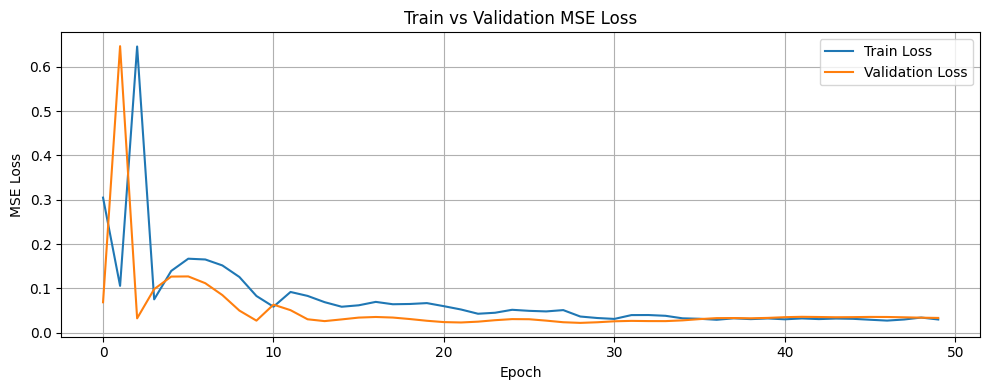

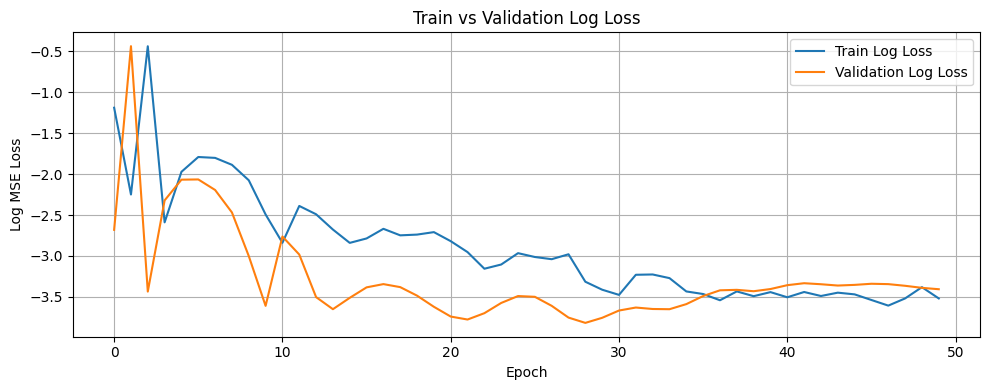

Training completed

=== Processing group: ('07 TO 09', 'CHOA CHU KANG', '4 ROOM') ===
Group size: 27 rows
Calling prepare_lstm_data for ('07 TO 09', 'CHOA CHU KANG', '4 ROOM')

Filtering for: CHOA CHU KANG, 4 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 935
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 35
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3321, Val Loss: 0.1045, Train R²: -7.2481, Val R²: -1.5874
Best model saved!
Epoch 2/50, Train Loss: 0.1139, Val Loss: 0.2974, Train R²: -1.8290, Val R²: -6.3636
Epoch 3/50, Train Loss: 0.2964, Val Loss: 0.0482, Train R²: -6.3617, Val R²: -0.1926
Best model saved!
Epoch 4/50, Train Loss: 0.0535, Val Loss: 0.0985, Train

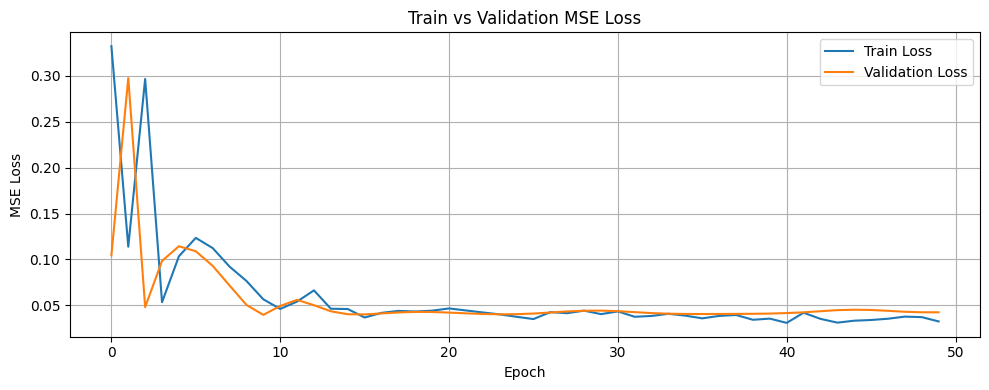

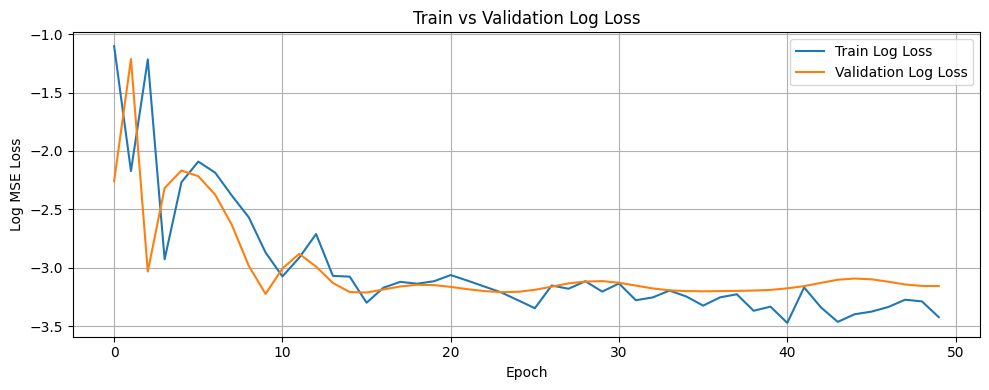

Training completed

=== Processing group: ('07 TO 09', 'CHOA CHU KANG', '5 ROOM') ===
Group size: 13 rows
Calling prepare_lstm_data for ('07 TO 09', 'CHOA CHU KANG', '5 ROOM')

Filtering for: CHOA CHU KANG, 5 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 613
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 40
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3730, Val Loss: 0.0345, Train R²: -4.1106, Val R²: -0.0348
Best model saved!
Epoch 2/50, Train Loss: 0.1354, Val Loss: 0.9475, Train R²: -0.8548, Val R²: -27.3996
Epoch 3/50, Train Loss: 0.5182, Val Loss: 0.0785, Train R²: -6.0990, Val R²: -1.3538
Epoch 4/50, Train Loss: 0.0831, Val Loss: 0.0343, Train R²: -0.1382, Val

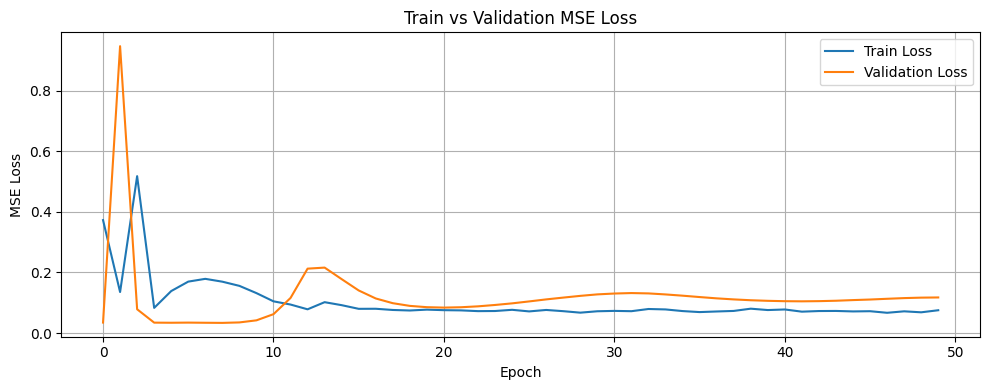

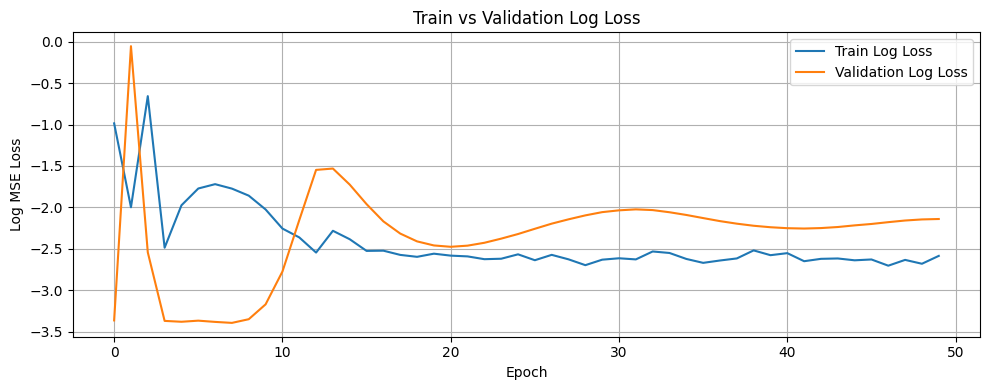

Training completed

=== Processing group: ('07 TO 09', 'CHOA CHU KANG', 'EXECUTIVE') ===
Group size: 11 rows
Calling prepare_lstm_data for ('07 TO 09', 'CHOA CHU KANG', 'EXECUTIVE')

Filtering for: CHOA CHU KANG, EXECUTIVE, 07 TO 09, around 2025-01-01
Initial strict match count: 215
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 34
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2963, Val Loss: 0.0724, Train R²: -3.2497, Val R²: -0.3515
Best model saved!
Epoch 2/50, Train Loss: 0.1190, Val Loss: 0.5453, Train R²: -0.7066, Val R²: -9.1831
Epoch 3/50, Train Loss: 0.4574, Val Loss: 0.0548, Train R²: -5.5613, Val R²: -0.0228
Best model saved!
Epoch 4/50, Train Loss: 0.0856, Val Loss: 0.09

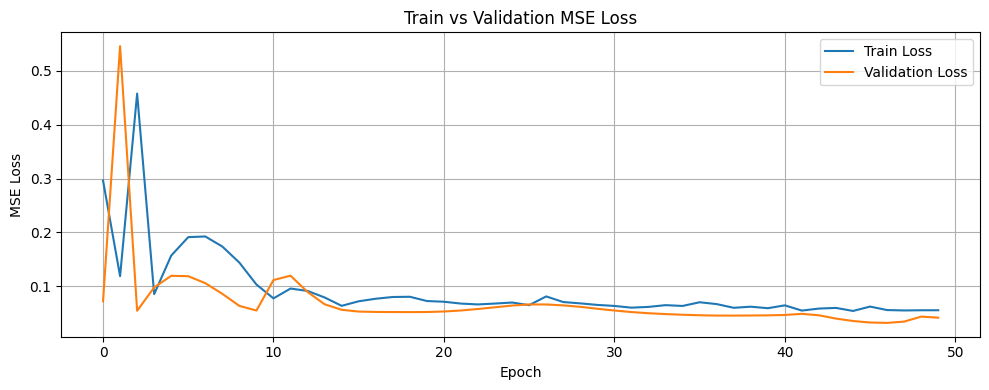

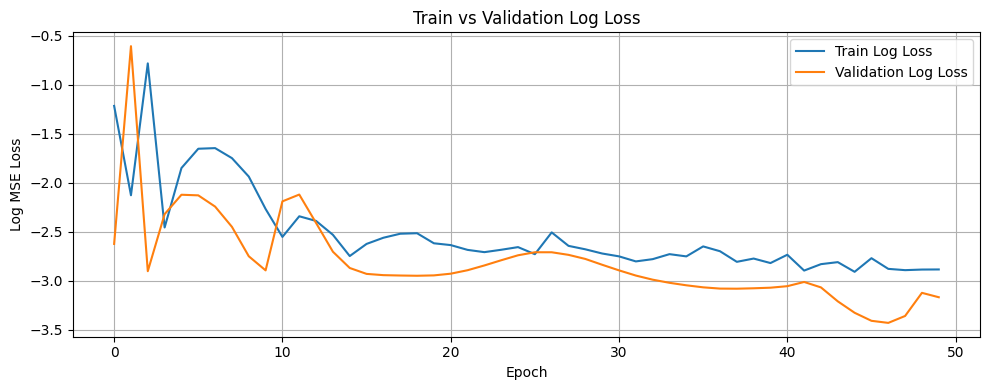

Training completed

=== Processing group: ('07 TO 09', 'CLEMENTI', '3 ROOM') ===
Group size: 9 rows
Calling prepare_lstm_data for ('07 TO 09', 'CLEMENTI', '3 ROOM')

Filtering for: CLEMENTI, 3 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 466
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.0882, Val Loss: 0.1760, Train R²: -0.3513, Val R²: -58.3366
Best model saved!
Epoch 2/50, Train Loss: 0.1501, Val Loss: 0.0079, Train R²: -1.3007, Val R²: -1.6552
Best model saved!
Epoch 3/50, Train Loss: 0.0676, Val Loss: 0.0028, Train R²: -0.0364, Val R²: 0.0428
Best model saved!
Epoch 4/50, Train Loss: 0.0783, Val Loss: 0.0029, Tra

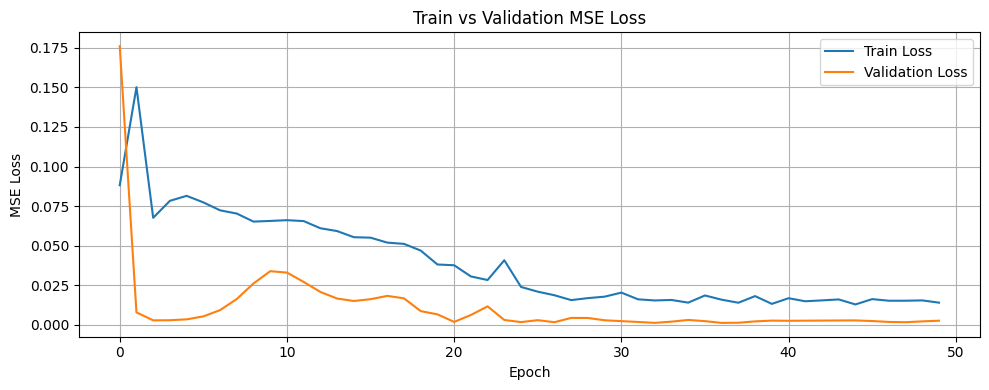

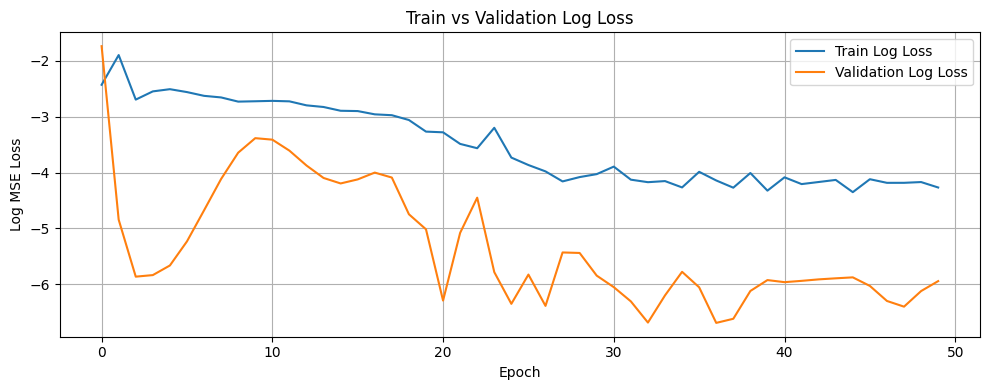

Training completed

=== Processing group: ('07 TO 09', 'CLEMENTI', '4 ROOM') ===
Group size: 7 rows
Calling prepare_lstm_data for ('07 TO 09', 'CLEMENTI', '4 ROOM')

Filtering for: CLEMENTI, 4 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 292
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1929, Val Loss: 0.0862, Train R²: -1.8999, Val R²: -0.1048
Best model saved!
Epoch 2/50, Train Loss: 0.0695, Val Loss: 0.6663, Train R²: -0.0446, Val R²: -7.5386
Epoch 3/50, Train Loss: 0.6909, Val Loss: 0.0774, Train R²: -9.3849, Val R²: 0.0084
Best model saved!
Epoch 4/50, Train Loss: 0.0662, Val Loss: 0.1220, Train R²: 0.0049, Val 

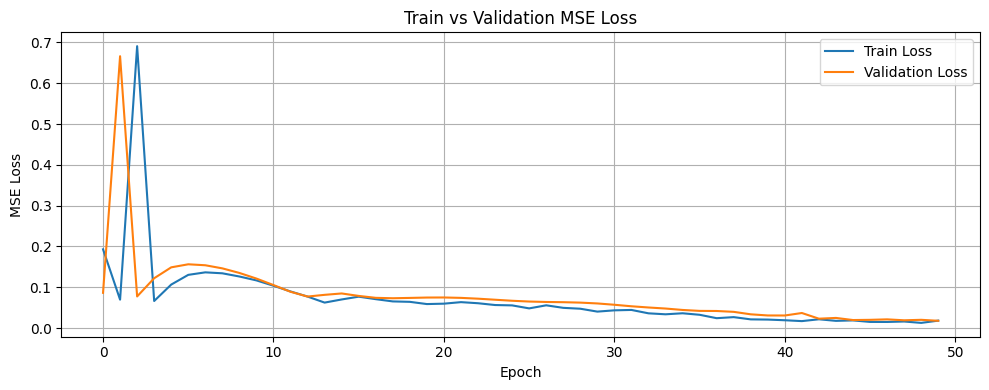

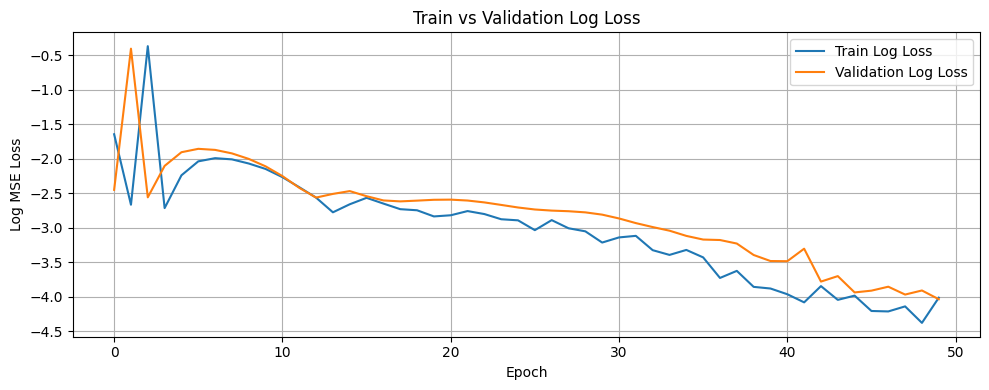

Training completed

=== Processing group: ('07 TO 09', 'GEYLANG', '3 ROOM') ===
Group size: 15 rows
Calling prepare_lstm_data for ('07 TO 09', 'GEYLANG', '3 ROOM')

Filtering for: GEYLANG, 3 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 573
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 39
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1560, Val Loss: 0.0438, Train R²: -0.9782, Val R²: -0.2396
Best model saved!
Epoch 2/50, Train Loss: 0.0806, Val Loss: 0.2390, Train R²: -0.0227, Val R²: -5.7586
Epoch 3/50, Train Loss: 0.1856, Val Loss: 0.0380, Train R²: -1.3543, Val R²: -0.0745
Best model saved!
Epoch 4/50, Train Loss: 0.0798, Val Loss: 0.0341, Train R²: -0.0117, Val 

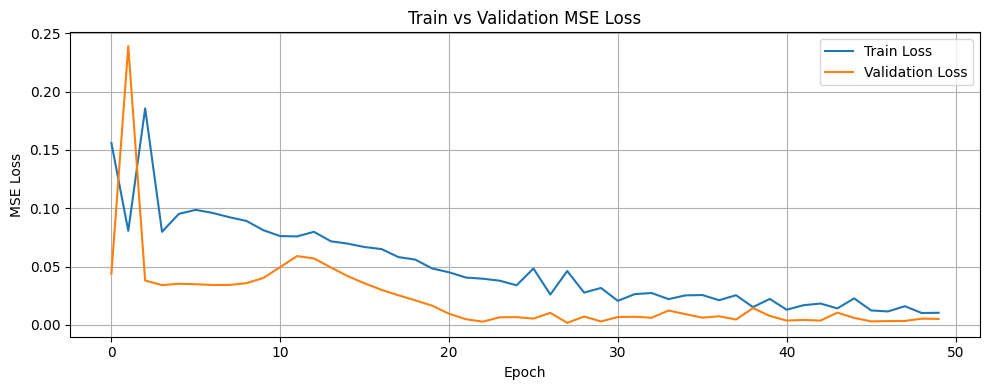

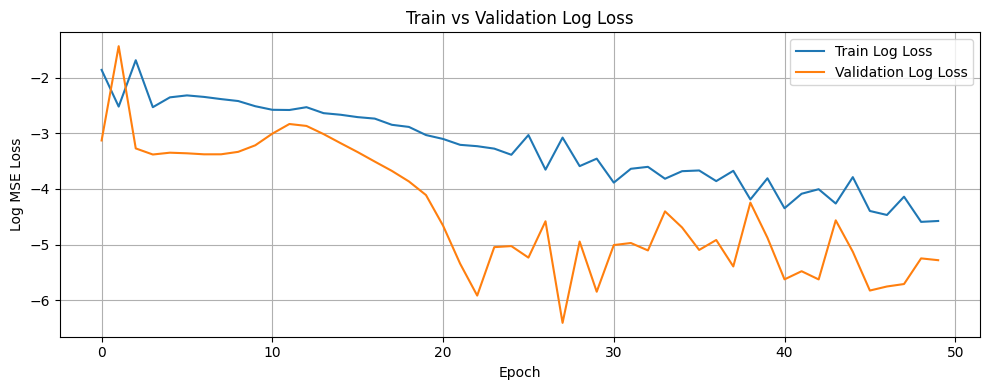

Training completed

=== Processing group: ('07 TO 09', 'GEYLANG', '4 ROOM') ===
Group size: 6 rows
Calling prepare_lstm_data for ('07 TO 09', 'GEYLANG', '4 ROOM')

Filtering for: GEYLANG, 4 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 409
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 45
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3854, Val Loss: 0.0985, Train R²: -2.1230, Val R²: -0.0285
Best model saved!
Epoch 2/50, Train Loss: 0.1672, Val Loss: 0.6796, Train R²: -0.3547, Val R²: -6.0942
Epoch 3/50, Train Loss: 0.5183, Val Loss: 0.0961, Train R²: -3.2000, Val R²: -0.0031
Best model saved!
Epoch 4/50, Train Loss: 0.1211, Val Loss: 0.0979, Train R²: 0.0188, Val R²

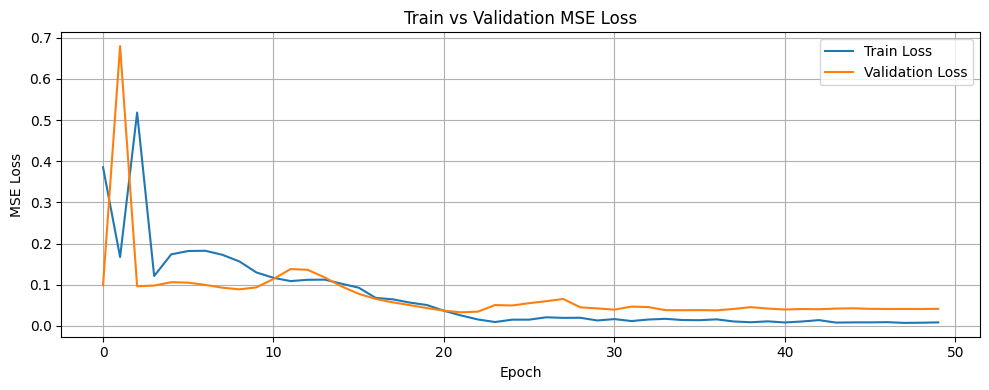

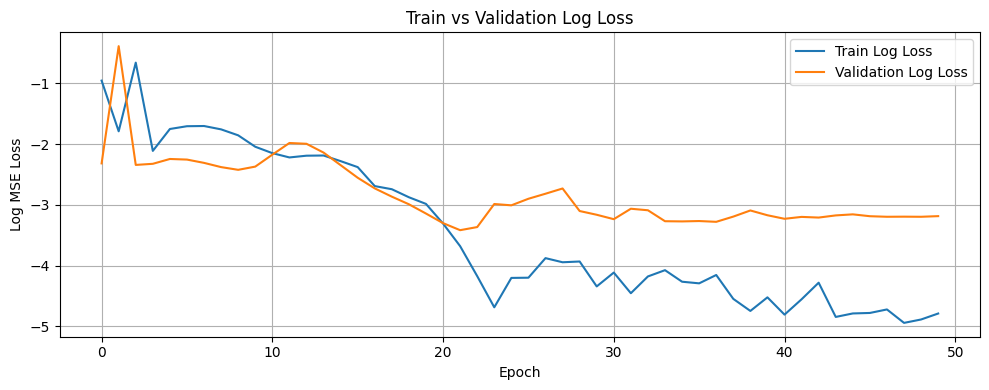

Training completed

=== Processing group: ('07 TO 09', 'HOUGANG', '2 ROOM') ===
Group size: 4 rows
Calling prepare_lstm_data for ('07 TO 09', 'HOUGANG', '2 ROOM')

Filtering for: HOUGANG, 2 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 25
Using before_or_at_target with 22 records.
Removing 'block' column from dataset
Data shapes - x_train: (21, 9), y_train: (21,)
Flattened y shape: (21,), Unique values: 16
Using simple train-validation split (80/20).
Split sizes - Train: 16, Val: 5
Creating PyTorch datasets...
Dataset sizes - Train: 16, Val: 5
Using batch sizes - Train: 16, Val: 5
Starting model training...
Epoch 1/50, Train Loss: 0.3350, Val Loss: 0.1093, Train R²: -2.6027, Val R²: 0.0056
Best model saved!
Epoch 2/50, Train Loss: 0.0883, Val Loss: 1.0344, Train R²: 0.0508, Val R²: -8.4119
Epoch 3/50, Train Loss: 1.0018, Val Loss: 0.1082, Train R²: -9.7736, Val R²: 0.0157
Best model saved!
Epoch 4/50, Train Loss: 0.0928, Val Loss: 0.1857, Train R²: 0.0018, Val R²: -0.68

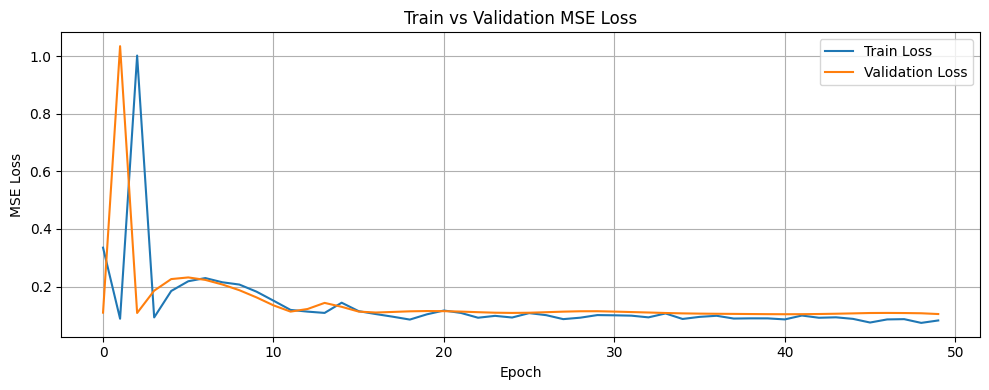

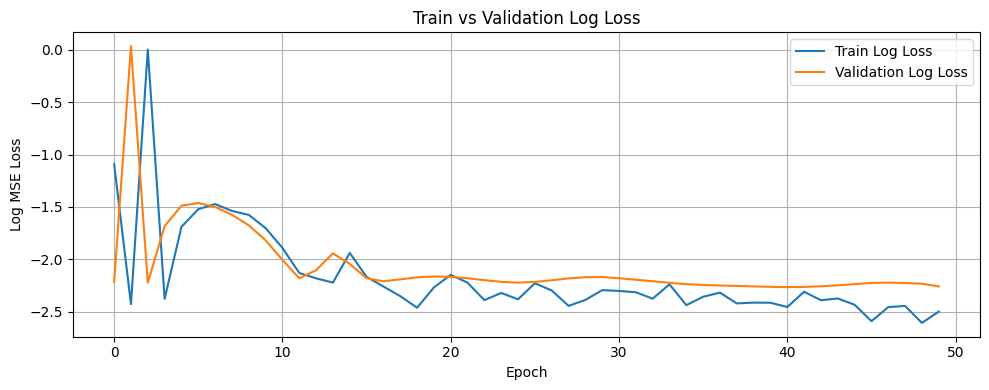

Training completed

=== Processing group: ('07 TO 09', 'HOUGANG', '3 ROOM') ===
Group size: 14 rows
Calling prepare_lstm_data for ('07 TO 09', 'HOUGANG', '3 ROOM')

Filtering for: HOUGANG, 3 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 488
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2126, Val Loss: 0.0307, Train R²: -3.8233, Val R²: -0.6475
Best model saved!
Epoch 2/50, Train Loss: 0.0577, Val Loss: 0.9340, Train R²: -0.3088, Val R²: -49.1491
Epoch 3/50, Train Loss: 1.0165, Val Loss: 0.0166, Train R²: -22.0665, Val R²: 0.1105
Best model saved!
Epoch 4/50, Train Loss: 0.0462, Val Loss: 0.0818, Train R²: -0.0483, Val

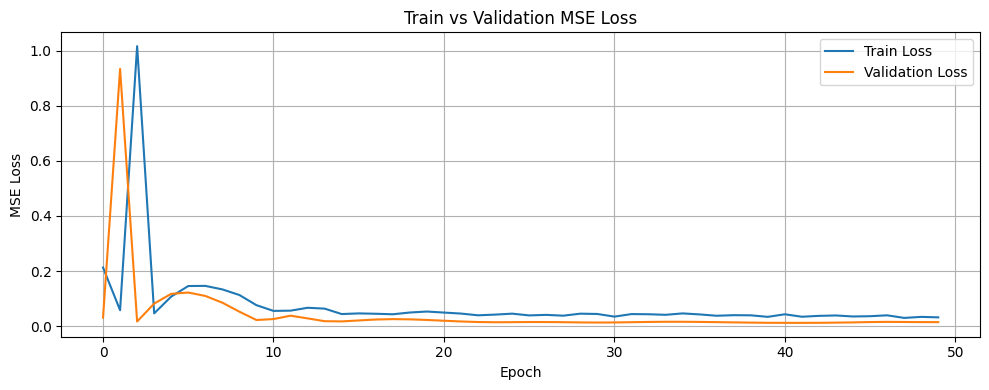

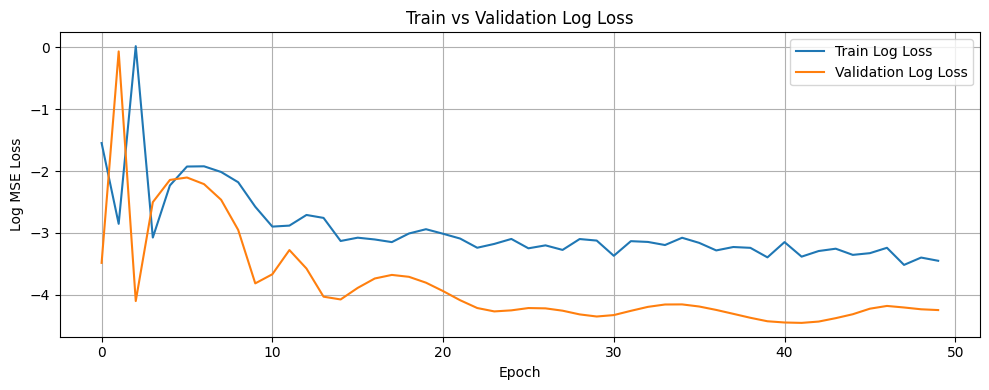

Training completed

=== Processing group: ('07 TO 09', 'HOUGANG', '4 ROOM') ===
Group size: 18 rows
Calling prepare_lstm_data for ('07 TO 09', 'HOUGANG', '4 ROOM')

Filtering for: HOUGANG, 4 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 1017
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 44
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2635, Val Loss: 0.0255, Train R²: -2.7794, Val R²: -1.2084
Best model saved!
Epoch 2/50, Train Loss: 0.0837, Val Loss: 0.7597, Train R²: -0.2006, Val R²: -64.8448
Epoch 3/50, Train Loss: 0.8660, Val Loss: 0.0114, Train R²: -11.4232, Val R²: 0.0139
Best model saved!
Epoch 4/50, Train Loss: 0.0840, Val Loss: 0.0628, Train R²: -0.2050, Va

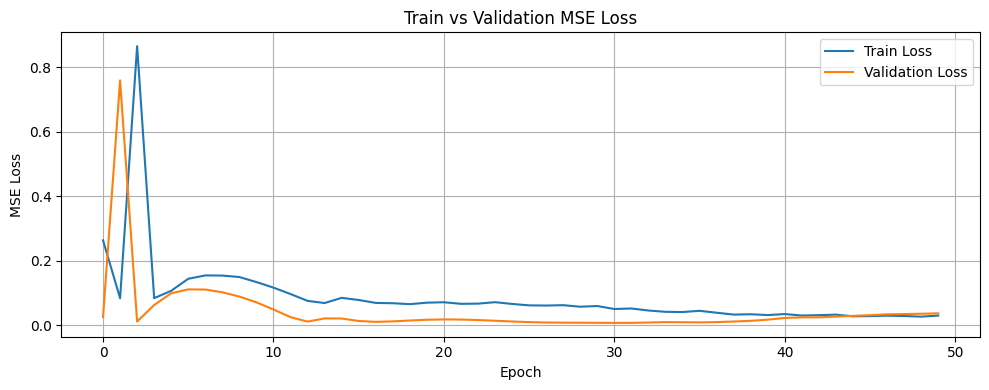

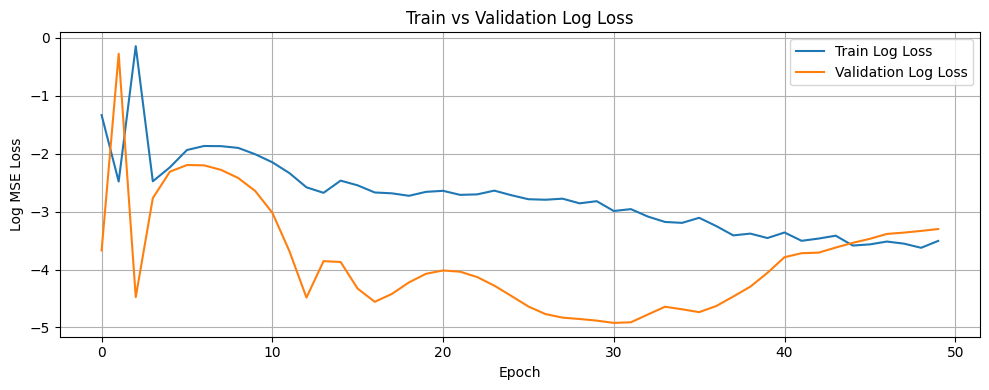

Training completed

=== Processing group: ('07 TO 09', 'HOUGANG', '5 ROOM') ===
Group size: 11 rows
Calling prepare_lstm_data for ('07 TO 09', 'HOUGANG', '5 ROOM')

Filtering for: HOUGANG, 5 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 474
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 44
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.0527, Val Loss: 0.1056, Train R²: -0.9106, Val R²: -0.2995
Best model saved!
Epoch 2/50, Train Loss: 0.0888, Val Loss: 0.1001, Train R²: -2.2214, Val R²: -0.2315
Best model saved!
Epoch 3/50, Train Loss: 0.0300, Val Loss: 0.1213, Train R²: -0.0893, Val R²: -0.4927
Epoch 4/50, Train Loss: 0.0399, Val Loss: 0.1227, Train R²: -0.4452, Val 

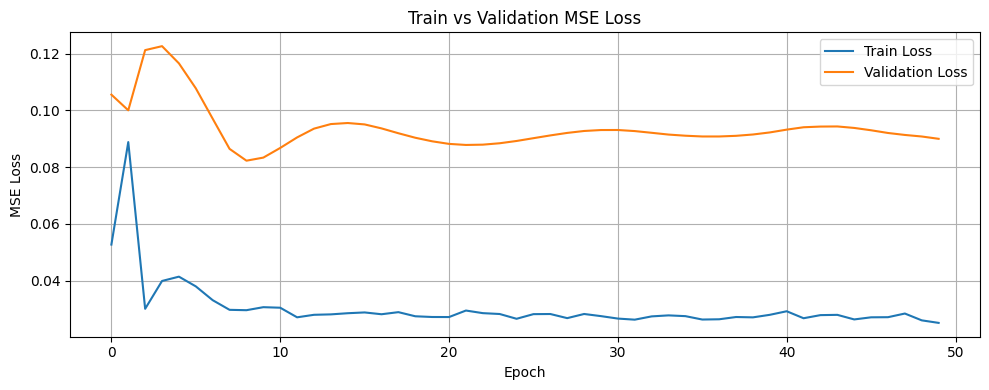

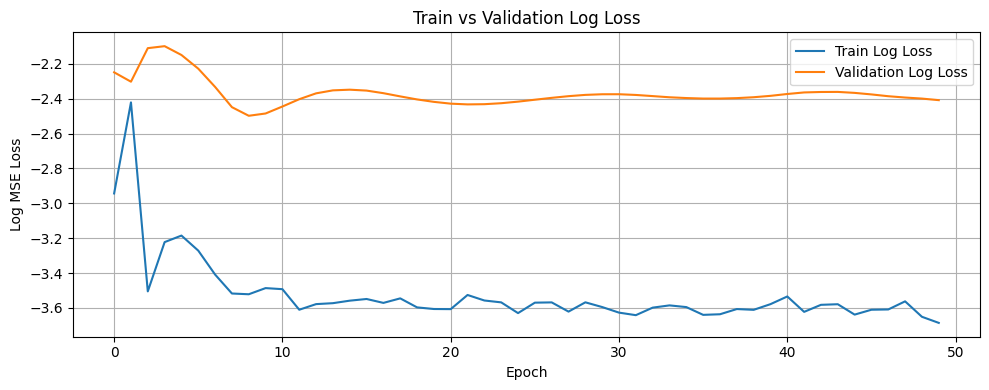

Training completed

=== Processing group: ('07 TO 09', 'HOUGANG', 'EXECUTIVE') ===
Group size: 1 rows
Calling prepare_lstm_data for ('07 TO 09', 'HOUGANG', 'EXECUTIVE')

Filtering for: HOUGANG, EXECUTIVE, 07 TO 09, around 2025-01-01
Initial strict match count: 173
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 36
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2146, Val Loss: 0.0929, Train R²: -4.3266, Val R²: -4.8176
Best model saved!
Epoch 2/50, Train Loss: 0.0495, Val Loss: 0.6200, Train R²: -0.2277, Val R²: -37.8178
Epoch 3/50, Train Loss: 0.9866, Val Loss: 0.0468, Train R²: -23.4936, Val R²: -1.9314
Best model saved!
Epoch 4/50, Train Loss: 0.0408, Val Loss: 0.1857, Train R²: -0.

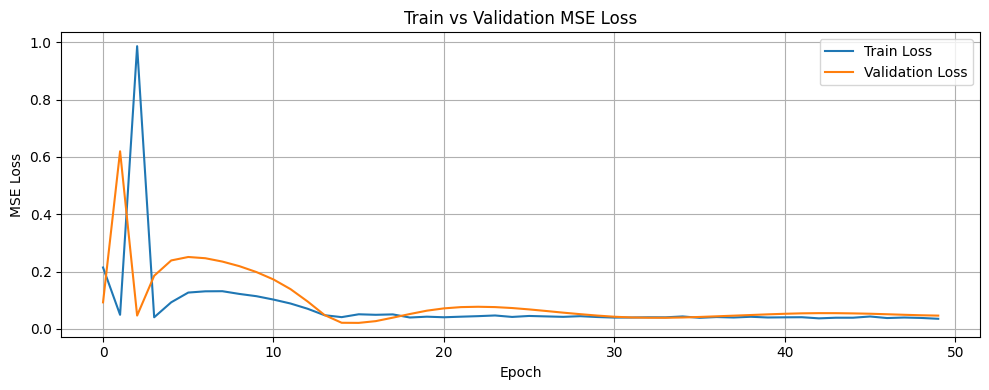

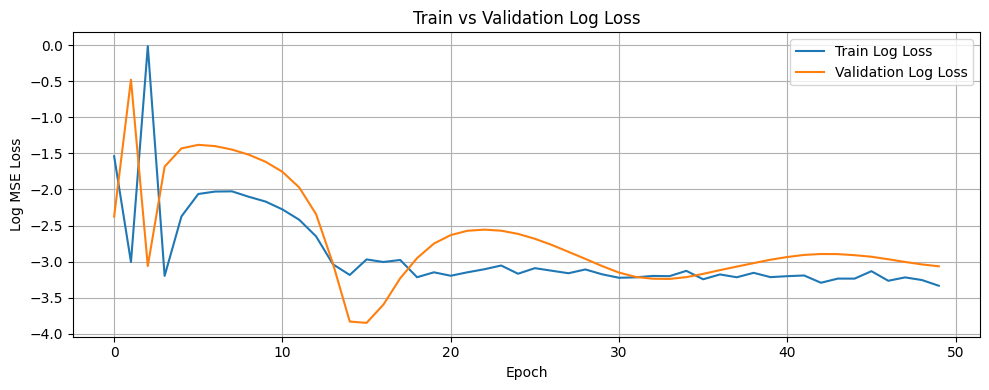

Training completed

=== Processing group: ('07 TO 09', 'JURONG EAST', '3 ROOM') ===
Group size: 6 rows
Calling prepare_lstm_data for ('07 TO 09', 'JURONG EAST', '3 ROOM')

Filtering for: JURONG EAST, 3 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 300
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1379, Val Loss: 0.0463, Train R²: -3.6253, Val R²: -1.4286
Best model saved!
Epoch 2/50, Train Loss: 0.0464, Val Loss: 0.2614, Train R²: -0.5548, Val R²: -12.7193
Epoch 3/50, Train Loss: 0.2966, Val Loss: 0.0250, Train R²: -8.9480, Val R²: -0.3129
Best model saved!
Epoch 4/50, Train Loss: 0.0324, Val Loss: 0.0684, Train R²: -

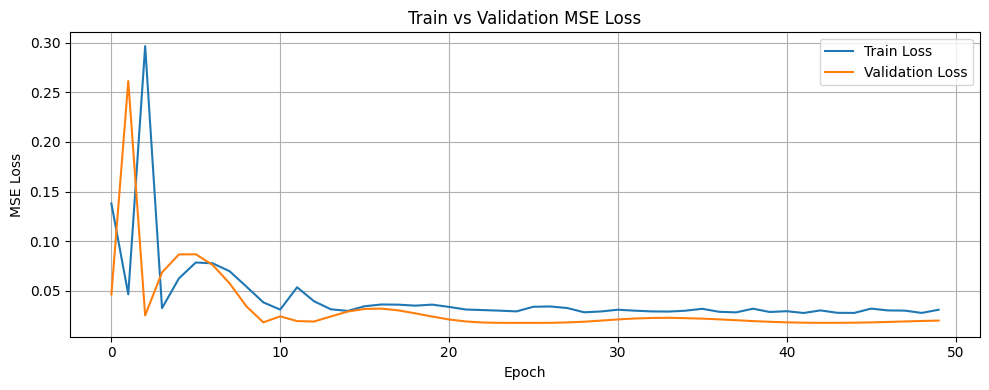

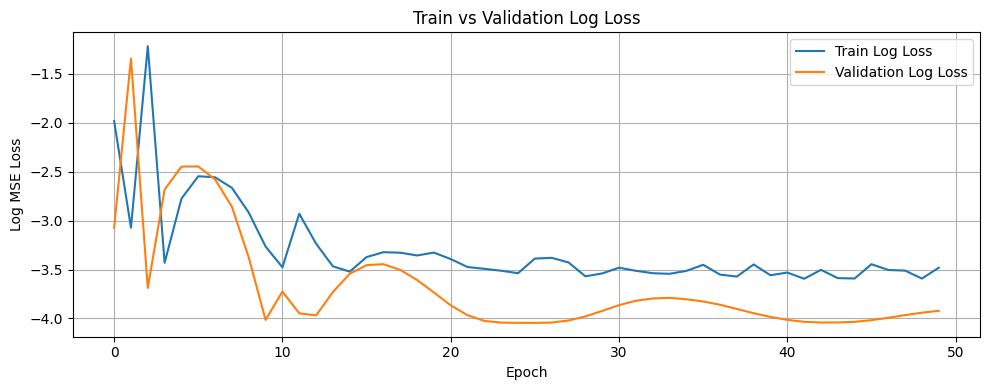

Training completed

=== Processing group: ('07 TO 09', 'JURONG EAST', '4 ROOM') ===
Group size: 5 rows
Calling prepare_lstm_data for ('07 TO 09', 'JURONG EAST', '4 ROOM')

Filtering for: JURONG EAST, 4 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 249
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 37
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3066, Val Loss: 0.0870, Train R²: -3.3853, Val R²: -0.4792
Best model saved!
Epoch 2/50, Train Loss: 0.1150, Val Loss: 0.6878, Train R²: -0.6447, Val R²: -10.6982
Epoch 3/50, Train Loss: 0.6319, Val Loss: 0.0609, Train R²: -8.0381, Val R²: -0.0352
Best model saved!
Epoch 4/50, Train Loss: 0.0841, Val Loss: 0.1319, Train R²: -

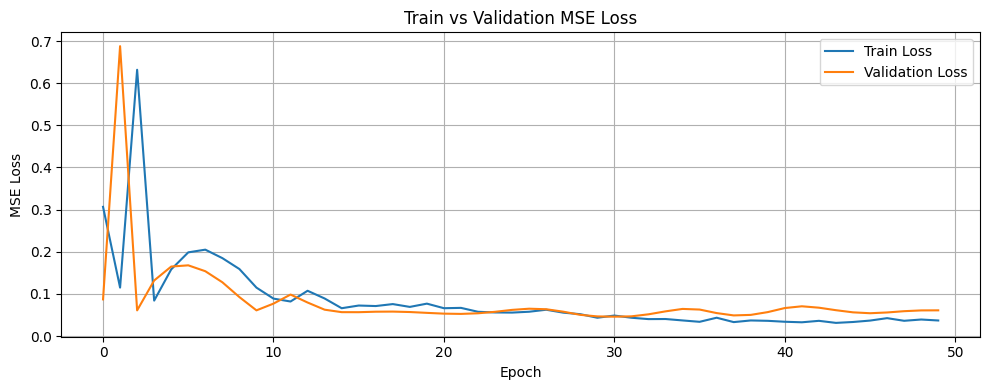

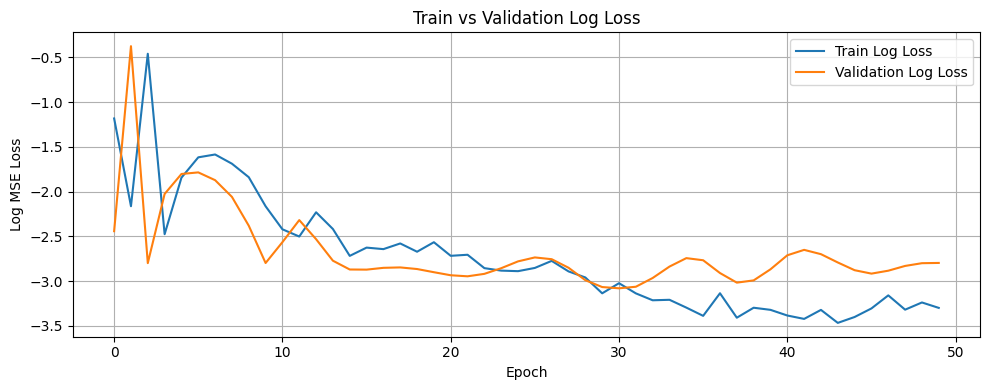

Training completed

=== Processing group: ('07 TO 09', 'JURONG EAST', '5 ROOM') ===
Group size: 4 rows
Calling prepare_lstm_data for ('07 TO 09', 'JURONG EAST', '5 ROOM')

Filtering for: JURONG EAST, 5 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 201
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 41
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2671, Val Loss: 0.1059, Train R²: -5.2928, Val R²: -0.7779
Best model saved!
Epoch 2/50, Train Loss: 0.0770, Val Loss: 0.2543, Train R²: -0.8136, Val R²: -3.2689
Epoch 3/50, Train Loss: 0.2570, Val Loss: 0.0659, Train R²: -5.0551, Val R²: -0.1064
Best model saved!
Epoch 4/50, Train Loss: 0.0418, Val Loss: 0.1131, Train R²: 0.

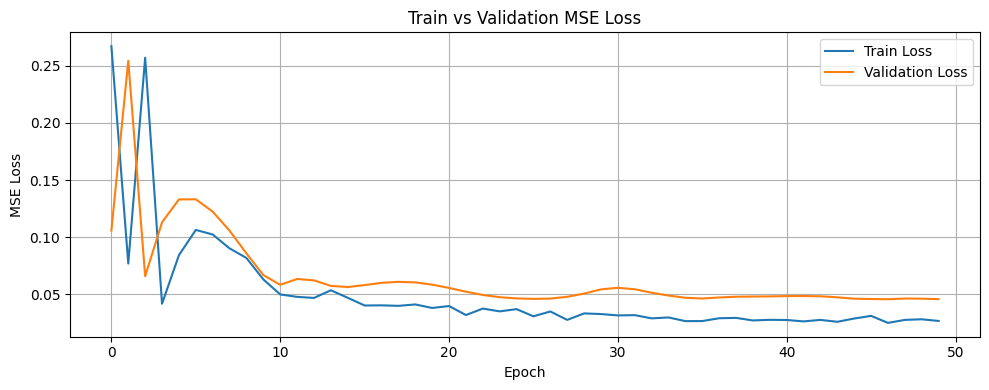

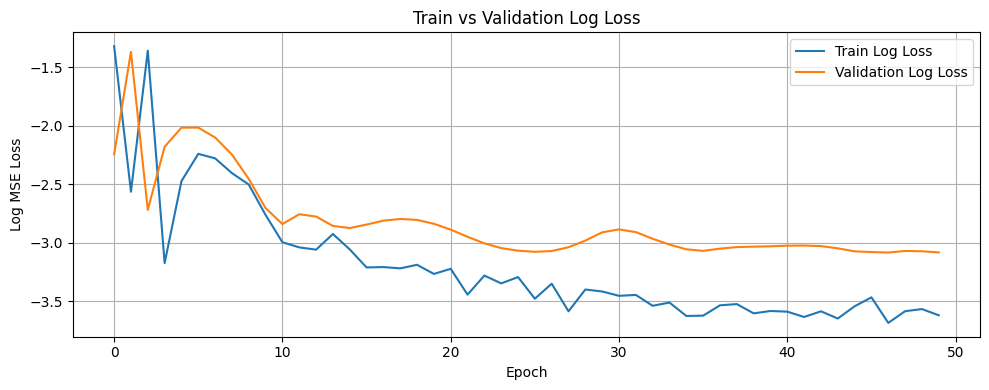

Training completed

=== Processing group: ('07 TO 09', 'JURONG EAST', 'EXECUTIVE') ===
Group size: 1 rows
Calling prepare_lstm_data for ('07 TO 09', 'JURONG EAST', 'EXECUTIVE')

Filtering for: JURONG EAST, EXECUTIVE, 07 TO 09, around 2025-01-01
Initial strict match count: 65
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 39
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2551, Val Loss: 0.1983, Train R²: -2.9497, Val R²: -1.1941
Best model saved!
Epoch 2/50, Train Loss: 0.1355, Val Loss: 0.1660, Train R²: -1.0984, Val R²: -0.8371
Best model saved!
Epoch 3/50, Train Loss: 0.1841, Val Loss: 0.1331, Train R²: -1.8502, Val R²: -0.4726
Best model saved!
Epoch 4/50, Train Loss: 0.0875, Val 

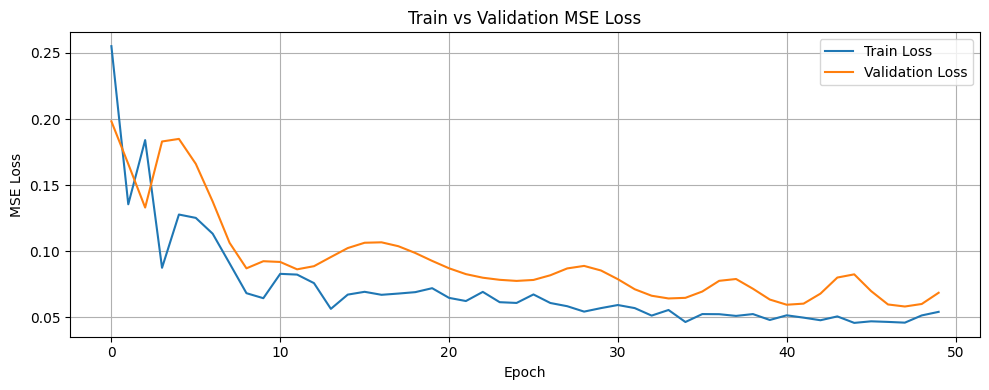

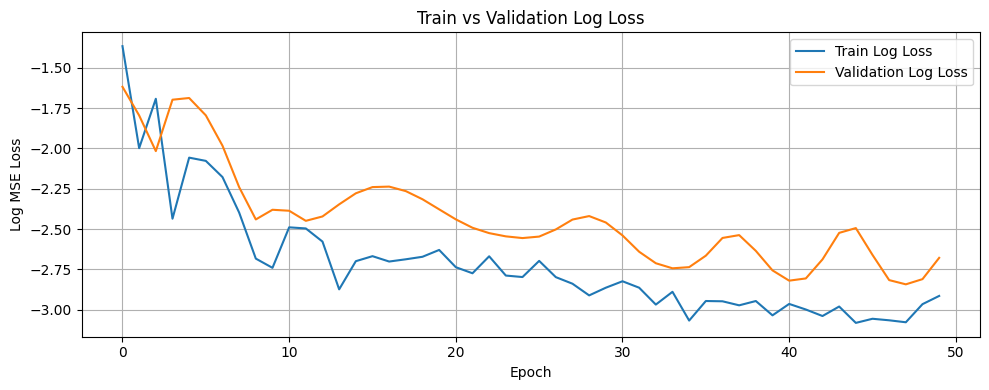

Training completed

=== Processing group: ('07 TO 09', 'JURONG WEST', '2 ROOM') ===
Group size: 3 rows
Calling prepare_lstm_data for ('07 TO 09', 'JURONG WEST', '2 ROOM')

Filtering for: JURONG WEST, 2 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 44
Using before_or_at_target with 44 records.
Removing 'block' column from dataset
Data shapes - x_train: (43, 9), y_train: (43,)
Flattened y shape: (43,), Unique values: 30
Using simple train-validation split (80/20).
Split sizes - Train: 34, Val: 9
Creating PyTorch datasets...
Dataset sizes - Train: 34, Val: 9
Using batch sizes - Train: 34, Val: 9
Starting model training...
Epoch 1/50, Train Loss: 0.3719, Val Loss: 0.2043, Train R²: -3.8568, Val R²: -1.5036
Best model saved!
Epoch 2/50, Train Loss: 0.1857, Val Loss: 0.1548, Train R²: -1.4255, Val R²: -0.8977
Best model saved!
Epoch 3/50, Train Loss: 0.1741, Val Loss: 0.1161, Train R²: -1.2730, Val R²: -0.4234
Best model saved!
Epoch 4/50, Train Loss: 0.1152, Val Loss: 0.1555

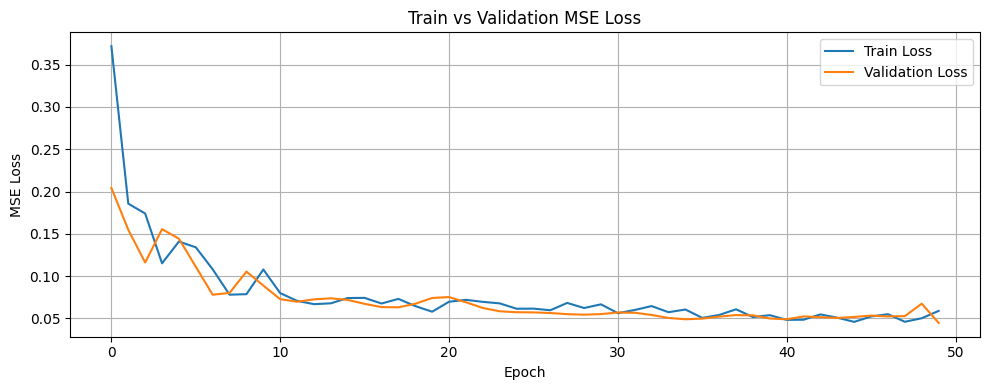

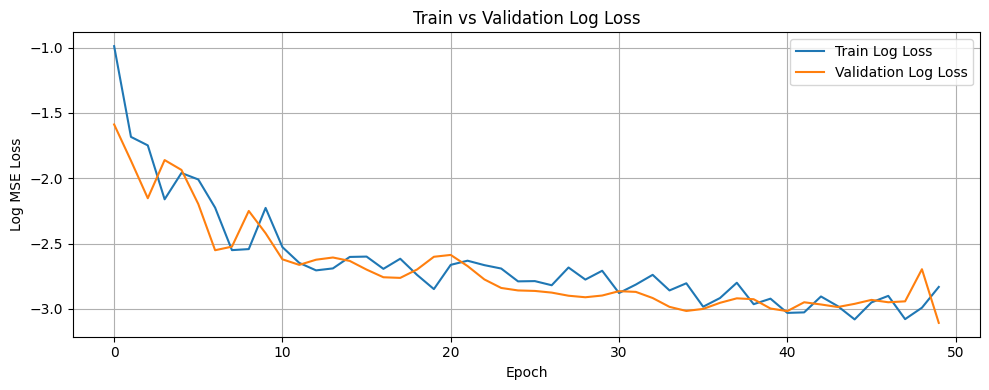

Training completed

=== Processing group: ('07 TO 09', 'JURONG WEST', '3 ROOM') ===
Group size: 26 rows
Calling prepare_lstm_data for ('07 TO 09', 'JURONG WEST', '3 ROOM')

Filtering for: JURONG WEST, 3 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 579
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 35
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2661, Val Loss: 0.0496, Train R²: -4.2206, Val R²: 0.0142
Best model saved!
Epoch 2/50, Train Loss: 0.0823, Val Loss: 1.1436, Train R²: -0.6139, Val R²: -21.7117
Epoch 3/50, Train Loss: 0.9571, Val Loss: 0.0557, Train R²: -17.7768, Val R²: -0.1071
Epoch 4/50, Train Loss: 0.0513, Val Loss: 0.0651, Train R²: -0.0063, Val R²: -

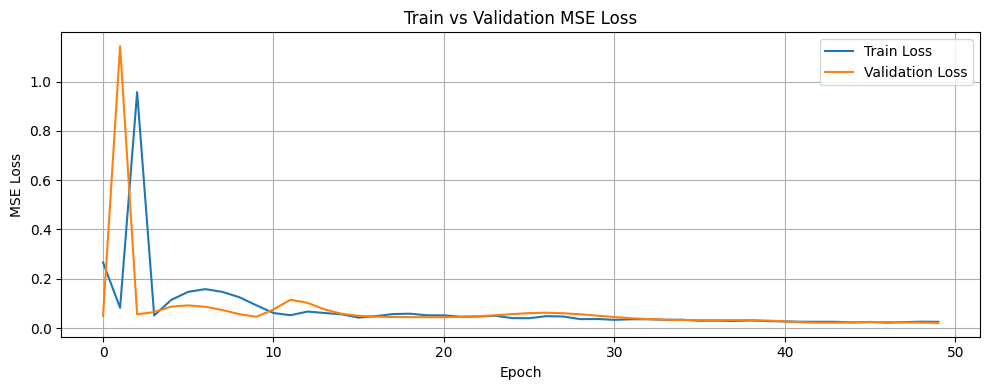

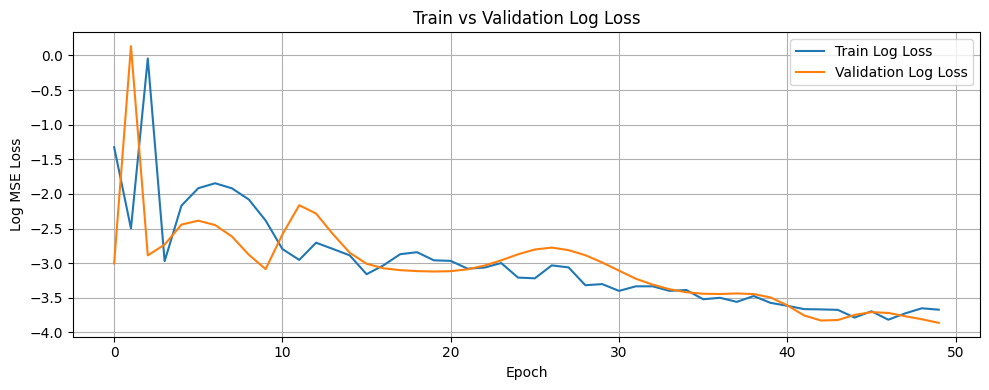

Training completed

=== Processing group: ('07 TO 09', 'JURONG WEST', '4 ROOM') ===
Group size: 28 rows
Calling prepare_lstm_data for ('07 TO 09', 'JURONG WEST', '4 ROOM')

Filtering for: JURONG WEST, 4 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 1091
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 38
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.1201, Val Loss: 0.0633, Train R²: -1.1687, Val R²: 0.0439
Best model saved!
Epoch 2/50, Train Loss: 0.0519, Val Loss: 0.1361, Train R²: 0.0633, Val R²: -1.0550
Epoch 3/50, Train Loss: 0.1270, Val Loss: 0.0856, Train R²: -1.2934, Val R²: -0.2928
Epoch 4/50, Train Loss: 0.0787, Val Loss: 0.1117, Train R²: -0.4218, Val R²: -0.

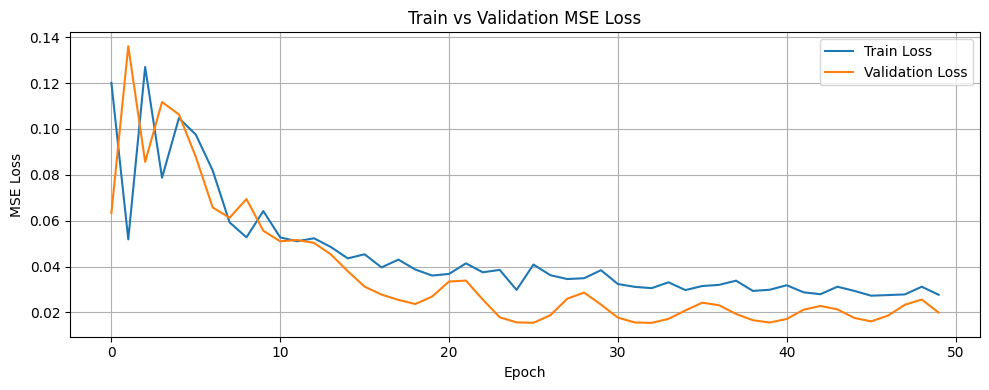

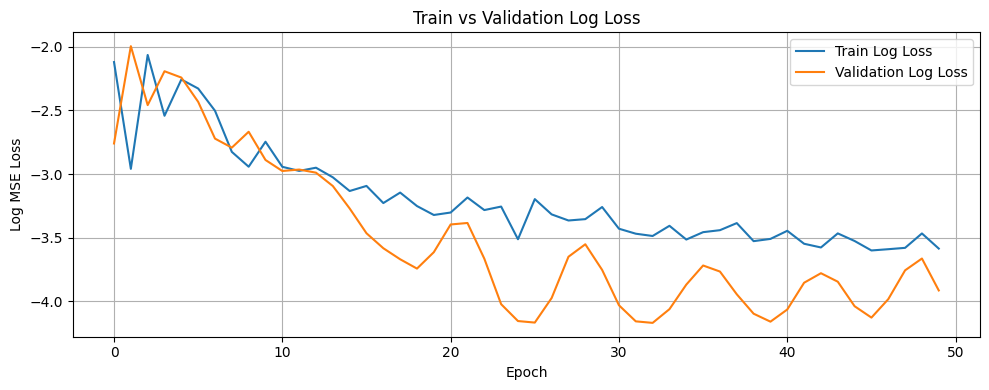

Training completed

=== Processing group: ('07 TO 09', 'JURONG WEST', '5 ROOM') ===
Group size: 24 rows
Calling prepare_lstm_data for ('07 TO 09', 'JURONG WEST', '5 ROOM')

Filtering for: JURONG WEST, 5 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 903
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 32
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2138, Val Loss: 0.0586, Train R²: -2.2338, Val R²: -1.1861
Best model saved!
Epoch 2/50, Train Loss: 0.0674, Val Loss: 0.5568, Train R²: -0.0203, Val R²: -19.7578
Epoch 3/50, Train Loss: 0.3582, Val Loss: 0.0306, Train R²: -4.4183, Val R²: -0.1417
Best model saved!
Epoch 4/50, Train Loss: 0.0851, Val Loss: 0.0298, Train R²: 

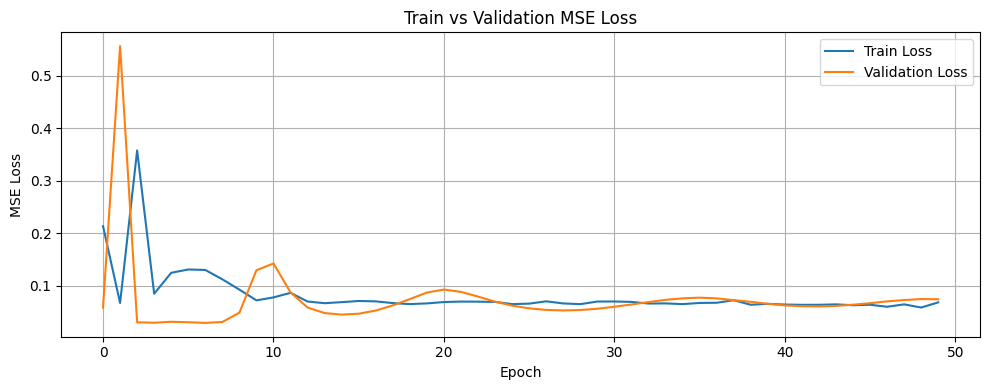

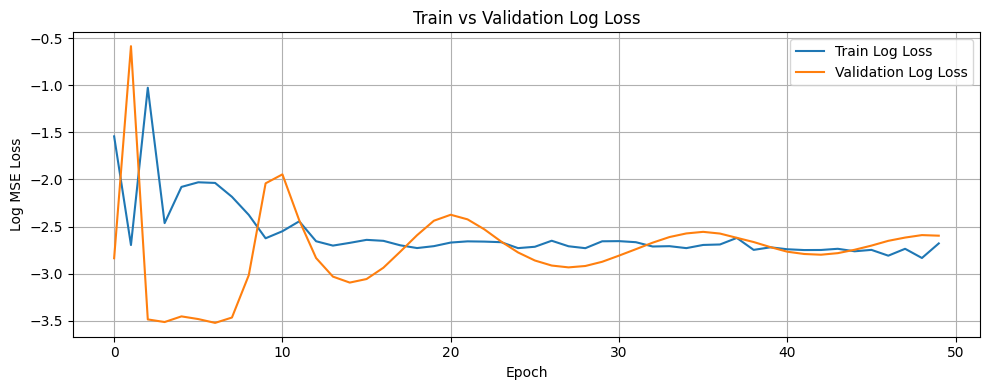

Training completed

=== Processing group: ('07 TO 09', 'JURONG WEST', 'EXECUTIVE') ===
Group size: 4 rows
Calling prepare_lstm_data for ('07 TO 09', 'JURONG WEST', 'EXECUTIVE')

Filtering for: JURONG WEST, EXECUTIVE, 07 TO 09, around 2025-01-01
Initial strict match count: 257
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 38
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.2097, Val Loss: 0.0432, Train R²: -3.7172, Val R²: -0.0284
Best model saved!
Epoch 2/50, Train Loss: 0.0562, Val Loss: 0.5970, Train R²: -0.2638, Val R²: -13.2200
Epoch 3/50, Train Loss: 0.5539, Val Loss: 0.0430, Train R²: -11.4572, Val R²: -0.0244
Best model saved!
Epoch 4/50, Train Loss: 0.0460, Val Loss: 0.0635, T

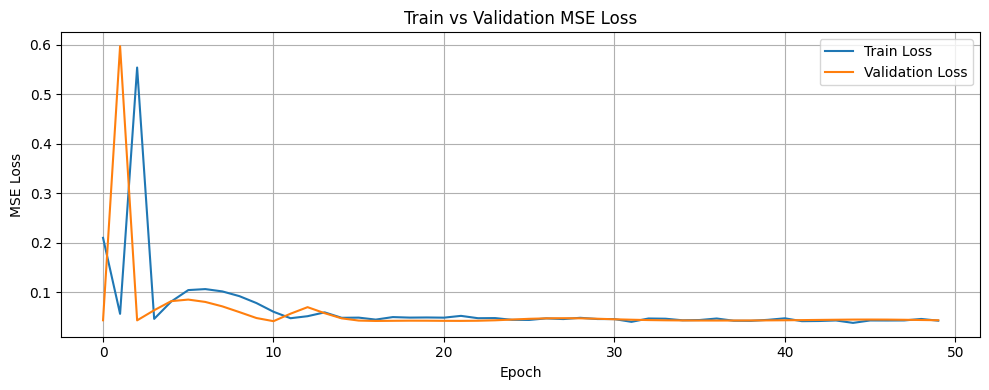

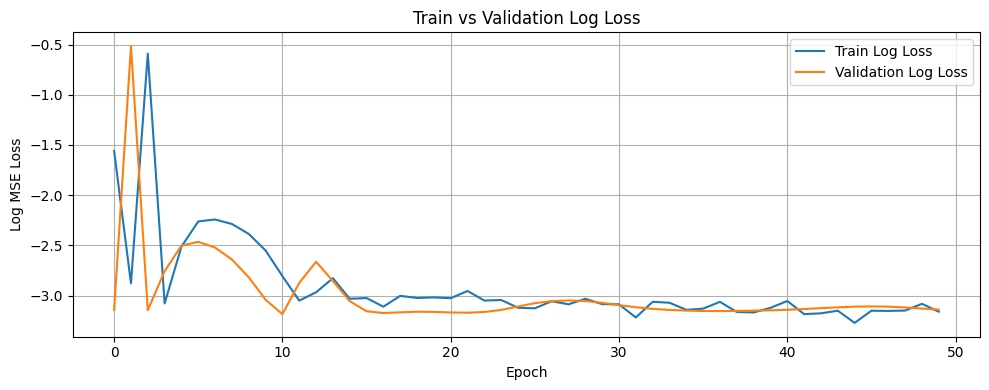

Training completed

=== Processing group: ('07 TO 09', 'KALLANG/WHAMPOA', '3 ROOM') ===
Group size: 15 rows
Calling prepare_lstm_data for ('07 TO 09', 'KALLANG/WHAMPOA', '3 ROOM')

Filtering for: KALLANG/WHAMPOA, 3 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 567
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 39
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.0973, Val Loss: 0.0760, Train R²: -3.3506, Val R²: -0.0671
Best model saved!
Epoch 2/50, Train Loss: 0.0266, Val Loss: 0.0811, Train R²: -0.1906, Val R²: -0.1387
Epoch 3/50, Train Loss: 0.0307, Val Loss: 0.0748, Train R²: -0.3712, Val R²: -0.0496
Best model saved!
Epoch 4/50, Train Loss: 0.0251, Val Loss: 0.0685,

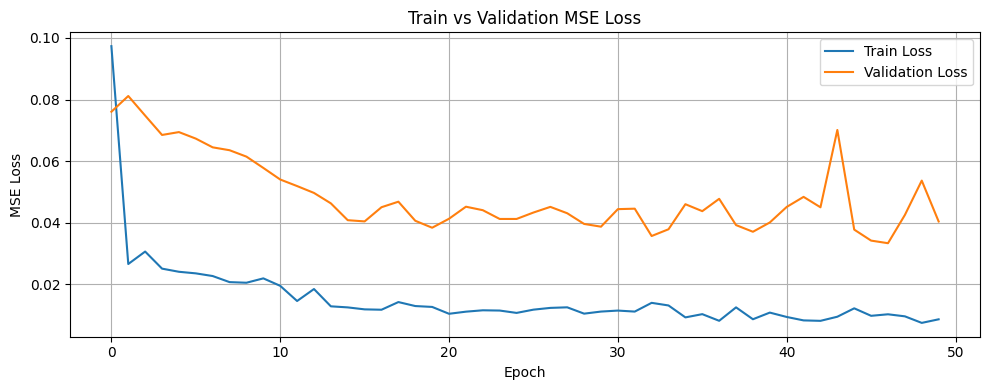

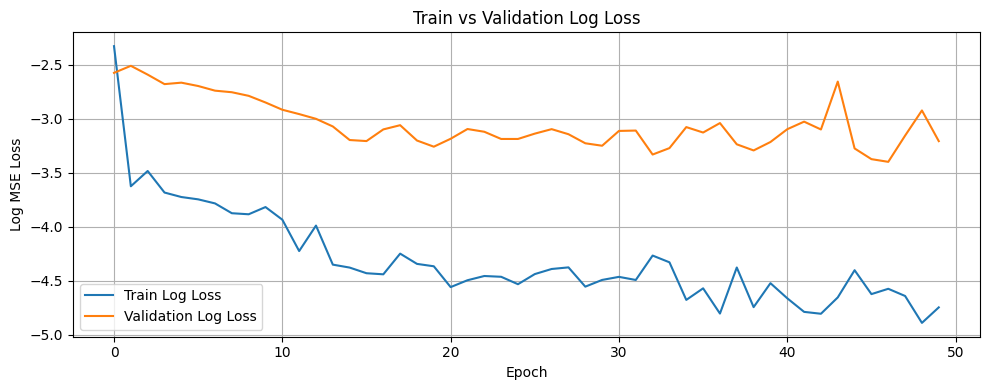

Error processing group ('07 TO 09', 'KALLANG/WHAMPOA', '3 ROOM'): [Errno 2] No such file or directory: '/content/saved_models/07_TO_09_KALLANG/WHAMPOA_3_ROOM_bundle.pkl'

=== Processing group: ('07 TO 09', 'KALLANG/WHAMPOA', '4 ROOM') ===
Group size: 10 rows
Calling prepare_lstm_data for ('07 TO 09', 'KALLANG/WHAMPOA', '4 ROOM')

Filtering for: KALLANG/WHAMPOA, 4 ROOM, 07 TO 09, around 2025-01-01
Initial strict match count: 373
Using before_or_at_target with 50 records.
Removing 'block' column from dataset
Data shapes - x_train: (49, 9), y_train: (49,)
Flattened y shape: (49,), Unique values: 46
Using simple train-validation split (80/20).
Split sizes - Train: 39, Val: 10
Creating PyTorch datasets...
Dataset sizes - Train: 39, Val: 10
Using batch sizes - Train: 39, Val: 10
Starting model training...
Epoch 1/50, Train Loss: 0.3864, Val Loss: 0.0563, Train R²: -2.5923, Val R²: -1.0260
Best model saved!
Epoch 2/50, Train Loss: 0.1851, Val Loss: 0.5549, Train R²: -0.7209, Val R²: -18.9672


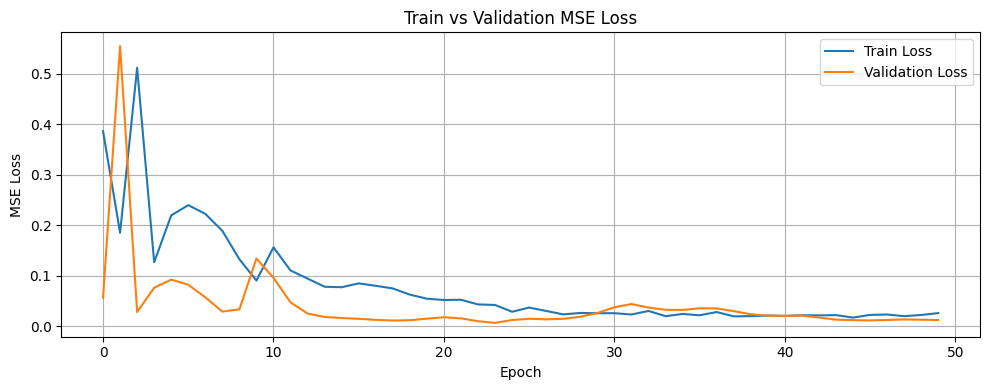

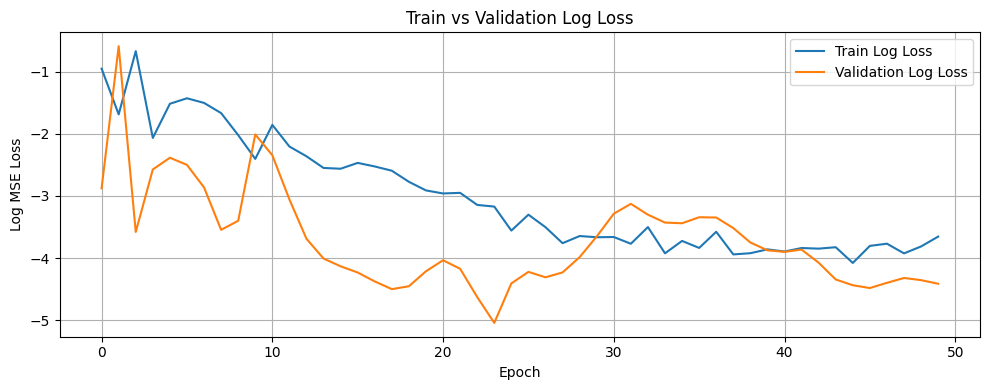

Error processing group ('07 TO 09', 'KALLANG/WHAMPOA', '4 ROOM'): [Errno 2] No such file or directory: '/content/saved_models/07_TO_09_KALLANG/WHAMPOA_4_ROOM_bundle.pkl'

=== Processing group: ('07 TO 09', 'KALLANG/WHAMPOA', '5 ROOM') ===
Group size: 1 rows
Calling prepare_lstm_data for ('07 TO 09', 'KALLANG/WHAMPOA', '5 ROOM')


In [ ]:
results = run_model_on_2025(df)

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import math

def plot_error_histograms(results):
    """
    Plots multiple histogram sets:
    1. Overall error distributions
    2. Error distributions by storey_group
    3. Error distributions by flat_type
    4. Error distributions by town

    Parameters:
    - results: List of dictionaries containing prediction results
    """
    # Convert list of dictionaries to DataFrame
    if isinstance(results, list):
        # Filter for valid numeric entries
        valid_results = []
        for entry in results:
            if isinstance(entry.get('percent_error'), (int, float)) and isinstance(entry.get('error'), (int, float)):
                valid_results.append(entry)

        # Convert to DataFrame
        results_df = pd.DataFrame(valid_results)
    else:
        # Already a DataFrame
        results_df = results

    # Check if we have any valid results to plot
    if len(results_df) == 0:
        print("No valid results to plot. Check if predictions were successful.")
        return

    print(f"Plotting histograms for {len(results_df)} valid predictions")

    # 1. OVERALL ERROR DISTRIBUTIONS
    plt.figure(figsize=(15, 6))

    # Percentage Error Histogram
    plt.subplot(1, 2, 1)
    plt.hist(results_df['percent_error'], bins=30, edgecolor='black')
    plt.title('Overall Histogram of % Error')
    plt.xlabel('% Error')
    plt.ylabel('Number of Flats')
    plt.grid(True)

    # Raw Error Histogram
    plt.subplot(1, 2, 2)
    plt.hist(results_df['error'], bins=30, edgecolor='black')
    plt.title('Overall Histogram of Raw Error')
    plt.xlabel('Error ($)')
    plt.ylabel('Number of Flats')
    plt.grid(True)

    # Add overall statistics as text
    mean_pct_error = results_df['percent_error'].mean()
    median_pct_error = results_df['percent_error'].median()
    std_pct_error = results_df['percent_error'].std()

    stats_text = f"Mean % Error: {mean_pct_error:.2f}%\n"
    stats_text += f"Median % Error: {median_pct_error:.2f}%\n"
    stats_text += f"Std Dev: {std_pct_error:.2f}%"

    plt.figtext(0.5, 0.01, stats_text, ha='center', bbox={'facecolor':'white', 'alpha':0.5, 'pad':5})

    plt.tight_layout(rect=[0, 0.05, 1, 1])  # Adjust for the text at the bottom
    plt.suptitle('Overall Error Distributions', fontsize=16)
    plt.savefig('overall_error_histograms.png')
    plt.show()

    # # 2. STOREY GROUP HISTOGRAMS
    storey_groups = results_df['storey_range'].unique()
    n_groups = len(storey_groups)

    if n_groups > 0:
        # Calculate grid dimensions (roughly square)
        n_cols = min(3, n_groups)
        n_rows = math.ceil(n_groups / n_cols)

        # Create subplots for percentage error by storey group
        plt.figure(figsize=(15, n_rows * 4))

        for i, group in enumerate(storey_groups):
            group_data = results_df[results_df['storey_range'] == group]

            plt.subplot(n_rows, n_cols, i+1)
            plt.hist(group_data['percent_error'], bins=20, edgecolor='black')
            plt.title(f'Storey Group: {group}')
            plt.xlabel('% Error')
            plt.ylabel('Count')
            plt.grid(True)

            # Add group statistics
            mean_error = group_data['percent_error'].mean()
            median_error = group_data['percent_error'].median()
            count = len(group_data)

            stats = f"Mean: {mean_error:.2f}%\nMedian: {median_error:.2f}%\nCount: {count}"
            plt.annotate(stats, xy=(0.05, 0.95), xycoords='axes fraction',
                        bbox=dict(boxstyle="round,pad=0.3", fc="white", alpha=0.8),
                        verticalalignment='top')

        plt.tight_layout()
        plt.suptitle('Percentage Error by Storey Group', fontsize=16)
        plt.subplots_adjust(top=0.95)
        plt.savefig('storey_group_histograms.png')
        plt.show()

    # 3. FLAT TYPE HISTOGRAMS
    flat_types = results_df['flat_type'].unique()
    n_types = len(flat_types)

    if n_types > 0:
        # Calculate grid dimensions
        n_cols = min(3, n_types)
        n_rows = math.ceil(n_types / n_cols)

        # Create subplots for percentage error by flat type
        plt.figure(figsize=(15, n_rows * 4))

        for i, flat_type in enumerate(flat_types):
            type_data = results_df[results_df['flat_type'] == flat_type]

            plt.subplot(n_rows, n_cols, i+1)
            plt.hist(type_data['percent_error'], bins=20, edgecolor='black')
            plt.title(f'Flat Type: {flat_type}')
            plt.xlabel('% Error')
            plt.ylabel('Count')
            plt.grid(True)

            # Add type statistics
            mean_error = type_data['percent_error'].mean()
            median_error = type_data['percent_error'].median()
            count = len(type_data)

            stats = f"Mean: {mean_error:.2f}%\nMedian: {median_error:.2f}%\nCount: {count}"
            plt.annotate(stats, xy=(0.05, 0.95), xycoords='axes fraction',
                        bbox=dict(boxstyle="round,pad=0.3", fc="white", alpha=0.8),
                        verticalalignment='top')

        plt.tight_layout()
        plt.suptitle('Percentage Error by Flat Type', fontsize=16)
        plt.subplots_adjust(top=0.95)
        plt.savefig('flat_type_histograms.png')
        plt.show()

    # 4. TOWN HISTOGRAMS
    towns = results_df['town'].unique()
    n_towns = len(towns)

    if n_towns > 0:
        # For towns, we might have many, so limit to top N by count
        town_counts = results_df['town'].value_counts()
        top_towns = town_counts.head(9).index.tolist()  # Top 9 towns

        # Calculate grid dimensions
        n_cols = min(3, len(top_towns))
        n_rows = math.ceil(len(top_towns) / n_cols)

        # Create subplots for percentage error by town
        plt.figure(figsize=(15, n_rows * 4))

        for i, town in enumerate(top_towns):
            town_data = results_df[results_df['town'] == town]

            plt.subplot(n_rows, n_cols, i+1)
            plt.hist(town_data['percent_error'], bins=20, edgecolor='black')
            plt.title(f'Town: {town}')
            plt.xlabel('% Error')
            plt.ylabel('Count')
            plt.grid(True)

            # Add town statistics
            mean_error = town_data['percent_error'].mean()
            median_error = town_data['percent_error'].median()
            count = len(town_data)

            stats = f"Mean: {mean_error:.2f}%\nMedian: {median_error:.2f}%\nCount: {count}"
            plt.annotate(stats, xy=(0.05, 0.95), xycoords='axes fraction',
                        bbox=dict(boxstyle="round,pad=0.3", fc="white", alpha=0.8),
                        verticalalignment='top')

        plt.tight_layout()
        plt.suptitle('Percentage Error by Town (Top Towns)', fontsize=16)
        plt.subplots_adjust(top=0.95)
        plt.savefig('town_histograms.png')
        plt.show()

    # Generate and print summary statistics
    print("\nOverall Summary Statistics:")
    print(f"Mean Percent Error: {mean_pct_error:.2f}%")
    print(f"Median Percent Error: {median_pct_error:.2f}%")
    print(f"Standard Deviation: {std_pct_error:.2f}%")

    print("\nSummary by Storey Group:")
    storey_summary = results_df.groupby('storey_range').agg({
        'percent_error': ['mean', 'median', 'std', 'count'],
        'error': ['mean', 'median', 'std']
    })
    print(storey_summary)

    print("\nSummary by Flat Type:")
    flat_type_summary = results_df.groupby('flat_type').agg({
        'percent_error': ['mean', 'median', 'std', 'count'],
        'error': ['mean', 'median', 'std']
    })
    print(flat_type_summary)

    print("\nSummary by Town:")
    town_summary = results_df.groupby('town').agg({
        'percent_error': ['mean', 'median', 'std', 'count'],
        'error': ['mean', 'median', 'std']
    })
    print(town_summary)

    return results_df  # Return the processed DataFrame for potential further analysis

In [ ]:
# results = run_model_on_2025(df, data_preprocessor, model)
# results = run_model_on_2025(df)
plot_error_histograms(results)


In [ ]:
import pickle
import torch

# Example path (from your earlier code)
pickle_path = "/content/saved_models/06_to_10_TAMPINES_4_room_bundle.pkl"  # replace with actual path

# Load the bundle
with open(pickle_path, 'rb') as f:
    bundle = pickle.load(f)

# Rebuild the model architecture
model_class = bundle['model_class']
model = model_class(input_size=1, hidden_size=64, num_layers=3, output_size=1)
model.load_state_dict(bundle['model_state_dict'])
model.to(device)
model.eval()  # Set model to evaluation mode

label_encoders = bundle['label_encoders']
scaler = bundle['scaler']

sample_row = {
    "month": "2025-01",
    "town": "TAMPINES",
    "flat_type": "4 ROOM",
    "storey_range": "06 TO 10",
    "floor_area_sqm":,
    "flat_model":,
    "lease_commence_date":,
    "remaining_lease":,

}

import pandas as pd
sample_df = pd.DataFrame([sample_row])